# Advanced Algorithms and Parallel Programming
## Summer Session Project on Advanced Algorithms
## Student: Samuel Polo - 10670388

## Retiming of a Circuit Graph

Problem: Optimize frequency of a circuit

Solutions: 
Move register(s) so that:
	- clock cycle decreases or number of registers decreases.
	- input-output behavior is preserved.

In [23]:
import graph_tool.all as gt
import numpy as np

## Restrictions on Graph Generation
In order that a graph G = (V, E, d, w) have well-defined physical meaning
as a circuit, we place nonnegativity restrictions on the propagation delays
d(v) and the register counts w(e):

D1. The propagation delay d(v) is nonnegative for each vertex v belonging to V.

W1. The register count w(e) is a nonnegative integer for each edge e belonging to E.
We also impose the restriction that there be no directed cycles of zero weight:

W2. In any directed cycle of G, there is some edge with (strictly) positive
register count.

# Retiming Graph Examples

## Example 1

<Graph object, directed, with 4 vertices and 5 edges, 1 internal vertex property, 1 internal edge property, at 0x7f6a216e17c0>


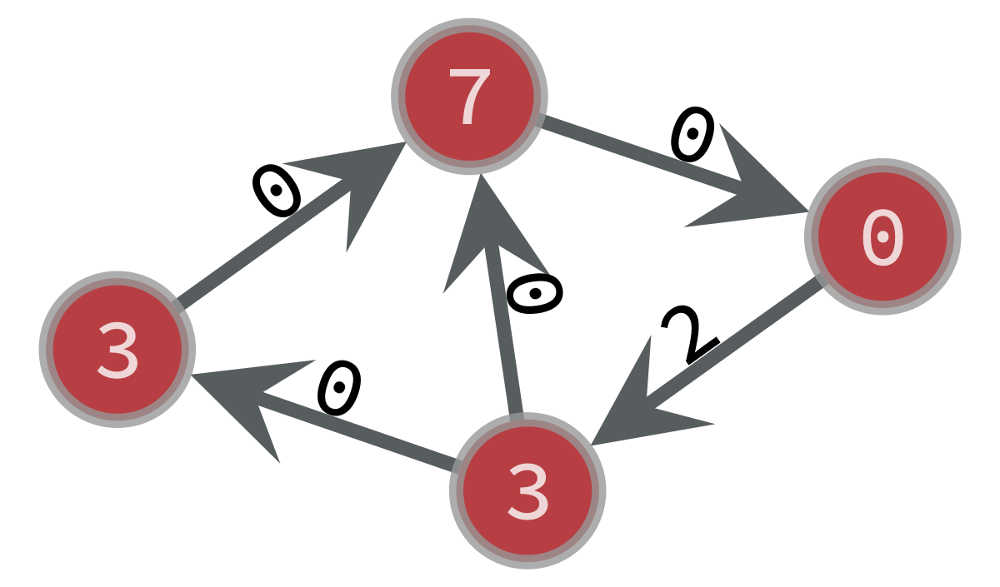

Vertex 0 with capacity: 0
Vertex 1 with capacity: 3
Vertex 2 with capacity: 3
Vertex 3 with capacity: 7
cap            (vertex)  (type: int32_t)
weight         (edge)    (type: double)
None


In [24]:
#Example taken from: https://people.eecs.berkeley.edu/~keutzer/classes/244fa2005/lectures/8-2-retiming-ucb.pdf and 
#SummerSessionProjectAA.pptx
g = gt.Graph()

edge_weight = g.new_edge_property("double")
g.edge_properties["weight"] = edge_weight
edge_str_weight = g.new_edge_property("string")

vlist = g.add_vertex(4) #Creation of vertices

edges = [[0,1],[1,2],[1,3],[2,3],[3,0]] #array of Edges 

nodeCapacity = [0,3,3,7] #Aka "d(node_i)" #Array d(v) in the paper (Propagation delay)

cap = g.new_vertex_property("int")

weights = [2,0,0,0,0] #array of weights "w" (Register count) 

for i in range(len(list(vlist))):
    cap[i] = nodeCapacity[i]

g.vertex_properties["cap"] = cap    #Array d(v) in the paper (Propagation delay)

for i in range(len(edges)):
    e = g.add_edge(edges[i][0], edges[i][1])
    g.ep.weight[e] = weights[i]
    edge_str_weight[e] = str(weights[i])
    
print(g)
gt.graph_draw(g, vertex_text=g.vp.cap, edge_text=edge_str_weight)

for v in g.vertices():
    print("Vertex %s with capacity: %s" % (v, g.vp.cap[v]))
    
print(g.list_properties())

# Implemented Algorithms

## Algorithm WD

In [138]:
def WD(graph): #Algorithm WD that computes both the W and the D matrix from a known graph. 
    W = np.zeros((graph.num_vertices(),graph.num_vertices())) #Initialize W Matrix
    D = np.zeros((graph.num_vertices(),graph.num_vertices())) #Initialize D Matrix
    #print(W)
    #print(D)

    g2 = gt.Graph(graph) #Copy the graph to perform other operations.

    ordered_pair = g2.new_edge_property("vector<int>")
    g2.edge_properties["weight_pair"] = ordered_pair

    for edge in graph.edges():
        g2.ep.weight_pair[edge] = [graph.ep.weight[edge], graph.vp.cap[edge.source()]*(-1)]
    
    for i in range(graph.num_vertices()):
        for j in range(graph.num_vertices()):
            if (i!=j): #Exclude the same node path calculation.
                #Calculate the total weight of the path we just got.
                path = gt.shortest_path(g2, i, j)
                weightSum = [0,0] #Ordered pair weightSum [x,y] that will be: [w(e), -d(u)]
                for item in path[1]:
                    #print(item)
                    weightSum = [weightSum[0] + g2.ep.weight_pair[item][0], weightSum[1] + g2.ep.weight_pair[item][1]]

                #print(weightSum)
                #Coge weightSum y haz las respectivas operaciones con (x,y); W(u,v) y D(u,v)              

                W[i][j] = weightSum[0] #W(u,v) = x 
                #print(W[i][j])

                D[i][j] = g2.vp.cap[j] - weightSum[1] #D(u,v) = d(v) -y
                #print(D[i][j])
            else:
                D[i][j] = graph.vp.cap[graph.vertex(i)]


    print("W Matrix: ")
    print(W)
    print("D Matrix: ")
    print(D)
    return [W,D]

  ## FEAS Algorithm

In [139]:
def FEAS(g, c): #Input: Graph g, clock period 'c' from D(u,v); Output: Clock period and optimal retiming found.  
                #For visualization purposes, the majority of graph drawings, sorts and other data outputs no more important 
                #than the clock period and the retiming is omitted to show a clean answer.
                #The notebook: 'RetimingProject_10670388_FEAS' shows the solution with more steps. 
    retimings = []
    for i in range(g.num_vertices()):
        retimings.append(0)
    #print(retimings)

    for i in range(g.num_vertices()-1):
    
        #We proceed to calculate the new retiming weights.
        gFinal = gt.Graph(g)
        #print(gFinal)

        for edge in gFinal.edges():
            source = int(str(edge.source())) #Get source node from edge.
            target = int(str(edge.target())) #Get target node from edge.
            gFinal.ep.weight[edge] = gFinal.ep.weight[edge] + retimings[target] - retimings[source] 

        #Compute Clock Period Algorithm (Algorithm CP)
            
        g0 = gt.Graph(gFinal) 

        removedEdges = []

        for edge in g0.edges(): #In order to eliminate some edges, we need to first put them in an array in order
                                #to eliminate them. (Decision from Graph-Tool Creators)
            if (g0.ep.weight[edge]!=0): #Remove any edge with weight different from 0.
                removedEdges.append([edge.source(),edge.target()])

                
        delta = g0.new_vertex_property("int") #Property delta(node) in the reference paper.

        for i in range(len(list(g0.vertices()))): #Initialize array of deltas.
            delta[i] = 0

        g0.vertex_properties["delta"] = delta #Add the property 'delta' to a graph. 

        for i in range(len(removedEdges)):
            g0.remove_edge(g0.edge(removedEdges[i][0], removedEdges[i][1])) #Remove edges with weights that are different from 0.

        #gt.graph_draw(g0, vertex_text=g0.vp.cap)

        #Topological Sort
        sortedGraph = gt.Graph(g0)
        tree = gt.min_spanning_tree(g0)
        g0.set_edge_filter(tree)
        sort = gt.topological_sort(g0)
        #print(sort)

        for node in sort:

            if (g0.vertex(node).in_degree()==0): #If the node doesn't have incoming edges. 
                g0.vp.delta[node] = g0.vp.cap[node]
            else:
                maxDelta = 0
                for edge in g0.vertex(node).in_edges():
                    if (g0.vp.delta[g0.vertex(edge.source())] > maxDelta):
                        maxDelta = g0.vp.delta[g0.vertex(edge.source())]

                g0.vp.delta[node] = g0.vp.cap[node] + maxDelta

            #print(g0.vp.delta[node])

        clockPeriod = 0
        for node in sort:
            if (g0.vp.delta[node] > clockPeriod): #Update clock period 
                clockPeriod = g0.vp.delta[node]

        #print("Clock Period of the graph is: " + str(clockPeriod))

        for vertex in g0.vertices():
            if (g0.vp.delta[vertex]>c):
                retimings[int(vertex)] = retimings[int(vertex)] + 1 #Get new Retimings.

        #print(retimings)

    #gt.graph_draw(g0, vertex_text=g0.vp.cap)
    
    #Perform algorithm CP Again. 
    
    removedEdges = []

    for edge in g0.edges():
        if (g0.ep.weight[edge]!=0):
            removedEdges.append([edge.source(),edge.target()])

    delta = g0.new_vertex_property("int") #Property delta(node) in the reference paper.

    for i in range(len(list(g0.vertices()))):
        delta[i] = 0

    g0.vertex_properties["delta"] = delta

    for i in range(len(removedEdges)):
        g0.remove_edge(g0.edge(removedEdges[i][0], removedEdges[i][1]))

    print("Final graph created with FEAS: ")
    gt.graph_draw(g0, vertex_text=g0.vp.cap)

    #Topological Sort
    sortedGraph = gt.Graph(g0)
    tree = gt.min_spanning_tree(g0)
    g0.set_edge_filter(tree)
    sort = gt.topological_sort(g0)
    #print(sort)

    for node in sort:

        if (g0.vertex(node).in_degree()==0): #If the node doesn't have incoming edges. 
            g0.vp.delta[node] = g0.vp.cap[node]
        else:
            maxDelta = 0
            for edge in g0.vertex(node).in_edges():
                if (g0.vp.delta[g0.vertex(edge.source())] > maxDelta):
                    maxDelta = g0.vp.delta[g0.vertex(edge.source())]

            g0.vp.delta[node] = g0.vp.cap[node] + maxDelta


    clockPeriod = 0
    for node in sort:
        if (g0.vp.delta[node] > clockPeriod): #Update clock period 
            clockPeriod = g0.vp.delta[node]
    
    print("FEAS Algorithm finished with c: "+str(c))
    print("Clock Period of the graph is: " + str(clockPeriod))

    if (clockPeriod > c):
        print("No feasible retiming exists.")
    else:
        print("Retiming: %s is the desired retiming." % (retimings))
        
    return clockPeriod, retimings

## Algorithm OPT1

In [140]:
def OPT1(g):
    tupleWD = WD(g) #Perform W and D matrix computation for the algorithm
    W = tupleWD[0]
    D = tupleWD[1]
    copyD = np.copy(D) #This is the array we will sort. 
    copyD = np.unique(copyD)
    #r(u) - r(v) <= w(e)
    optimalRetiming = []
    
    minimumClockPeriod = 999
    for i in range(len(copyD)):     #Gets calculated with sorted D(u,v)

        c = copyD[i]
        
        print("Test with C: "+str(c))
        
        g5 = gt.Graph(g) #Create a copy of the graph in order to perform other operations. 

        nodesSize = g5.num_vertices() #Get the number of the nodes.

        g5.add_vertex() #Add new artificial node to perform the shortest-path. 

        for i in range(nodesSize):
            e = g5.add_edge(nodesSize, i) #We add the nodesSize number-index as the new node for the Bellman Ford algorithm.
            g5.ep.weight[e] = 0

        for edge in g5.edges(): #Visualization purposes. #Theorem 7.1 in the Reference Paper.
            if (edge.source()!=nodesSize and edge.target()!=nodesSize):

                #print("r(u): %s, r(v): %s with edge: %s" % (edge.source(), edge.target(), edge_weight[edge]))

                source = int(str(edge.source()))
                target = int(str(edge.target()))

        for node1 in range(g5.num_vertices()): #Theorem 7.2 in the Reference Paper.
            for node2 in range(g5.num_vertices()):

                if (node1!=node2 and node1!= nodesSize and node2!= nodesSize):
                    if (D[node1][node2] > c):
                        if(not( (D[node1][node2] - g5.vp.cap[node1] > c) or (D[node1][node2] - g5.vp.cap[node2] > c))):
                            e = g5.add_edge(node1,node2)
                            g5.ep.weight[e] = W[node1][node2] - 1

        #(Inequalities)
        minPathSums = [] #Initialize the array of Minimum Path Sums
        minPath = []

        for i in range(nodesSize):
            minPathSums.append(999)

        isPossible = True #Flag in order to know if there is not any violation in the constraints. 
        for i in range(nodesSize):
            if (isPossible):
                try:
                    path = gt.shortest_path(g5, nodesSize, i, weights=g5.ep.weight, negative_weights=True) 
                    #print(path)
                    pathSum = 0 

                    for item in path[1]:        
                        pathSum = pathSum + g5.ep.weight[item] 

                    if (pathSum < minPathSums[i]):
                            minPathSums[i] = pathSum
                            minPath = path
                            
                    print("Variable: %s , value: %s " % (i,minPathSums[i]))
                    #print("Minimum path:")
                    #print(minPath)
                except ValueError: 
                    isPossible = False
                    print("Negative Loops Found. Skipping Solution...")

        if (isPossible):
            #Now that we found a solution to the Linear Inequalities, we proceed to calculate the new retiming weights.

            for i in range(len(minPathSums)):
                print(minPathSums[i])
                        
            gFinal = gt.Graph(g)
                #print(gFinal)

            for edge in gFinal.edges():
                source = int(str(edge.source()))
                target = int(str(edge.target()))
                gFinal.ep.weight[edge] = gFinal.ep.weight[edge] - minPathSums[target] + minPathSums[source] 
                #The reason the subtraction is swapped here is because the edges for the Bellman-Ford algorithm 
                #were created in the inverse order for simplification purposes.
                #By replacing the target and the source operation, we get the original operation with values that satisfy
                #the Theorem 7. 
                #print("Edge: %s with new value: %s" % (edge, gFinal.ep.weight[edge]))

            #New Graph Gr
            print("New Graph Gr: ")
            gt.graph_draw(gFinal, vertex_text=gFinal.vertex_index, edge_text=gFinal.ep.weight)
            
            g0 = gt.Graph(gFinal)

            removedEdges = []

            for edge in g0.edges():
                if (g0.ep.weight[edge]!=0):
                    removedEdges.append([edge.source(), edge.target()])

            #print(removedEdges)
            #print(len(removedEdges))

            delta = g0.new_vertex_property("int") #Property delta(node) in the reference paper.

            for i in range(len(list(g0.vertices()))):
                delta[i] = 0

            g0.vertex_properties["delta"] = delta

            #print(removedEdges[0][0])
            #print(removedEdges[0][1])

            for i in range(len(removedEdges)):
                g0.remove_edge(g0.edge(removedEdges[i][0], removedEdges[i][1]))
            
            print("Graph G0 taken from Gr: ")
            gt.graph_draw(g0, vertex_text=g0.vp.cap)

            #Topological Sort
            sortedGraph = gt.Graph(g0)
            tree = gt.min_spanning_tree(g0)
            g0.set_edge_filter(tree)
            sort = gt.topological_sort(g0)
            #print(sort)

            for node in sort:

                if (g0.vertex(node).in_degree()==0): #If the node doesn't have incoming edges. 
                    g0.vp.delta[node] = g0.vp.cap[node]
                else:
                    maxDelta = 0
                    for edge in g0.vertex(node).in_edges():
                        if (g0.vp.delta[g0.vertex(edge.source())] > maxDelta):
                            maxDelta = g0.vp.delta[g0.vertex(edge.source())]

                    g0.vp.delta[node] = g0.vp.cap[node] + maxDelta

            #print(g0.vp.delta[node])

            clockPeriod = 0
            for node in sort:
                if (g0.vp.delta[node] > clockPeriod): #Update clock period 
                    clockPeriod = g0.vp.delta[node]

            print("Clock Period of the graph is: %s with value of c as: %s" % (clockPeriod, c))
            if (clockPeriod < minimumClockPeriod):
                minimumClockPeriod = clockPeriod
                clockPeriodFound = c
                optimalRetiming = minPathSums

    print("Minimum Clock Period is: %s with c: %s" % (minimumClockPeriod, clockPeriodFound))
    return optimalRetiming

## Algorithm OPT2

In [141]:
def OPT2(graph): #Algorithm OPT2 from the Reference paper. Complexity of the algorithm in O(|V| |E| lg |V|) time.
    tupleWD = WD(graph) #Perform W and D matrix computation for the algorithm
    W = tupleWD[0]
    D = tupleWD[1]
    copyD = np.copy(D) #This is the array we will sort. 
    copyD = np.unique(copyD)
    minimumClockPeriod = 999
    optimalRetiming = []
    for i in range(len(copyD)): 

        c = copyD[i]
        print("Test with C: "+str(c))
        
        solution = FEAS(graph,c) #Execute FEAS Algorithm that will give us a tuple = [clock_period, retimings]
        
        clockPeriod = solution[0]
        retimings = solution[1]
       
        print("Clock Period of the graph (OPT2) is: %s" % (clockPeriod))
        
        if (clockPeriod > c):
            print("No feasible retiming exists.")
        else:
            if(clockPeriod < minimumClockPeriod):
                minimumClockPeriod = clockPeriod
                optimalRetiming = retimings
                print("Retiming: %s is the desired retiming." % (retimings))
            else:
                print("It doesn't improve the retiming.")

    print("Minimum Achievable Clock Period is: %s with retiming: %s" % (minimumClockPeriod, optimalRetiming))
    return minimumClockPeriod, optimalRetiming

# Algorithm Execution

Since any algorithm just needs as input the graph (with the exception of FEAS that need the graph and a clock period c), we can execute the specific algorithm need with a simple function with a graph that has to be already created. 

Example: 

Final graph created with FEAS: 


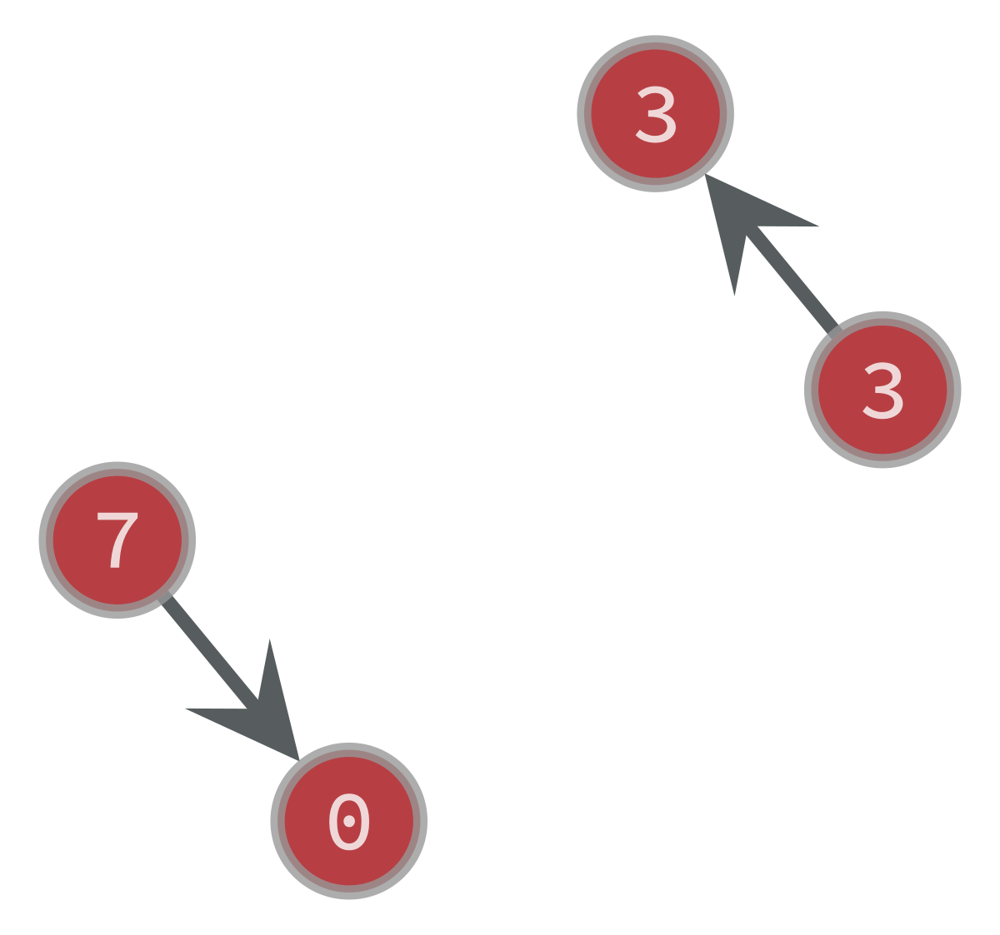

FEAS Algorithm finished with c: 7
Clock Period of the graph is: 7
Retiming: [1, 0, 0, 1] is the desired retiming.
(7, [1, 0, 0, 1])


In [114]:
print(FEAS(g,7)) #Perform execution of FEAS Algorithm with input: Graph g and clock period 7.

([<Vertex object with index '0' at 0x7f6a215c4b10>, 1], [<Edge object with source '0' and target '1' at 0x7f6a215c5530>])
PATH 0: 
[<Vertex object with index '0' at 0x7f6a215c4b10>, 1]
PATH 1: 
[<Edge object with source '0' and target '1' at 0x7f6a215c5530>]
(0, 1)
0
2
0
0
([<Vertex object with index '0' at 0x7f6a215cf870>, <Vertex object with index '1' at 0x7f6a215cf810>, 2], [<Edge object with source '0' and target '1' at 0x7f6a215c5730>, <Edge object with source '1' and target '2' at 0x7f6a215c56b0>])
PATH 0: 
[<Vertex object with index '0' at 0x7f6a215cf870>, <Vertex object with index '1' at 0x7f6a215cf810>, 2]
PATH 1: 
[<Edge object with source '0' and target '1' at 0x7f6a215c5730>, <Edge object with source '1' and target '2' at 0x7f6a215c56b0>]
(0, 1)
0
2
0
0
(1, 2)
2
0
0
-3
([<Vertex object with index '0' at 0x7f6a215cf7b0>, <Vertex object with index '1' at 0x7f6a215c4db0>, 3], [<Edge object with source '0' and target '1' at 0x7f6a215c55b0>, <Edge object with source '1' and targ

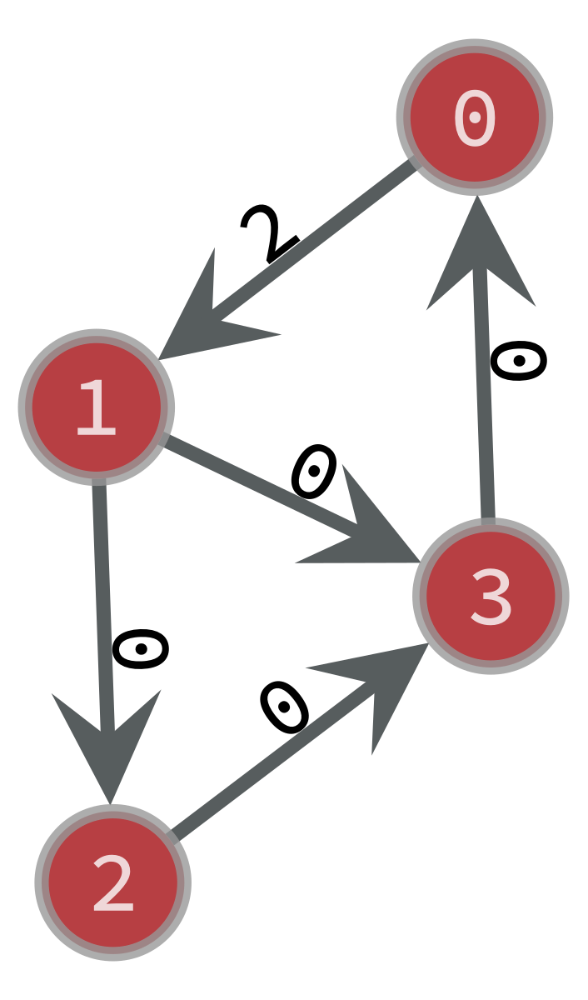

Graph G0 taken from Gr: 


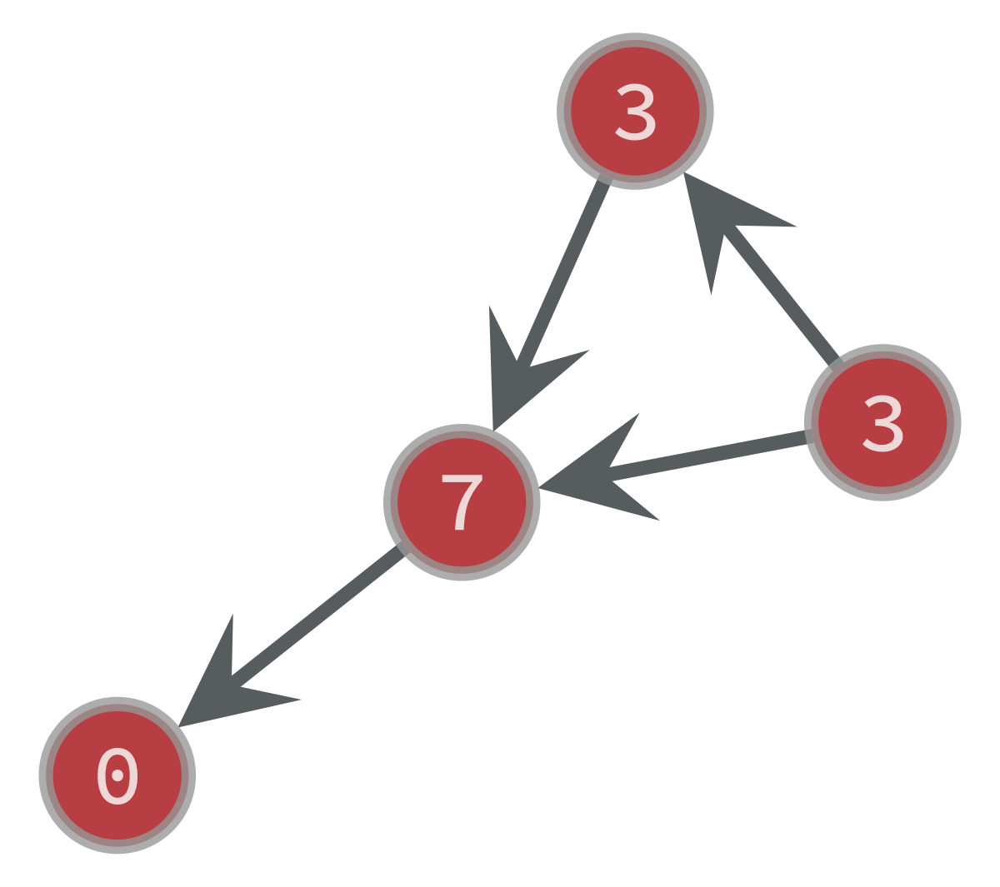

Clock Period of the graph is: 13 with value of c as: 0.0
Test with C: 3.0
Variable: 0 , value: -1.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: -1.0 
Variable: 3 , value: -1.0 
-1.0
0.0
-1.0
-1.0
New Graph Gr: 


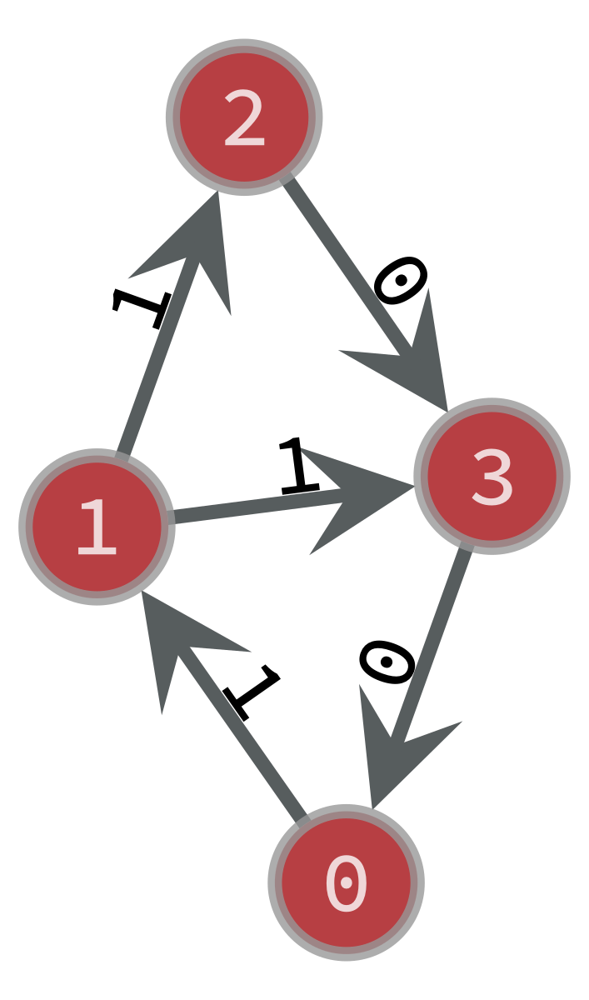

Graph G0 taken from Gr: 


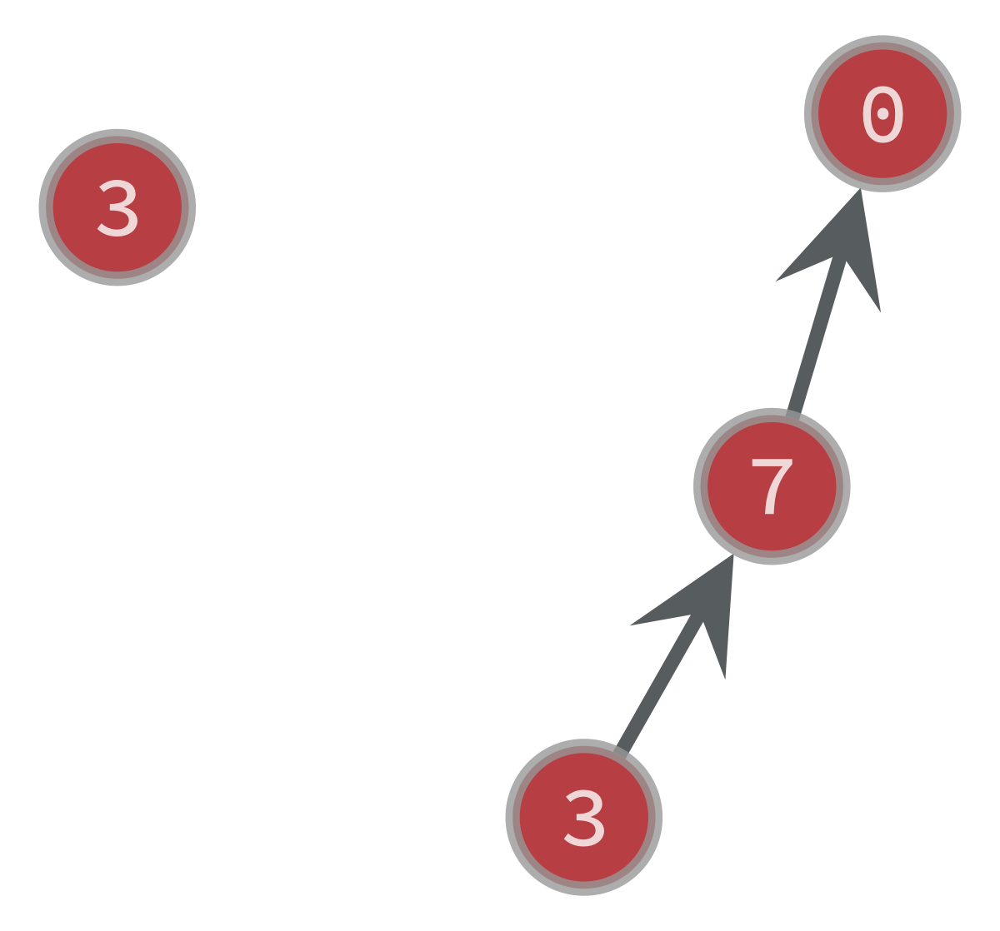

Clock Period of the graph is: 10 with value of c as: 3.0
Test with C: 6.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
0.0
0.0
0.0
0.0
New Graph Gr: 


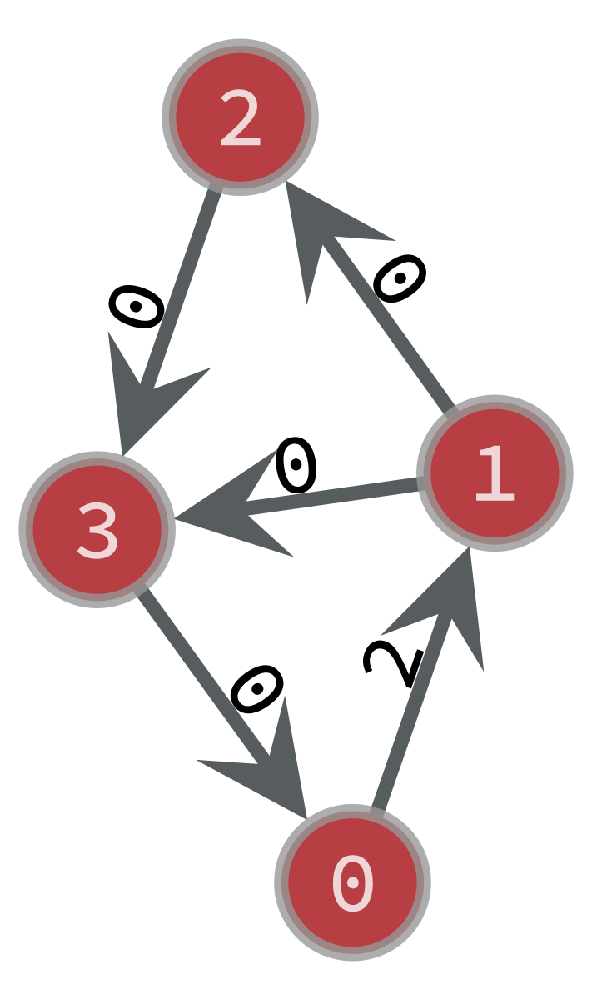

Graph G0 taken from Gr: 


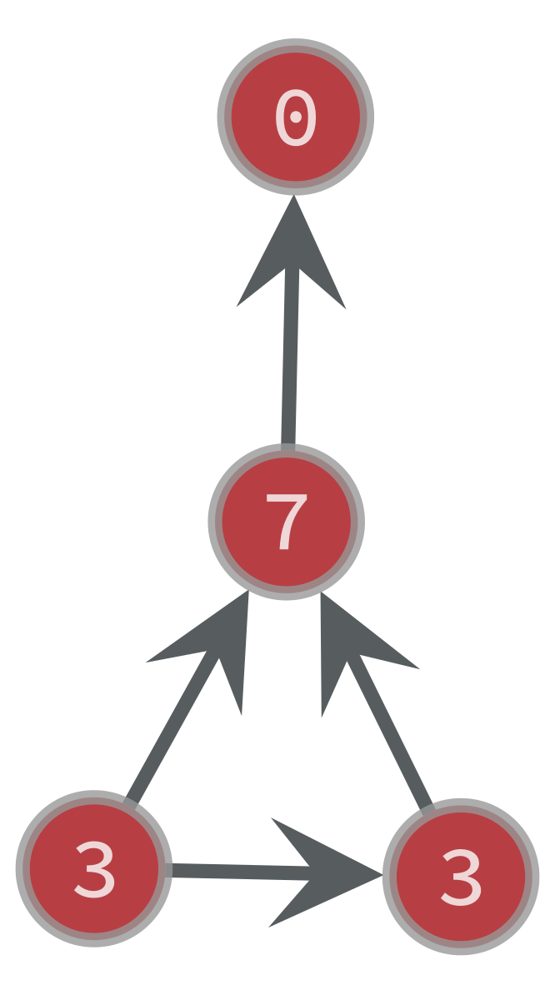

Clock Period of the graph is: 13 with value of c as: 6.0
Test with C: 7.0
Variable: 0 , value: -1.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: -1.0 
-1.0
0.0
0.0
-1.0
New Graph Gr: 


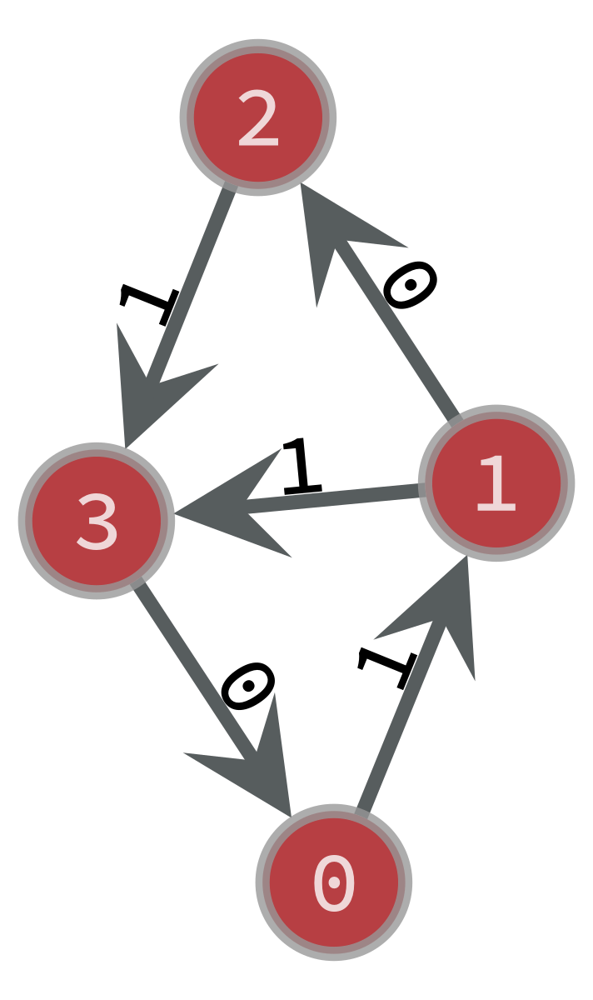

Graph G0 taken from Gr: 


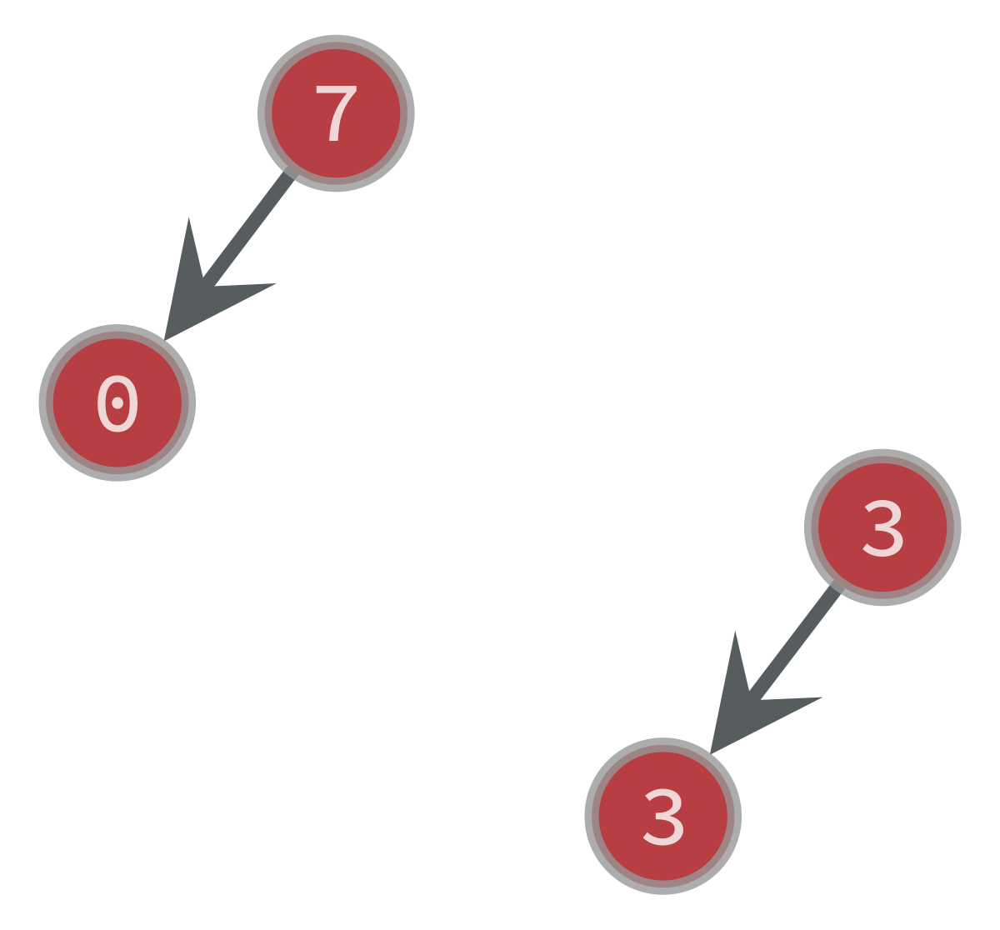

Clock Period of the graph is: 7 with value of c as: 7.0
Test with C: 10.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
0.0
0.0
0.0
0.0
New Graph Gr: 


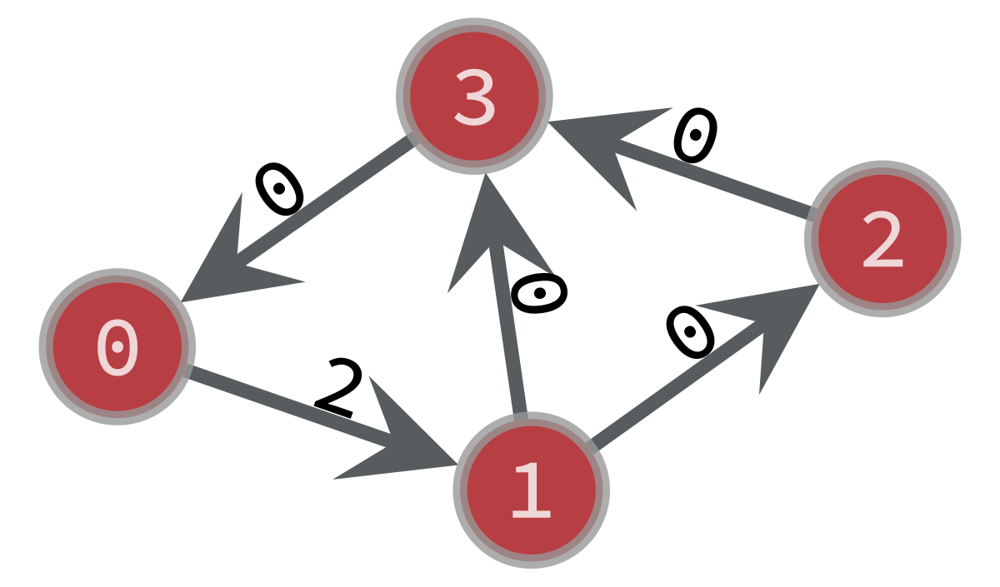

Graph G0 taken from Gr: 


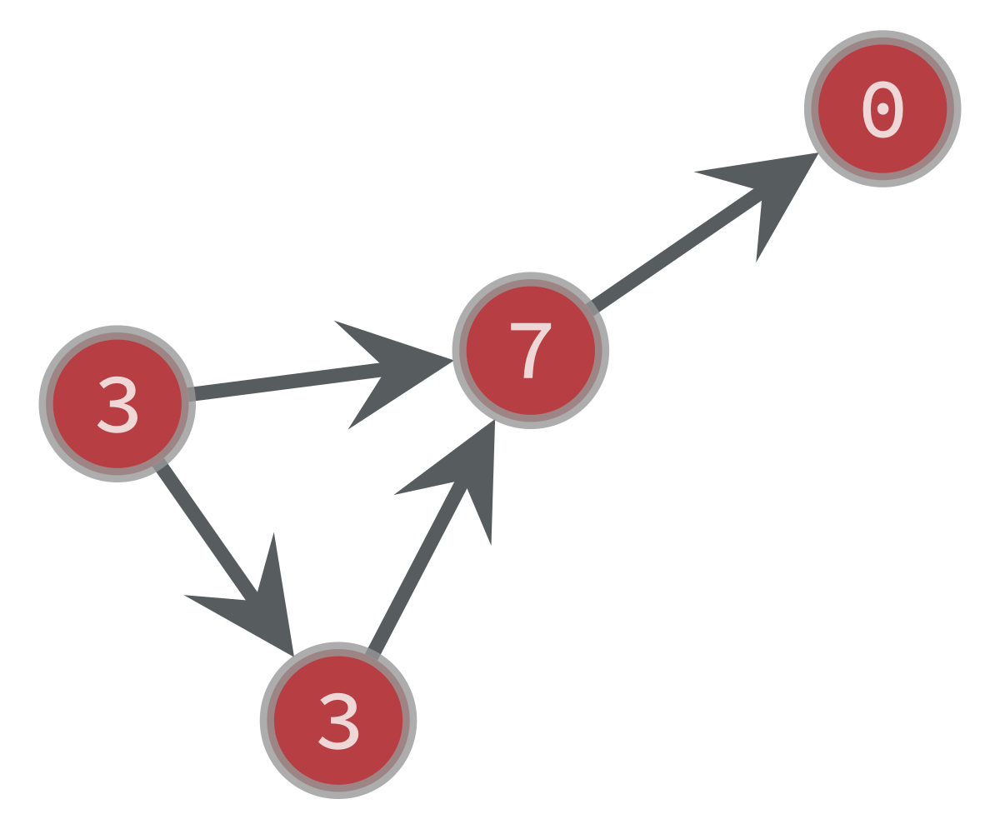

Clock Period of the graph is: 13 with value of c as: 10.0
Test with C: 13.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
0.0
0.0
0.0
0.0
New Graph Gr: 


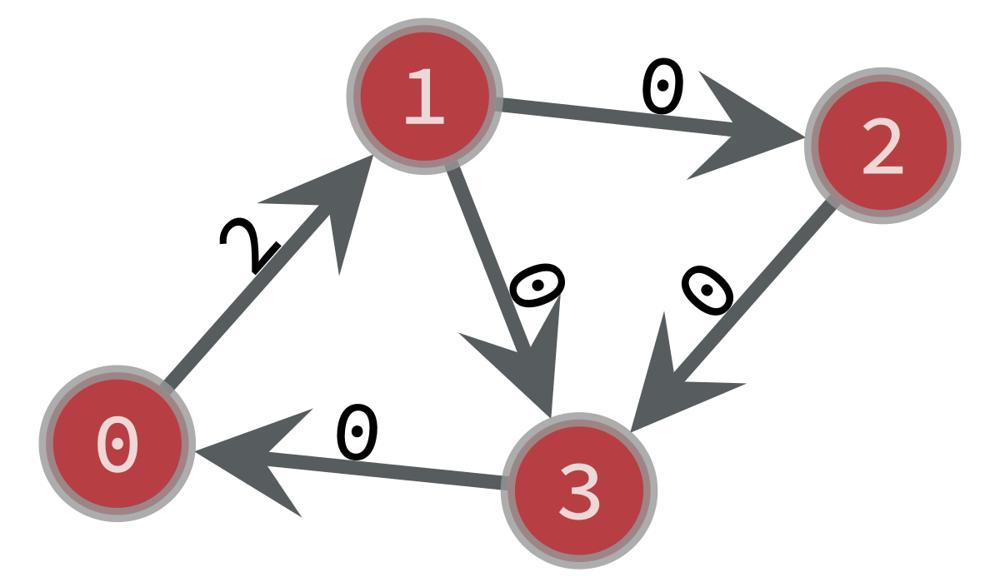

Graph G0 taken from Gr: 


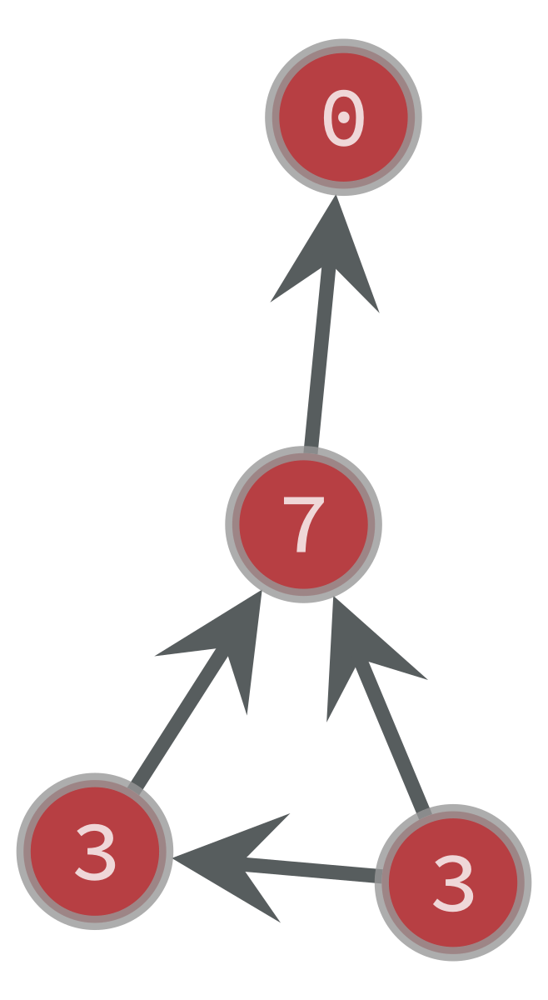

Clock Period of the graph is: 13 with value of c as: 13.0
Minimum Clock Period is: 7 with c: 7.0
[-1.0, 0.0, 0.0, -1.0]


In [115]:
print(OPT1(g))

([<Vertex object with index '0' at 0x7f6a215c4bd0>, 1], [<Edge object with source '0' and target '1' at 0x7f6a215c55b0>])
PATH 0: 
[<Vertex object with index '0' at 0x7f6a215c4bd0>, 1]
PATH 1: 
[<Edge object with source '0' and target '1' at 0x7f6a215c55b0>]
(0, 1)
0
2
0
0
([<Vertex object with index '0' at 0x7f6a215cf8d0>, <Vertex object with index '1' at 0x7f6a215c4c30>, 2], [<Edge object with source '0' and target '1' at 0x7f6a215c5eb0>, <Edge object with source '1' and target '2' at 0x7f6a215c5730>])
PATH 0: 
[<Vertex object with index '0' at 0x7f6a215cf8d0>, <Vertex object with index '1' at 0x7f6a215c4c30>, 2]
PATH 1: 
[<Edge object with source '0' and target '1' at 0x7f6a215c5eb0>, <Edge object with source '1' and target '2' at 0x7f6a215c5730>]
(0, 1)
0
2
0
0
(1, 2)
2
0
0
-3
([<Vertex object with index '0' at 0x7f6a215cfa50>, <Vertex object with index '1' at 0x7f6a215c4e10>, 3], [<Edge object with source '0' and target '1' at 0x7f6a215c5830>, <Edge object with source '1' and targ

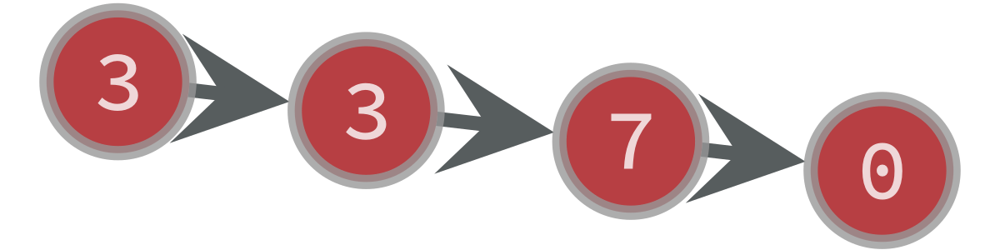

FEAS Algorithm finished with c: 0.0
Clock Period of the graph is: 13
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 13
No feasible retiming exists.
Test with C: 3.0
Final graph created with FEAS: 


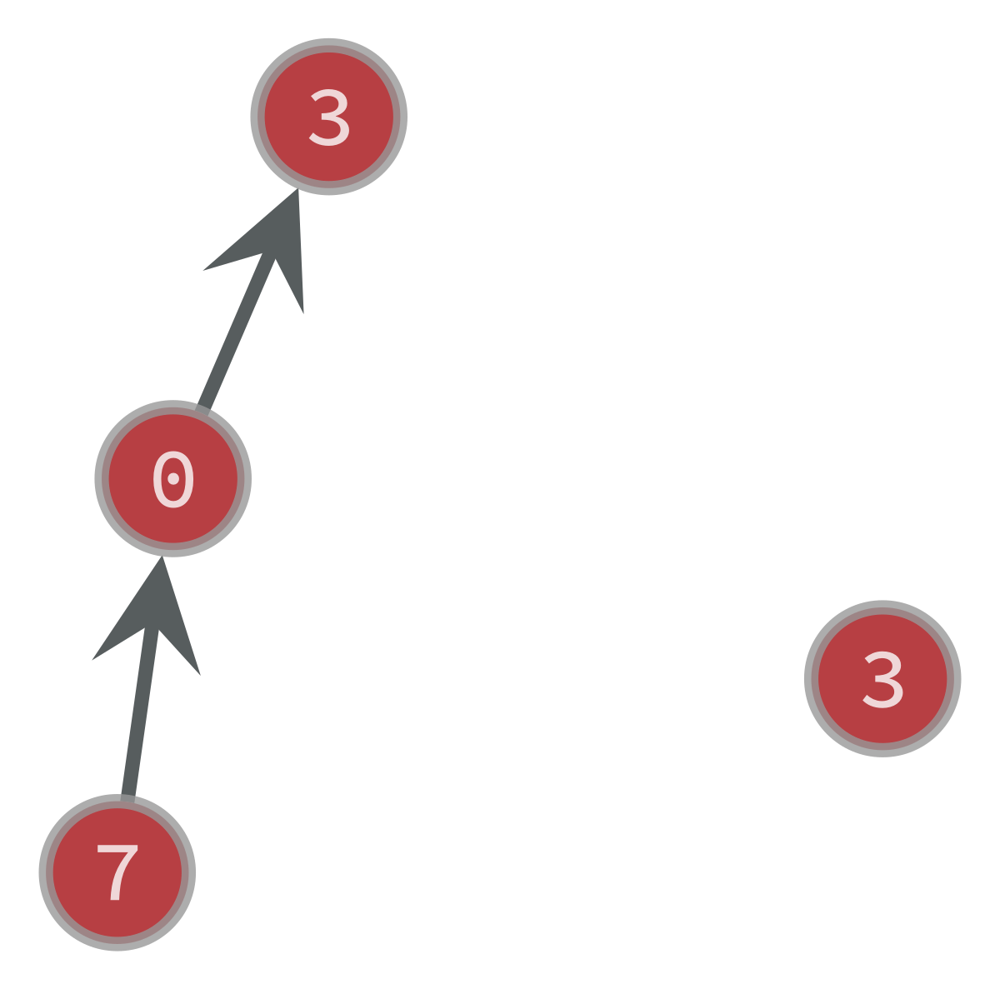

FEAS Algorithm finished with c: 3.0
Clock Period of the graph is: 10
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 10
No feasible retiming exists.
Test with C: 6.0
Final graph created with FEAS: 


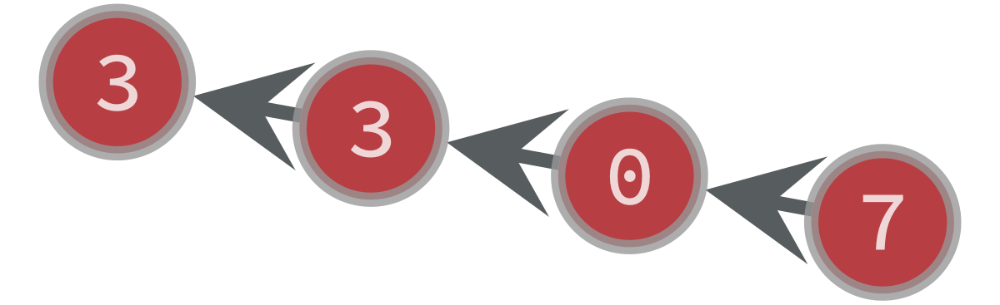

FEAS Algorithm finished with c: 6.0
Clock Period of the graph is: 13
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 13
No feasible retiming exists.
Test with C: 7.0
Final graph created with FEAS: 


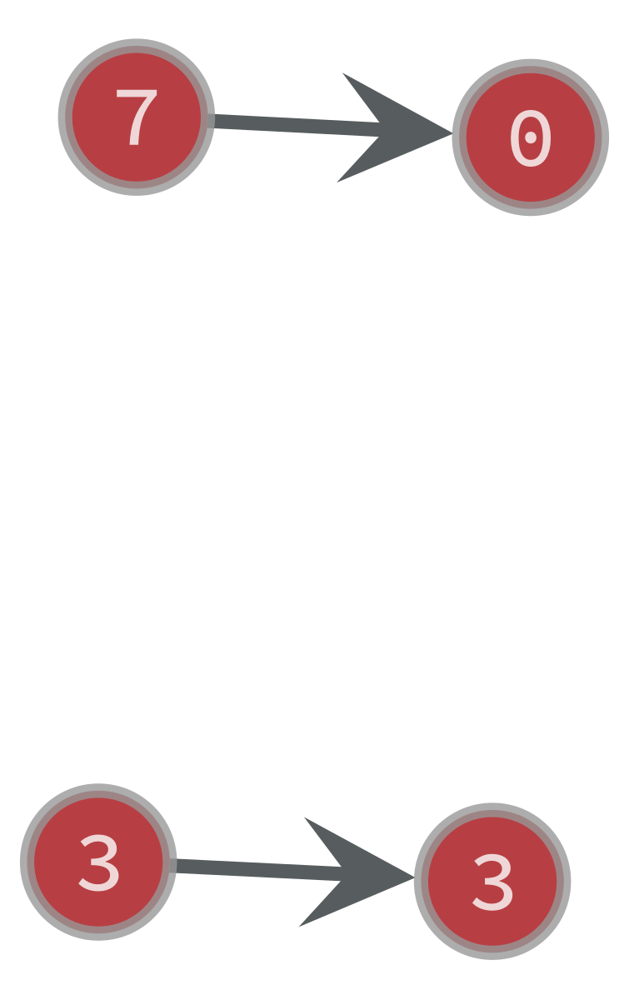

FEAS Algorithm finished with c: 7.0
Clock Period of the graph is: 7
Retiming: [1, 0, 0, 1] is the desired retiming.
Clock Period of the graph (OPT2) is: 7
Retiming: [1, 0, 0, 1] is the desired retiming.
Test with C: 10.0
Final graph created with FEAS: 


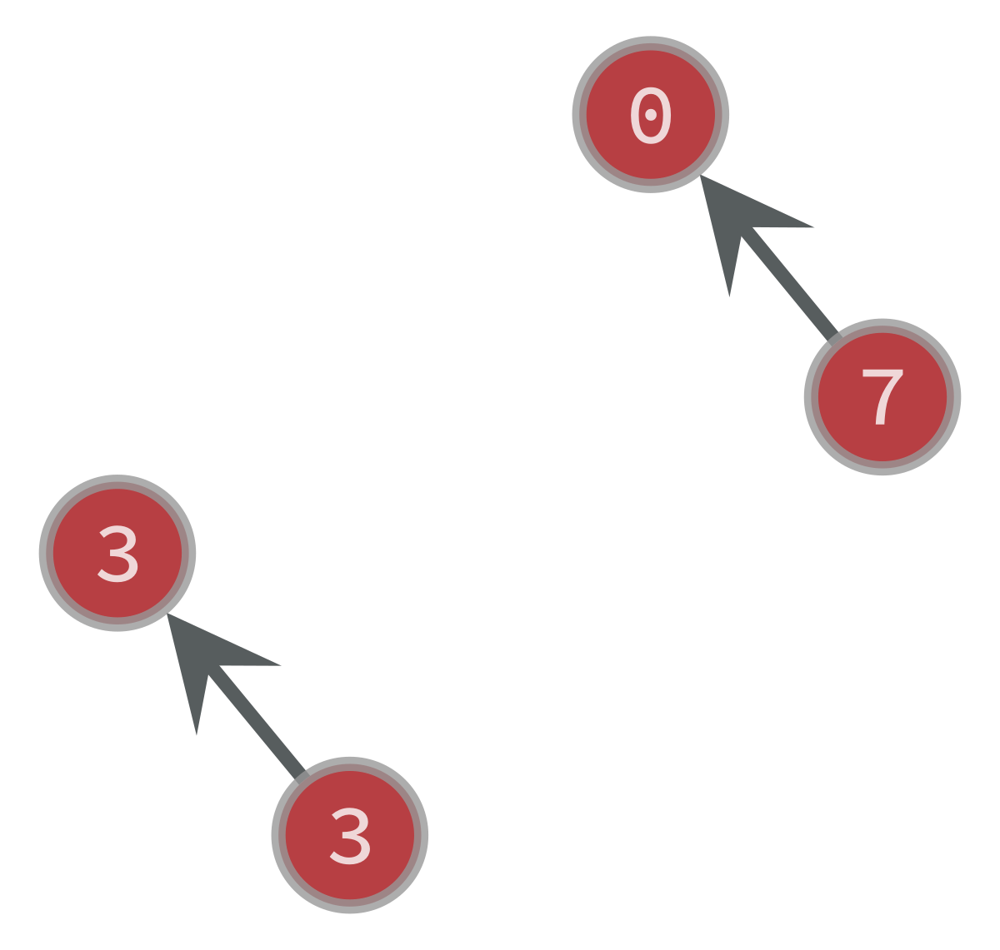

FEAS Algorithm finished with c: 10.0
Clock Period of the graph is: 7
Retiming: [1, 0, 0, 1] is the desired retiming.
Clock Period of the graph (OPT2) is: 7
It doesn't improve the retiming.
Test with C: 13.0
Final graph created with FEAS: 


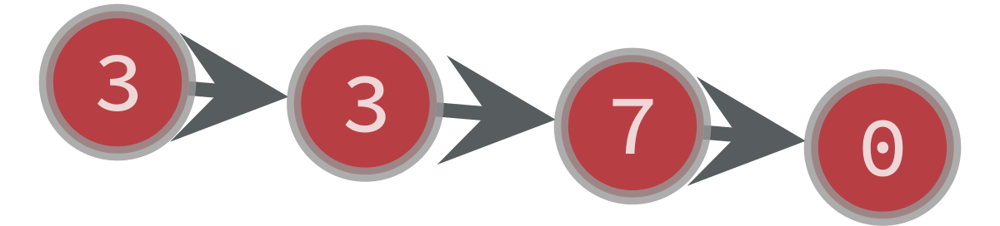

FEAS Algorithm finished with c: 13.0
Clock Period of the graph is: 13
Retiming: [0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 13
It doesn't improve the retiming.
Minimum Achievable Clock Period is: 7 with retiming: [1, 0, 0, 1]
(7, [1, 0, 0, 1])


In [116]:
print(OPT2(g))

# Testing Code

In [146]:
g100 = gt.load_graph("my_graph2.xml.gz")

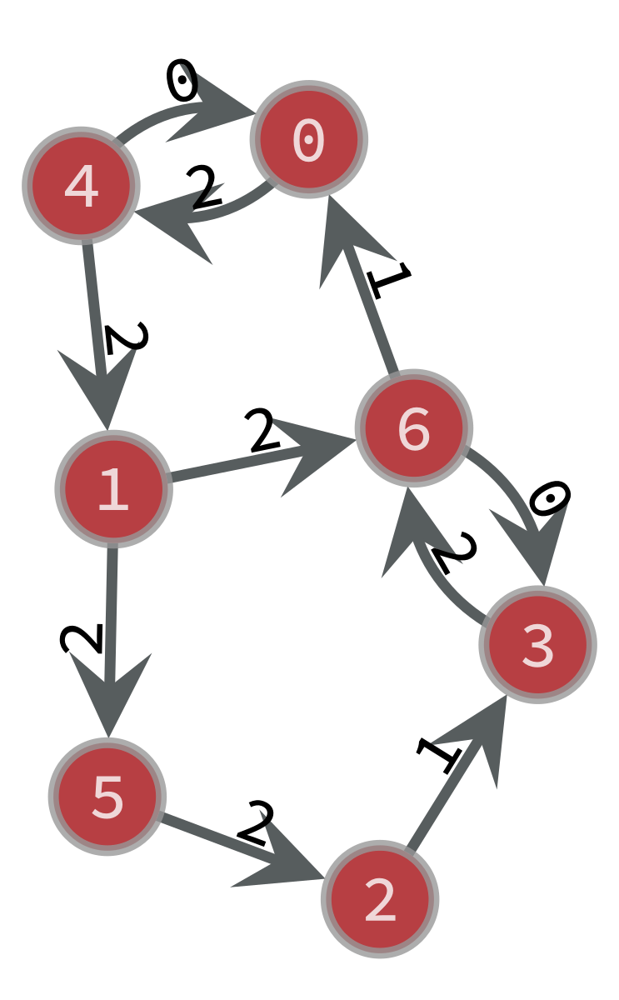

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x7f6a215c3550, at 0x7f6a21586130>

In [147]:
gt.graph_draw(g100, vertex_text=g100.vp.cap, edge_text=g100.ep.weight)

W Matrix: 
[[ 0.  4.  8.  6.  2.  6.  6.]
 [ 3.  0.  4.  2.  5.  2.  2.]
 [ 4.  8.  0.  1.  6. 10.  3.]
 [ 3.  7. 11.  0.  5.  9.  2.]
 [ 0.  2.  6.  4.  0.  4.  4.]
 [ 6. 10.  2.  3.  8.  0.  5.]
 [ 1.  5.  9.  0.  3.  7.  0.]]
D Matrix: 
[[ 0.  5. 12. 14.  4. 10. 11.]
 [ 7.  1.  8. 10. 11.  6.  7.]
 [11. 16.  2.  5. 15. 21. 11.]
 [ 9. 14. 21.  3. 13. 19.  9.]
 [ 4.  5. 12. 14.  4. 10. 11.]
 [16. 21.  7. 10. 20.  5. 16.]
 [ 6. 11. 18.  9. 10. 16.  6.]]
Test with C: 0.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


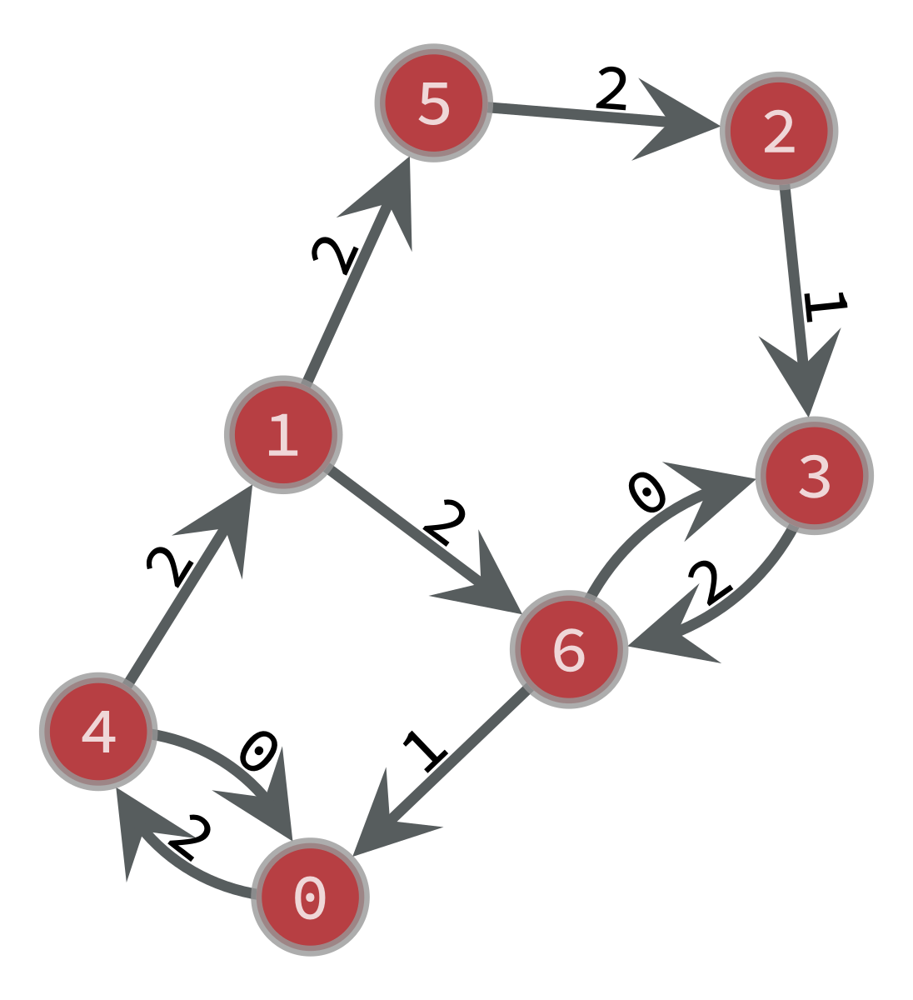

Graph G0 taken from Gr: 


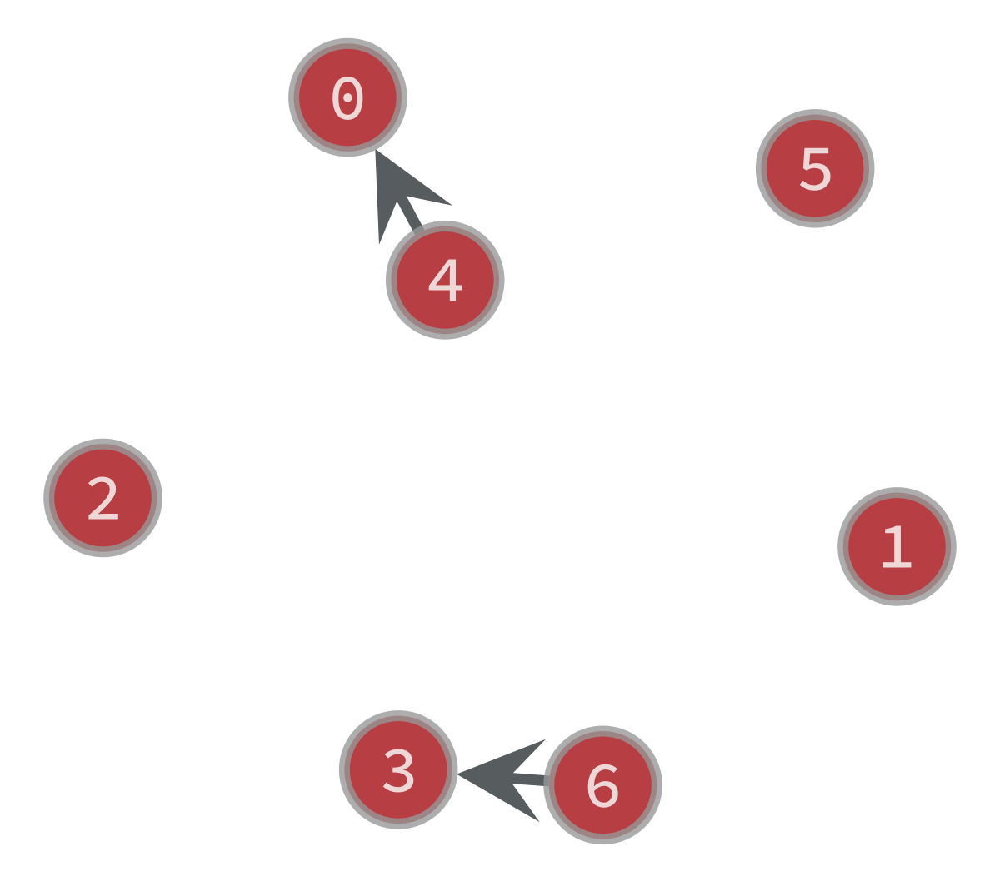

Clock Period of the graph is: 9 with value of c as: 0.0
Test with C: 1.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


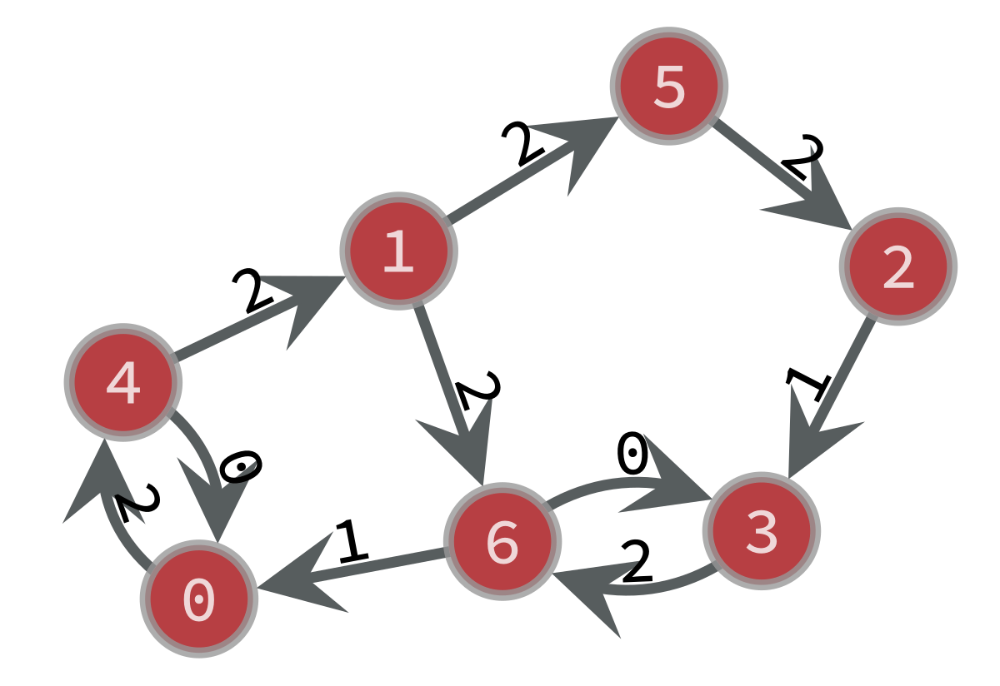

Graph G0 taken from Gr: 


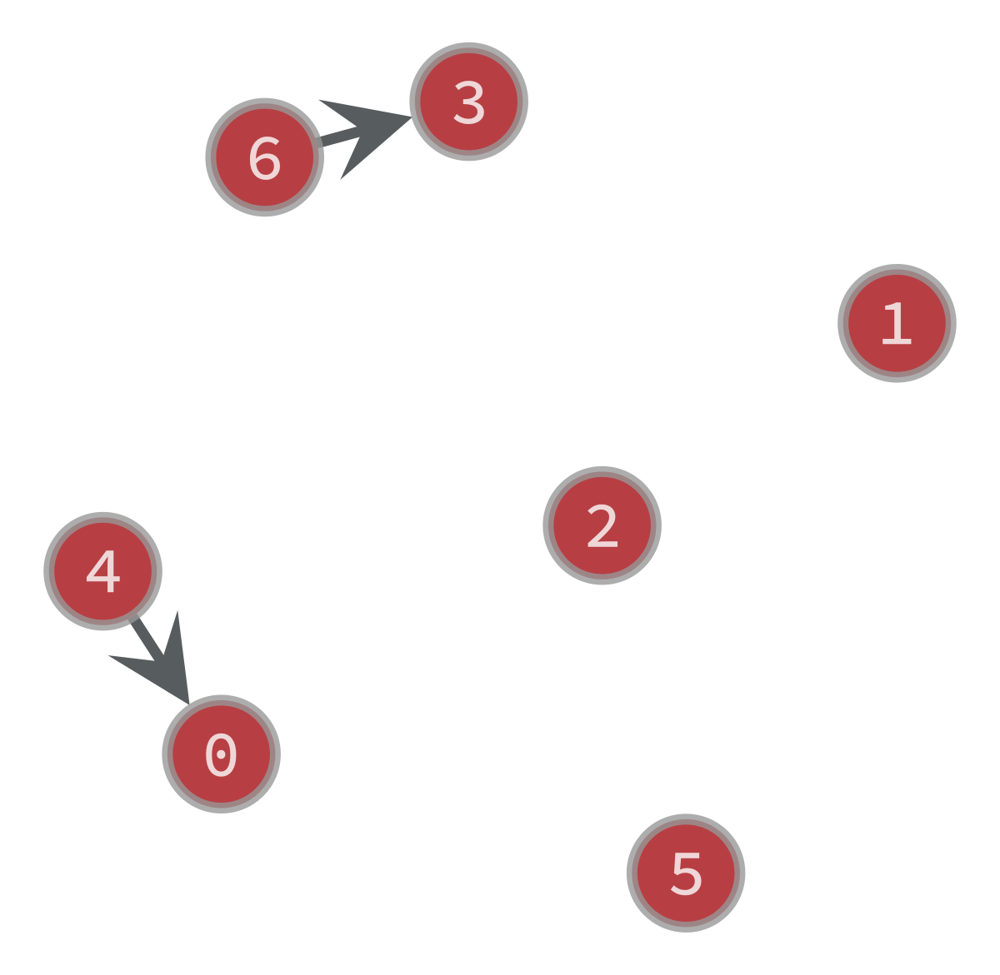

Clock Period of the graph is: 9 with value of c as: 1.0
Test with C: 2.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


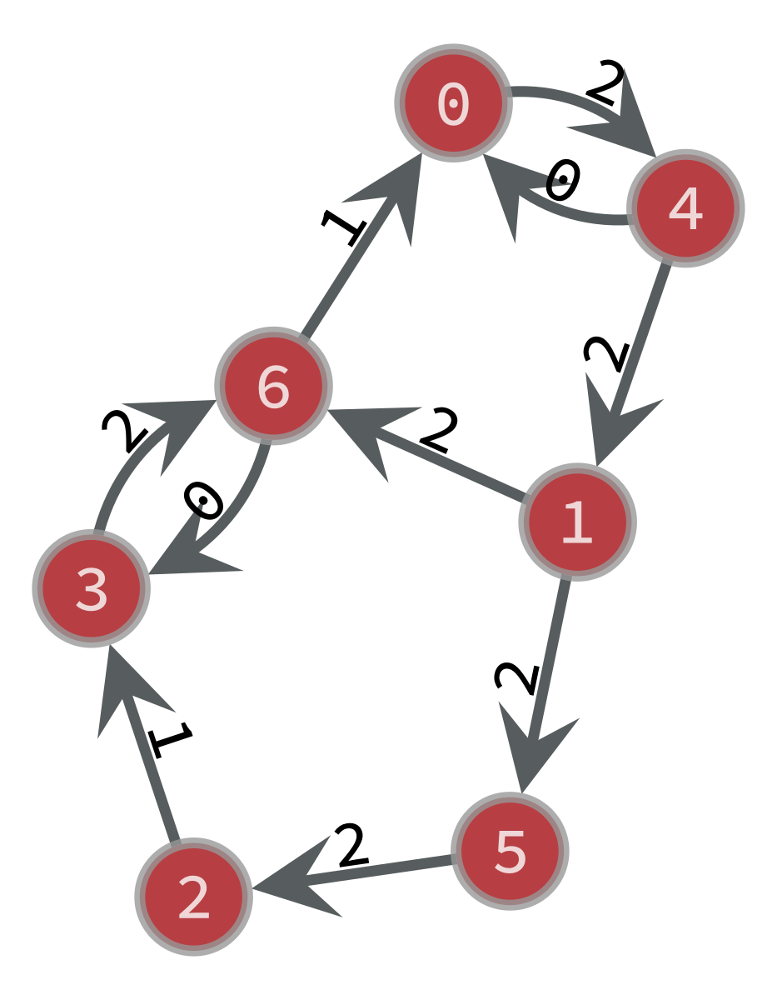

Graph G0 taken from Gr: 


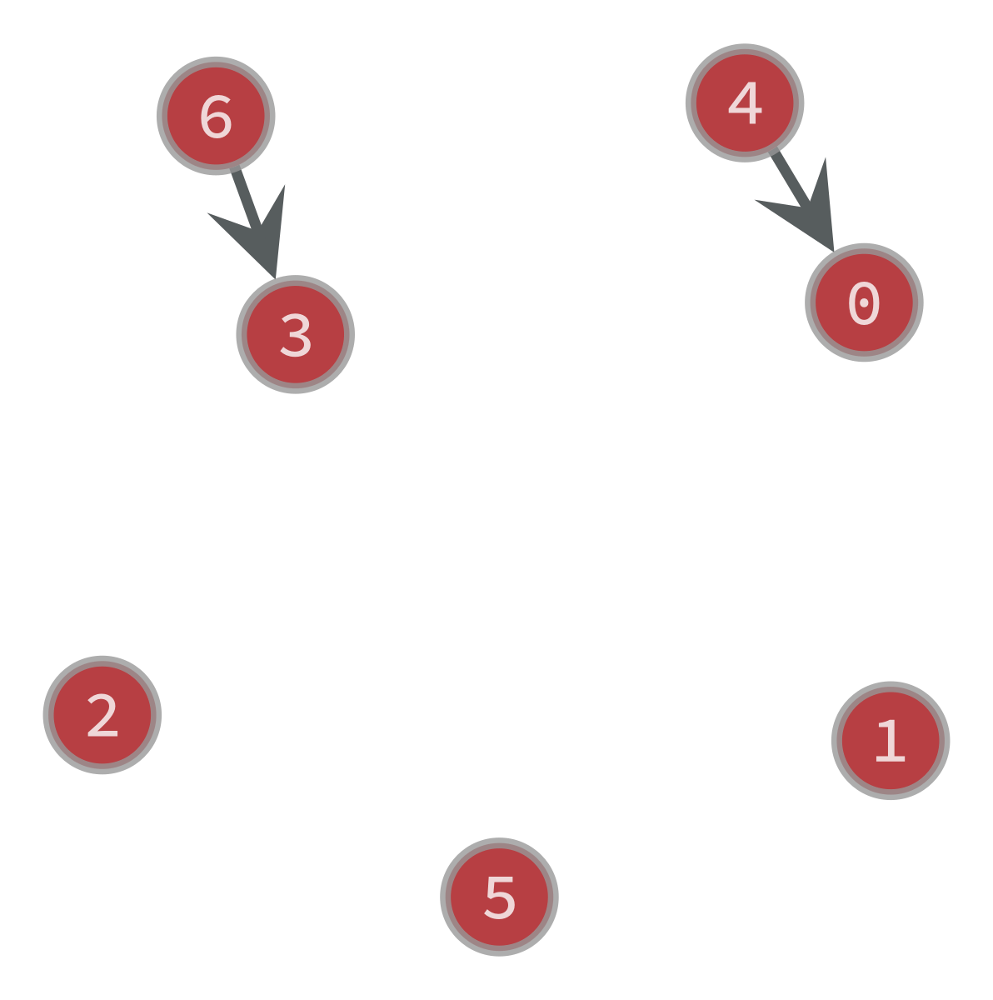

Clock Period of the graph is: 9 with value of c as: 2.0
Test with C: 3.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


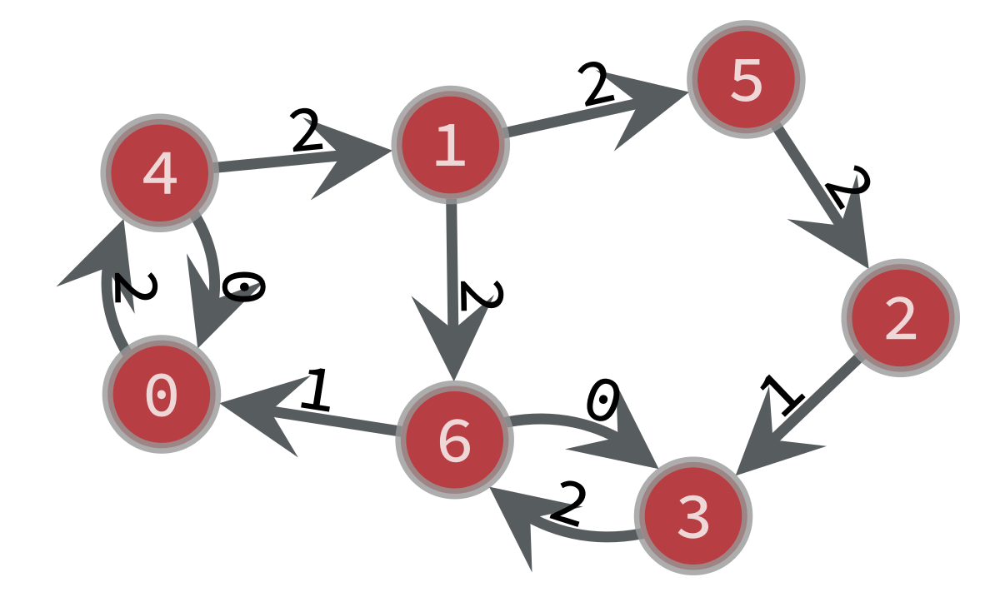

Graph G0 taken from Gr: 


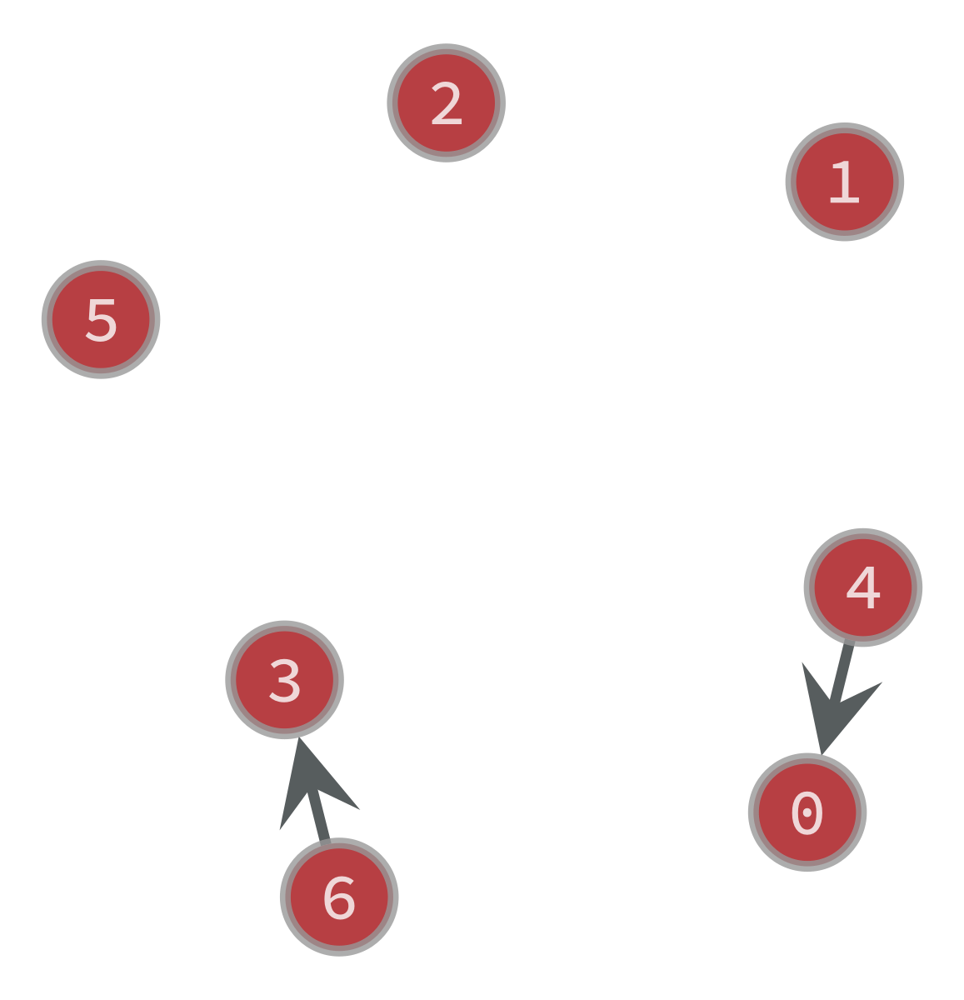

Clock Period of the graph is: 9 with value of c as: 3.0
Test with C: 4.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


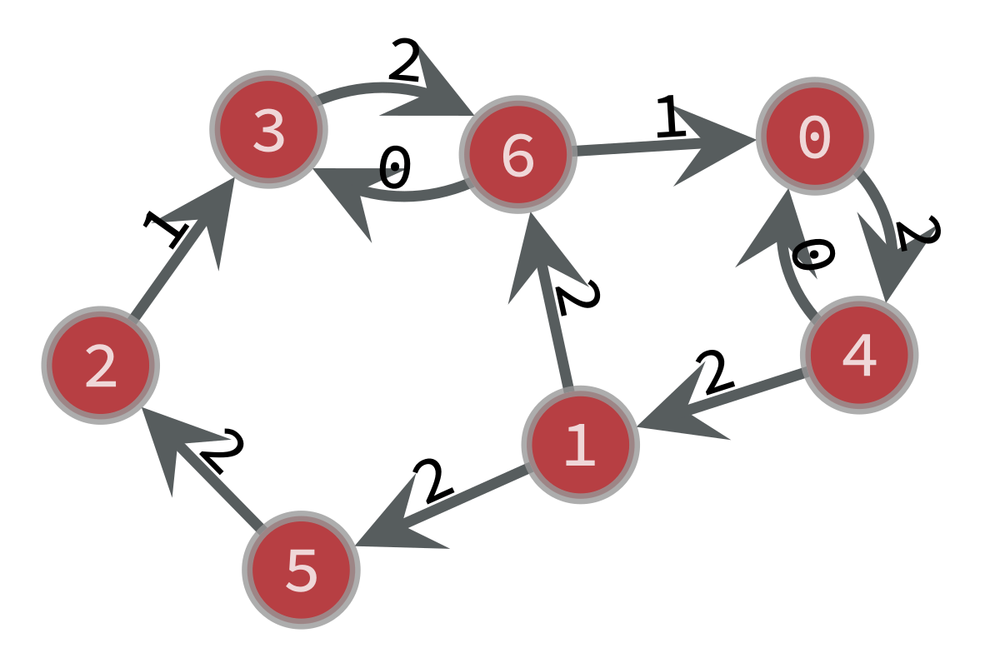

Graph G0 taken from Gr: 


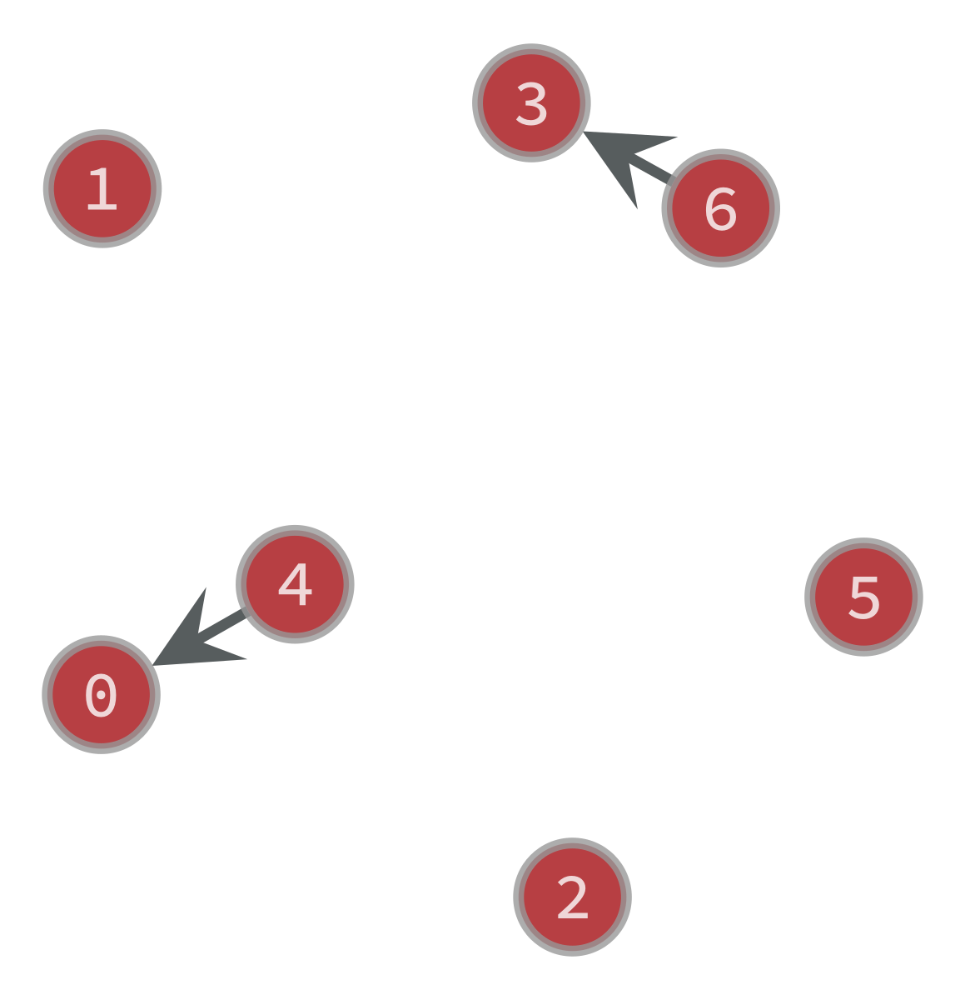

Clock Period of the graph is: 9 with value of c as: 4.0
Test with C: 5.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


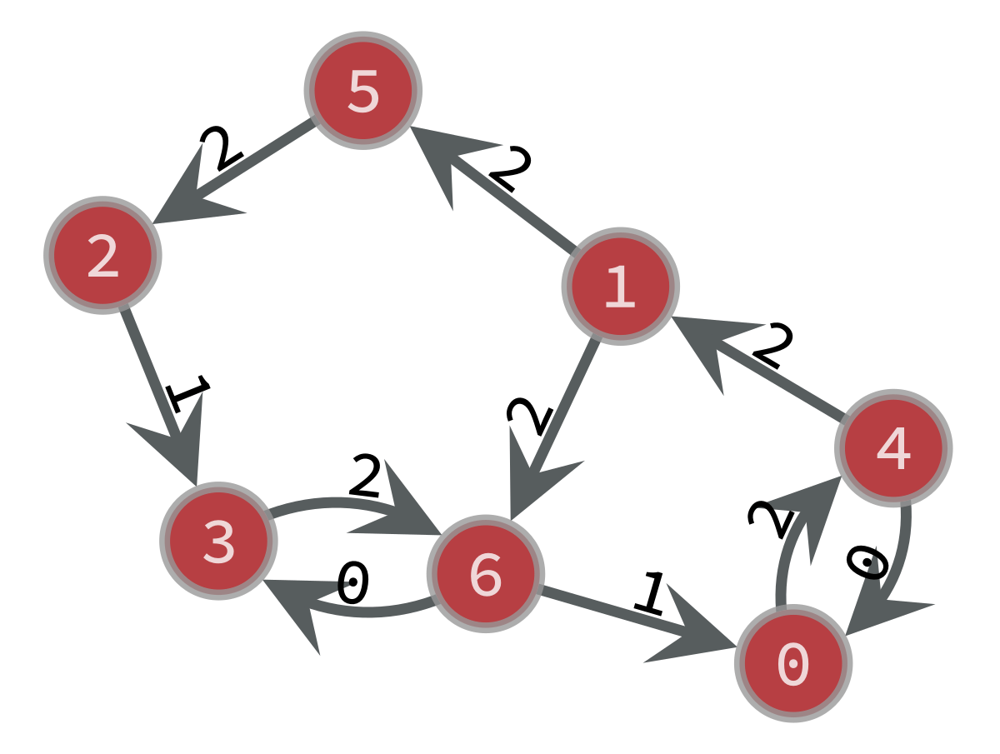

Graph G0 taken from Gr: 


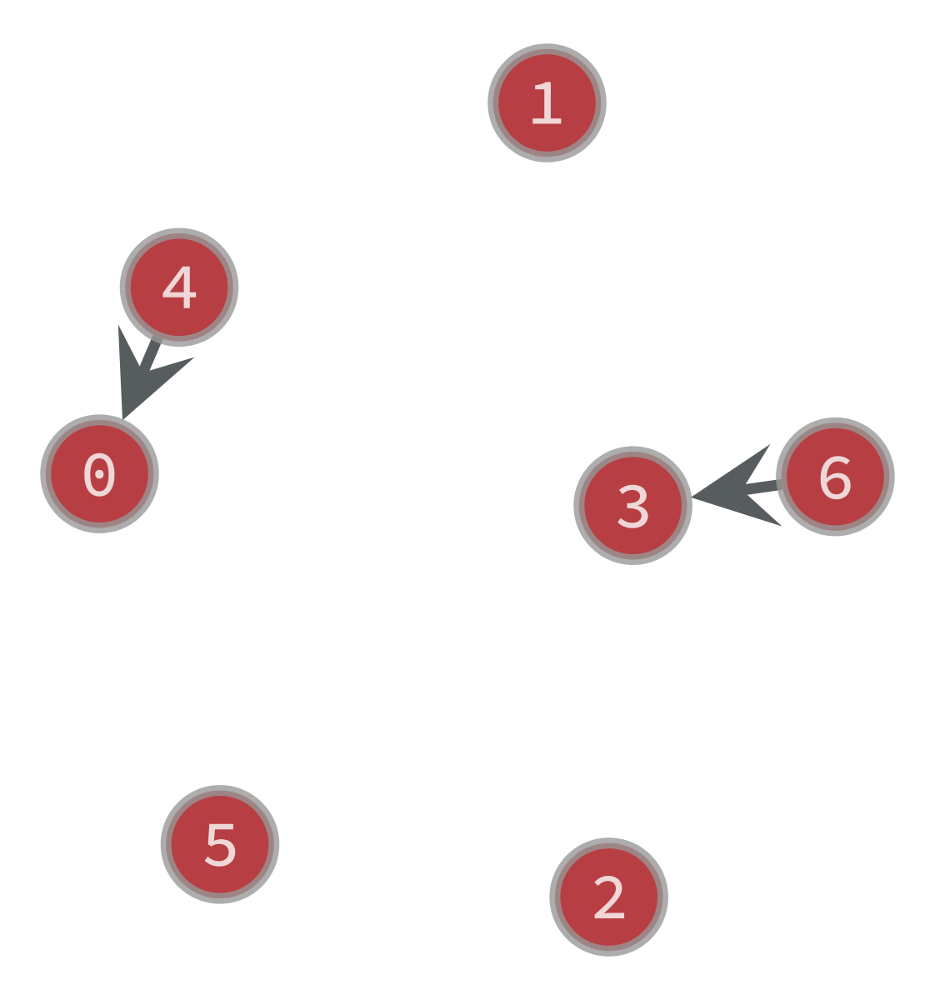

Clock Period of the graph is: 9 with value of c as: 5.0
Test with C: 6.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: -1.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
-1.0
0.0
0.0
0.0
New Graph Gr: 


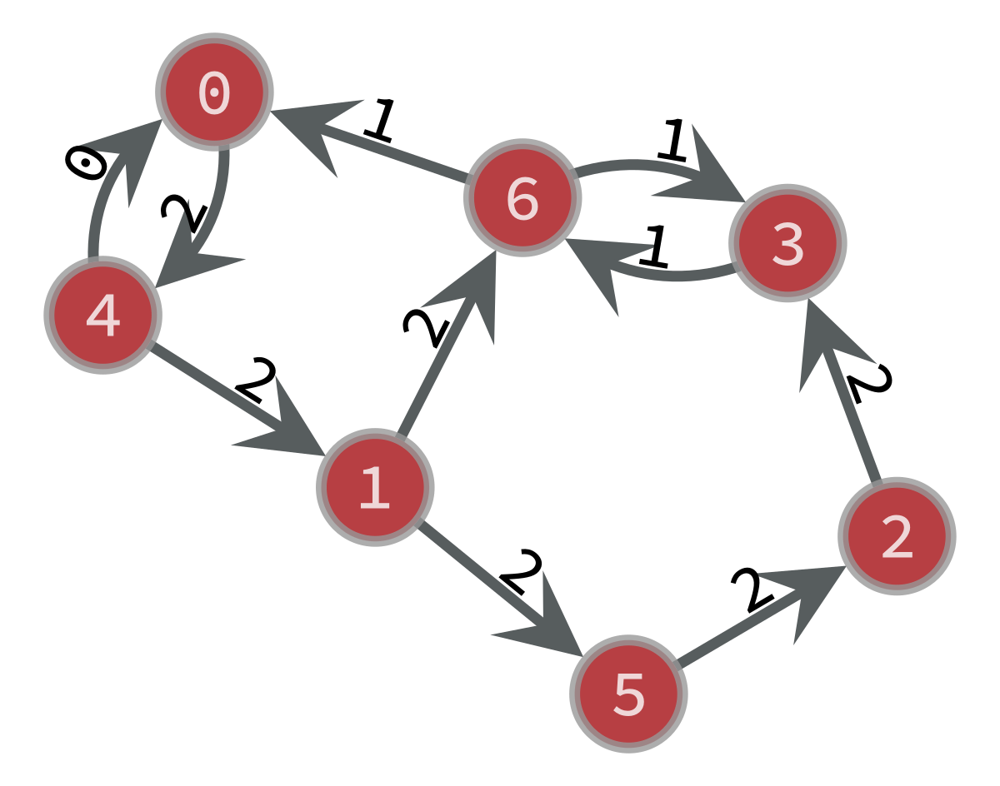

Graph G0 taken from Gr: 


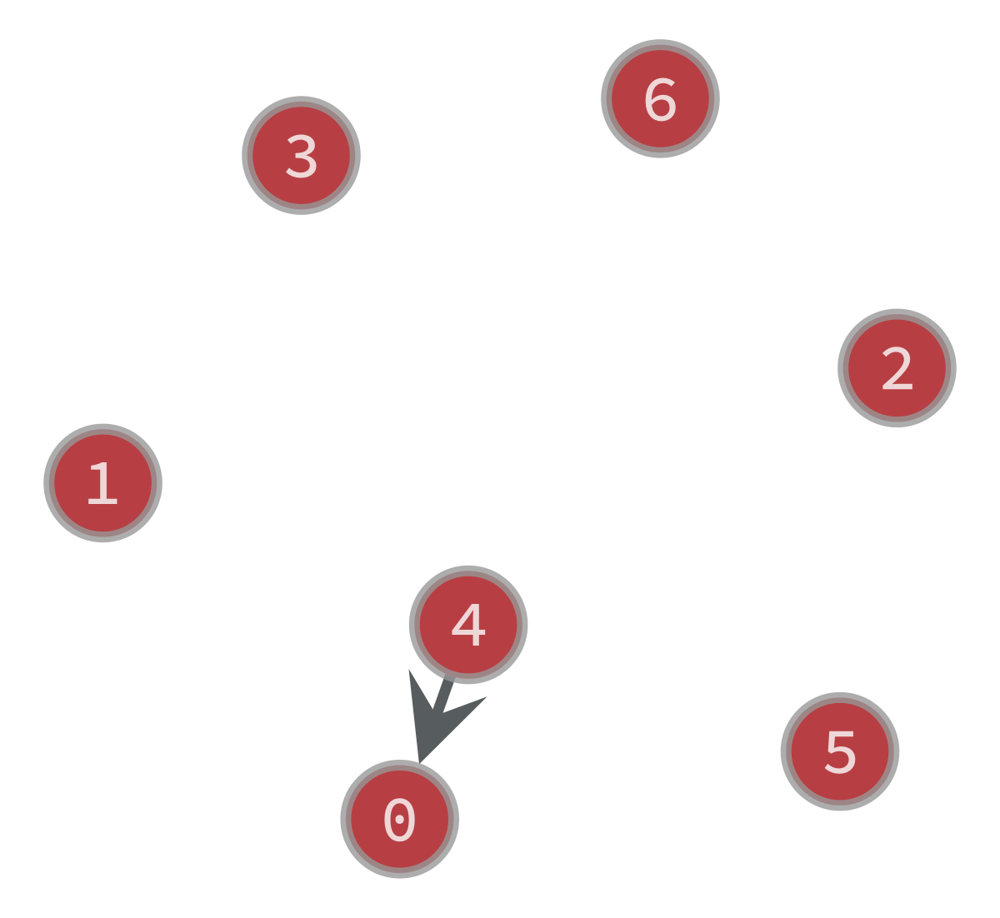

Clock Period of the graph is: 6 with value of c as: 6.0
Test with C: 7.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: -1.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
-1.0
0.0
0.0
0.0
New Graph Gr: 


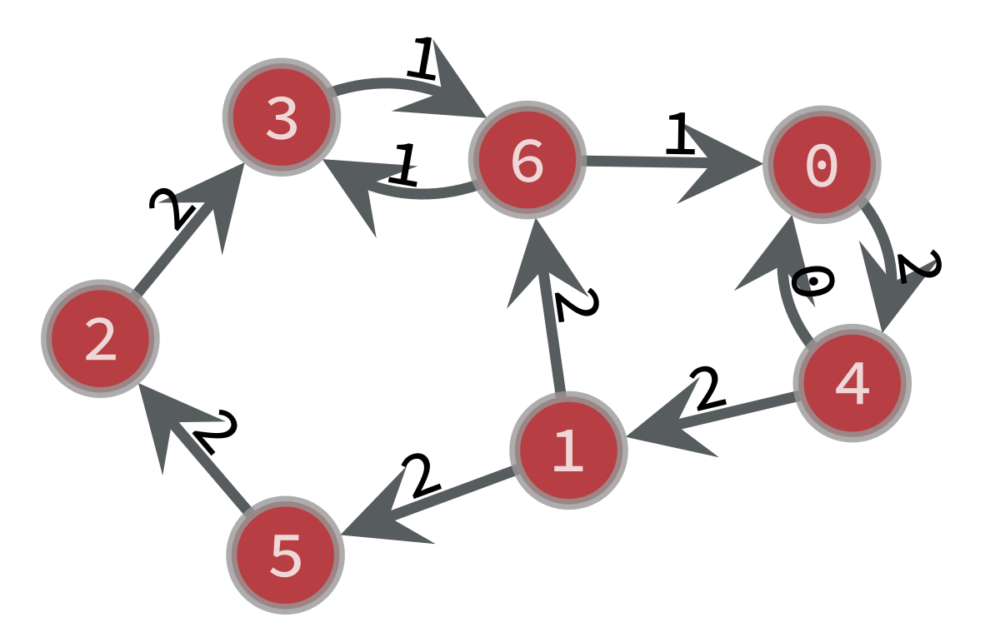

Graph G0 taken from Gr: 


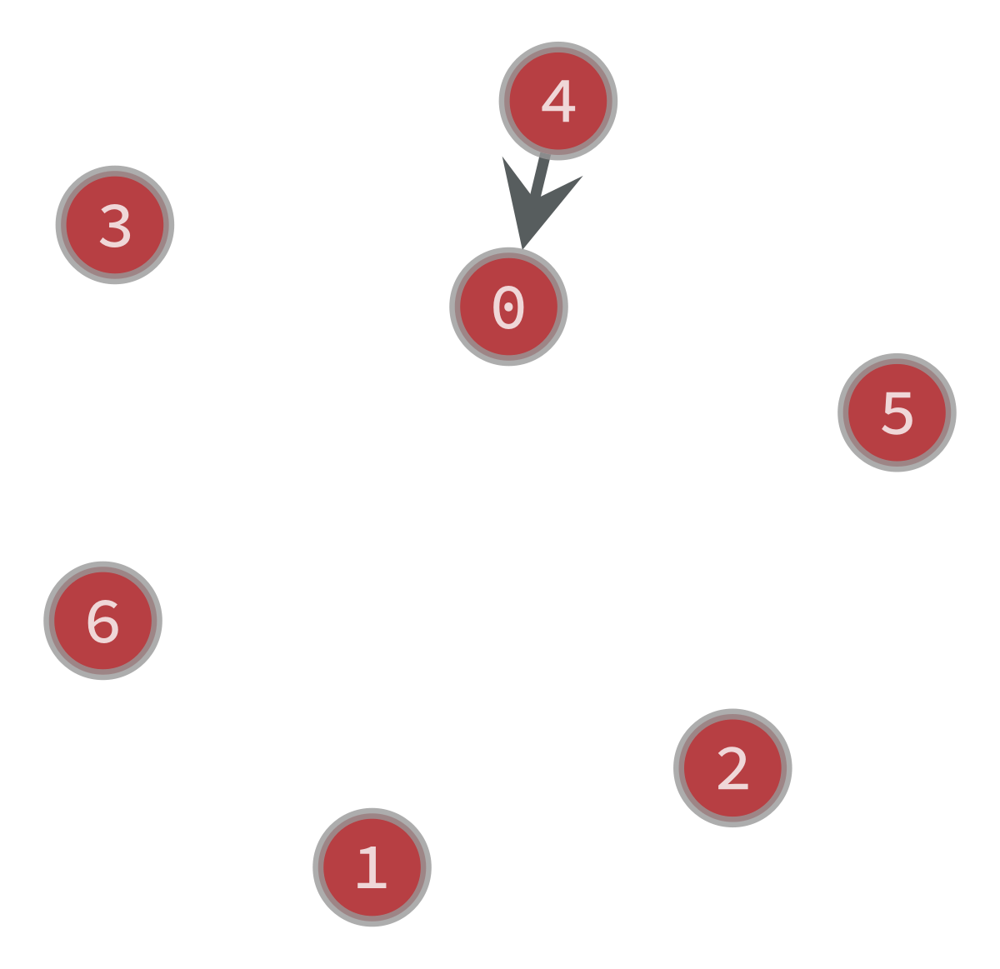

Clock Period of the graph is: 6 with value of c as: 7.0
Test with C: 8.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: -1.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
-1.0
0.0
0.0
0.0
New Graph Gr: 


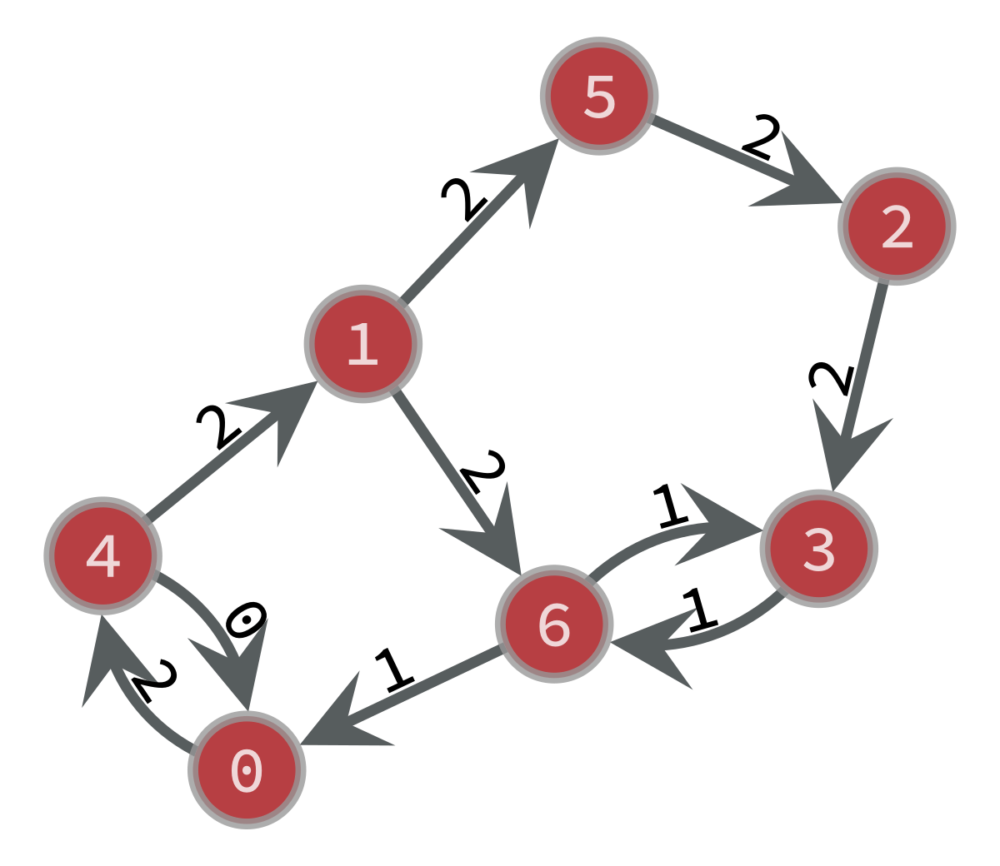

Graph G0 taken from Gr: 


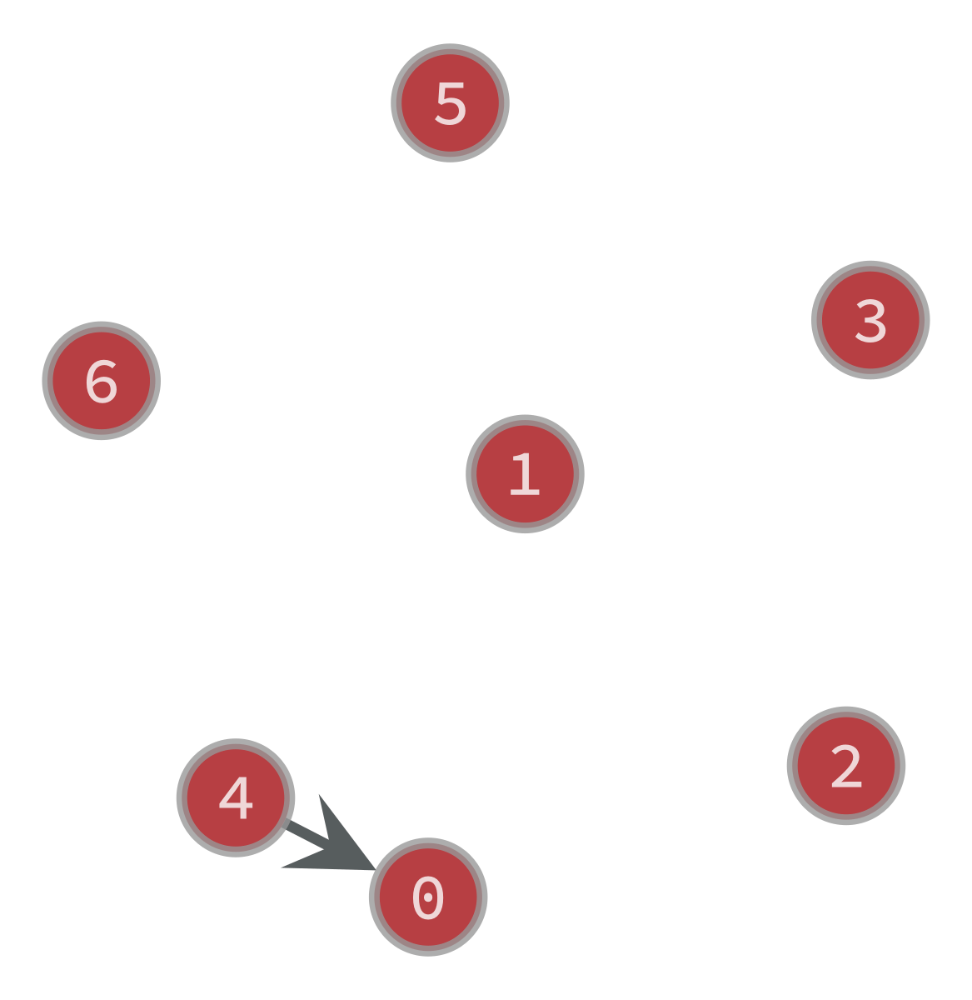

Clock Period of the graph is: 6 with value of c as: 8.0
Test with C: 9.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


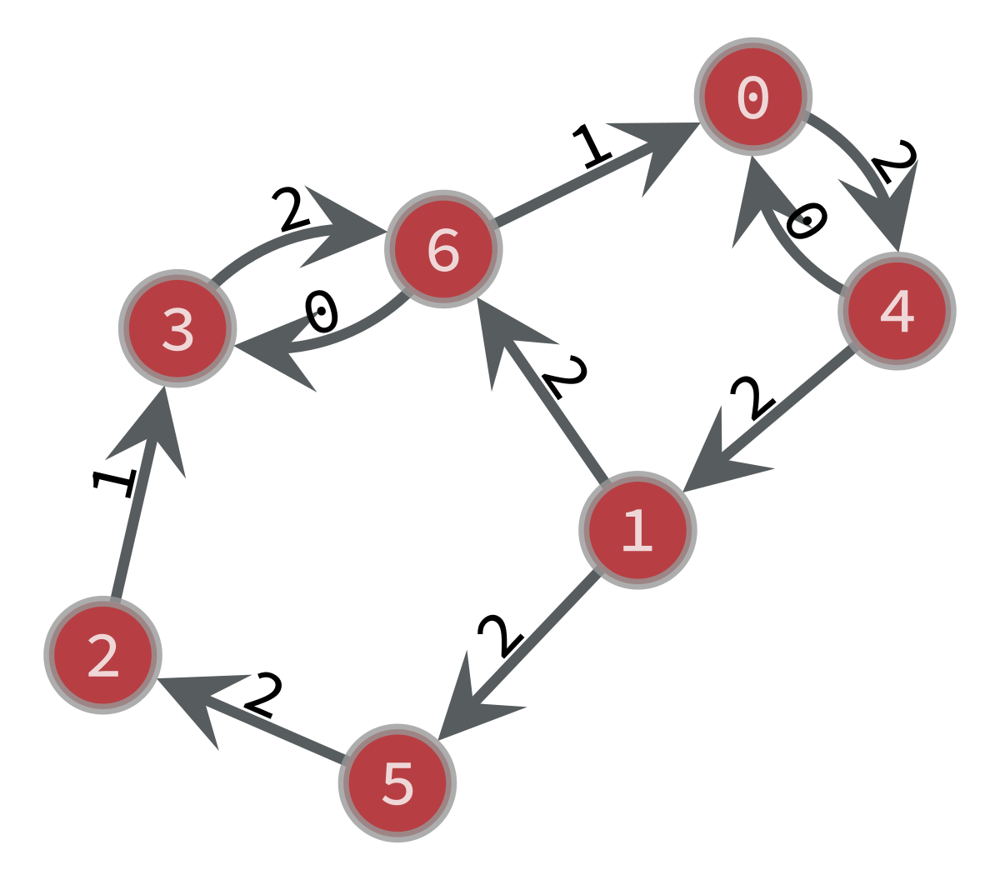

Graph G0 taken from Gr: 


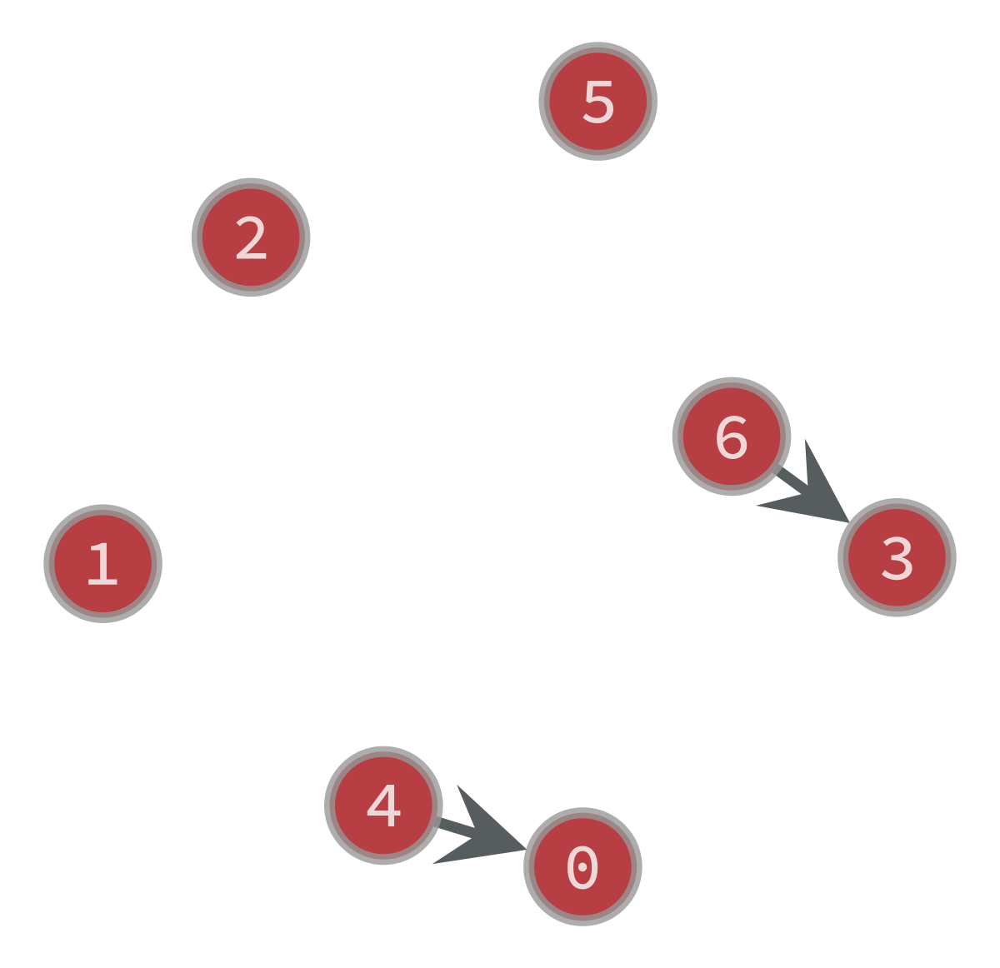

Clock Period of the graph is: 9 with value of c as: 9.0
Test with C: 10.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


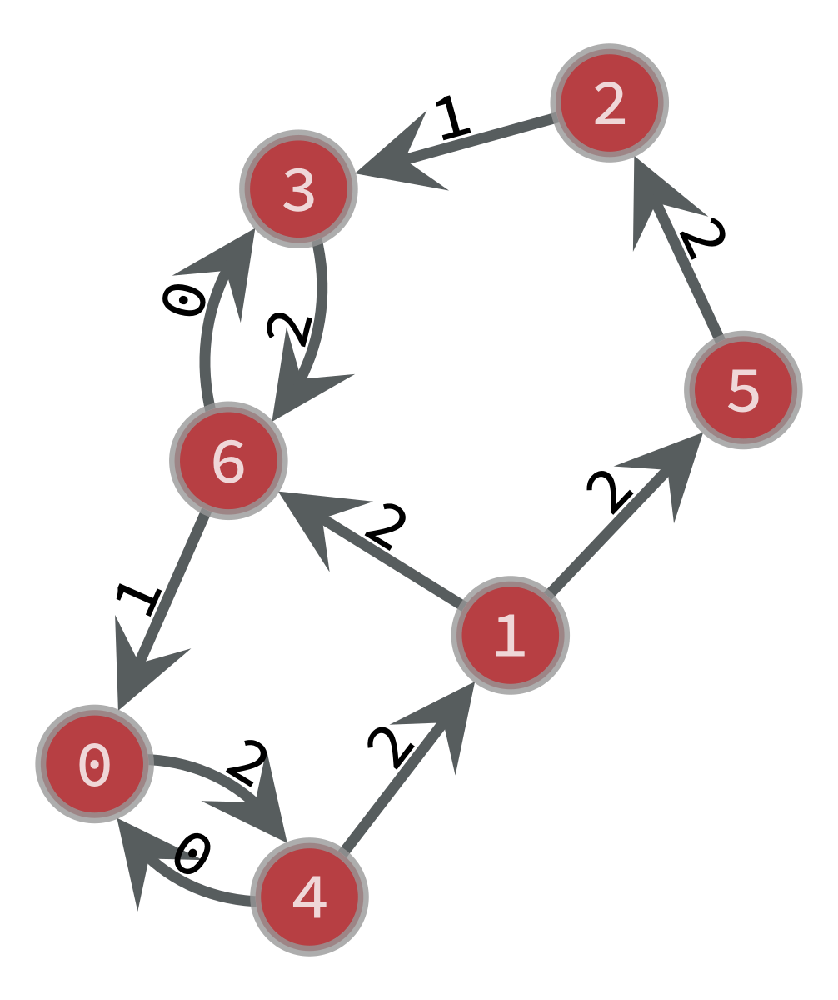

Graph G0 taken from Gr: 


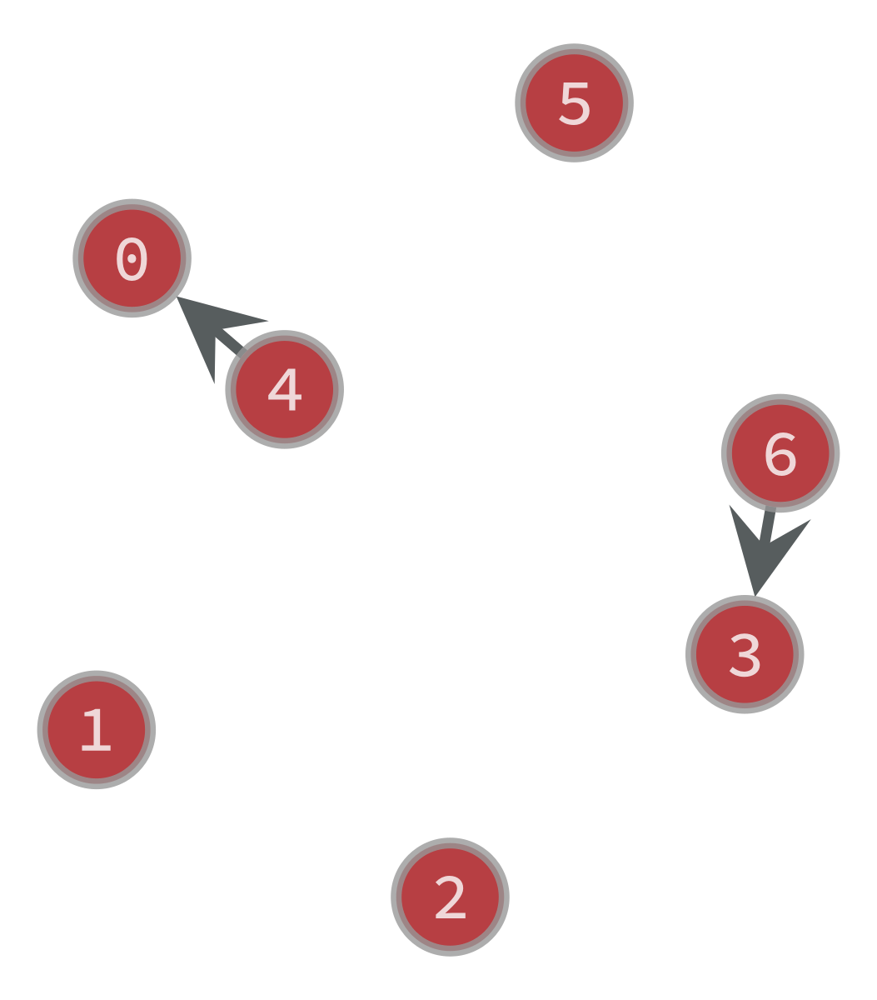

Clock Period of the graph is: 9 with value of c as: 10.0
Test with C: 11.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


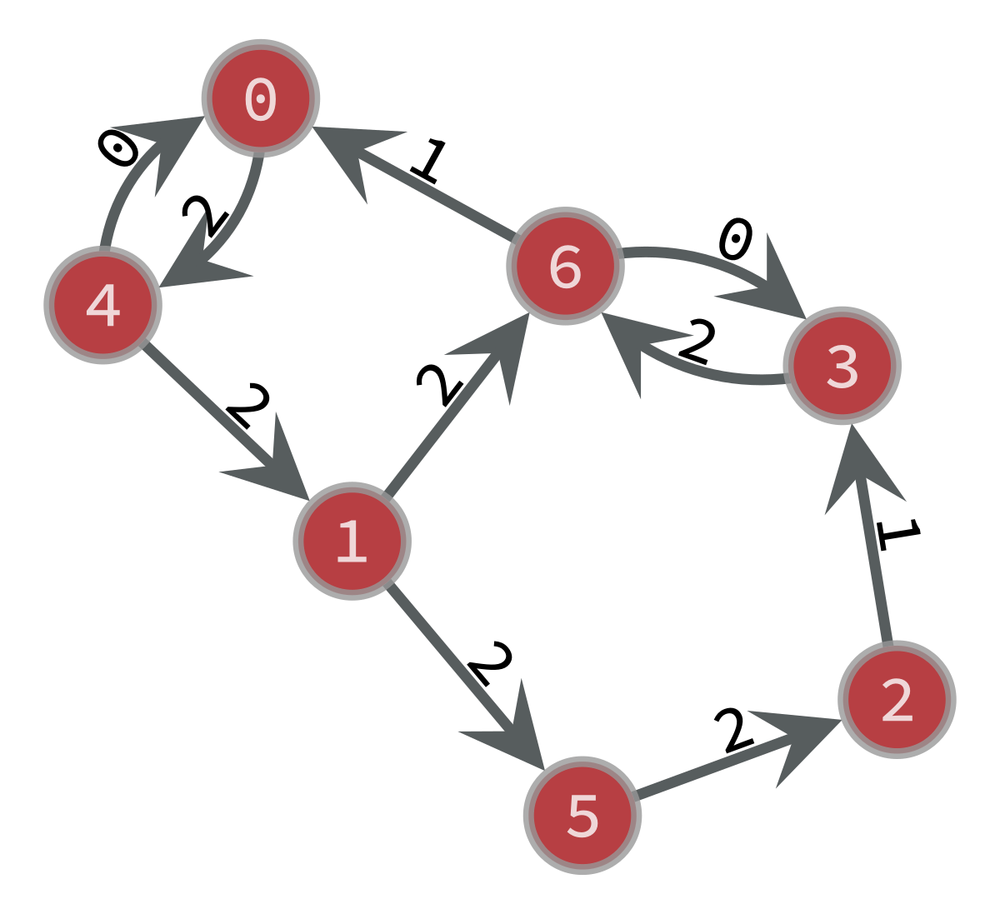

Graph G0 taken from Gr: 


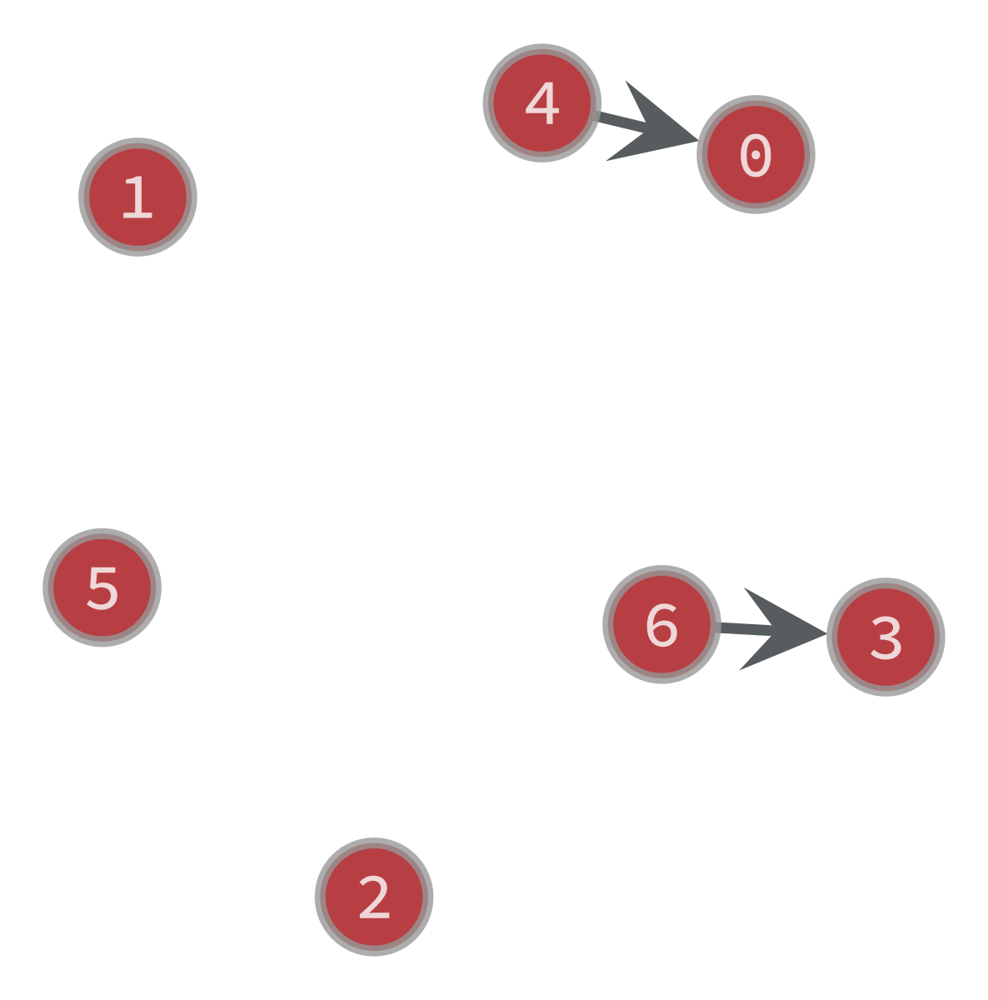

Clock Period of the graph is: 9 with value of c as: 11.0
Test with C: 12.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


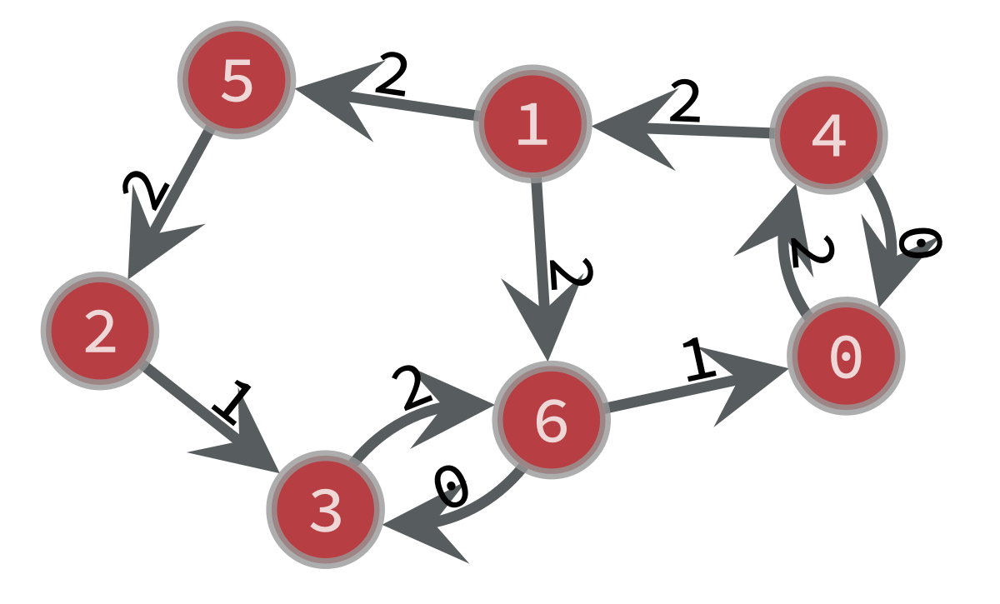

Graph G0 taken from Gr: 


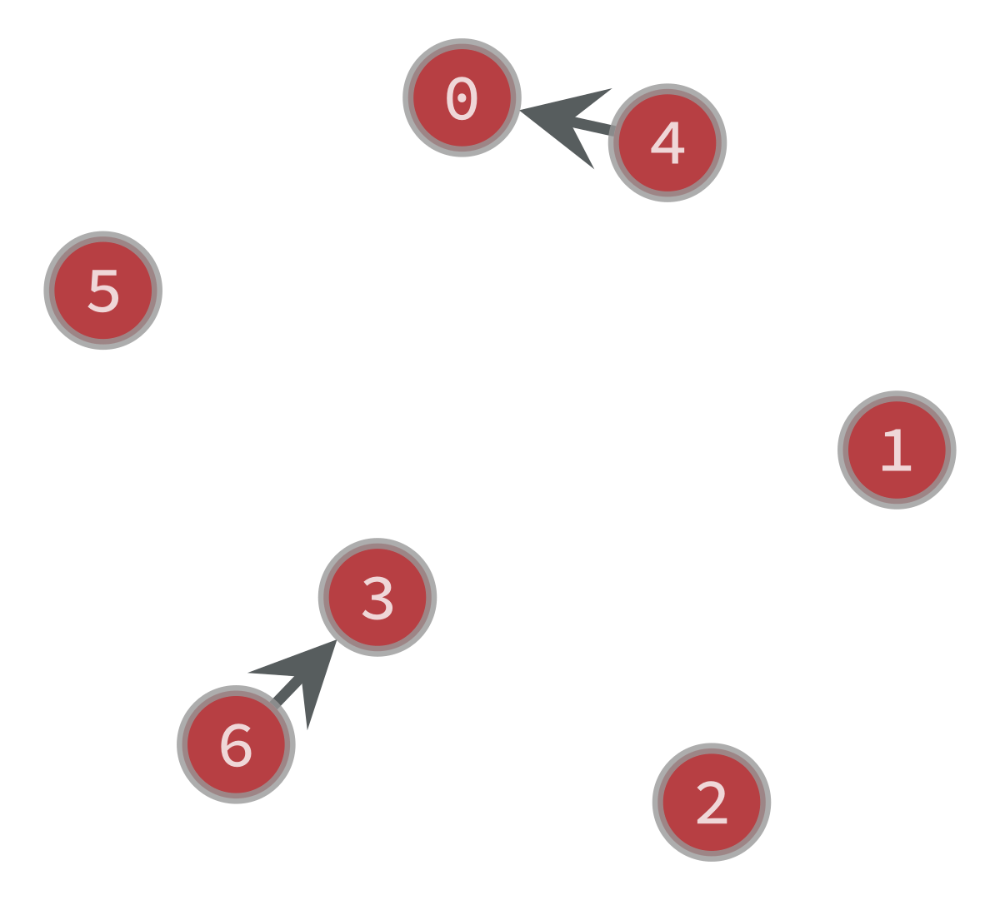

Clock Period of the graph is: 9 with value of c as: 12.0
Test with C: 13.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


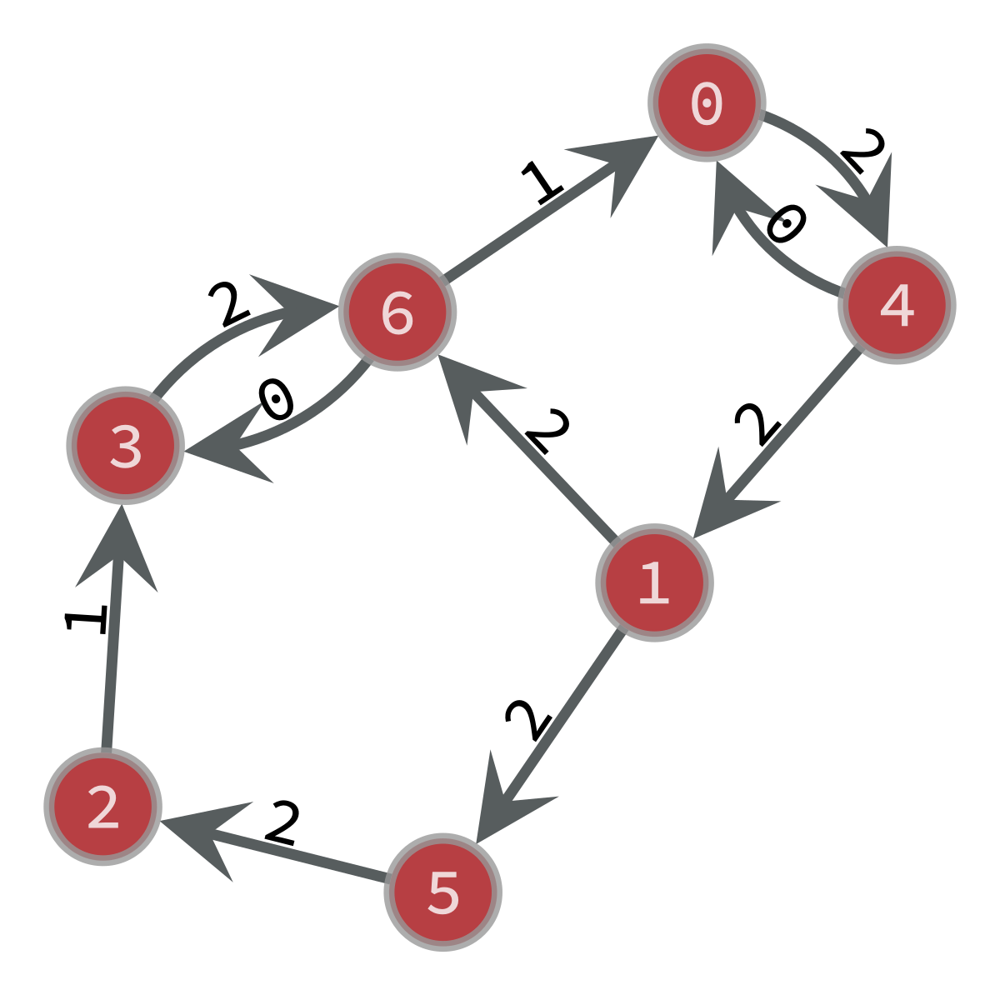

Graph G0 taken from Gr: 


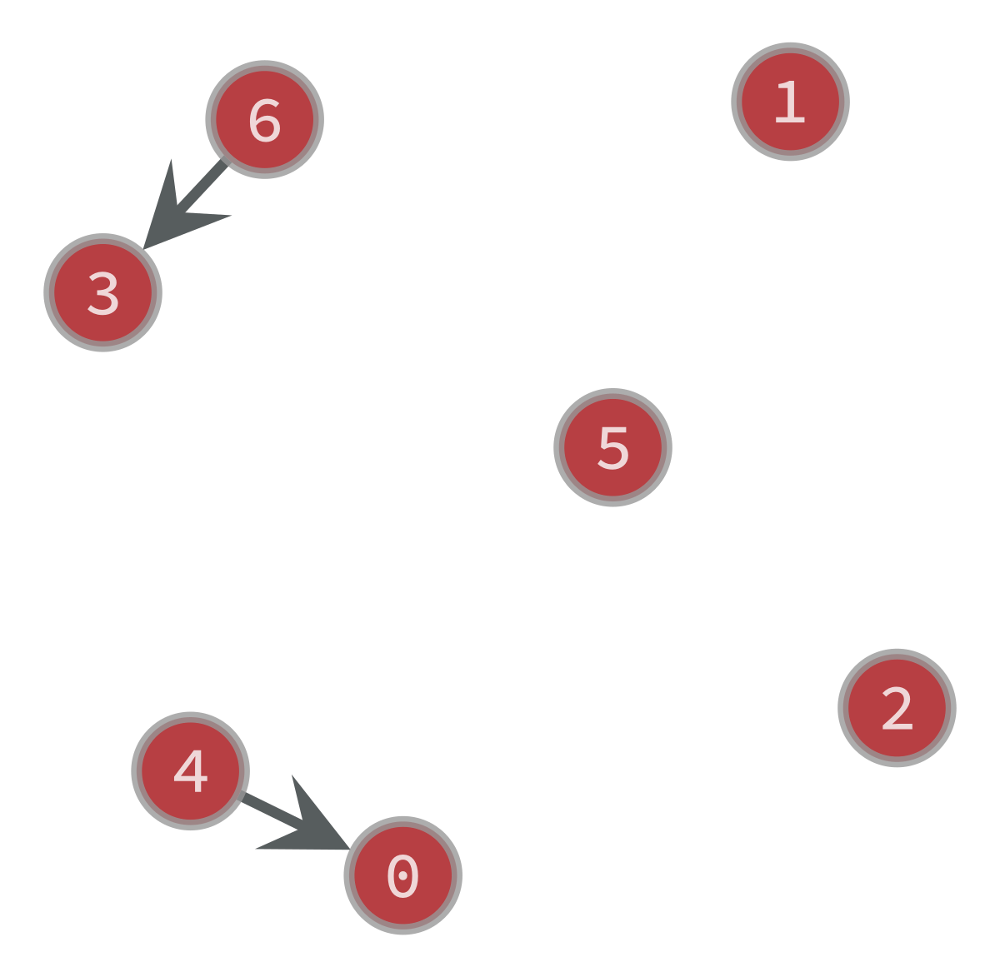

Clock Period of the graph is: 9 with value of c as: 13.0
Test with C: 14.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


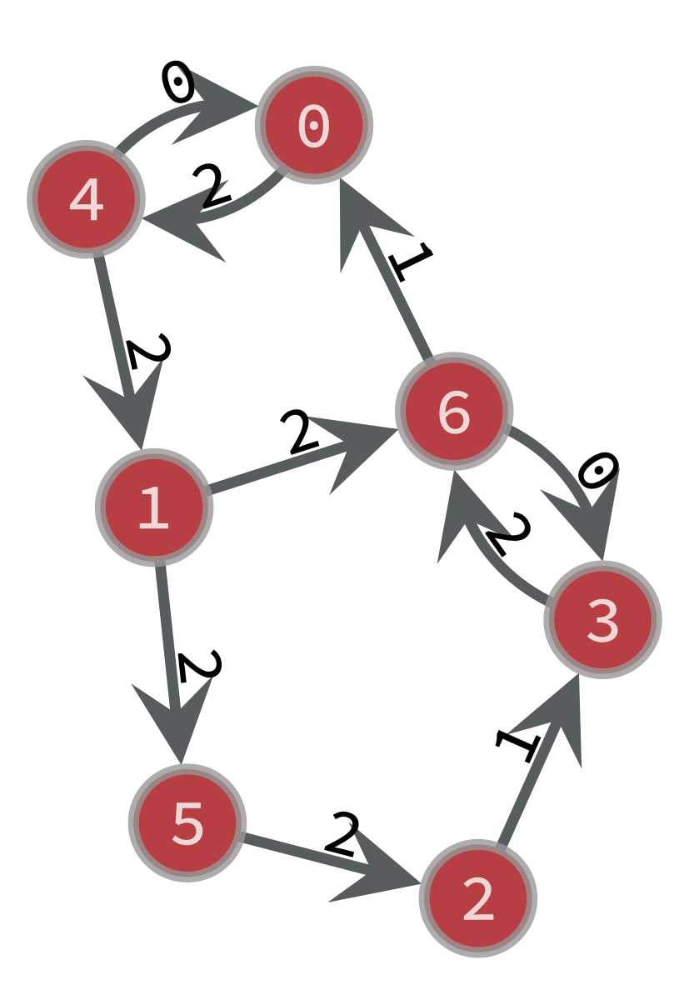

Graph G0 taken from Gr: 


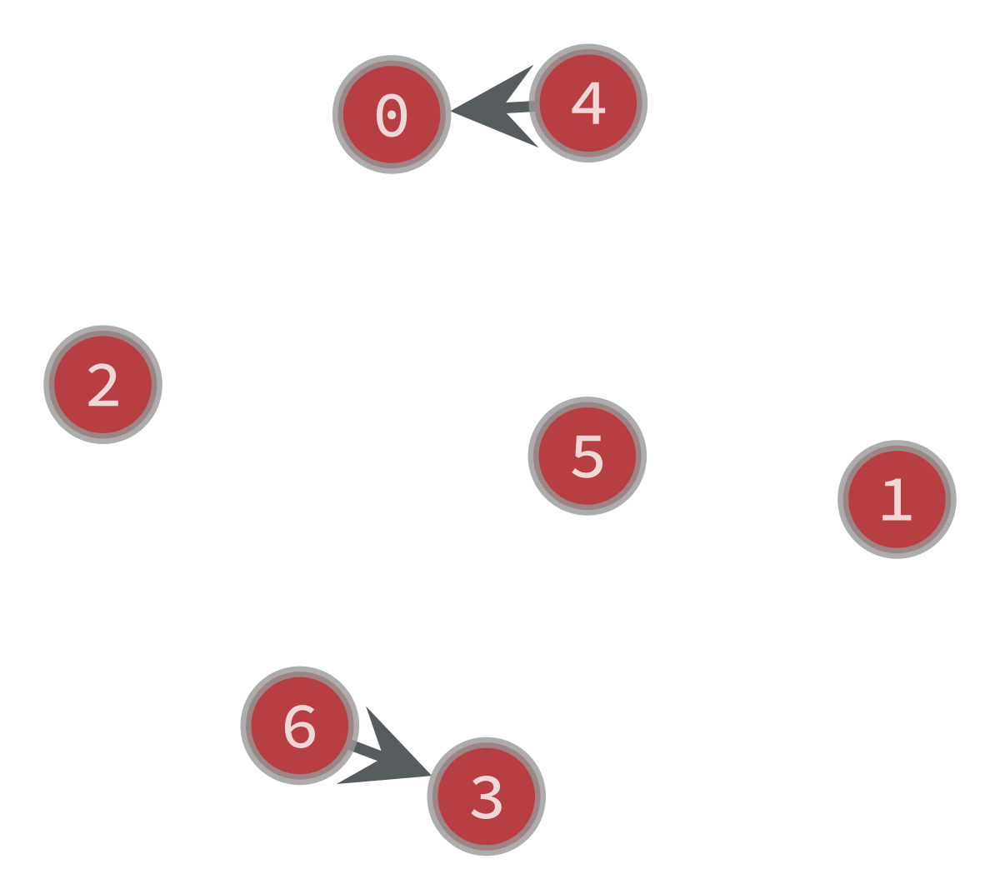

Clock Period of the graph is: 9 with value of c as: 14.0
Test with C: 15.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


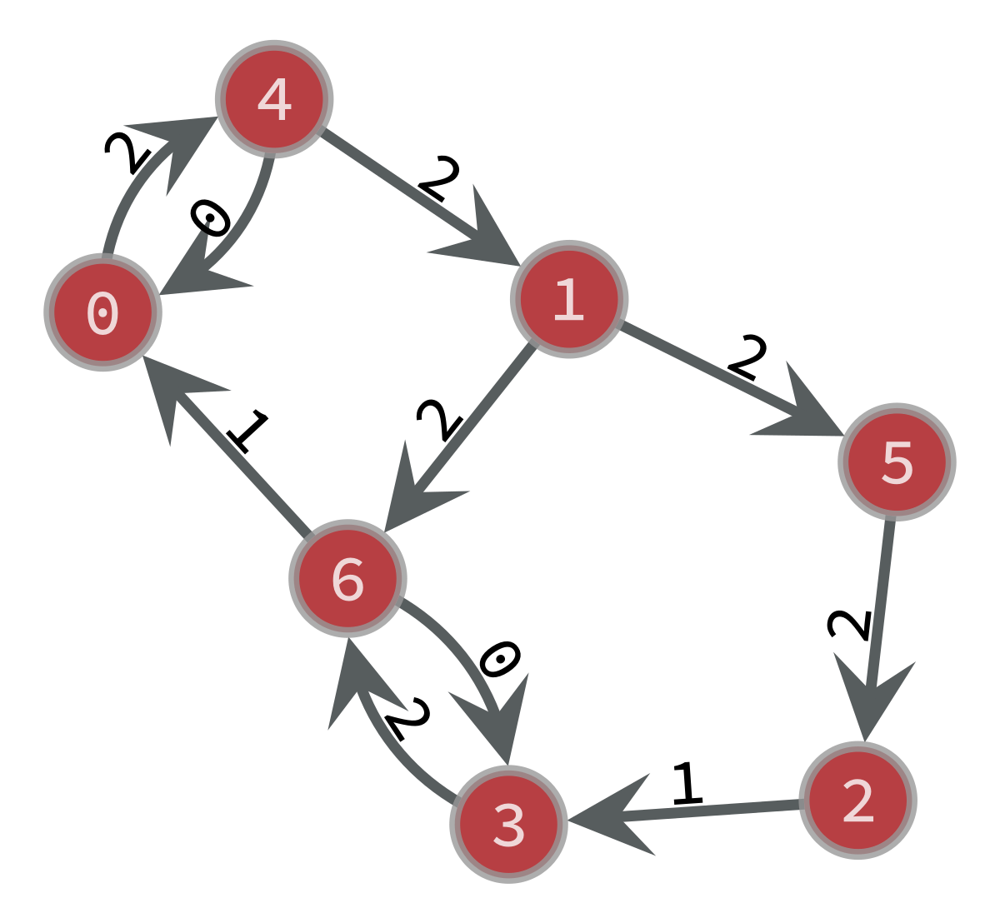

Graph G0 taken from Gr: 


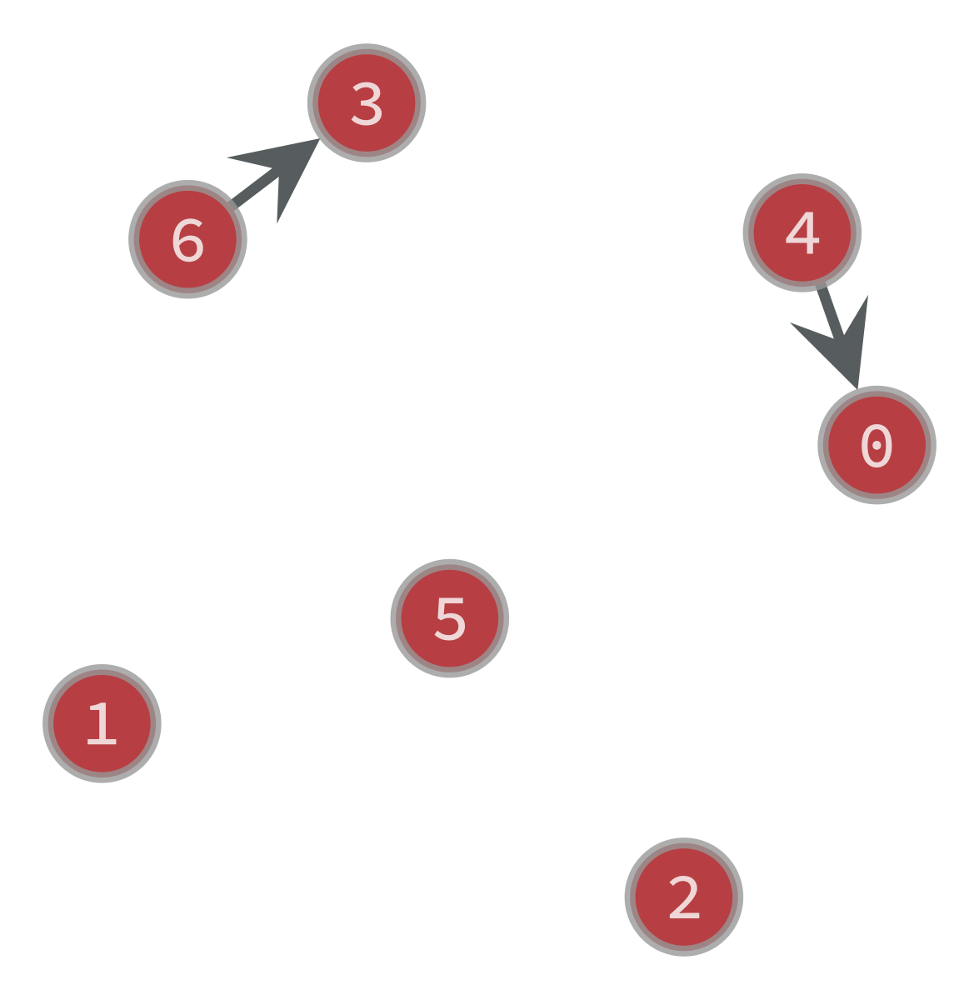

Clock Period of the graph is: 9 with value of c as: 15.0
Test with C: 16.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


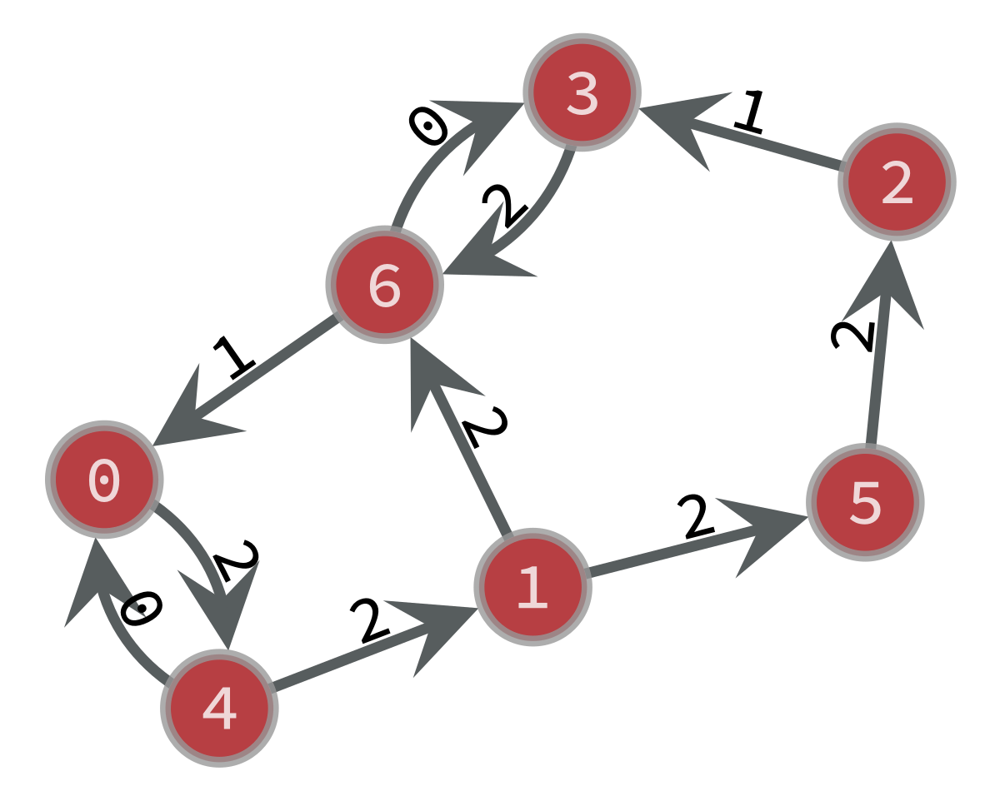

Graph G0 taken from Gr: 


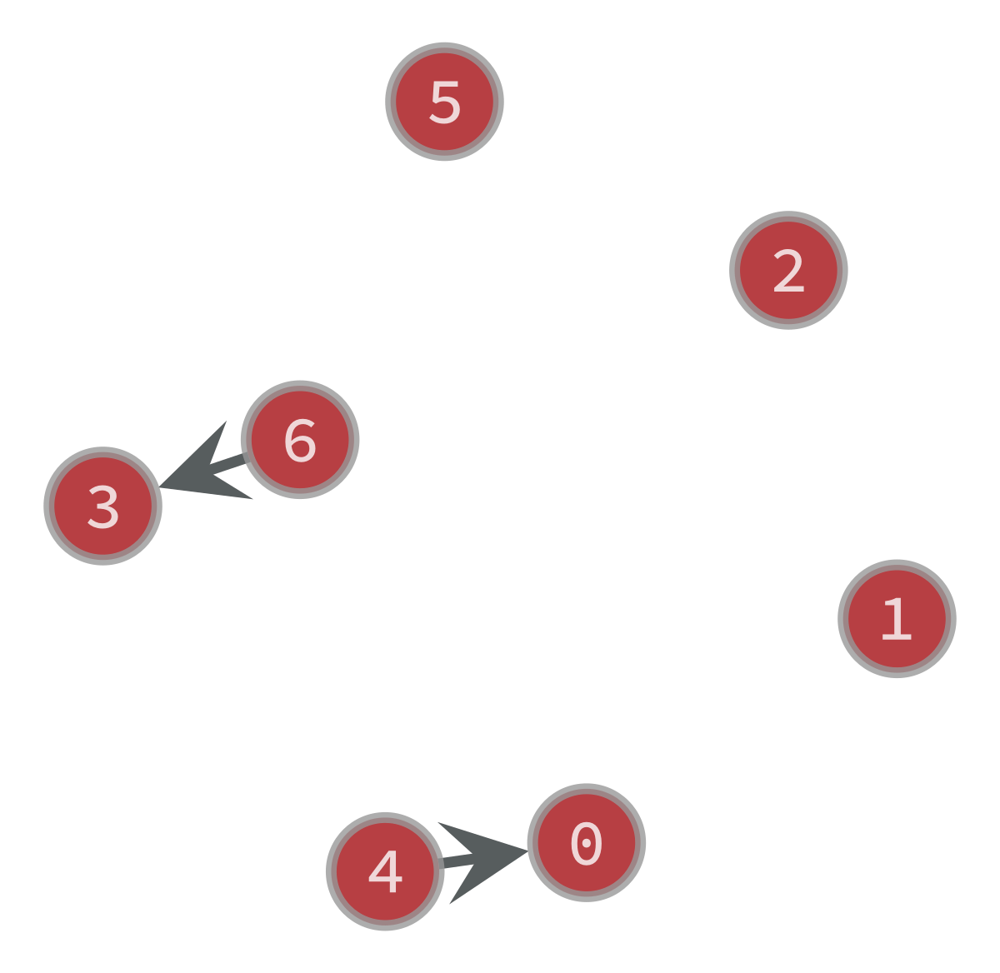

Clock Period of the graph is: 9 with value of c as: 16.0
Test with C: 18.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


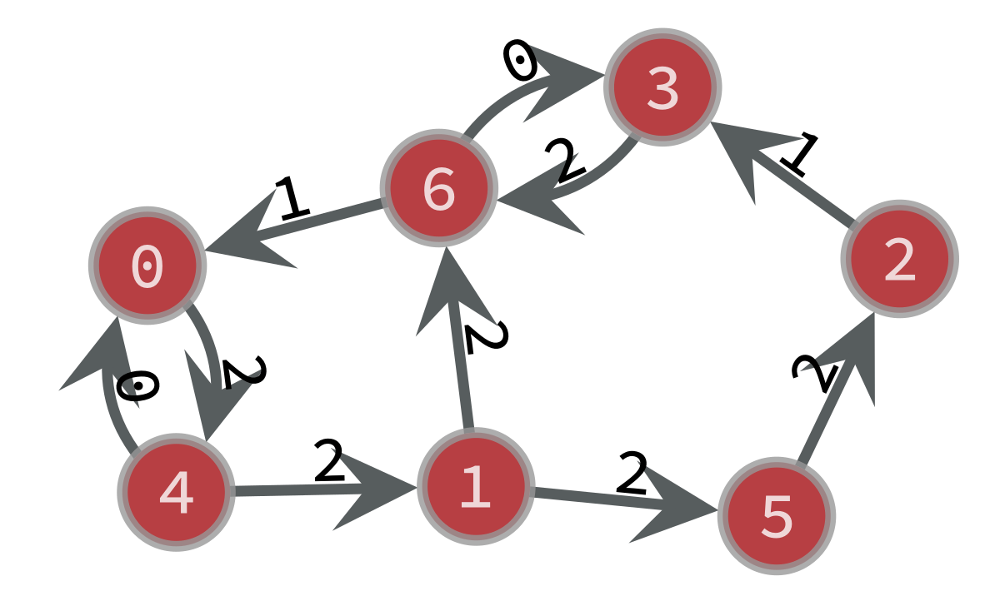

Graph G0 taken from Gr: 


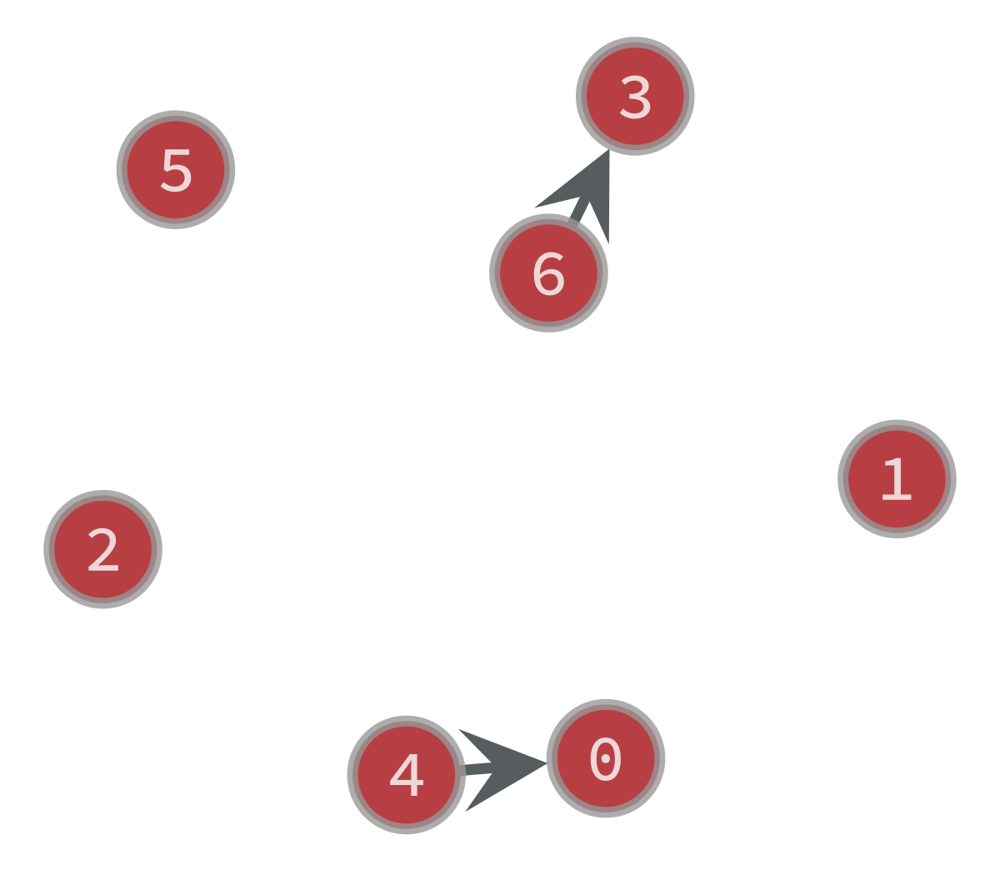

Clock Period of the graph is: 9 with value of c as: 18.0
Test with C: 19.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


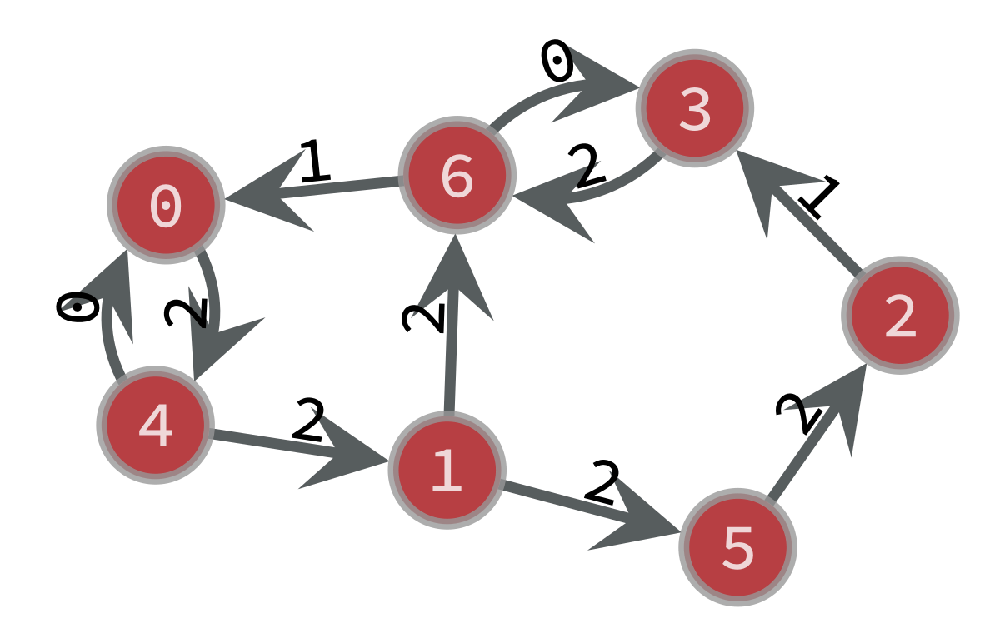

Graph G0 taken from Gr: 


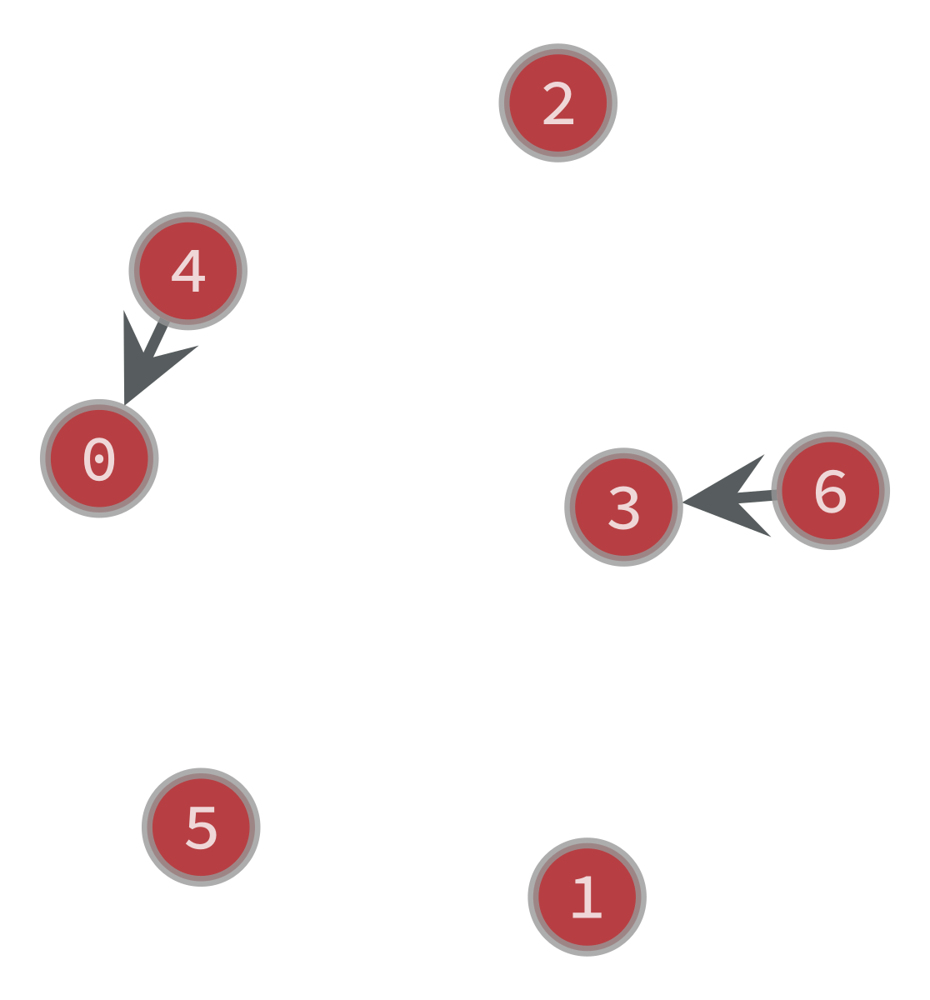

Clock Period of the graph is: 9 with value of c as: 19.0
Test with C: 20.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


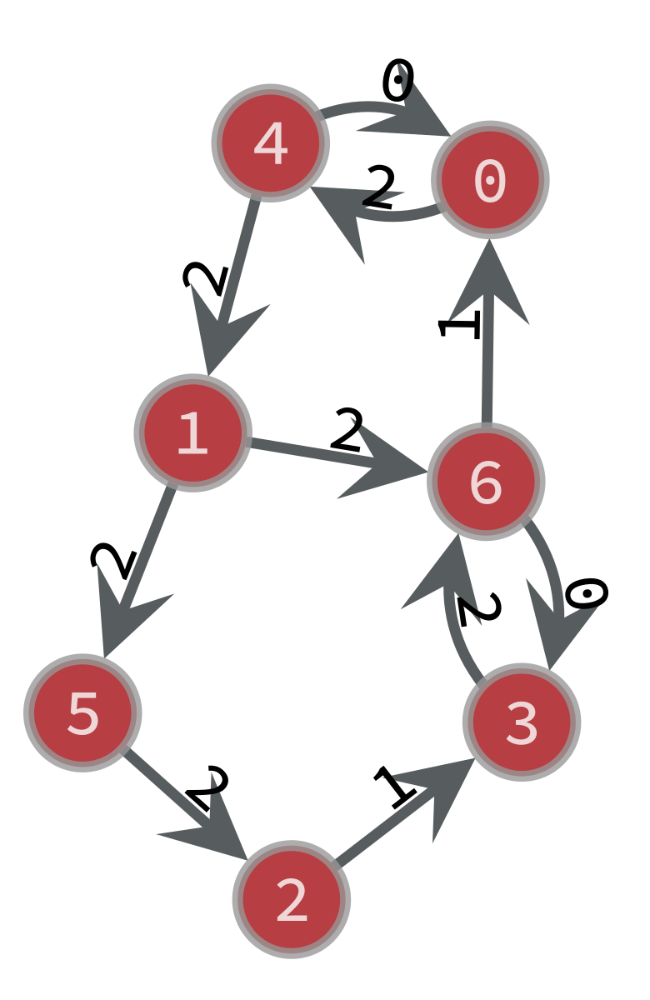

Graph G0 taken from Gr: 


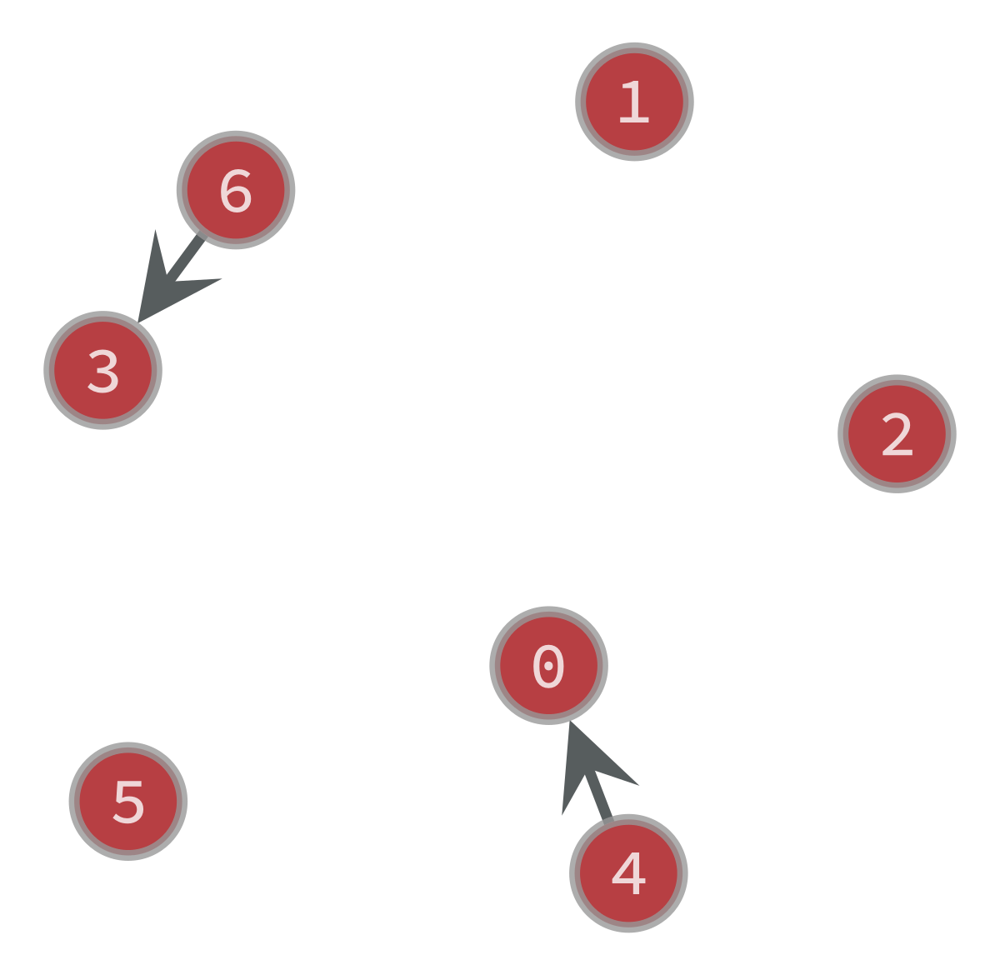

Clock Period of the graph is: 9 with value of c as: 20.0
Test with C: 21.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


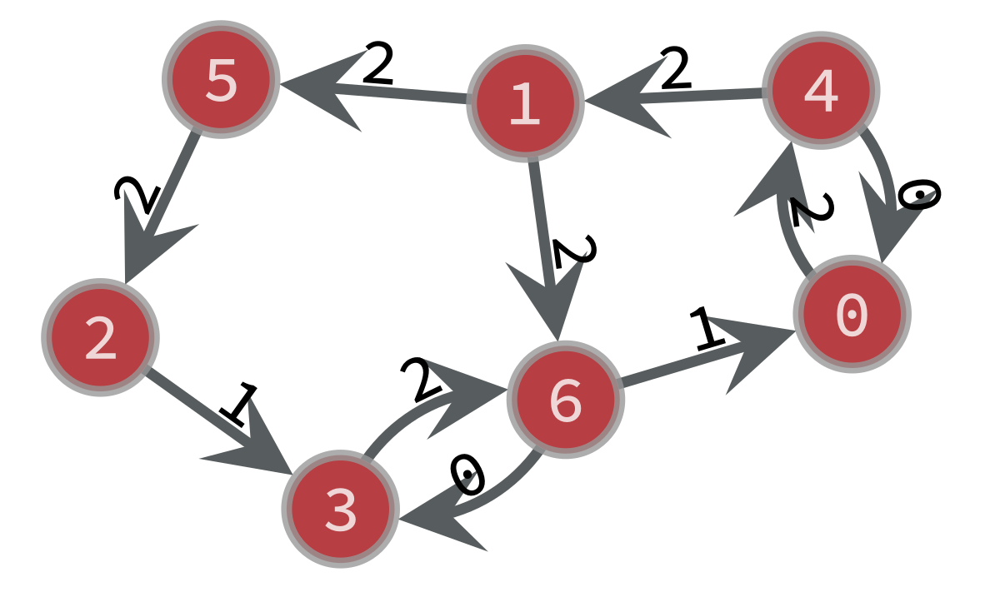

Graph G0 taken from Gr: 


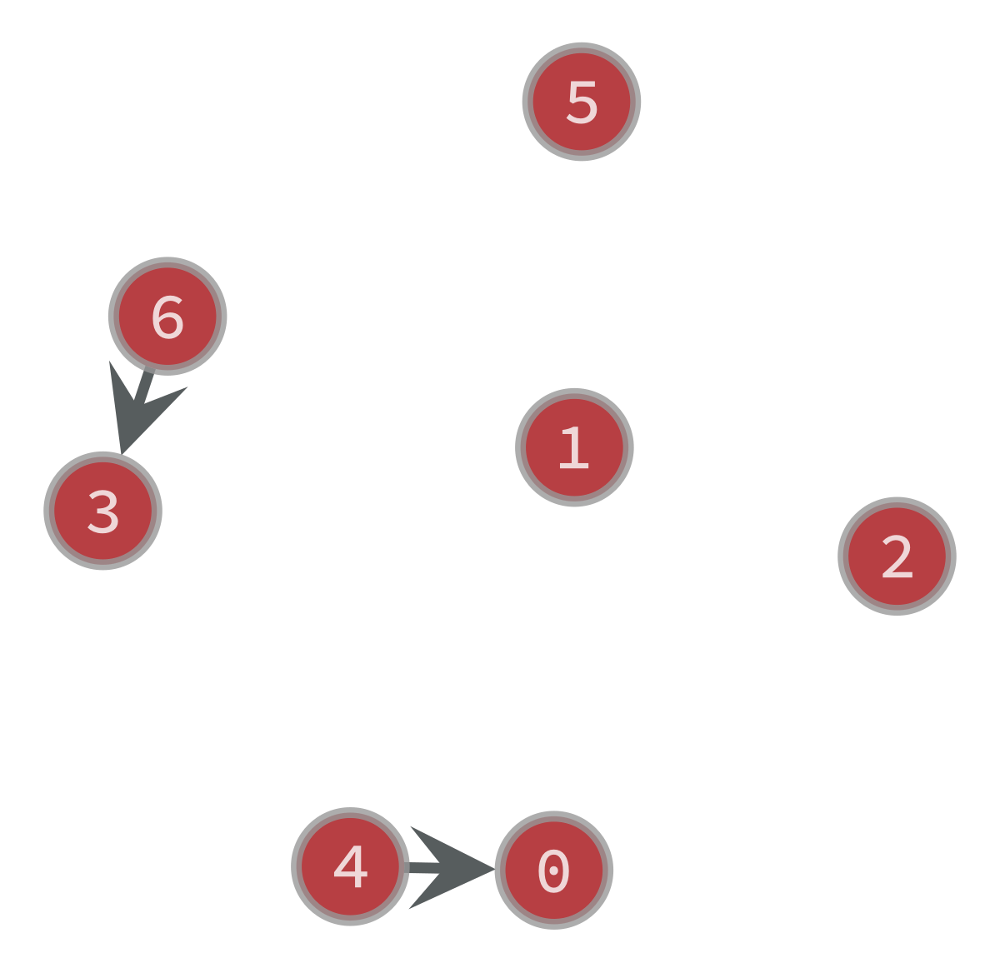

Clock Period of the graph is: 9 with value of c as: 21.0
Minimum Clock Period is: 6 with c: 6.0
[0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0]


In [148]:
print(OPT1(g100))

W Matrix: 
[[ 0.  4.  8.  6.  2.  6.  6.]
 [ 3.  0.  4.  2.  5.  2.  2.]
 [ 4.  8.  0.  1.  6. 10.  3.]
 [ 3.  7. 11.  0.  5.  9.  2.]
 [ 0.  2.  6.  4.  0.  4.  4.]
 [ 6. 10.  2.  3.  8.  0.  5.]
 [ 1.  5.  9.  0.  3.  7.  0.]]
D Matrix: 
[[ 0.  5. 12. 14.  4. 10. 11.]
 [ 7.  1.  8. 10. 11.  6.  7.]
 [11. 16.  2.  5. 15. 21. 11.]
 [ 9. 14. 21.  3. 13. 19.  9.]
 [ 4.  5. 12. 14.  4. 10. 11.]
 [16. 21.  7. 10. 20.  5. 16.]
 [ 6. 11. 18.  9. 10. 16.  6.]]
Test with C: 0.0
Final graph created with FEAS: 


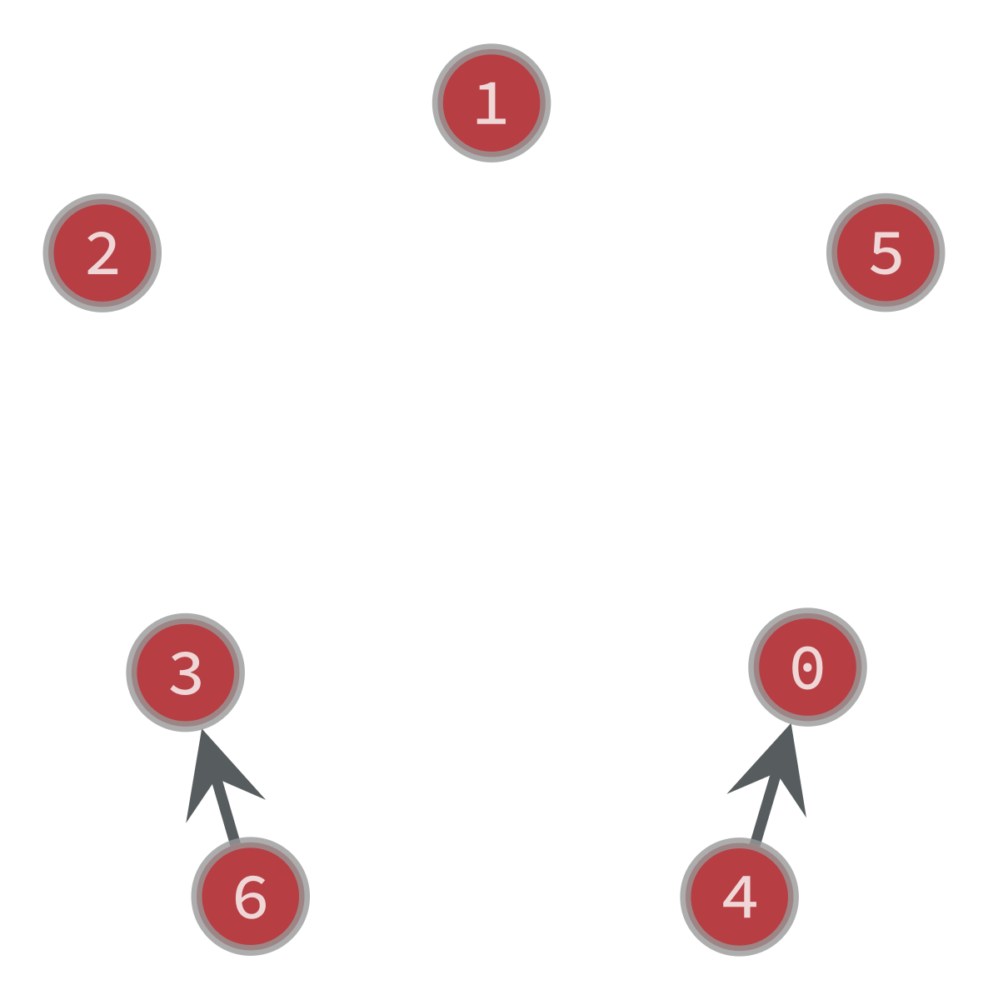

FEAS Algorithm finished with c: 0.0
Clock Period of the graph is: 9
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 9
No feasible retiming exists.
Test with C: 1.0
Final graph created with FEAS: 


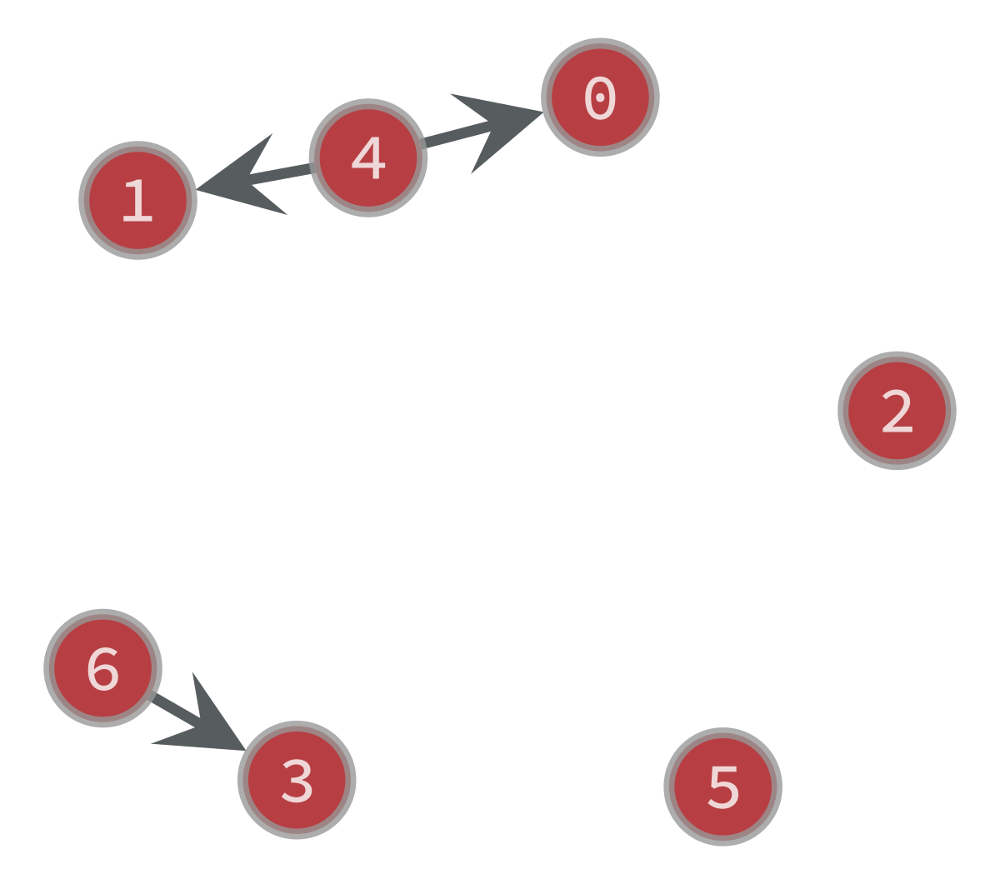

FEAS Algorithm finished with c: 1.0
Clock Period of the graph is: 9
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 9
No feasible retiming exists.
Test with C: 2.0
Final graph created with FEAS: 


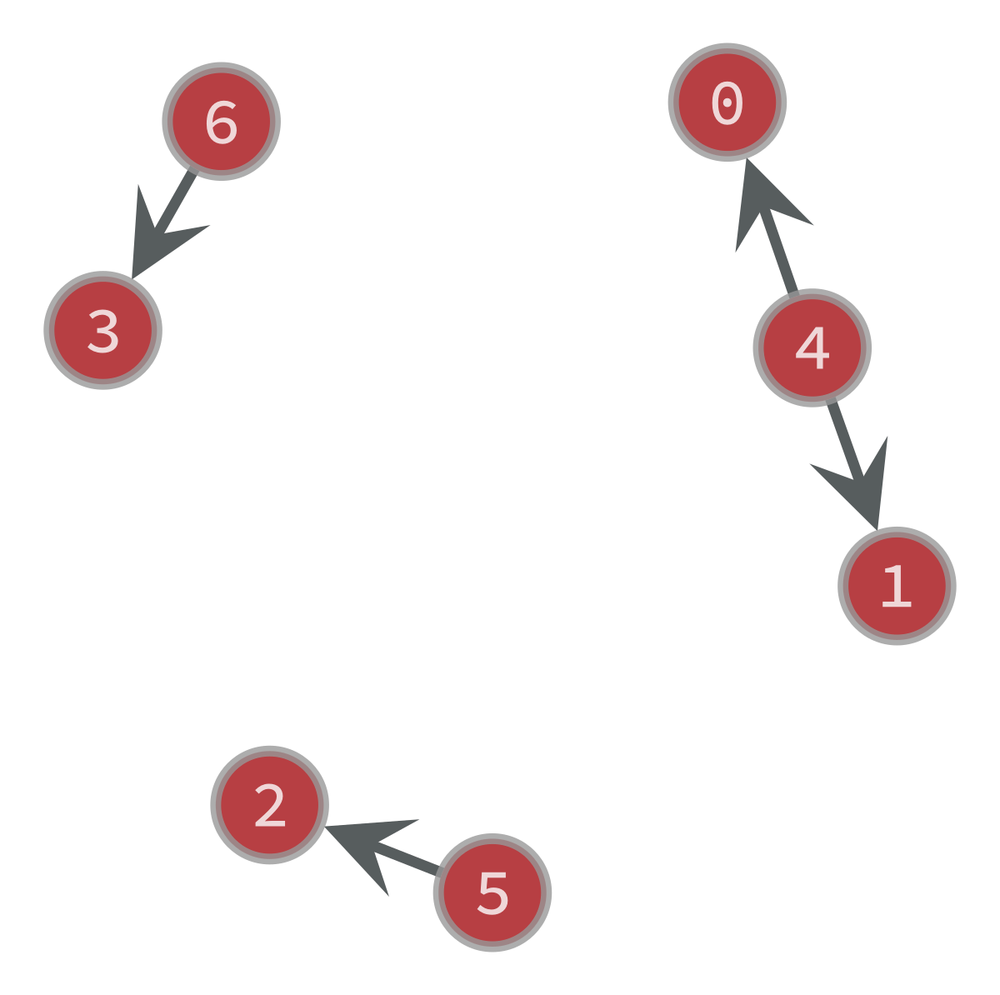

FEAS Algorithm finished with c: 2.0
Clock Period of the graph is: 9
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 9
No feasible retiming exists.
Test with C: 3.0
Final graph created with FEAS: 


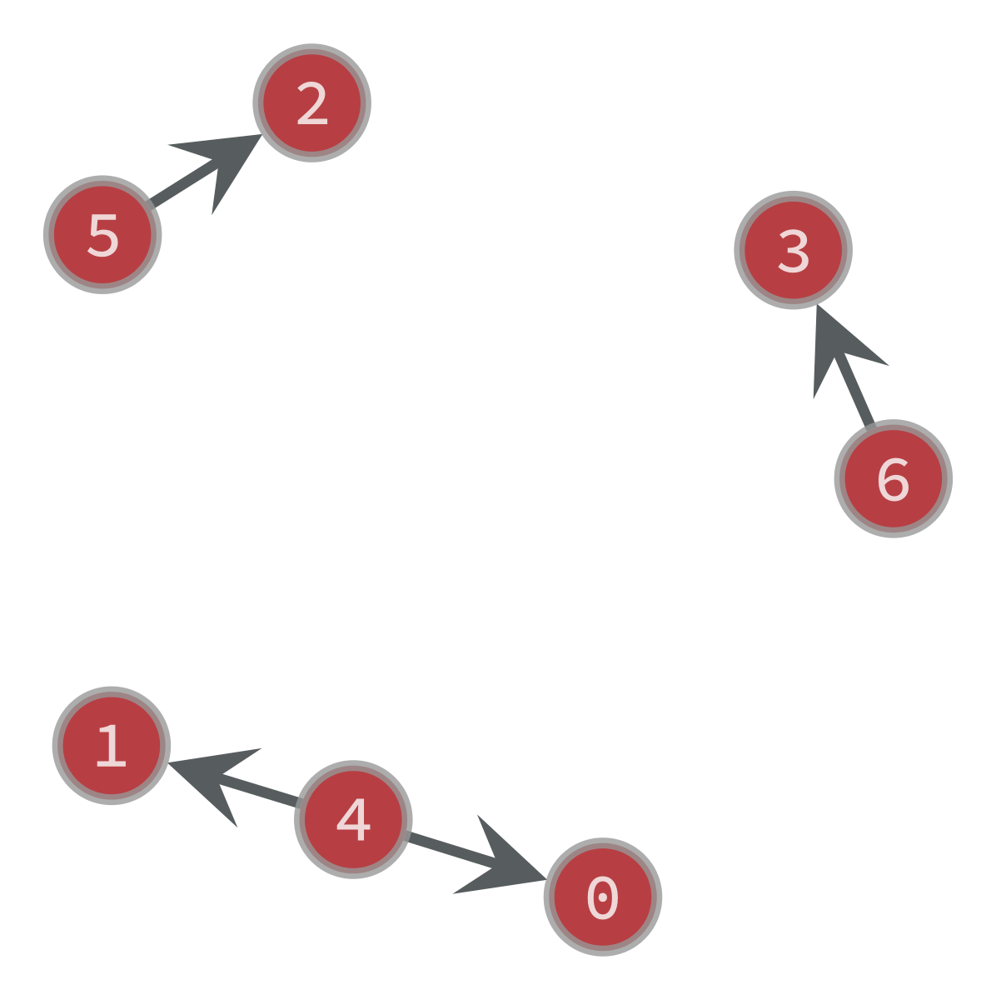

FEAS Algorithm finished with c: 3.0
Clock Period of the graph is: 9
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 9
No feasible retiming exists.
Test with C: 4.0
Final graph created with FEAS: 


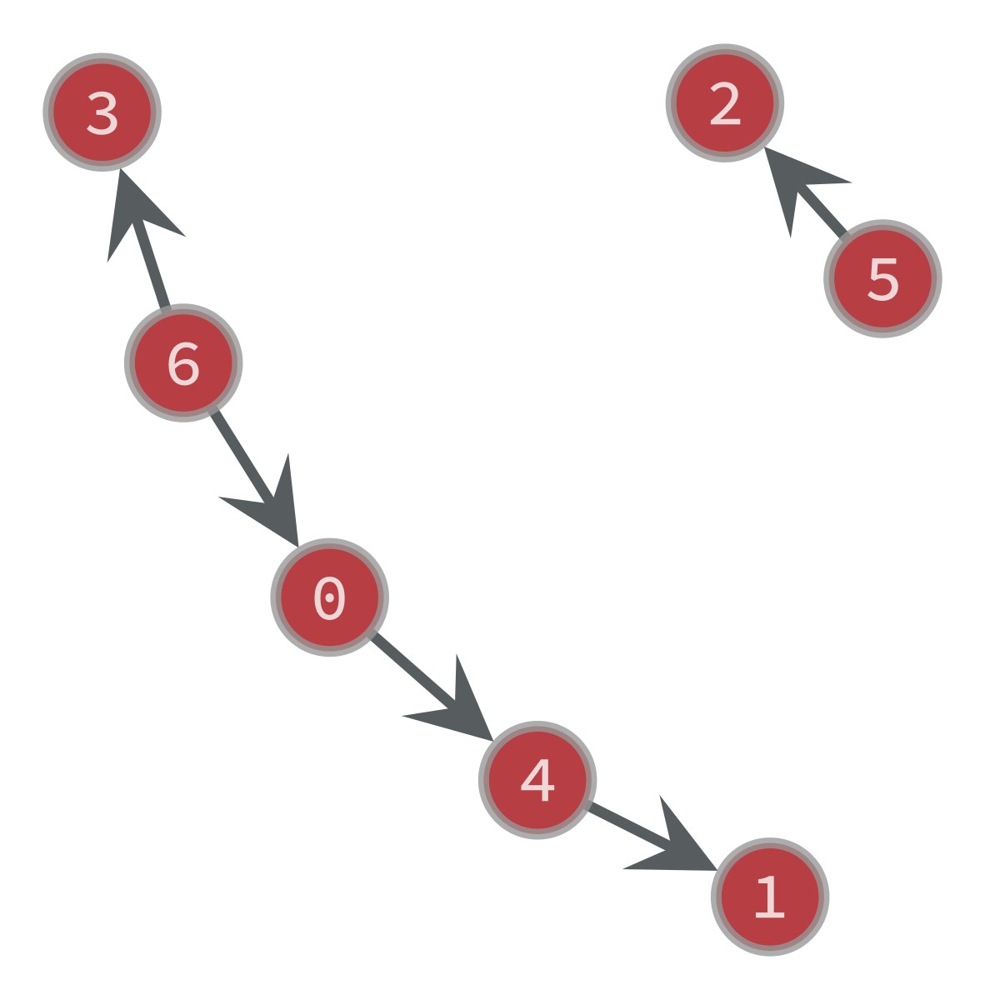

FEAS Algorithm finished with c: 4.0
Clock Period of the graph is: 11
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 11
No feasible retiming exists.
Test with C: 5.0
Final graph created with FEAS: 


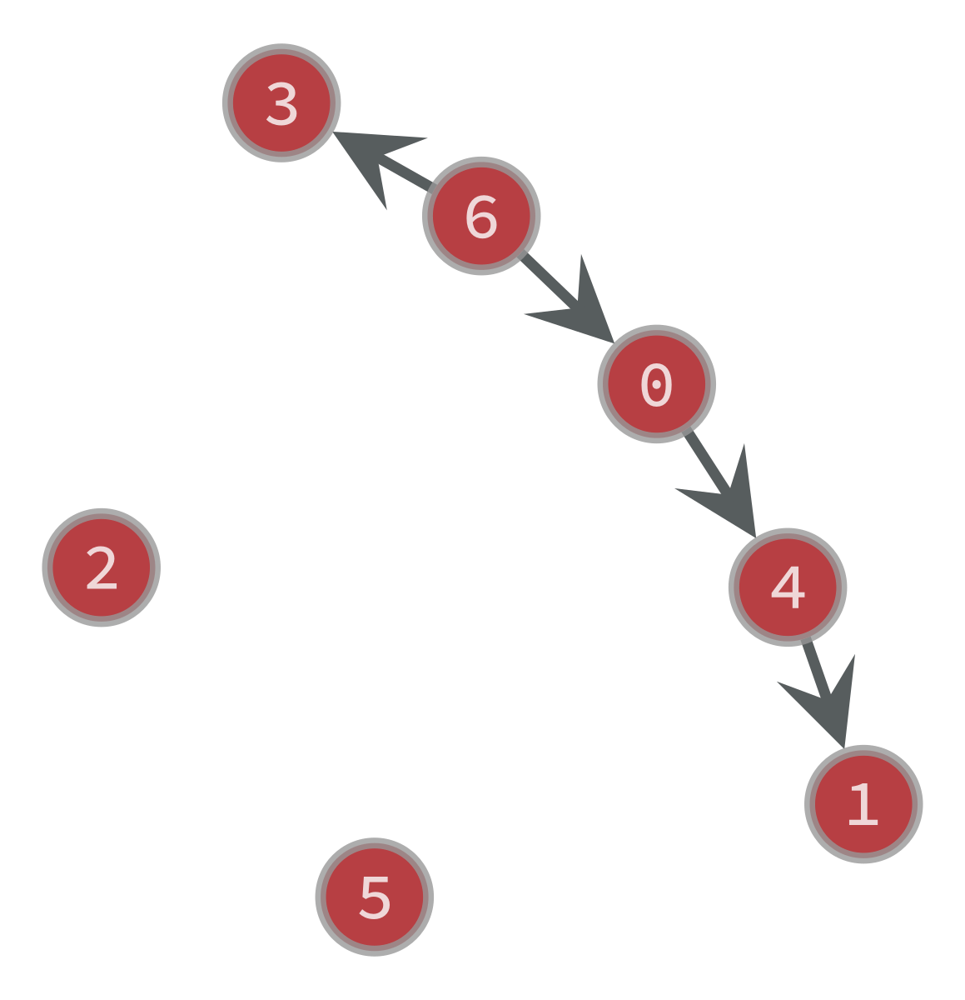

FEAS Algorithm finished with c: 5.0
Clock Period of the graph is: 11
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 11
No feasible retiming exists.
Test with C: 6.0
Final graph created with FEAS: 


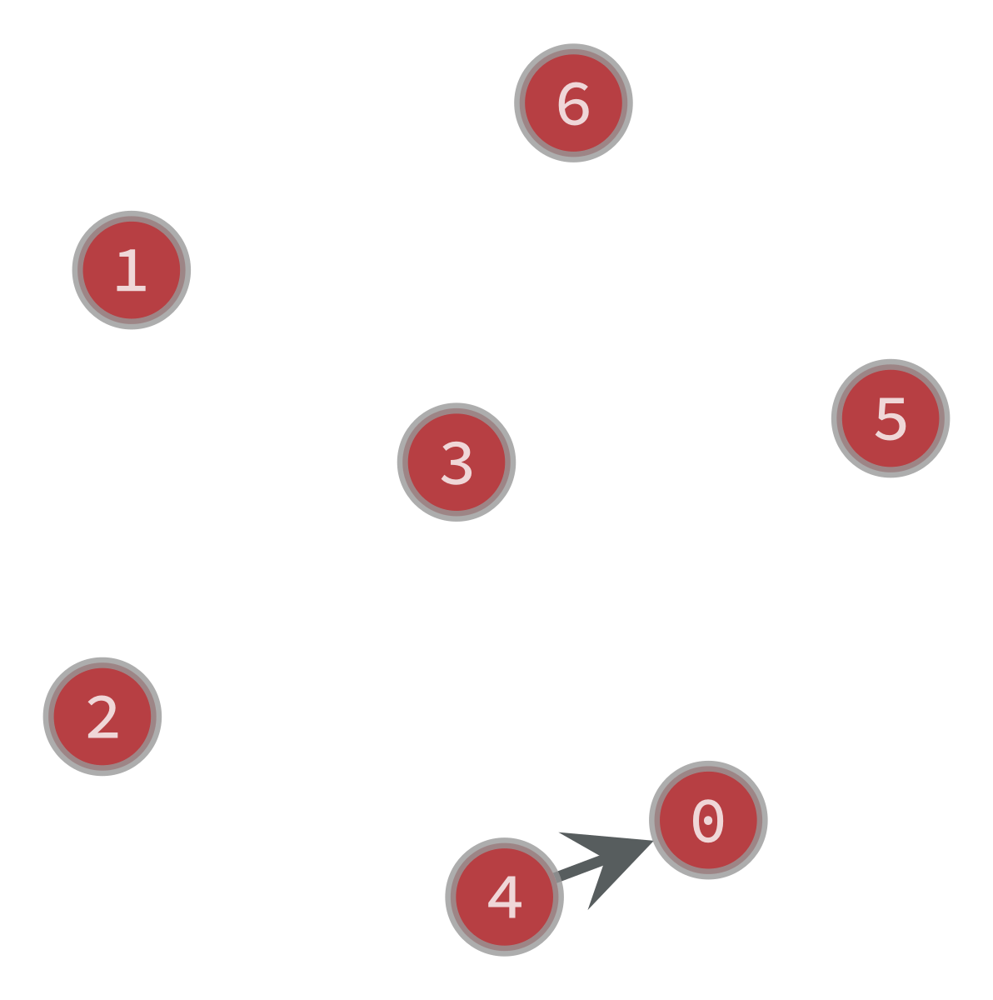

FEAS Algorithm finished with c: 6.0
Clock Period of the graph is: 6
Retiming: [0, 0, 0, 1, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 6
Retiming: [0, 0, 0, 1, 0, 0, 0] is the desired retiming.
Test with C: 7.0
Final graph created with FEAS: 


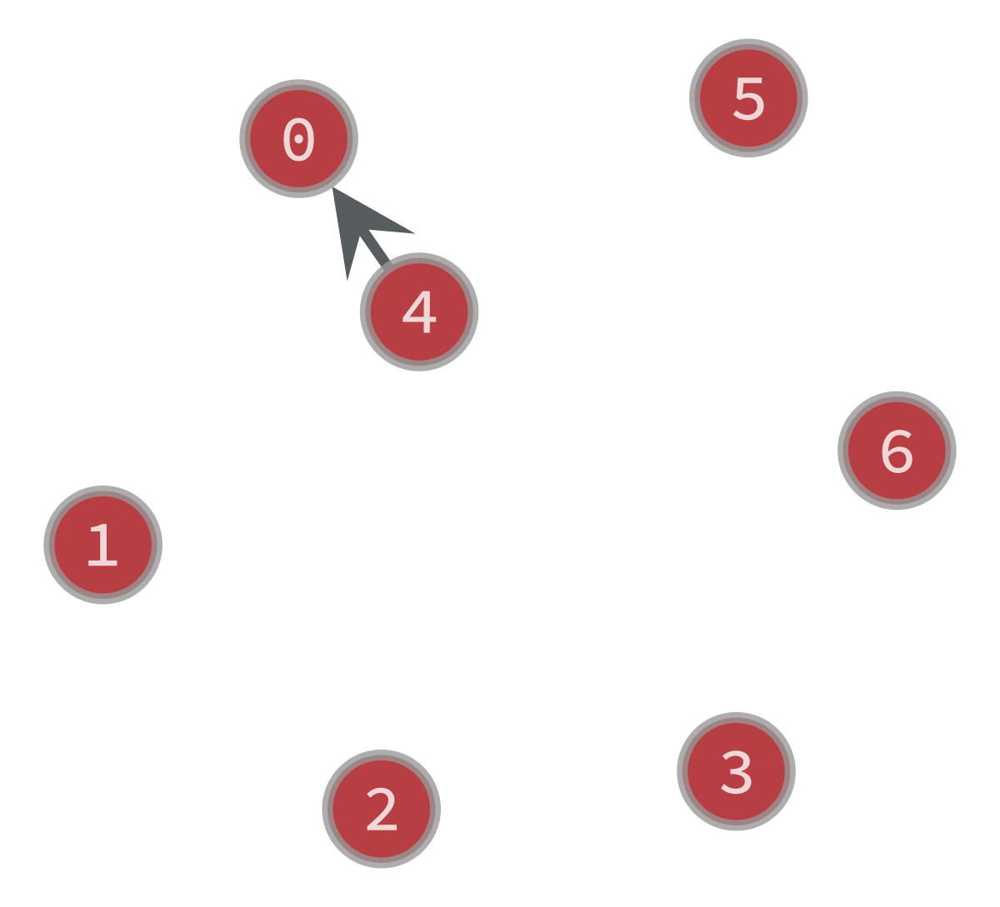

FEAS Algorithm finished with c: 7.0
Clock Period of the graph is: 6
Retiming: [0, 0, 0, 1, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 6
It doesn't improve the retiming.
Test with C: 8.0
Final graph created with FEAS: 


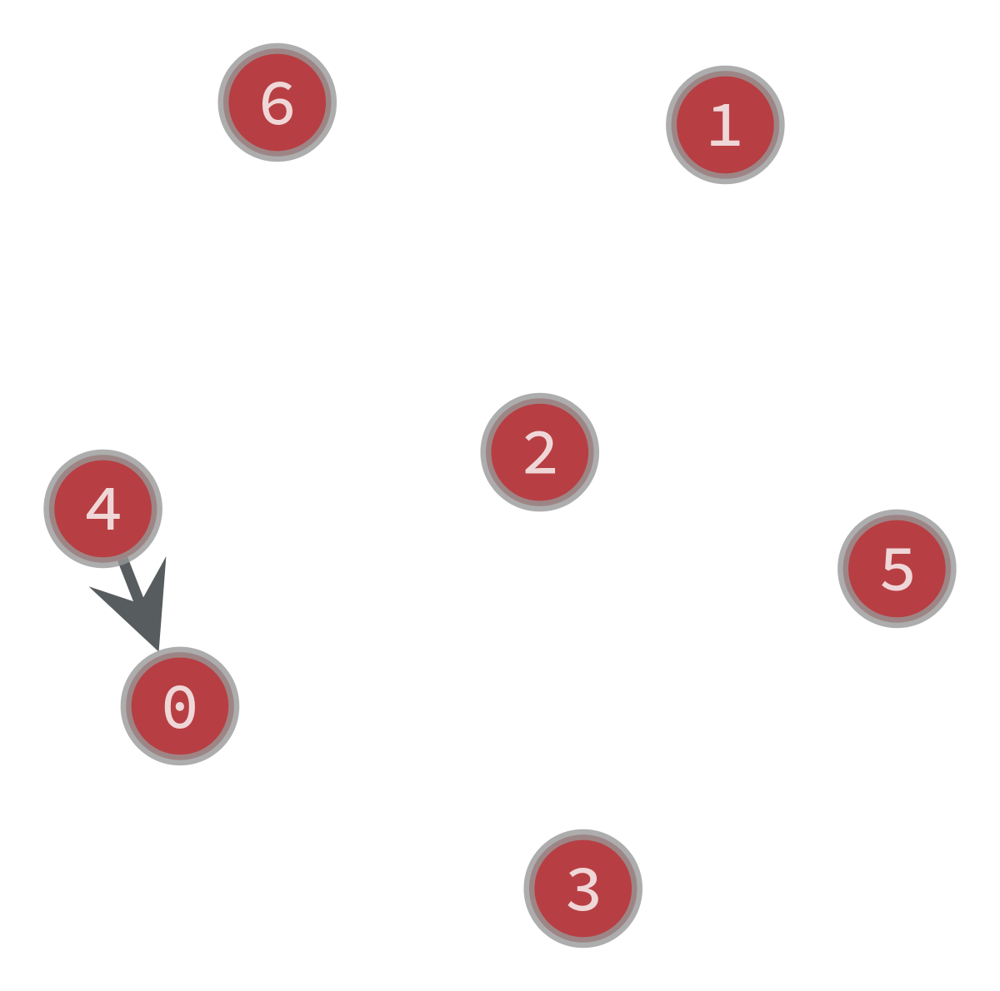

FEAS Algorithm finished with c: 8.0
Clock Period of the graph is: 6
Retiming: [0, 0, 0, 1, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 6
It doesn't improve the retiming.
Test with C: 9.0
Final graph created with FEAS: 


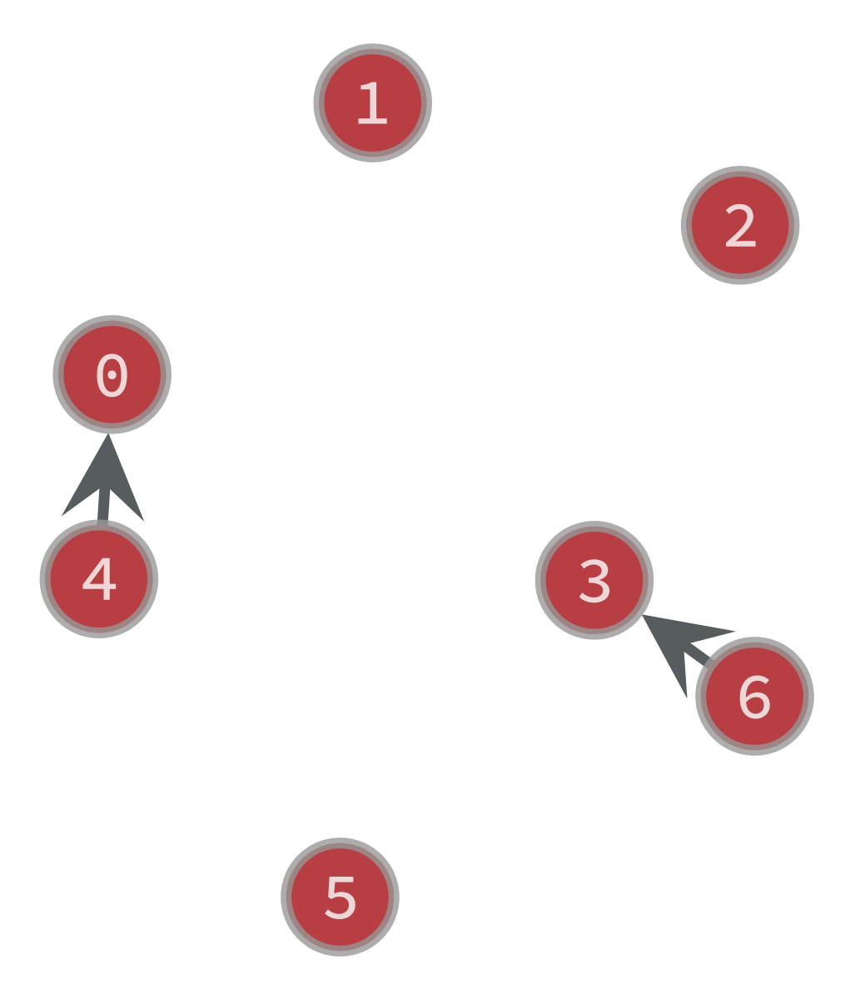

FEAS Algorithm finished with c: 9.0
Clock Period of the graph is: 9
Retiming: [0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 9
It doesn't improve the retiming.
Test with C: 10.0
Final graph created with FEAS: 


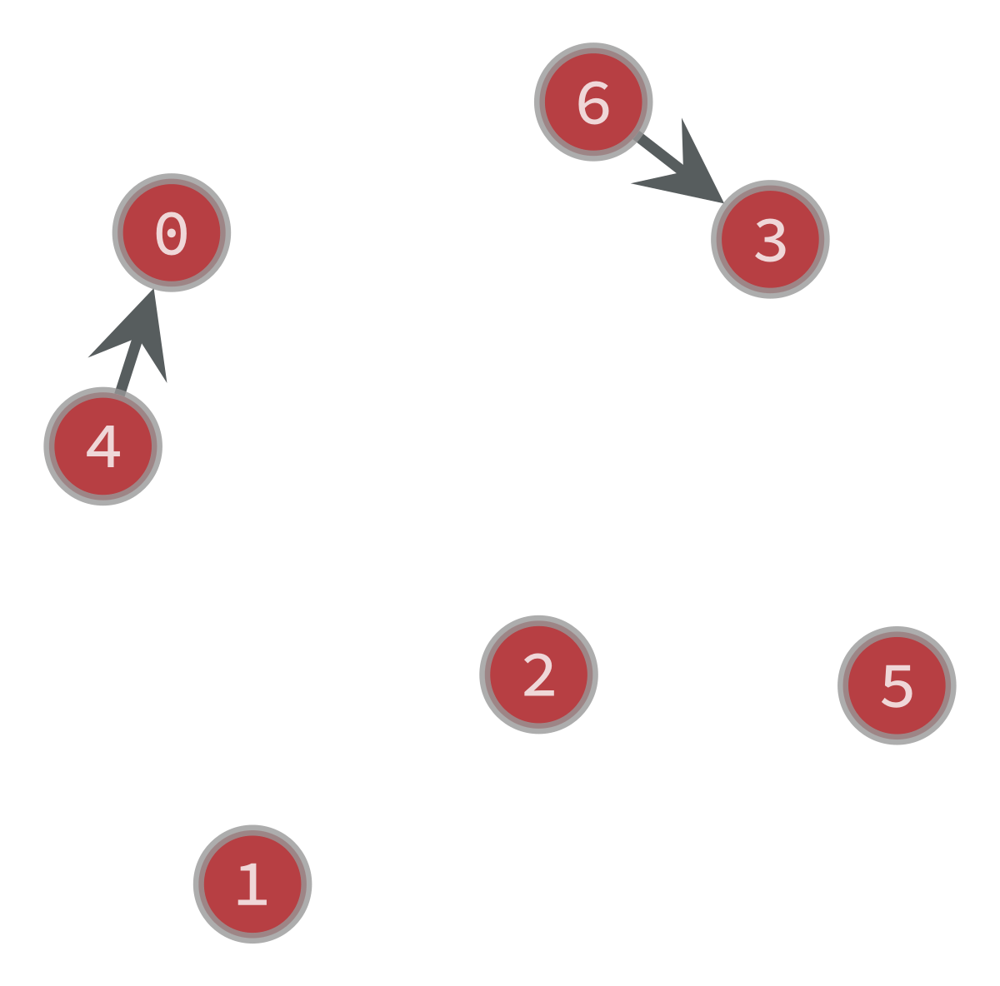

FEAS Algorithm finished with c: 10.0
Clock Period of the graph is: 9
Retiming: [0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 9
It doesn't improve the retiming.
Test with C: 11.0
Final graph created with FEAS: 


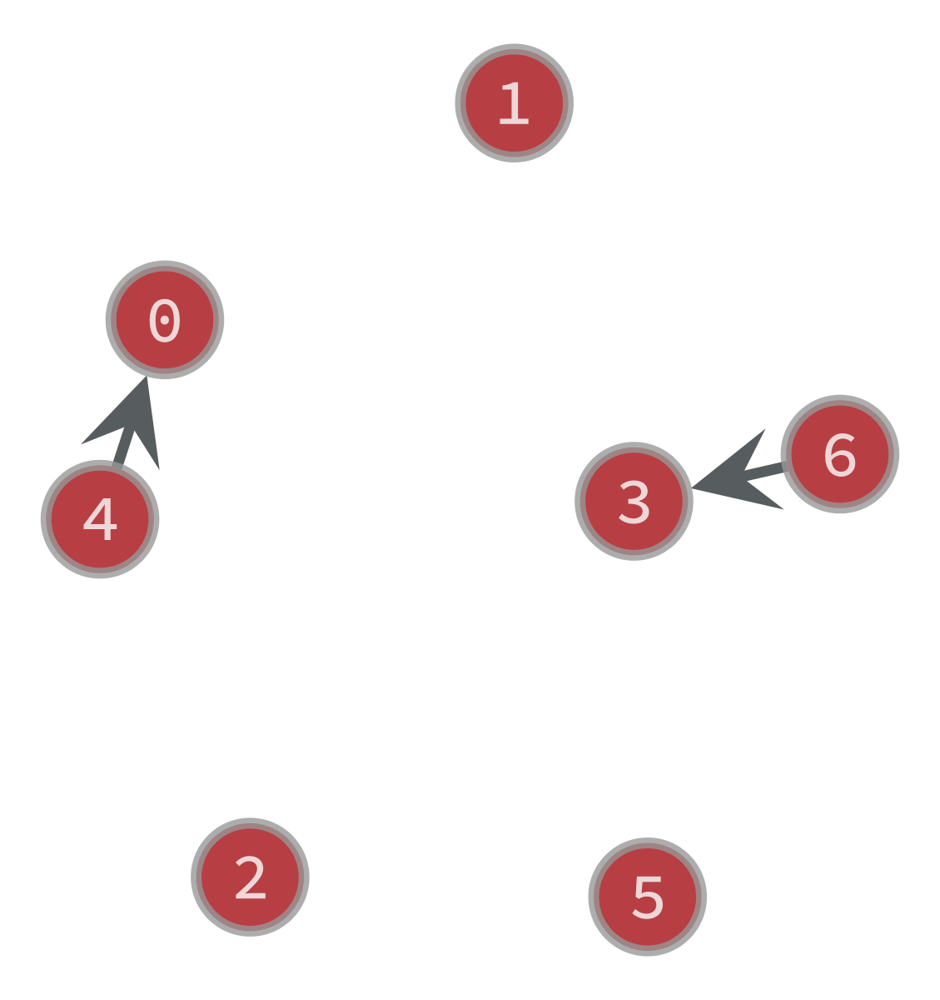

FEAS Algorithm finished with c: 11.0
Clock Period of the graph is: 9
Retiming: [0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 9
It doesn't improve the retiming.
Test with C: 12.0
Final graph created with FEAS: 


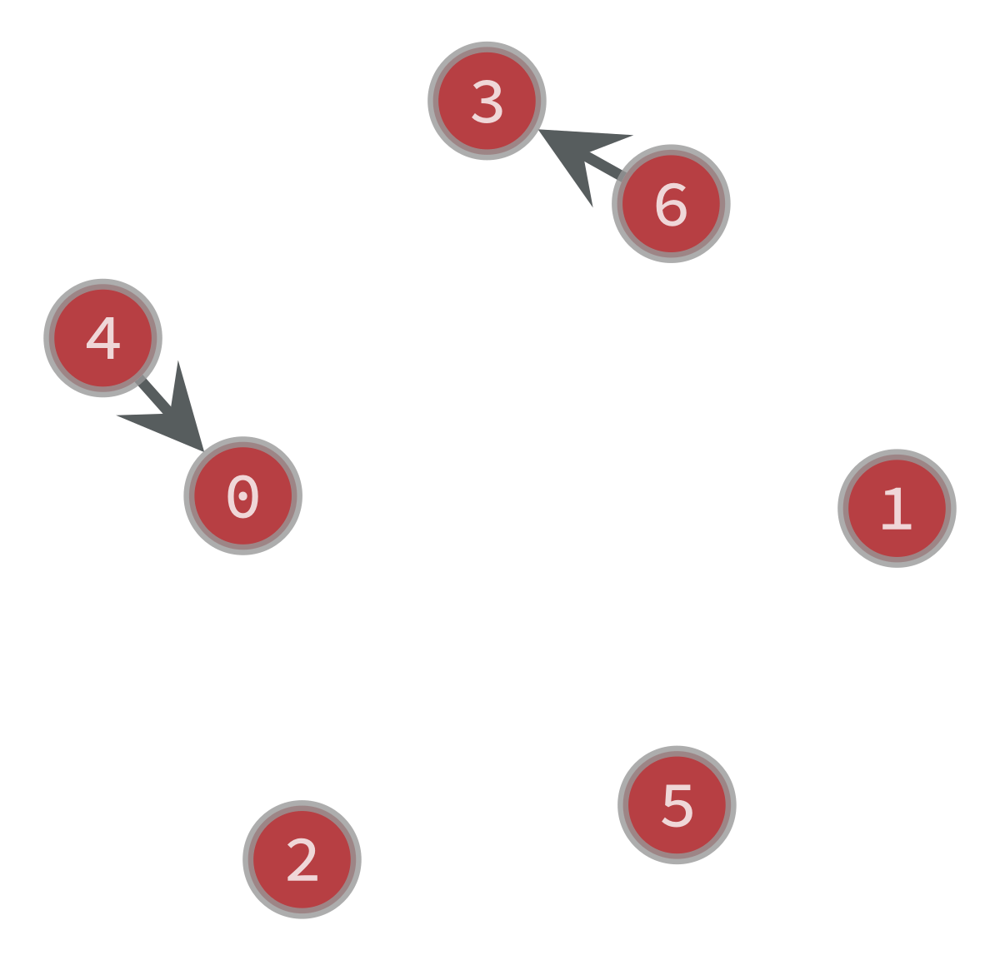

FEAS Algorithm finished with c: 12.0
Clock Period of the graph is: 9
Retiming: [0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 9
It doesn't improve the retiming.
Test with C: 13.0
Final graph created with FEAS: 


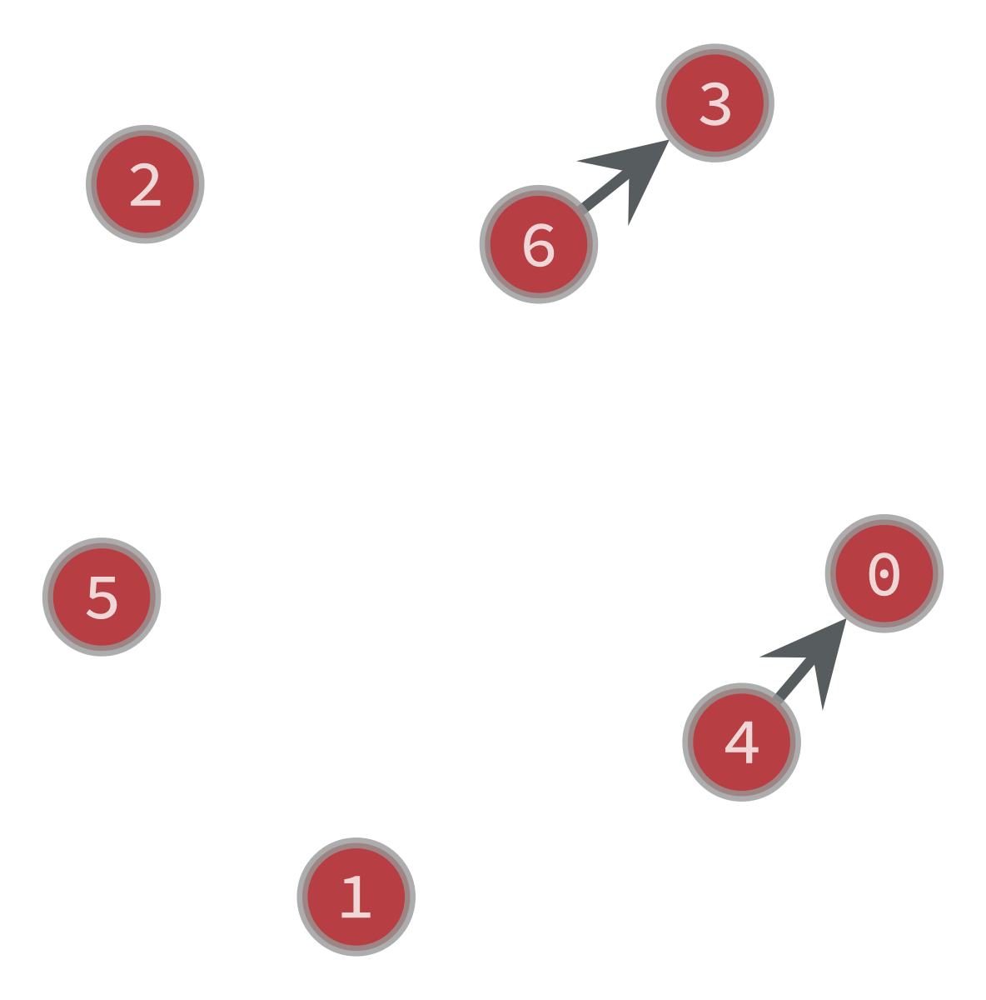

FEAS Algorithm finished with c: 13.0
Clock Period of the graph is: 9
Retiming: [0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 9
It doesn't improve the retiming.
Test with C: 14.0
Final graph created with FEAS: 


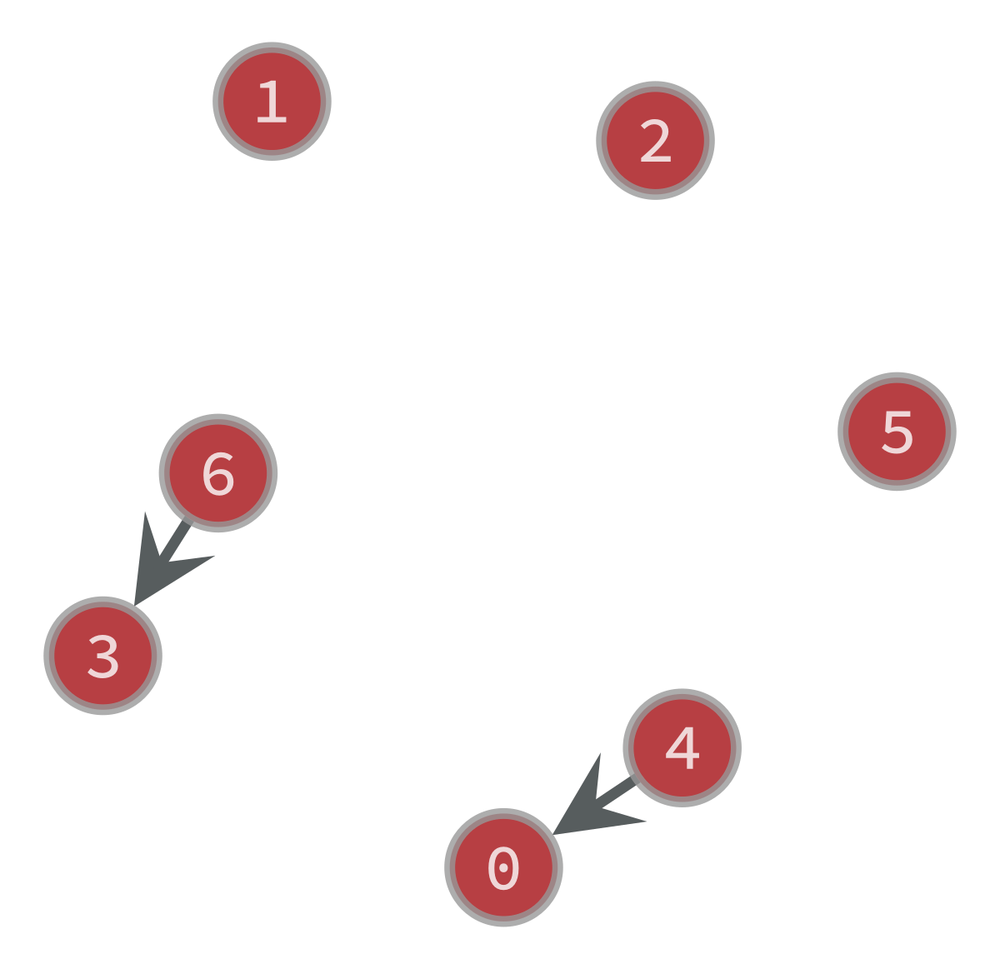

FEAS Algorithm finished with c: 14.0
Clock Period of the graph is: 9
Retiming: [0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 9
It doesn't improve the retiming.
Test with C: 15.0
Final graph created with FEAS: 


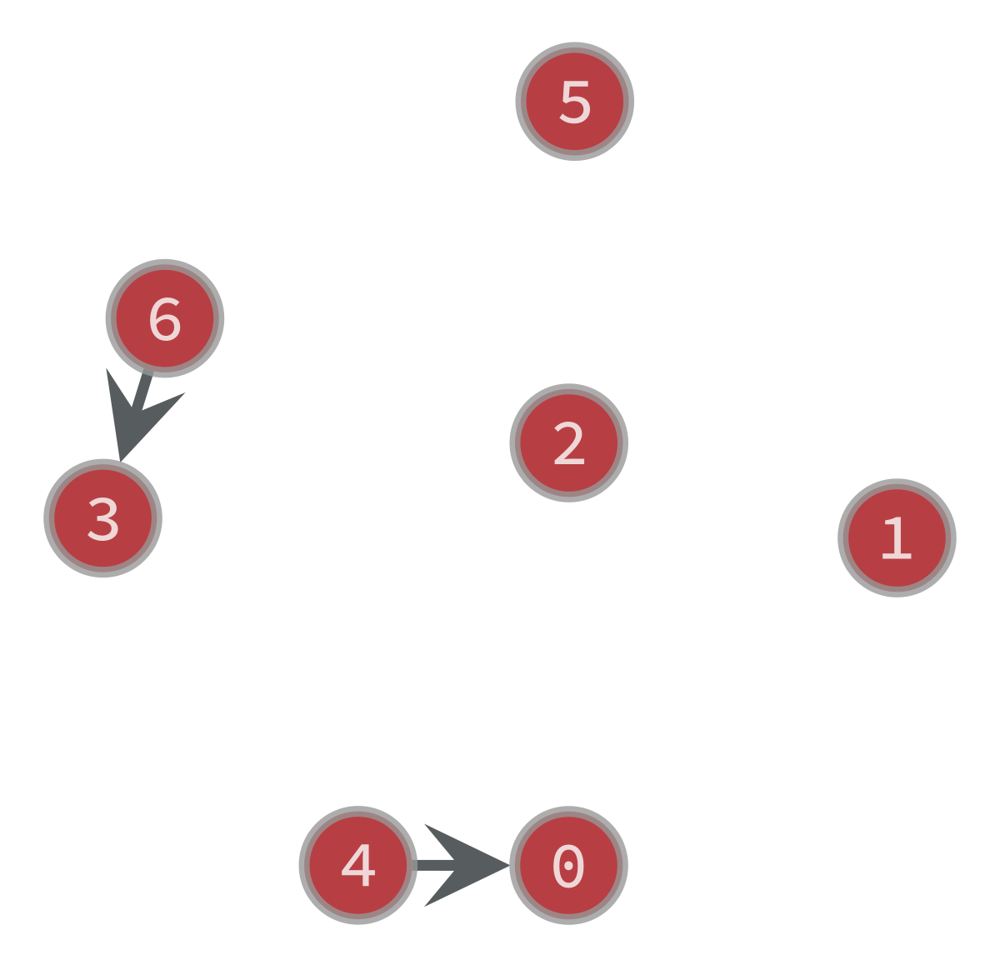

FEAS Algorithm finished with c: 15.0
Clock Period of the graph is: 9
Retiming: [0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 9
It doesn't improve the retiming.
Test with C: 16.0
Final graph created with FEAS: 


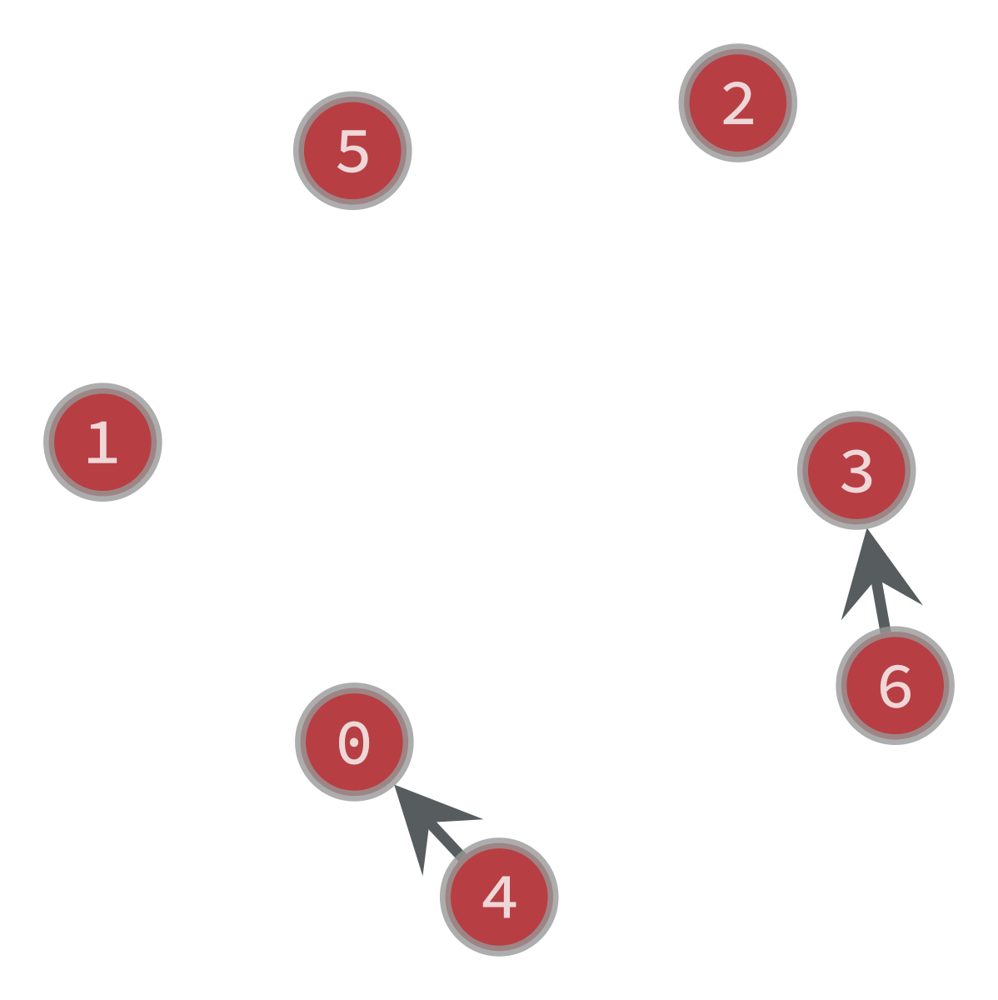

FEAS Algorithm finished with c: 16.0
Clock Period of the graph is: 9
Retiming: [0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 9
It doesn't improve the retiming.
Test with C: 18.0
Final graph created with FEAS: 


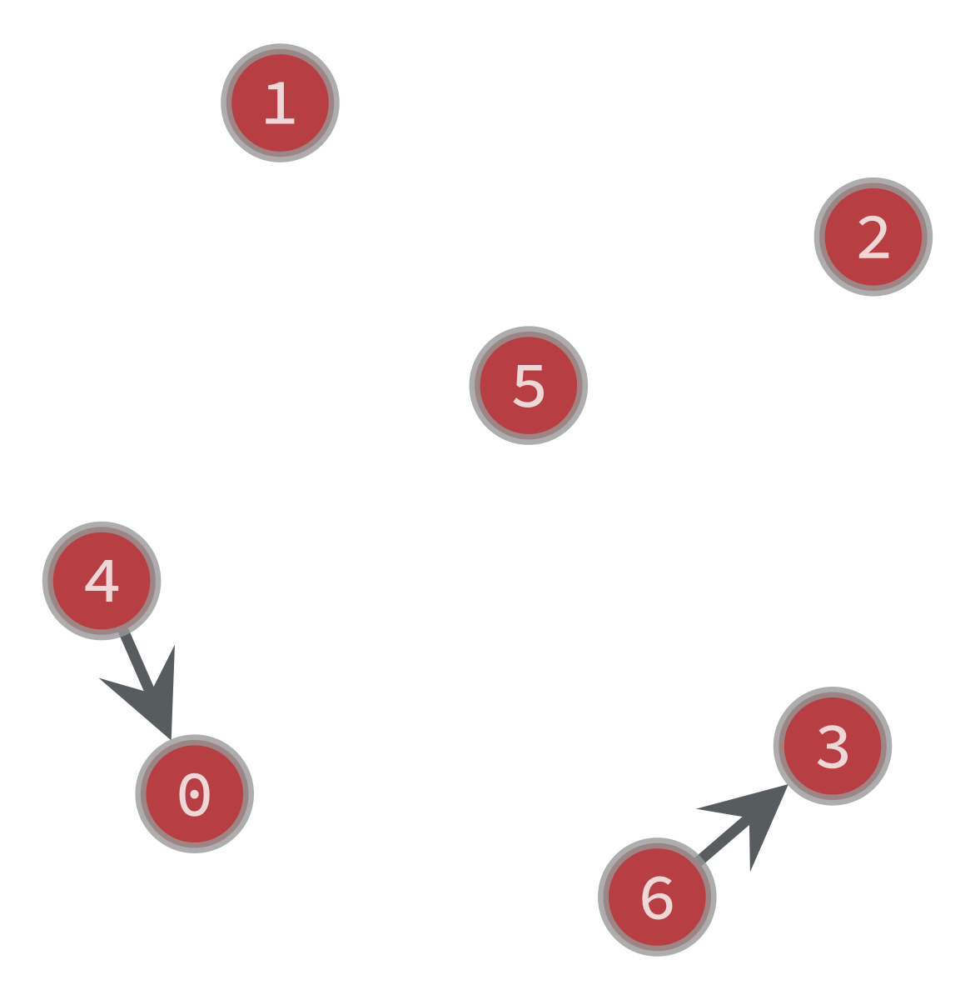

FEAS Algorithm finished with c: 18.0
Clock Period of the graph is: 9
Retiming: [0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 9
It doesn't improve the retiming.
Test with C: 19.0
Final graph created with FEAS: 


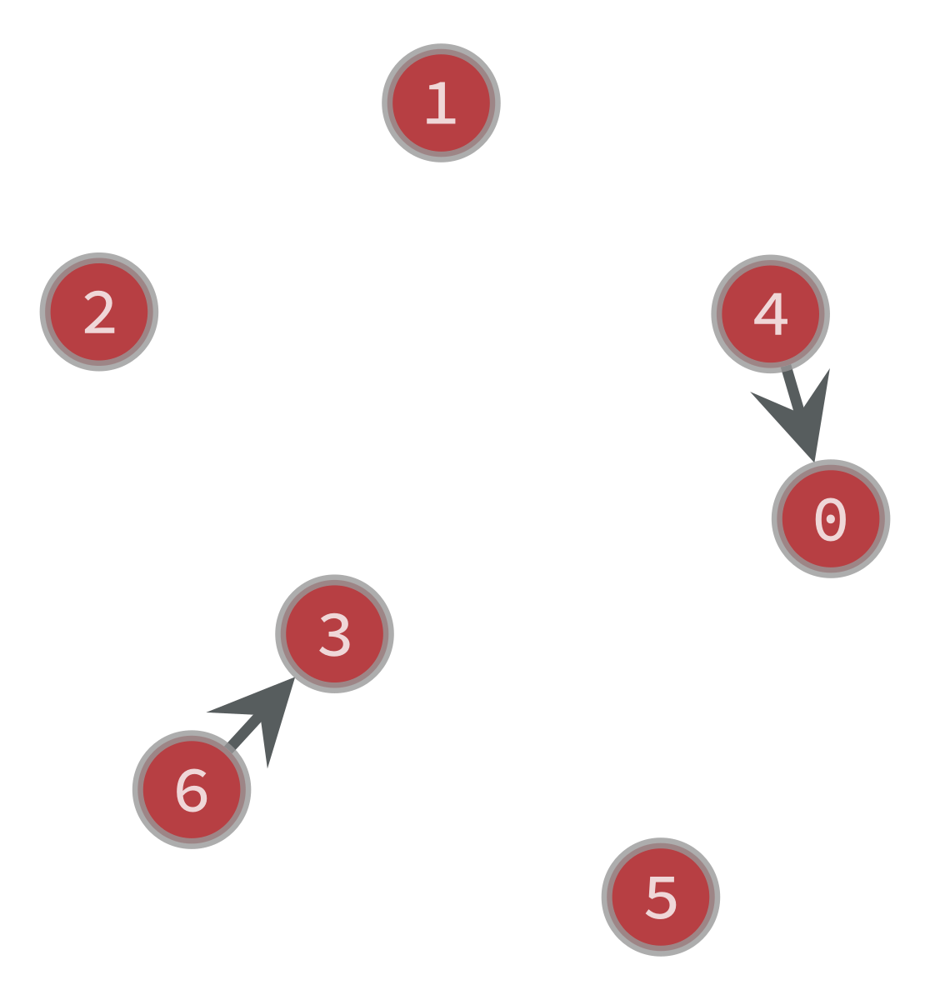

FEAS Algorithm finished with c: 19.0
Clock Period of the graph is: 9
Retiming: [0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 9
It doesn't improve the retiming.
Test with C: 20.0
Final graph created with FEAS: 


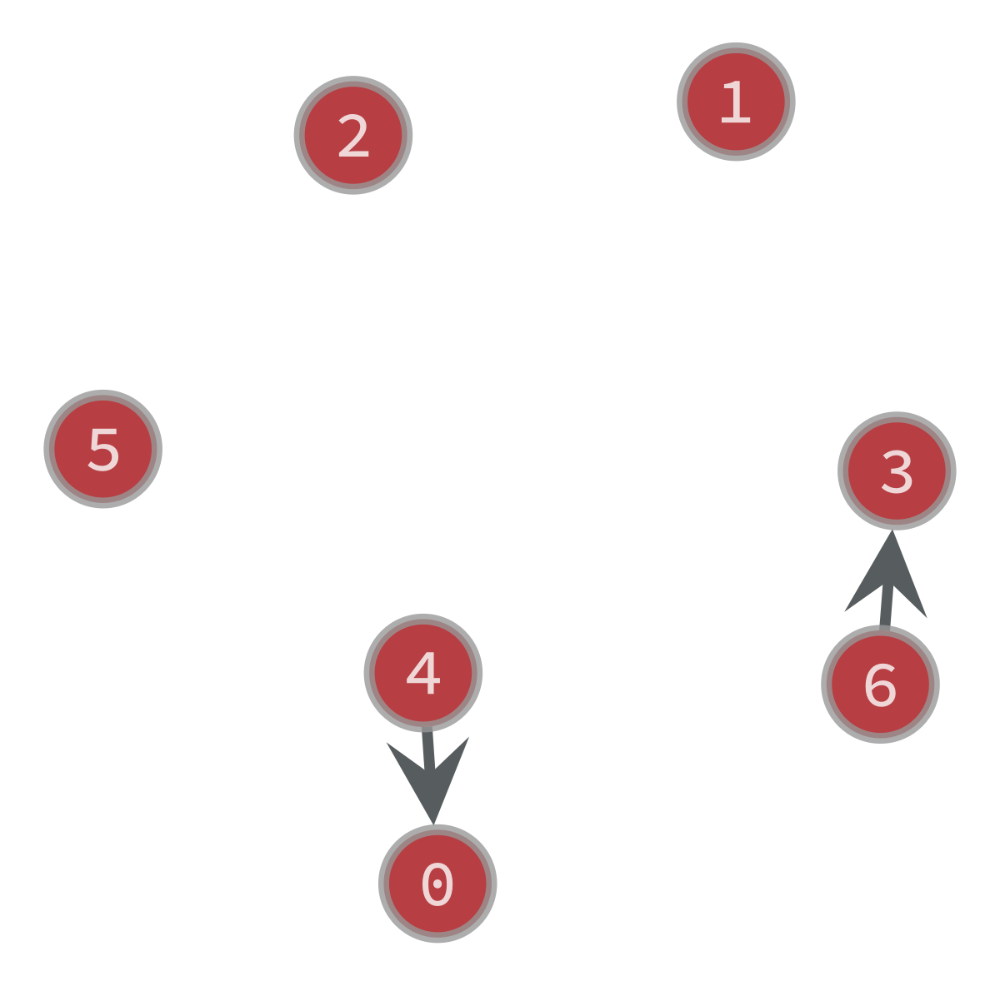

FEAS Algorithm finished with c: 20.0
Clock Period of the graph is: 9
Retiming: [0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 9
It doesn't improve the retiming.
Test with C: 21.0
Final graph created with FEAS: 


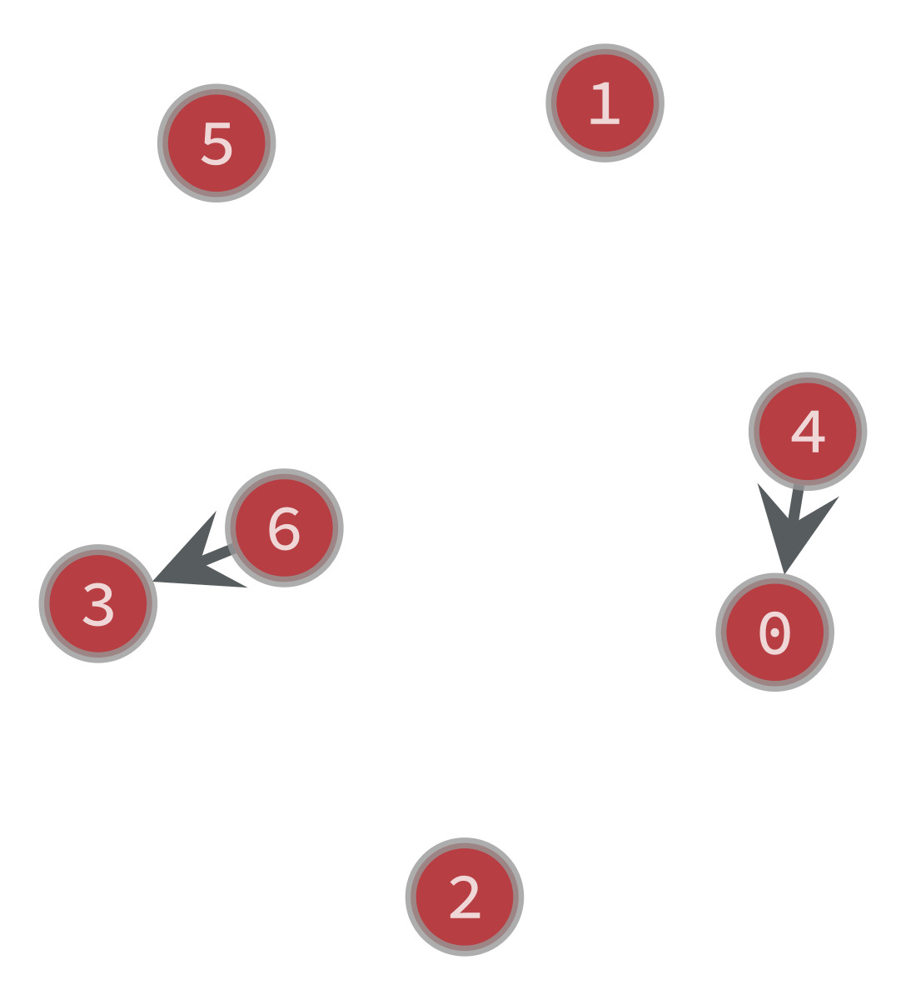

FEAS Algorithm finished with c: 21.0
Clock Period of the graph is: 9
Retiming: [0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 9
It doesn't improve the retiming.
Minimum Achievable Clock Period is: 6 with retiming: [0, 0, 0, 1, 0, 0, 0]
(6, [0, 0, 0, 1, 0, 0, 0])


In [149]:
print(OPT2(g100))

Final graph created with FEAS: 


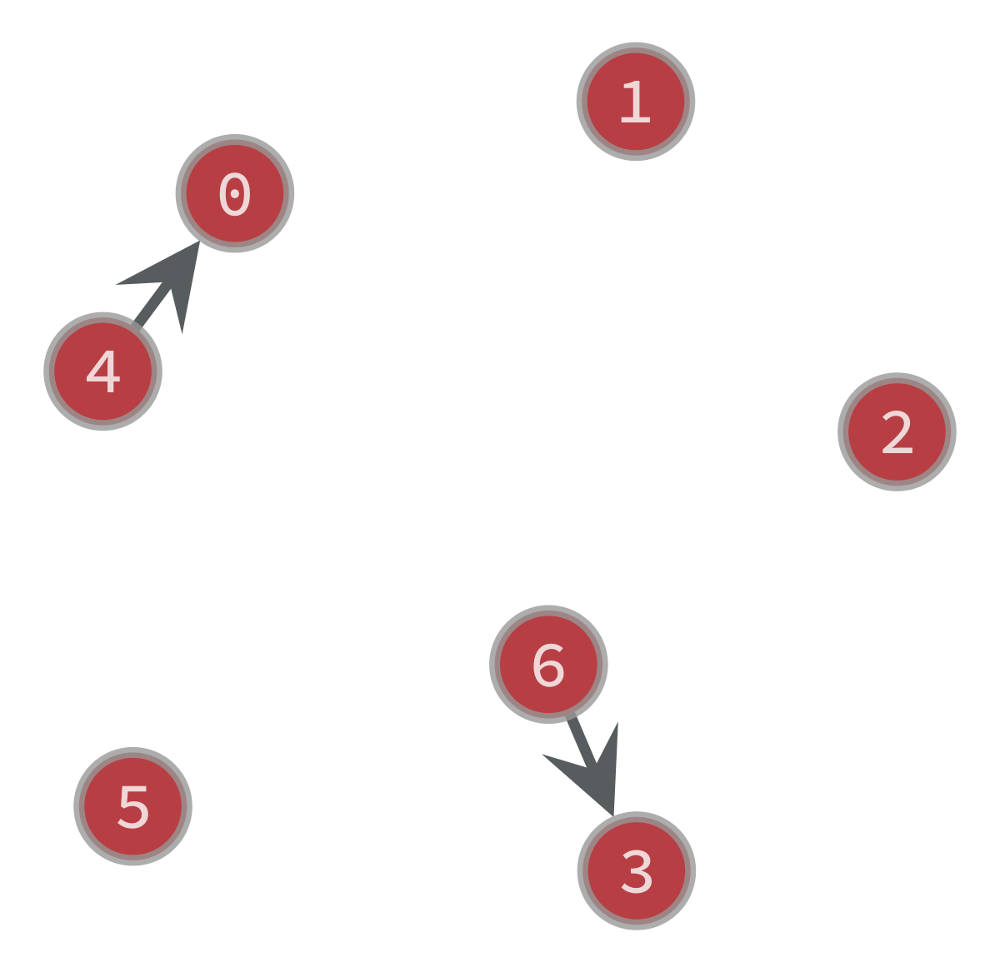

FEAS Algorithm finished with c: 13
Clock Period of the graph is: 9
Retiming: [0, 0, 0, 0, 0, 0, 0] is the desired retiming.
(9, [0, 0, 0, 0, 0, 0, 0])


In [151]:
print(FEAS(g100, 13))

In [152]:
gtest = gt.load_graph("generatedGraph.xml.gz")

W Matrix: 
[[0. 6. 3. 2. 1. 3. 3. 4. 3. 2.]
 [1. 0. 3. 2. 1. 3. 2. 4. 3. 3.]
 [7. 6. 0. 2. 3. 3. 0. 4. 3. 1.]
 [5. 4. 1. 0. 1. 1. 1. 2. 1. 2.]
 [6. 5. 2. 1. 0. 2. 2. 3. 2. 1.]
 [4. 3. 2. 1. 0. 0. 2. 1. 0. 1.]
 [7. 6. 3. 2. 3. 3. 0. 4. 3. 1.]
 [3. 2. 2. 1. 3. 2. 4. 0. 2. 0.]
 [6. 5. 2. 1. 0. 2. 2. 3. 0. 1.]
 [6. 5. 2. 1. 2. 2. 2. 3. 2. 0.]]
D Matrix: 
[[ 0. 20.  6.  7.  4. 12. 12. 19. 20. 13.]
 [ 1.  1.  7.  8.  5. 13.  7. 20. 21. 16.]
 [33. 33.  2. 20. 37. 25.  8. 32. 33. 17.]
 [16. 16.  5.  3. 20.  8.  9. 15. 16. 18.]
 [20. 20.  6.  7.  4. 12. 12. 19. 20. 13.]
 [13. 13. 10.  8. 17.  5. 14. 12. 13. 21.]
 [31. 31. 20. 18. 35. 23.  6. 30. 31. 15.]
 [ 8.  8. 21. 19. 12. 24. 14.  7. 32. 16.]
 [28. 28. 10. 15. 12. 20. 16. 27.  8. 21.]
 [25. 25. 14. 12. 29. 17. 18. 24. 25.  9.]]
Test with C: 0.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , val

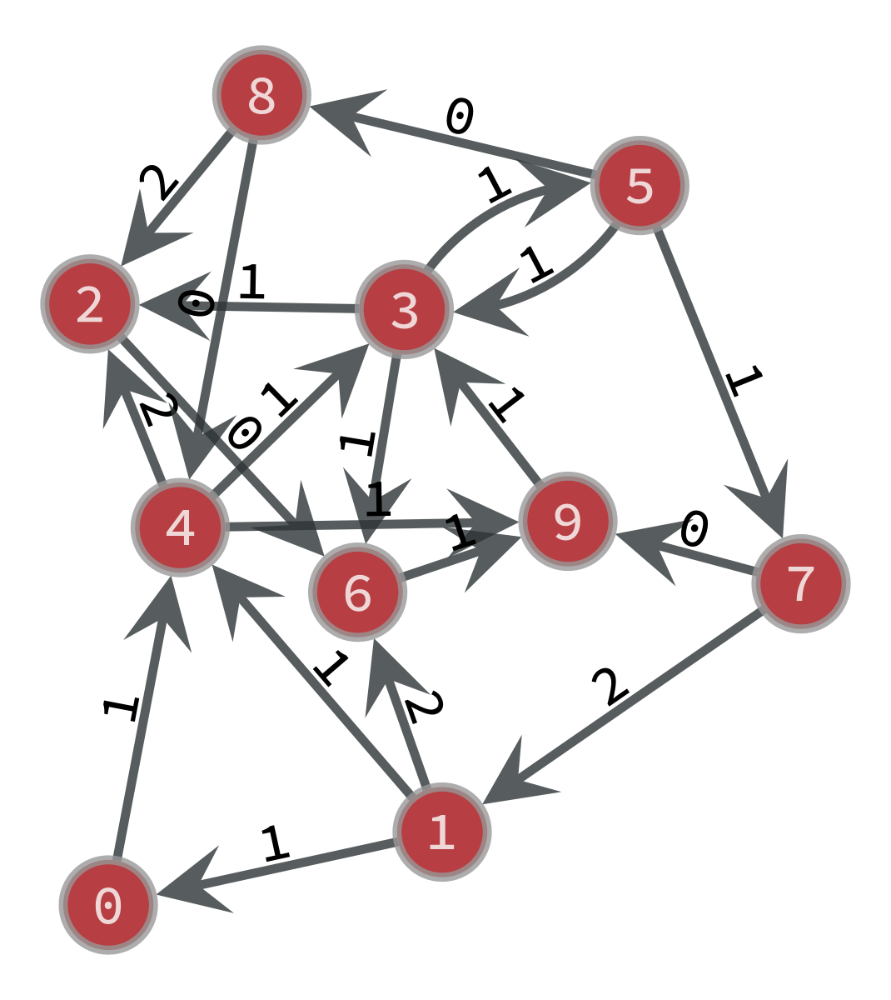

Graph G0 taken from Gr: 


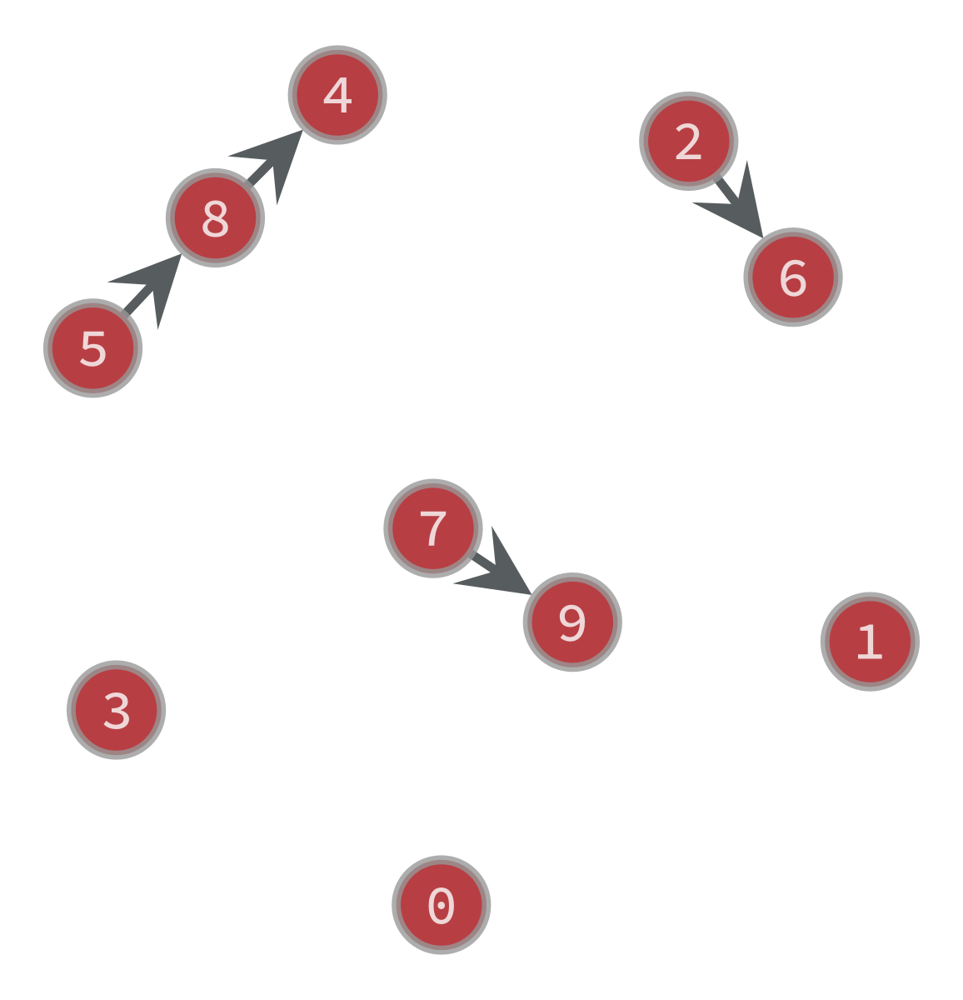

Clock Period of the graph is: 17 with value of c as: 0.0
Test with C: 1.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


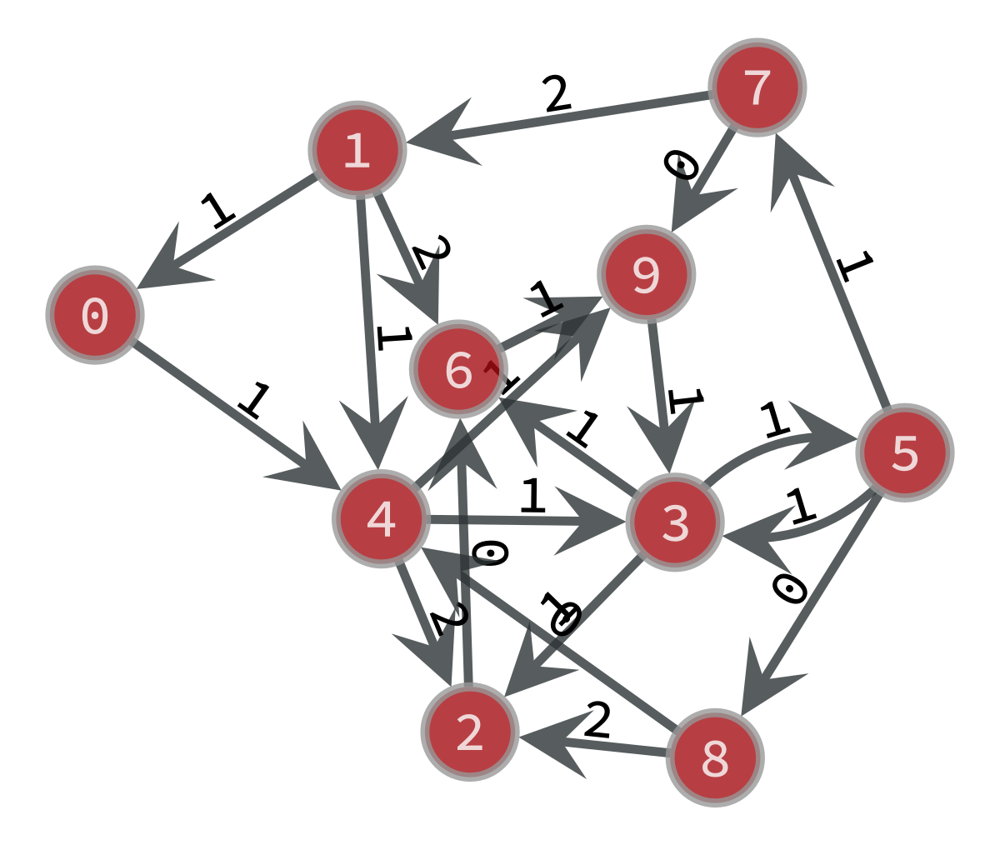

Graph G0 taken from Gr: 


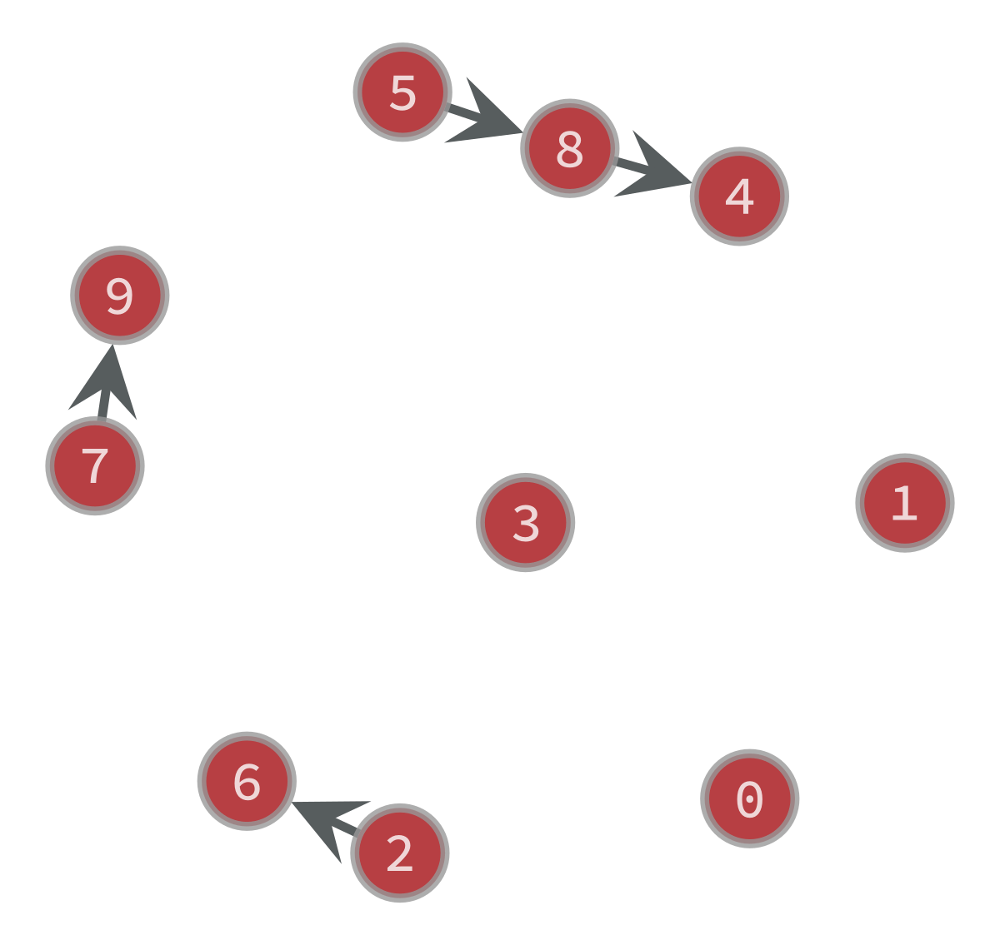

Clock Period of the graph is: 17 with value of c as: 1.0
Test with C: 2.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


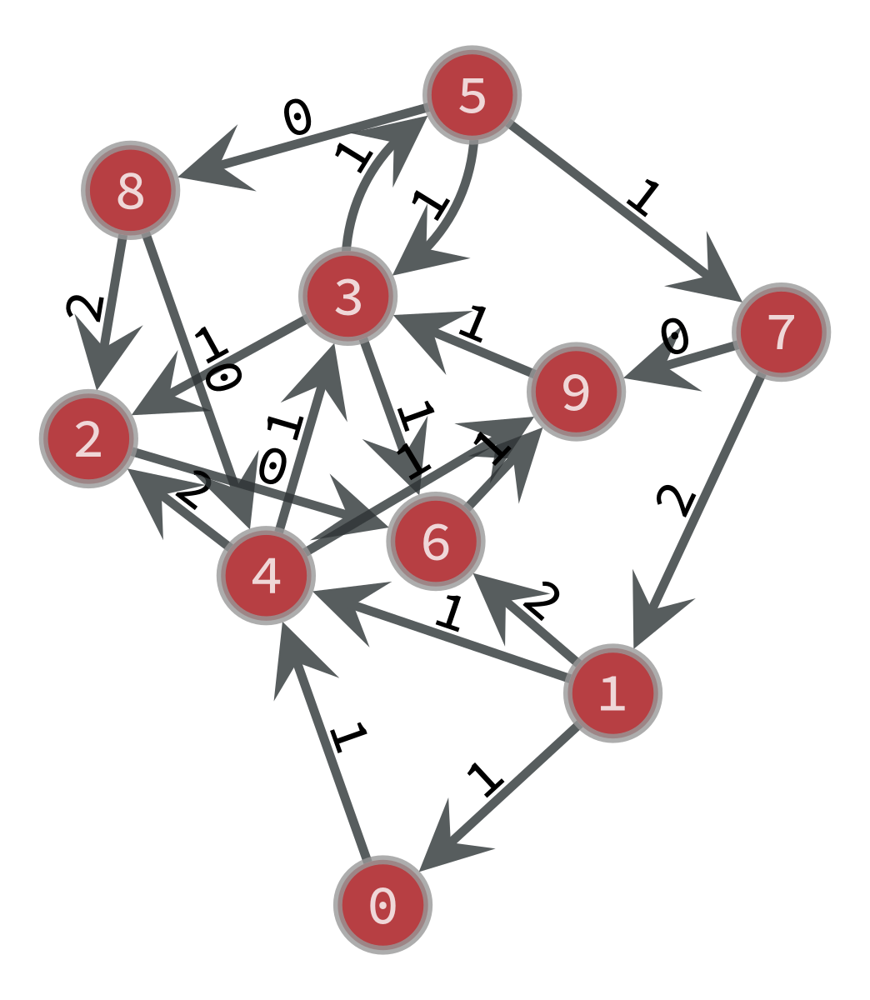

Graph G0 taken from Gr: 


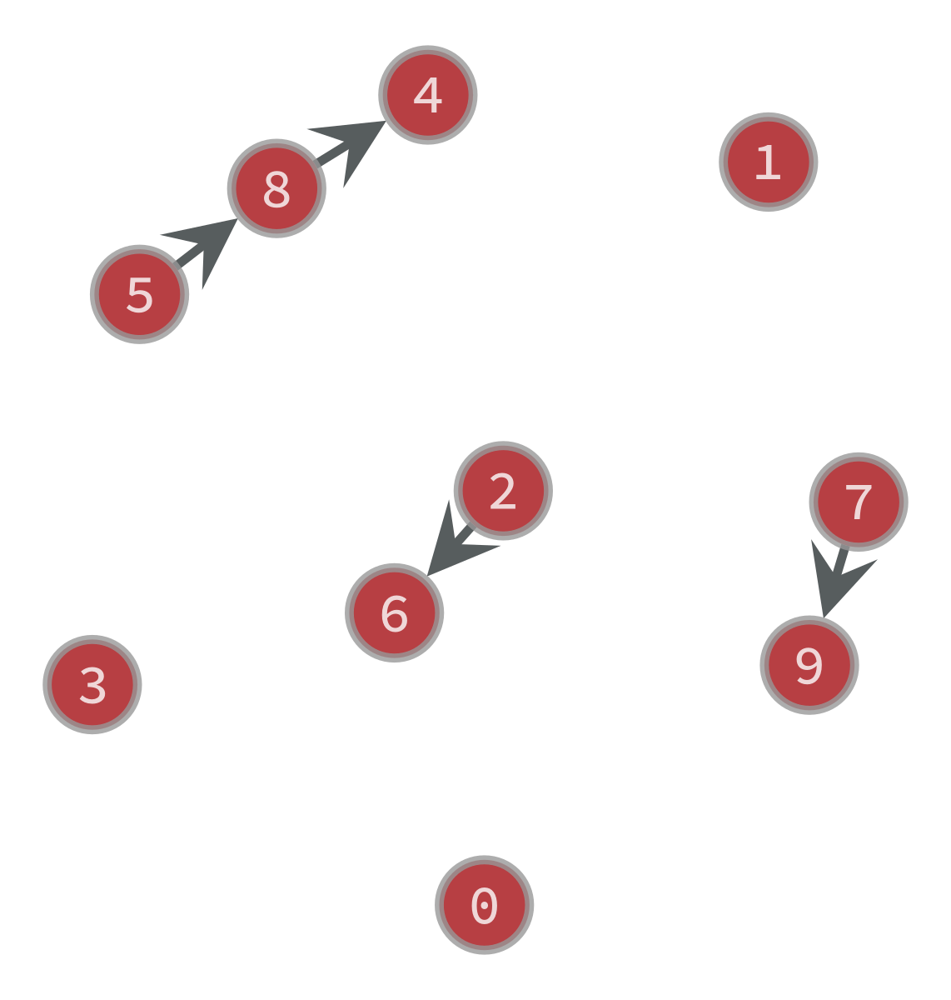

Clock Period of the graph is: 17 with value of c as: 2.0
Test with C: 3.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


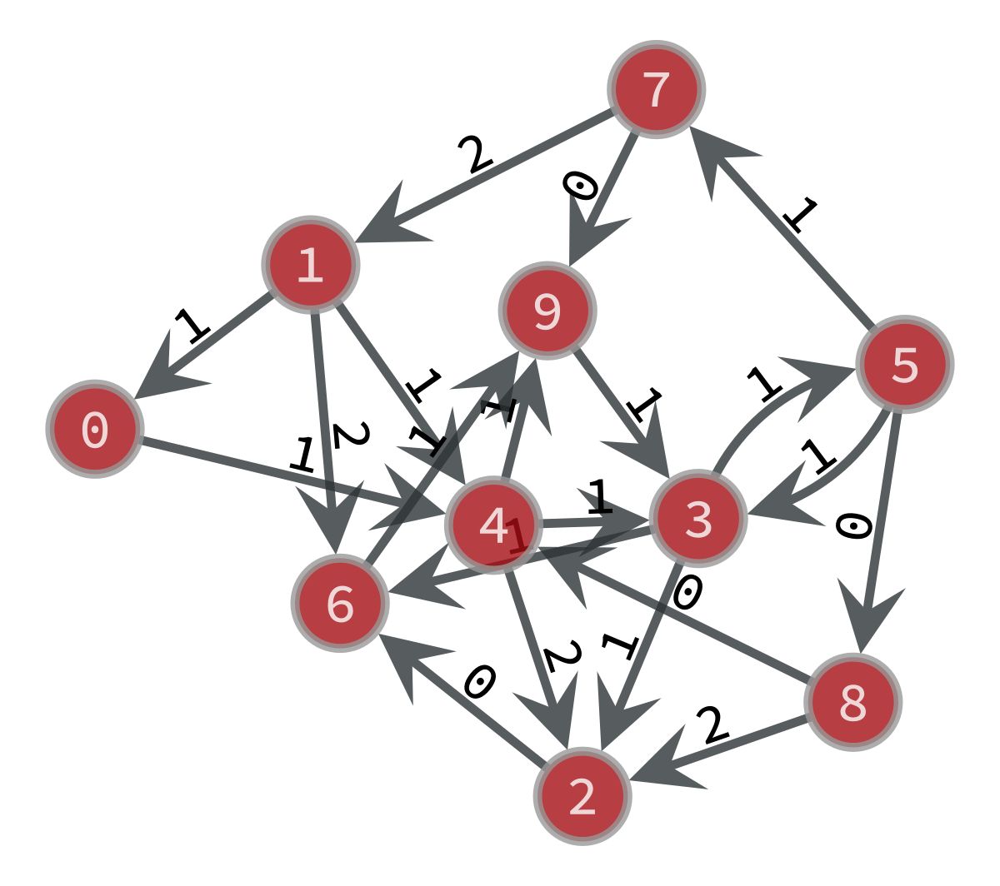

Graph G0 taken from Gr: 


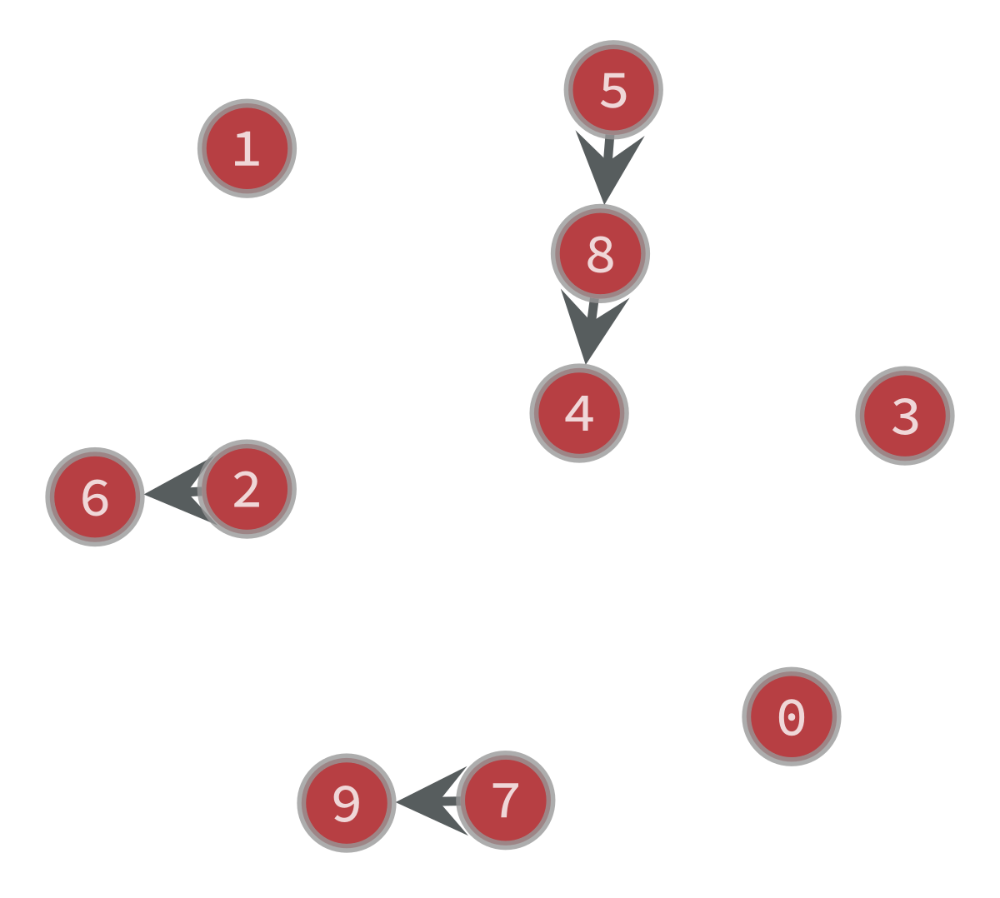

Clock Period of the graph is: 17 with value of c as: 3.0
Test with C: 4.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


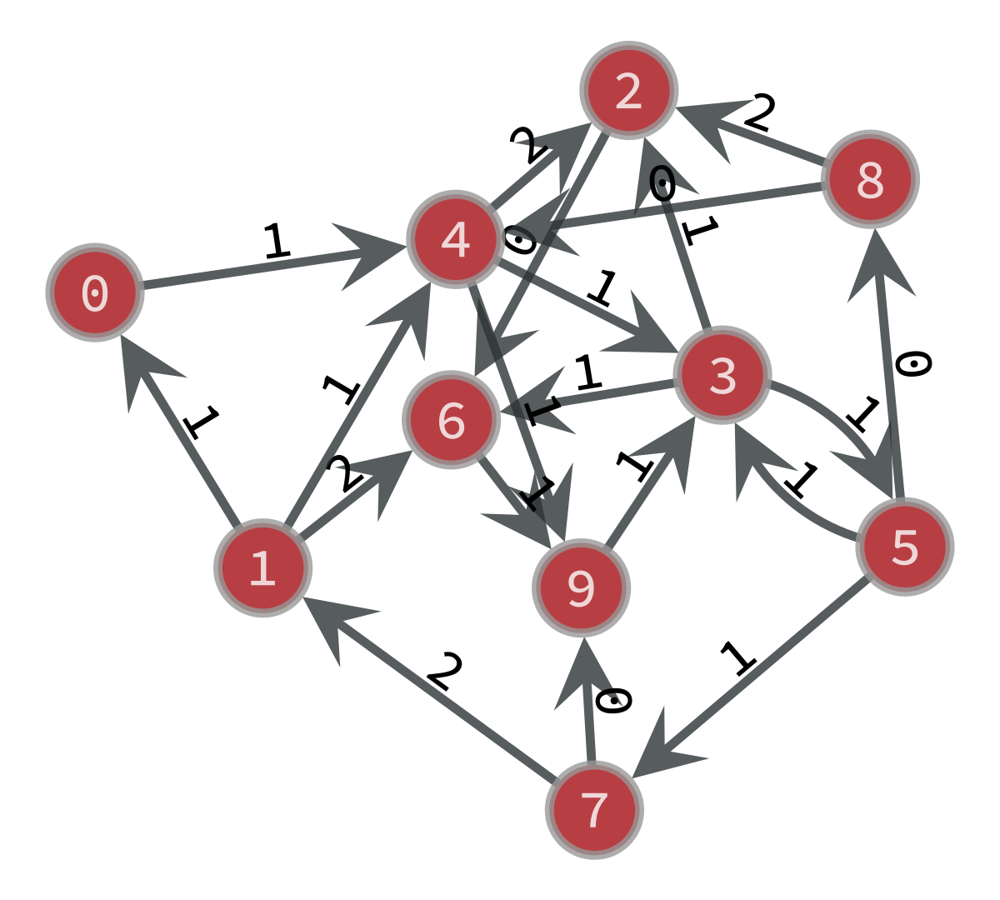

Graph G0 taken from Gr: 


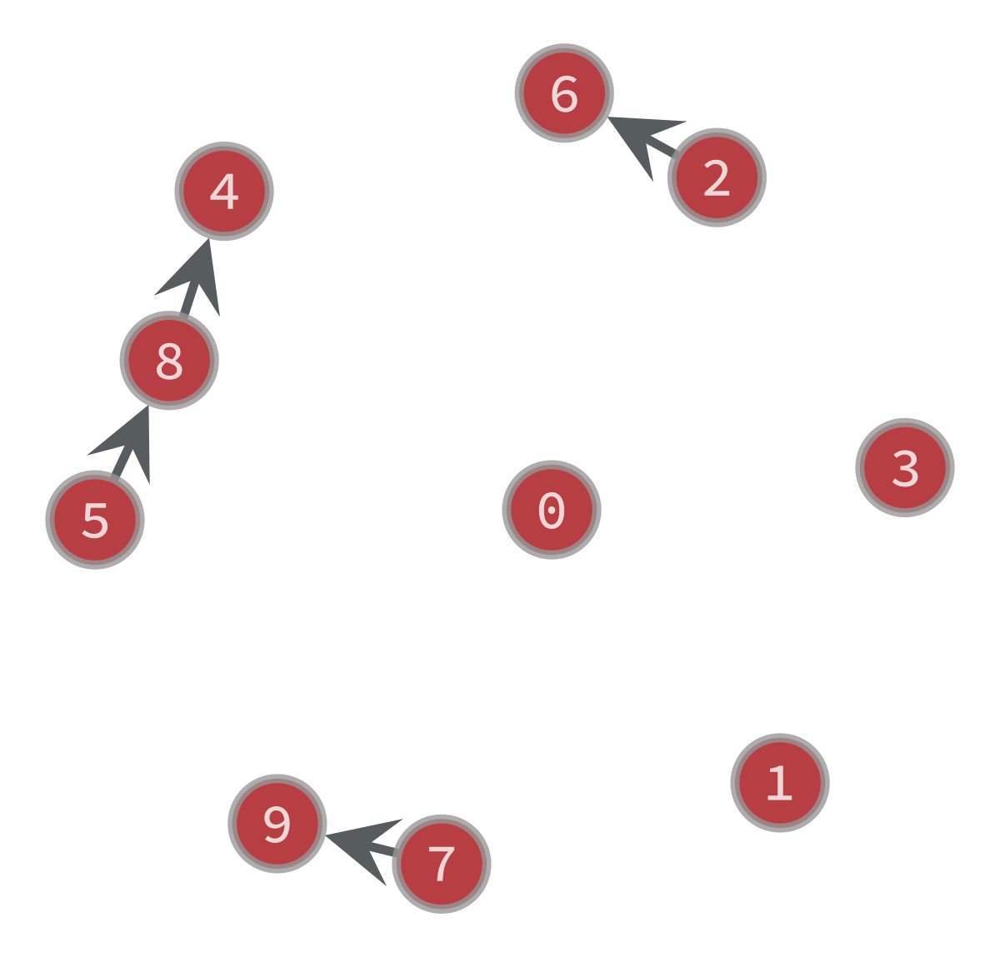

Clock Period of the graph is: 17 with value of c as: 4.0
Test with C: 5.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


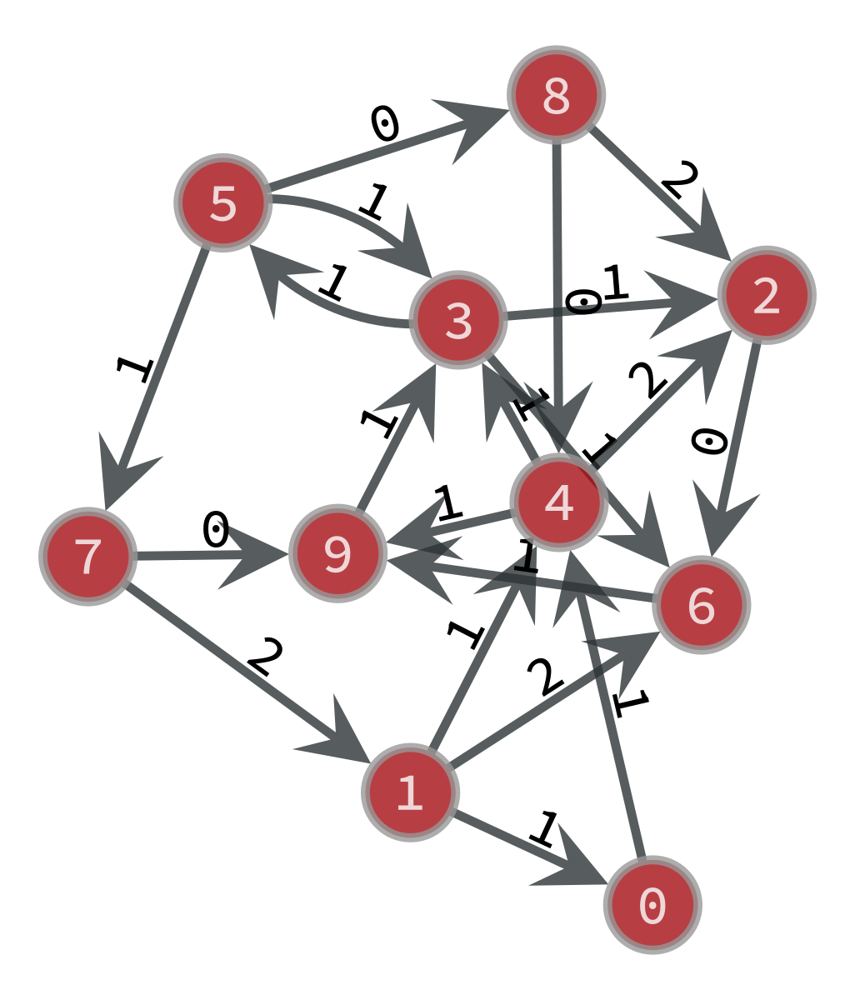

Graph G0 taken from Gr: 


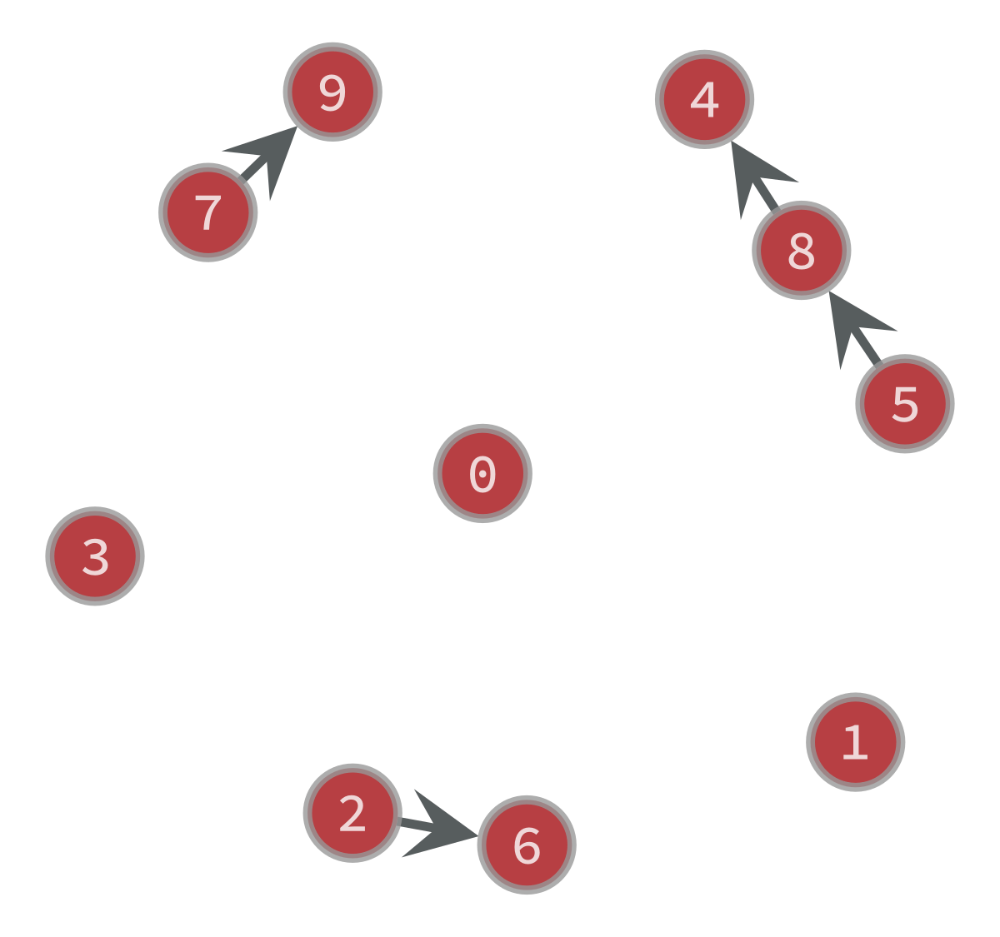

Clock Period of the graph is: 17 with value of c as: 5.0
Test with C: 6.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: -1.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
-1.0
0.0
0.0
0.0
New Graph Gr: 


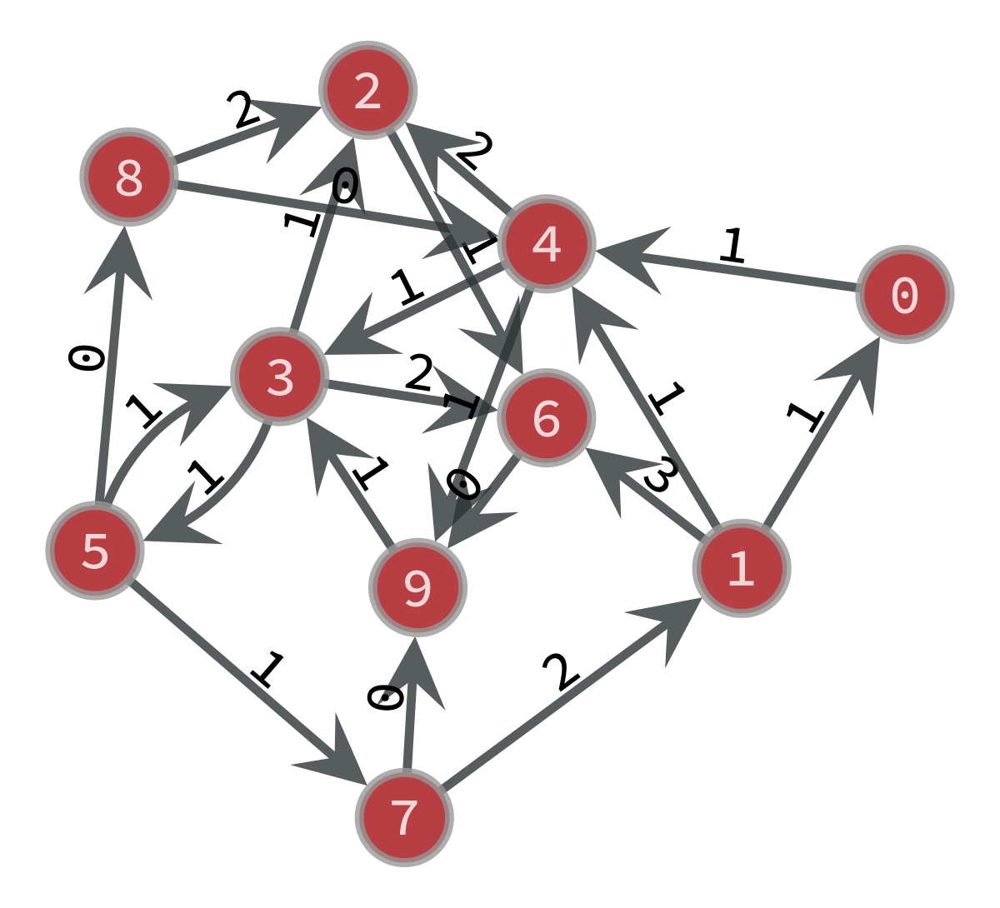

Graph G0 taken from Gr: 


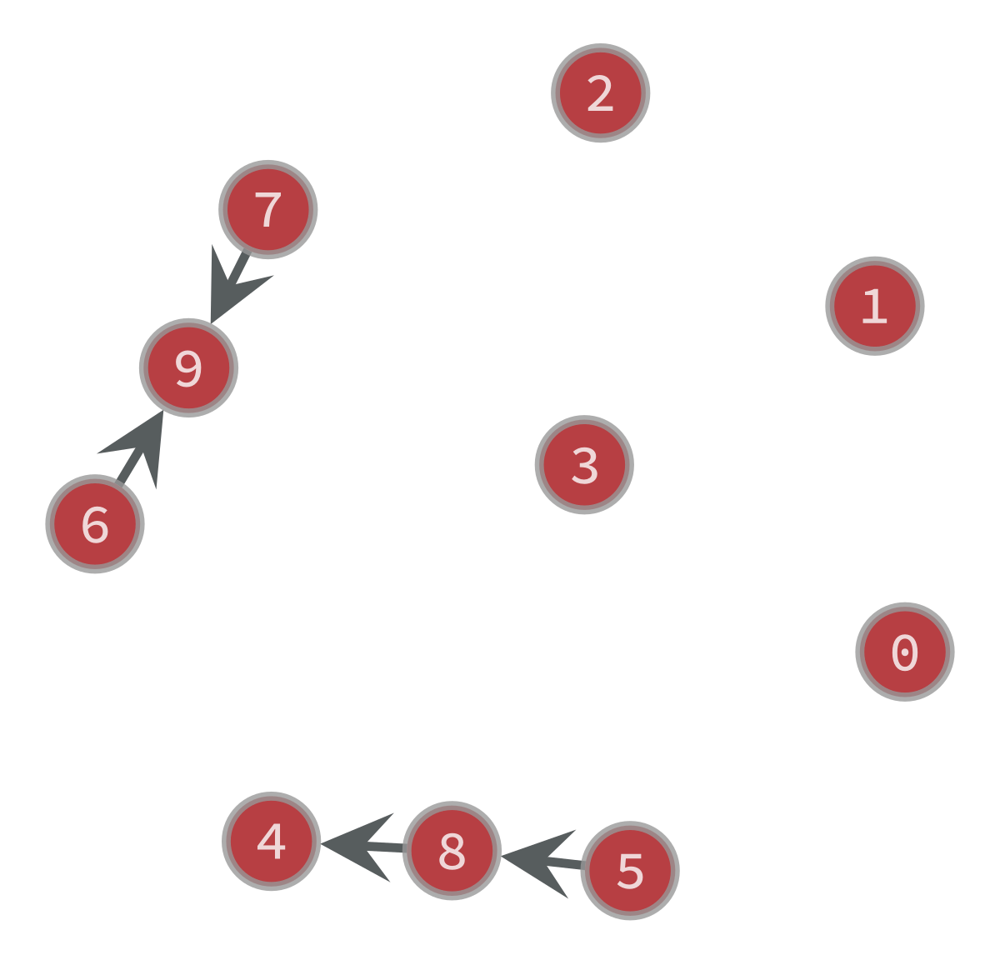

Clock Period of the graph is: 17 with value of c as: 6.0
Test with C: 7.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: -1.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
-1.0
0.0
0.0
0.0
New Graph Gr: 


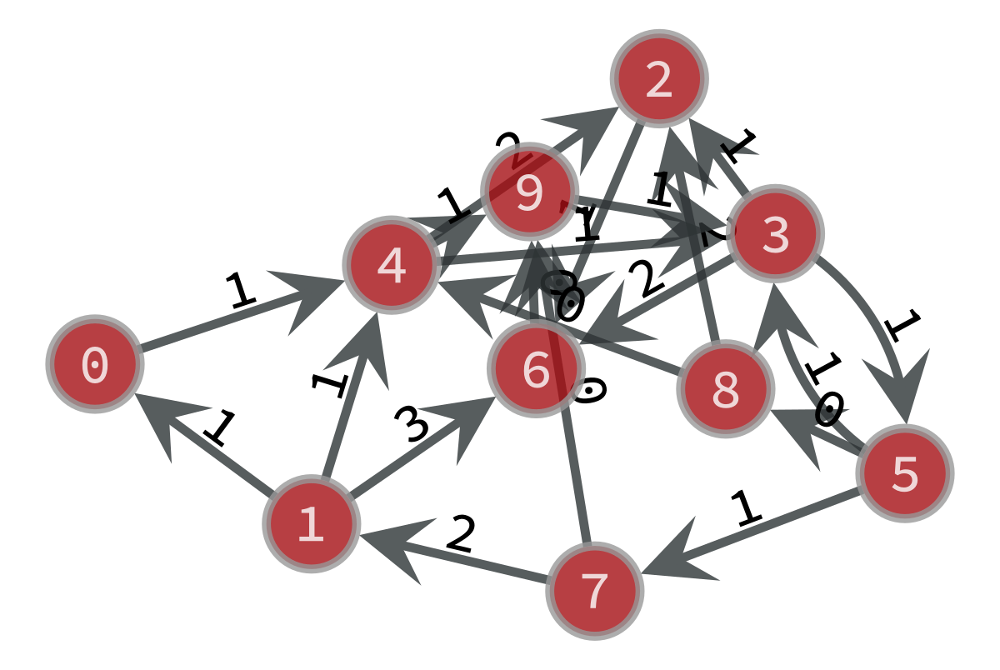

Graph G0 taken from Gr: 


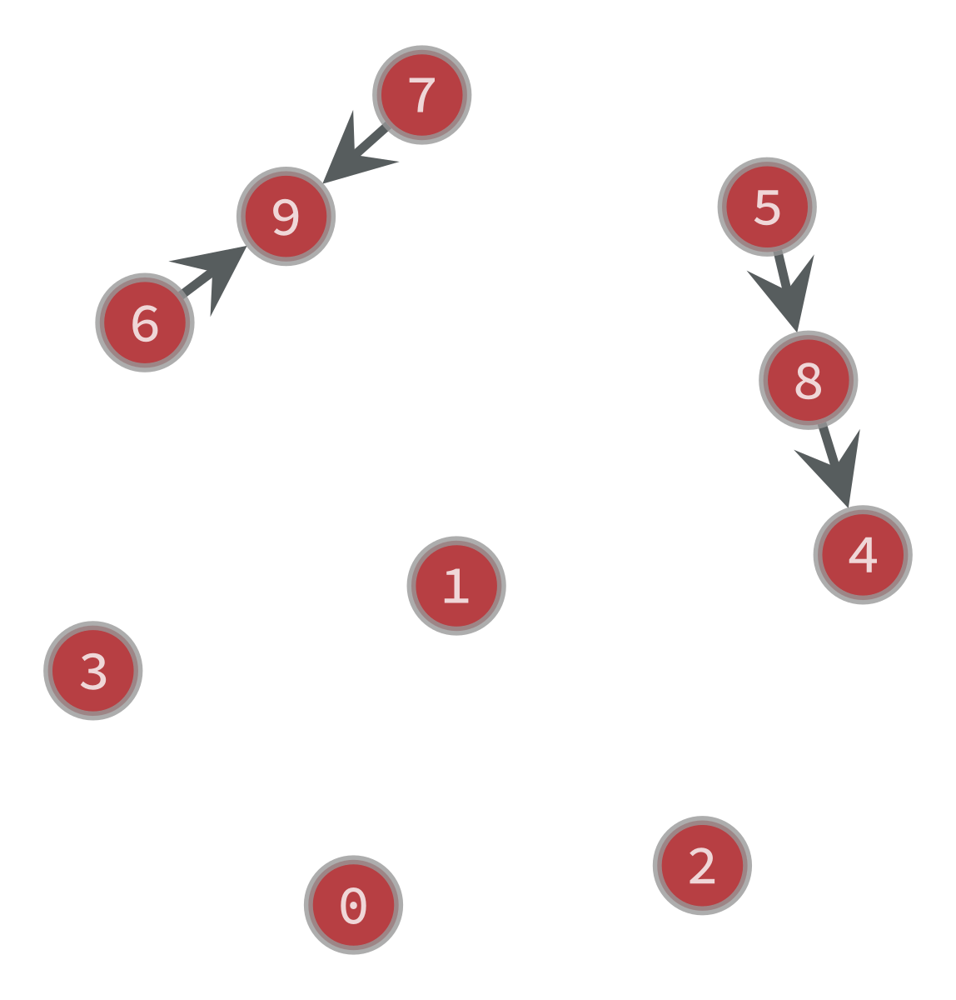

Clock Period of the graph is: 17 with value of c as: 7.0
Test with C: 8.0
Negative Loops Found. Skipping Solution...
Test with C: 9.0
Negative Loops Found. Skipping Solution...
Test with C: 10.0
Negative Loops Found. Skipping Solution...
Test with C: 12.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: -1.0 
Variable: 4 , value: -1.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: -1.0 
Variable: 9 , value: -1.0 
0.0
0.0
0.0
-1.0
-1.0
0.0
0.0
0.0
-1.0
-1.0
New Graph Gr: 


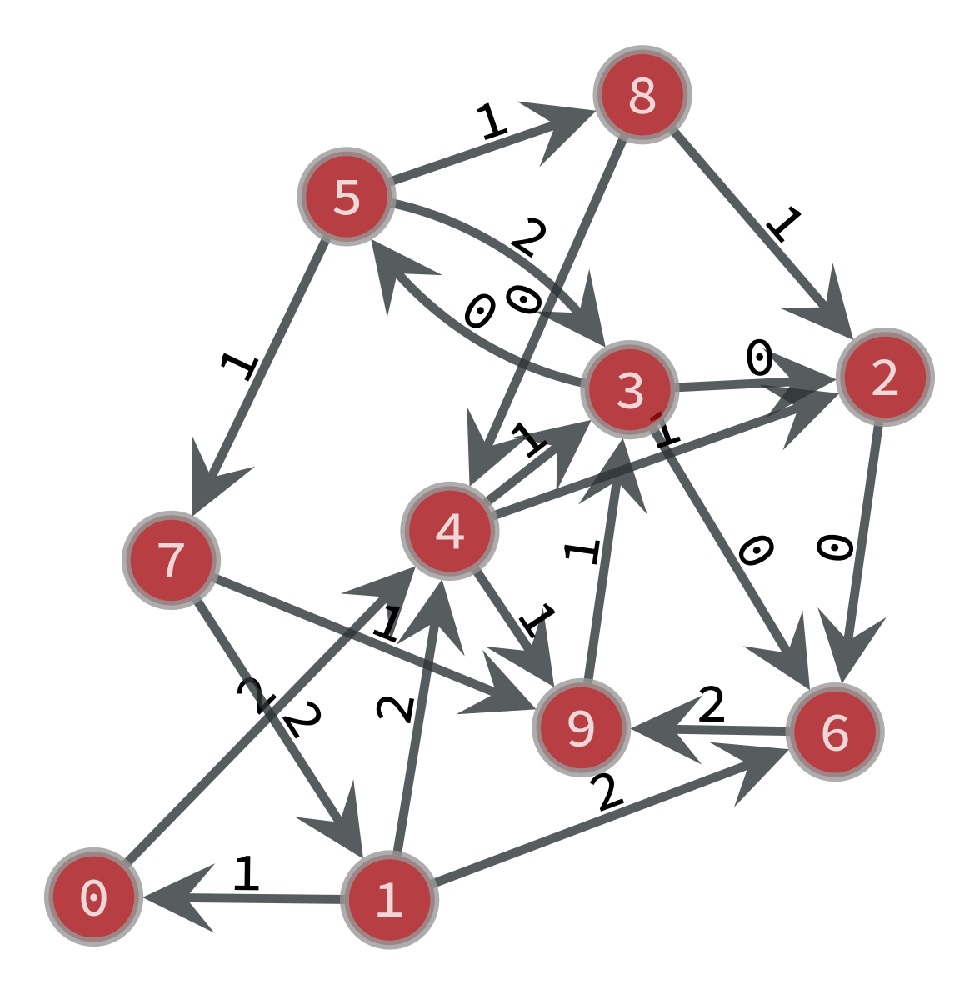

Graph G0 taken from Gr: 


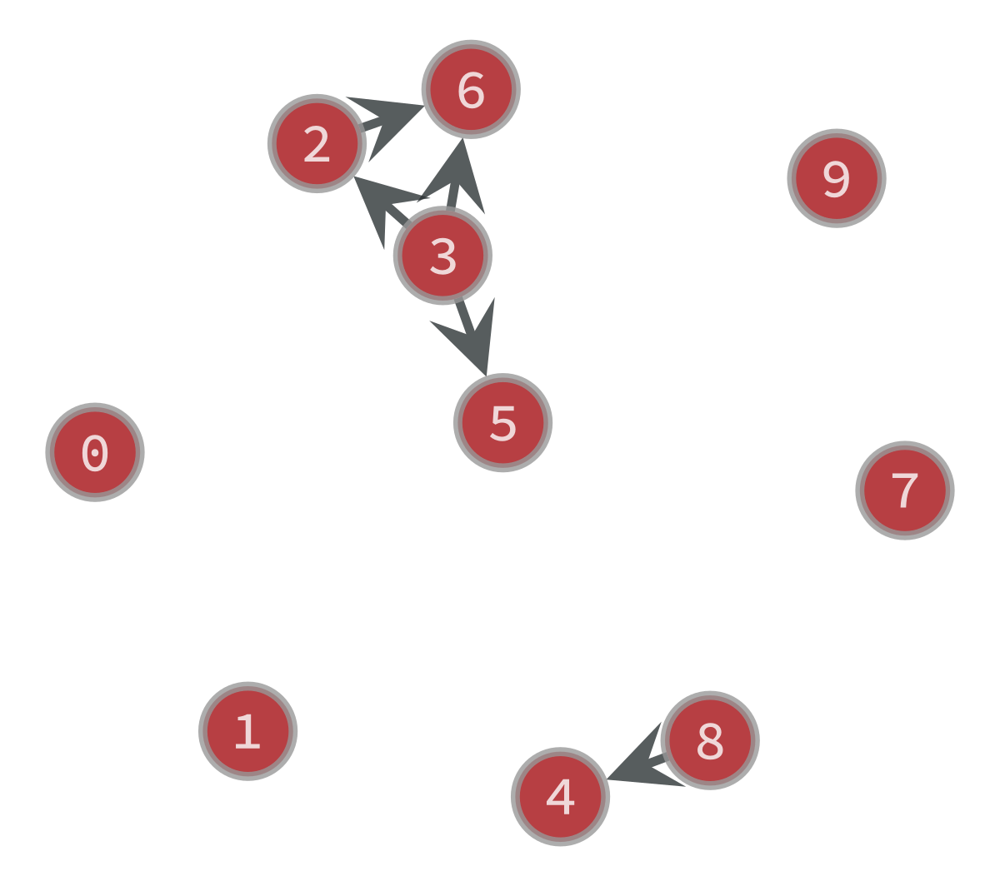

Clock Period of the graph is: 12 with value of c as: 12.0
Test with C: 13.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: -1.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: -1.0 
0.0
0.0
0.0
0.0
-1.0
0.0
0.0
0.0
0.0
-1.0
New Graph Gr: 


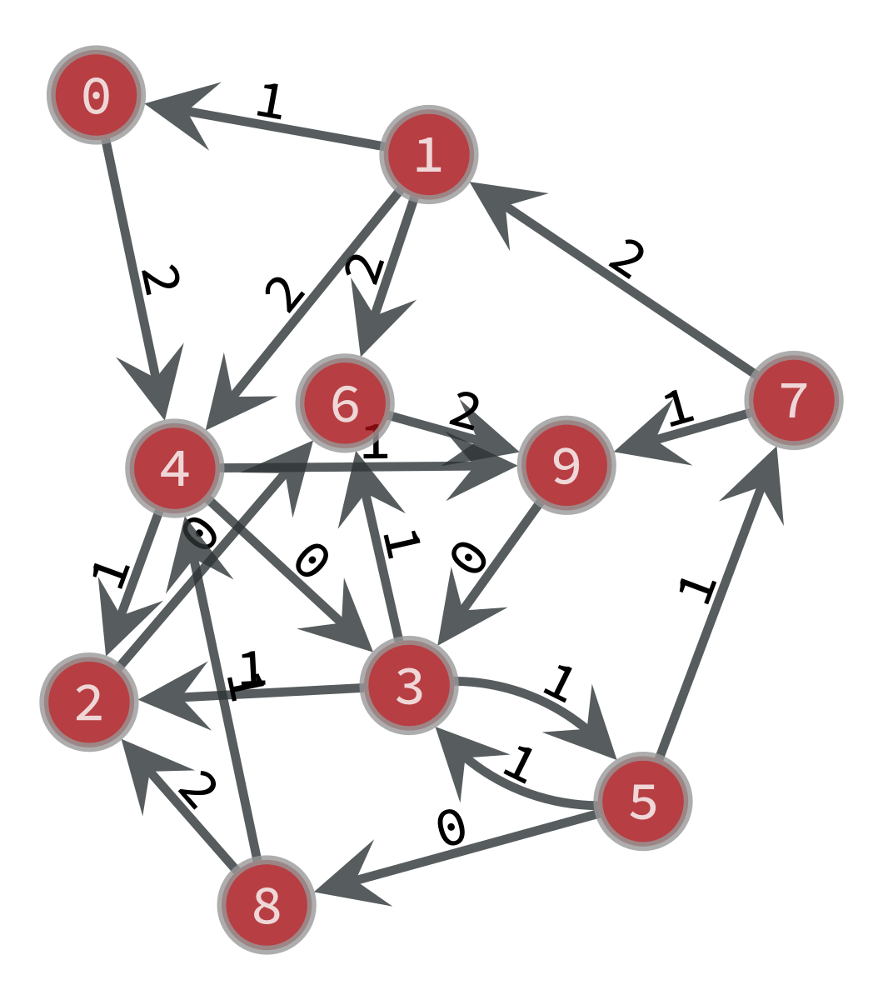

Graph G0 taken from Gr: 


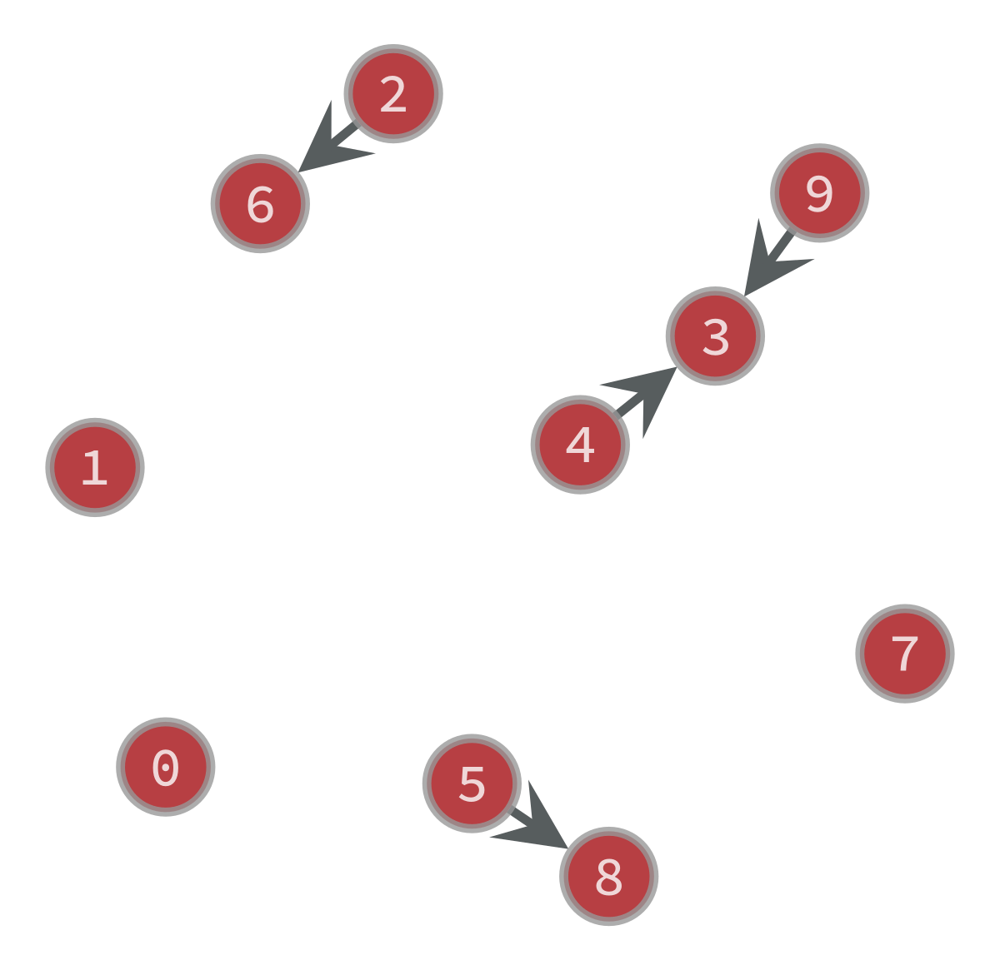

Clock Period of the graph is: 13 with value of c as: 13.0
Test with C: 14.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: -1.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: -1.0 
0.0
0.0
0.0
0.0
-1.0
0.0
0.0
0.0
0.0
-1.0
New Graph Gr: 


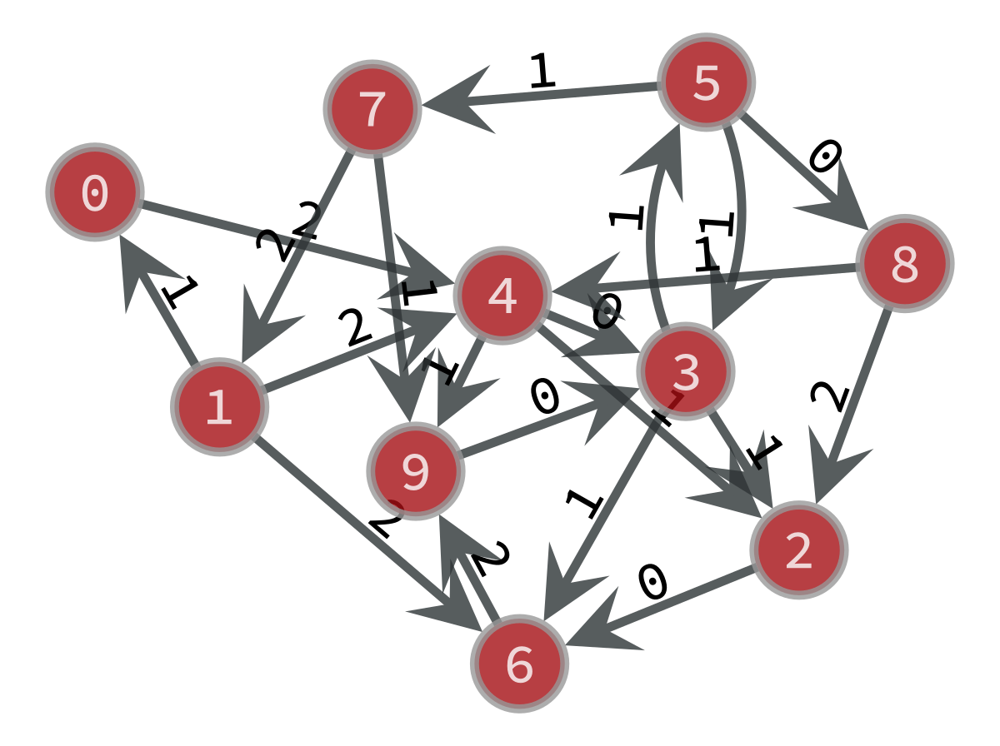

Graph G0 taken from Gr: 


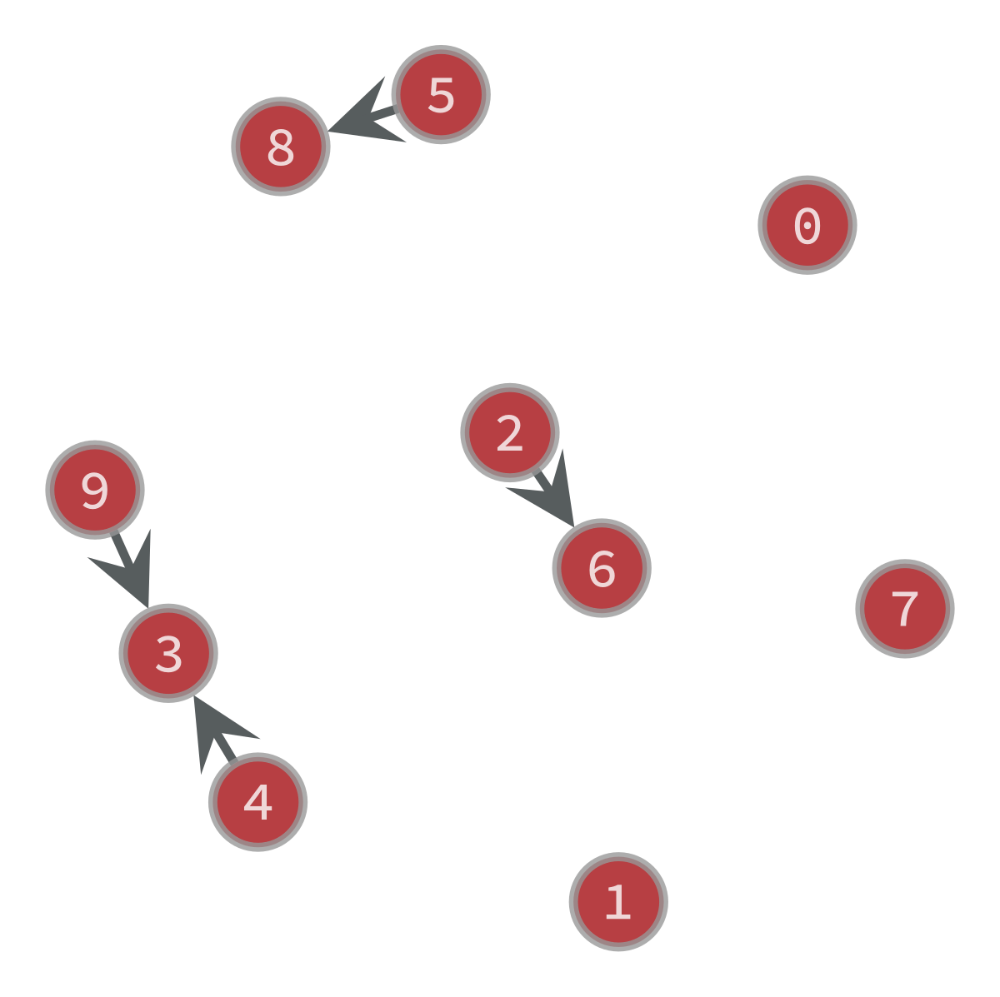

Clock Period of the graph is: 13 with value of c as: 14.0
Test with C: 15.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: -1.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: -1.0 
0.0
0.0
0.0
0.0
-1.0
0.0
0.0
0.0
0.0
-1.0
New Graph Gr: 


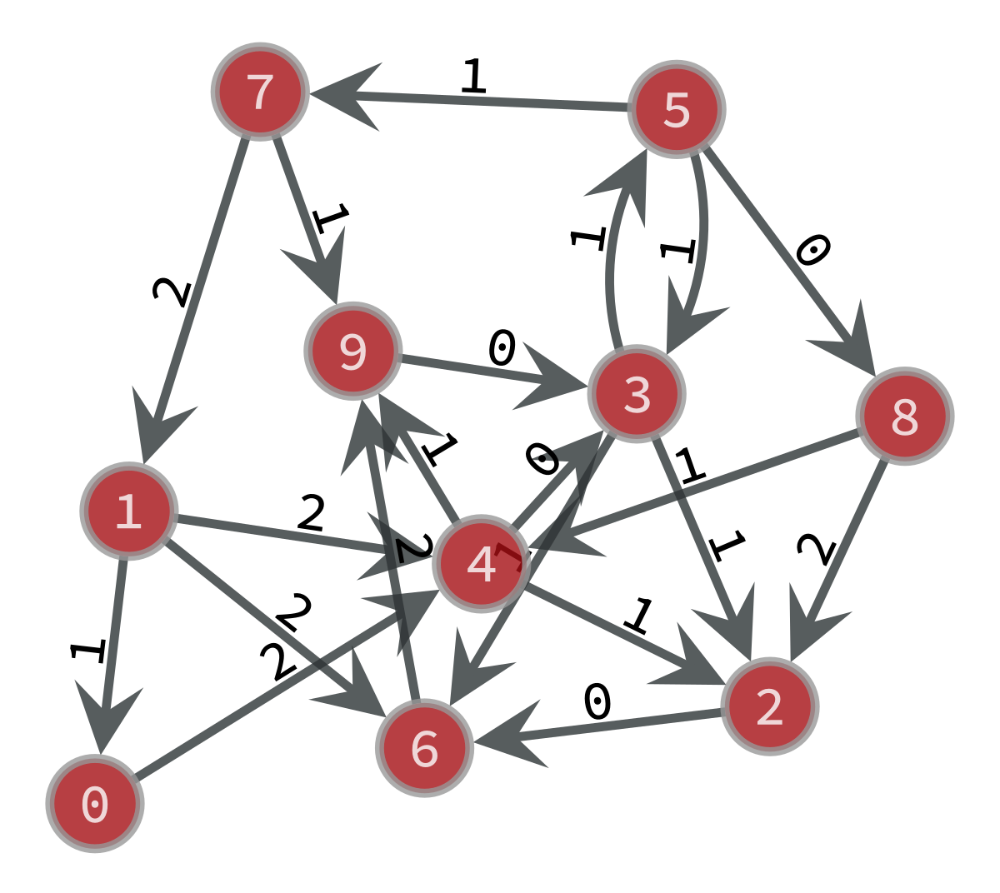

Graph G0 taken from Gr: 


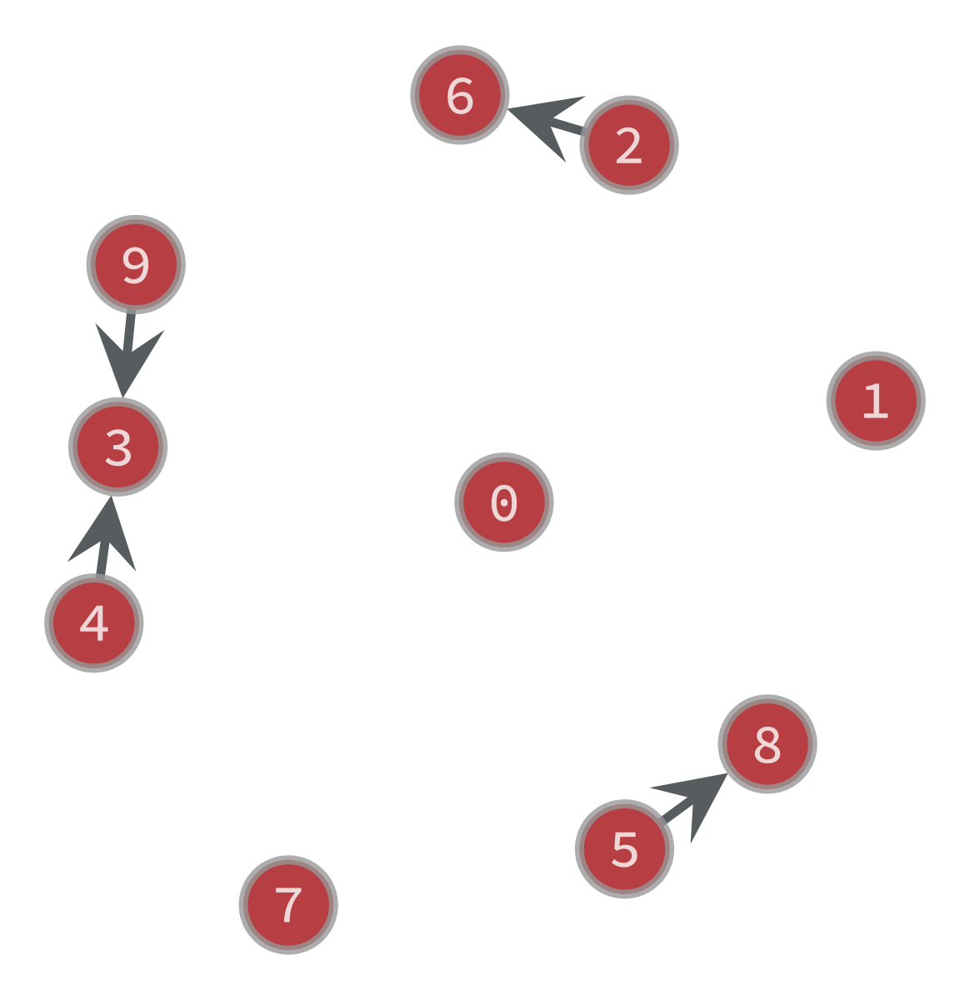

Clock Period of the graph is: 13 with value of c as: 15.0
Test with C: 16.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: -1.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
-1.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


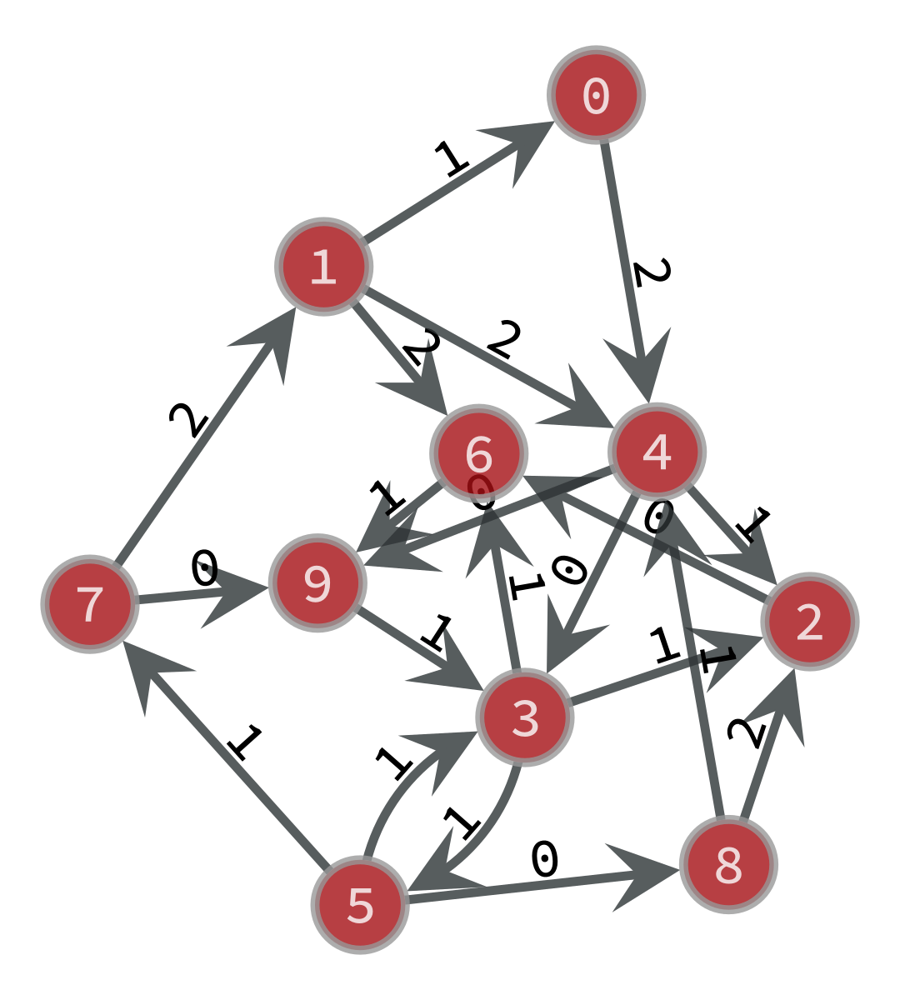

Graph G0 taken from Gr: 


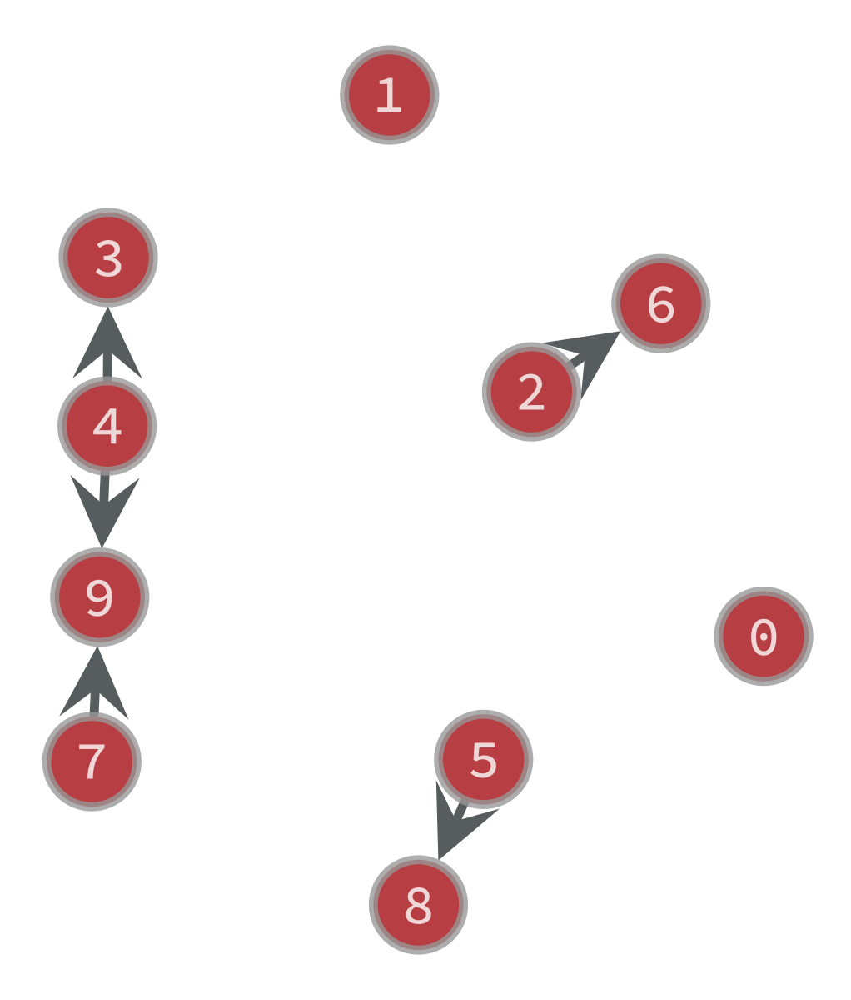

Clock Period of the graph is: 16 with value of c as: 16.0
Test with C: 17.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


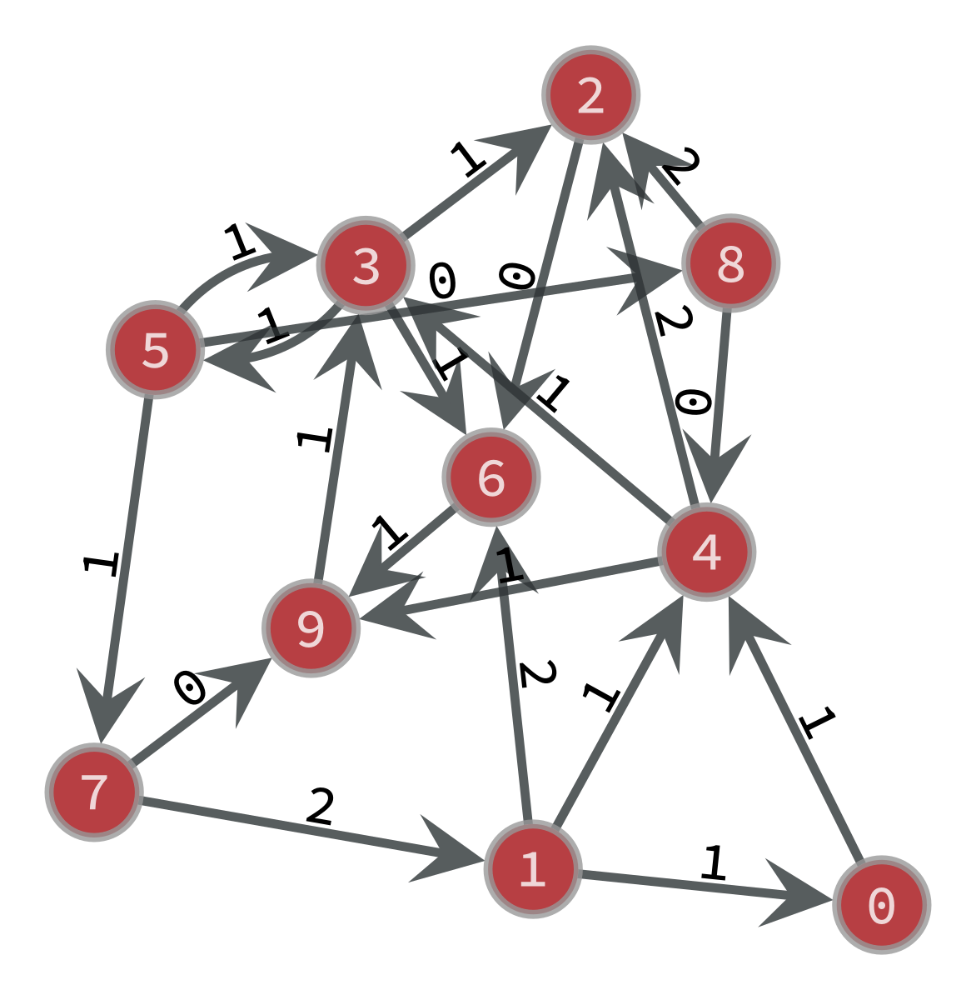

Graph G0 taken from Gr: 


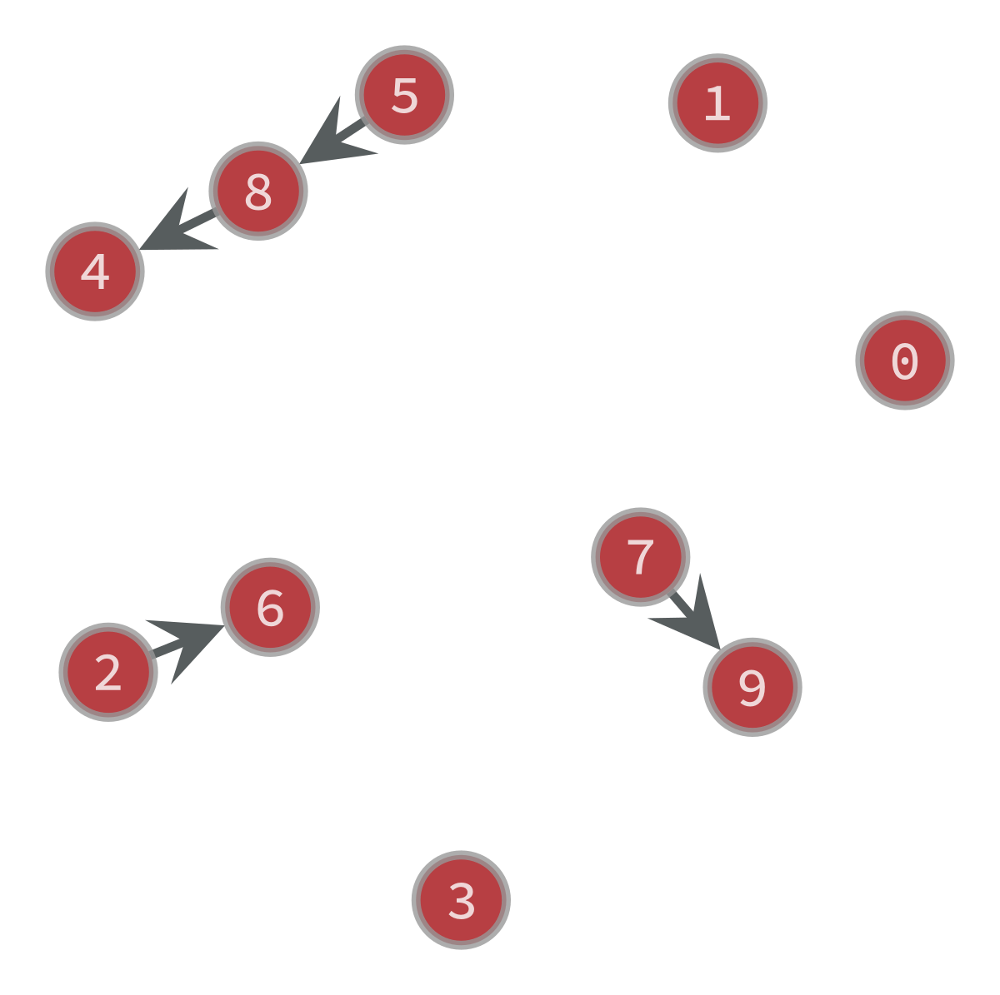

Clock Period of the graph is: 17 with value of c as: 17.0
Test with C: 18.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


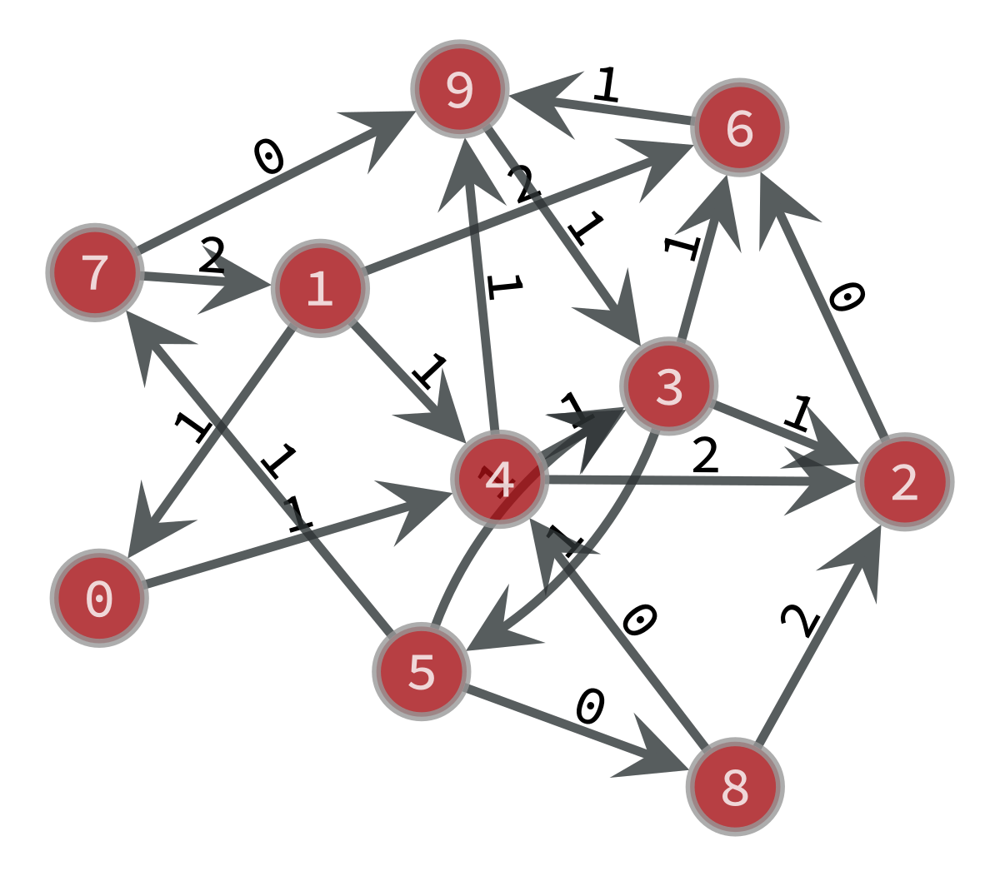

Graph G0 taken from Gr: 


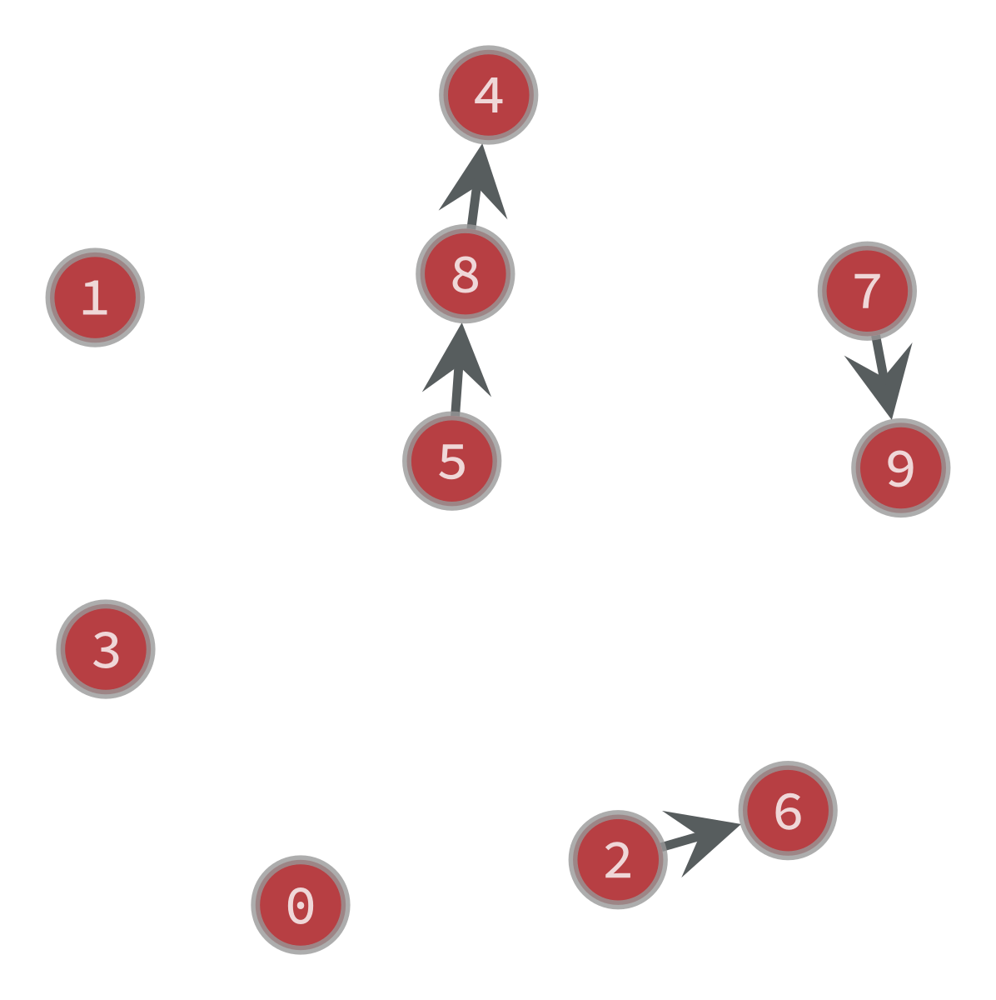

Clock Period of the graph is: 17 with value of c as: 18.0
Test with C: 19.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


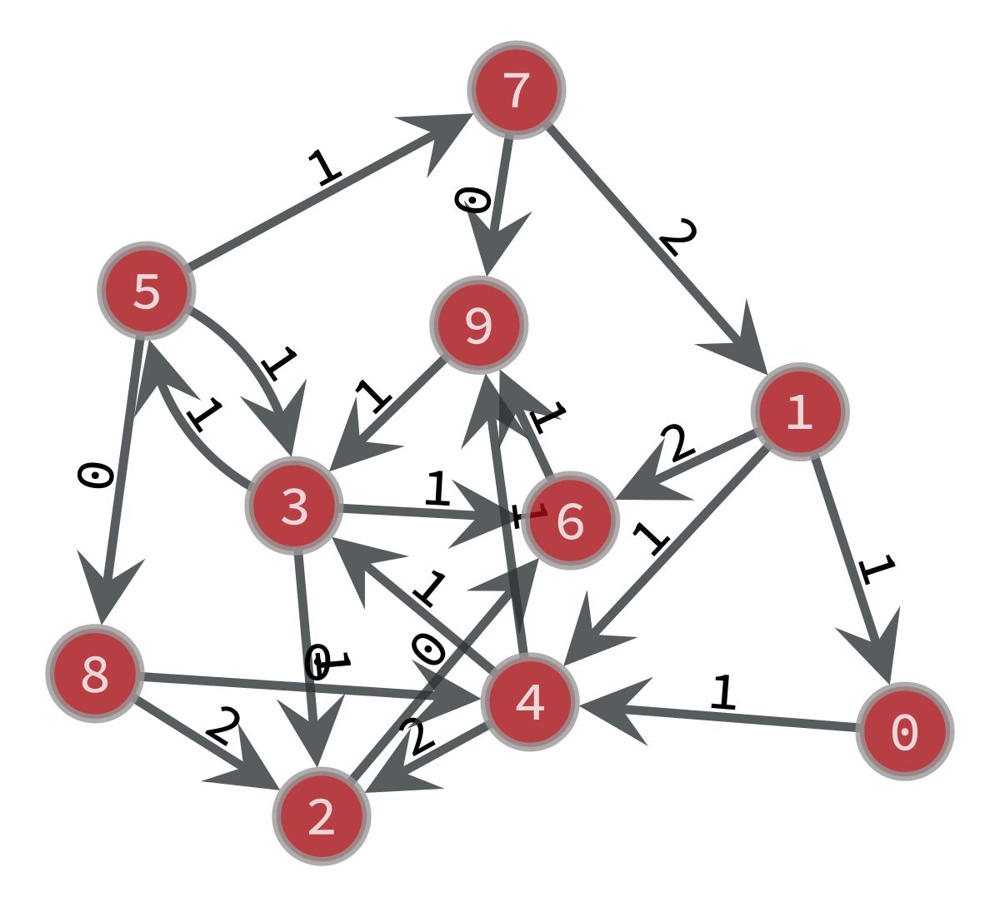

Graph G0 taken from Gr: 


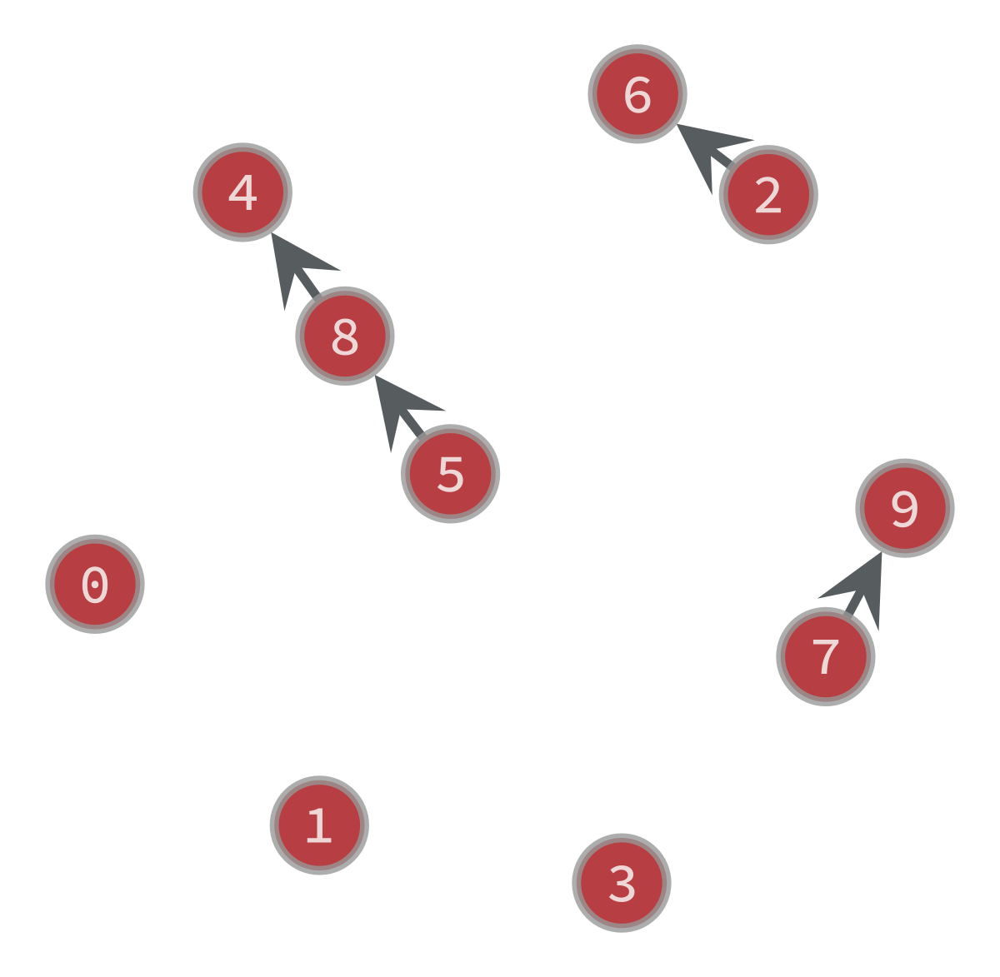

Clock Period of the graph is: 17 with value of c as: 19.0
Test with C: 20.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


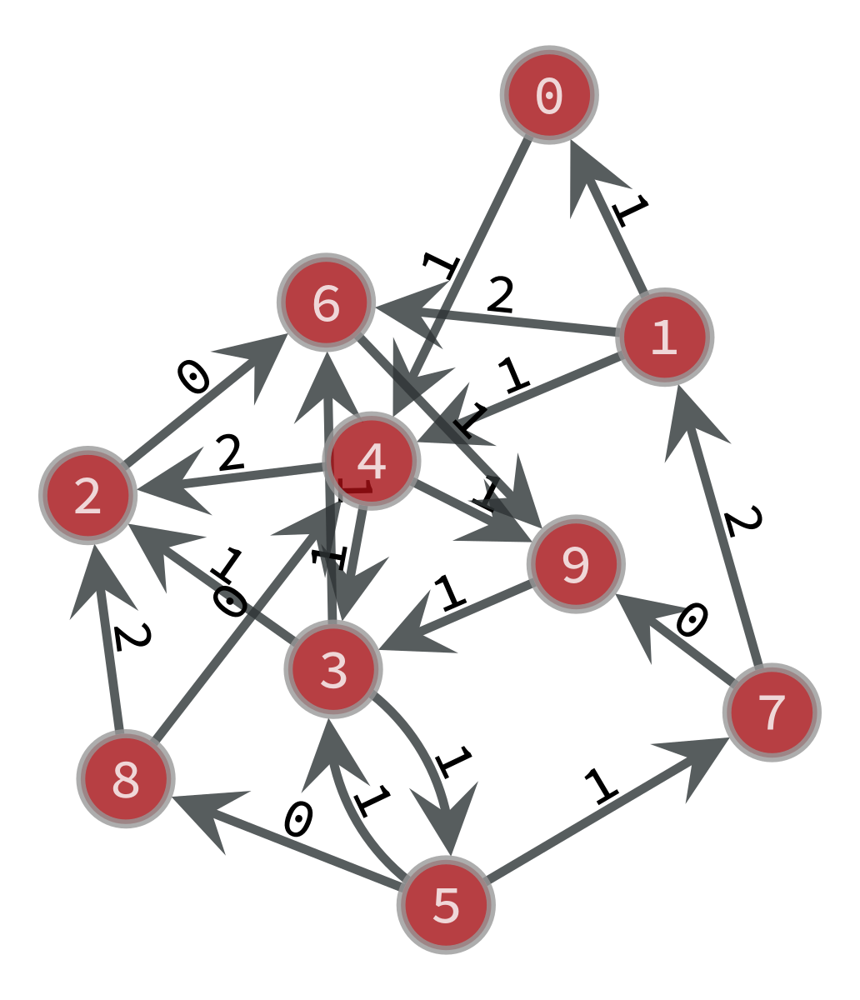

Graph G0 taken from Gr: 


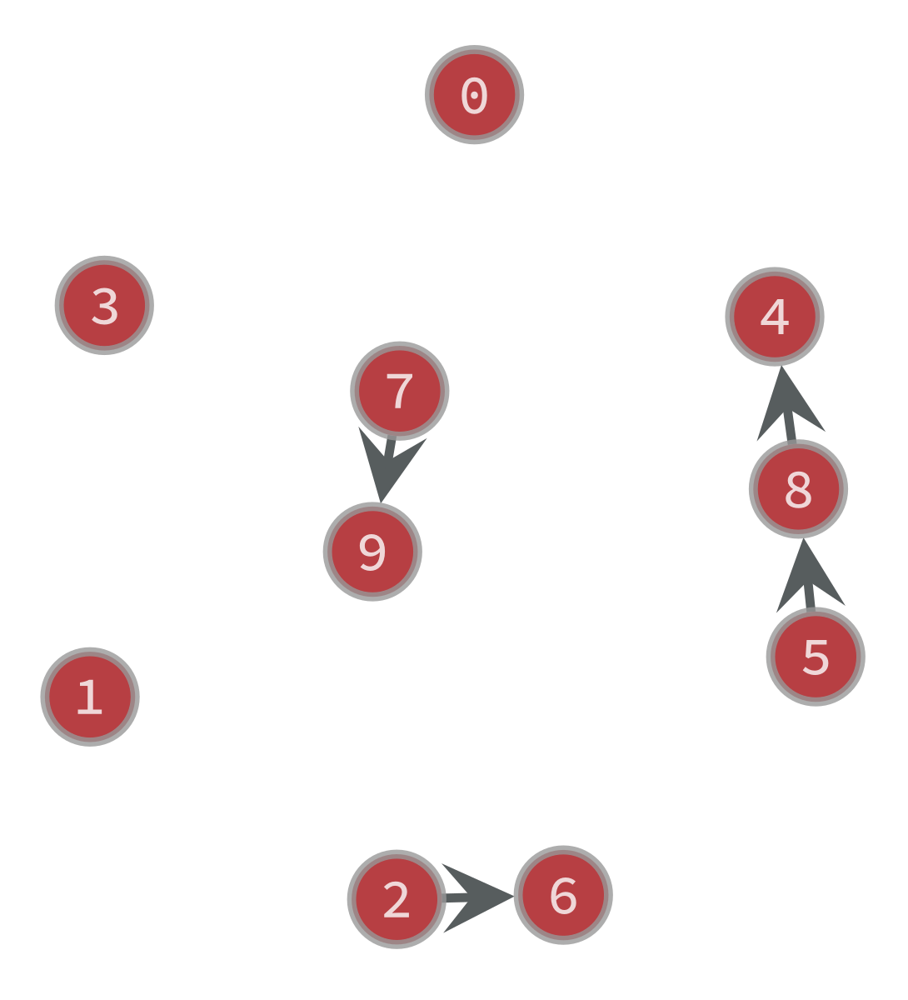

Clock Period of the graph is: 17 with value of c as: 20.0
Test with C: 21.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


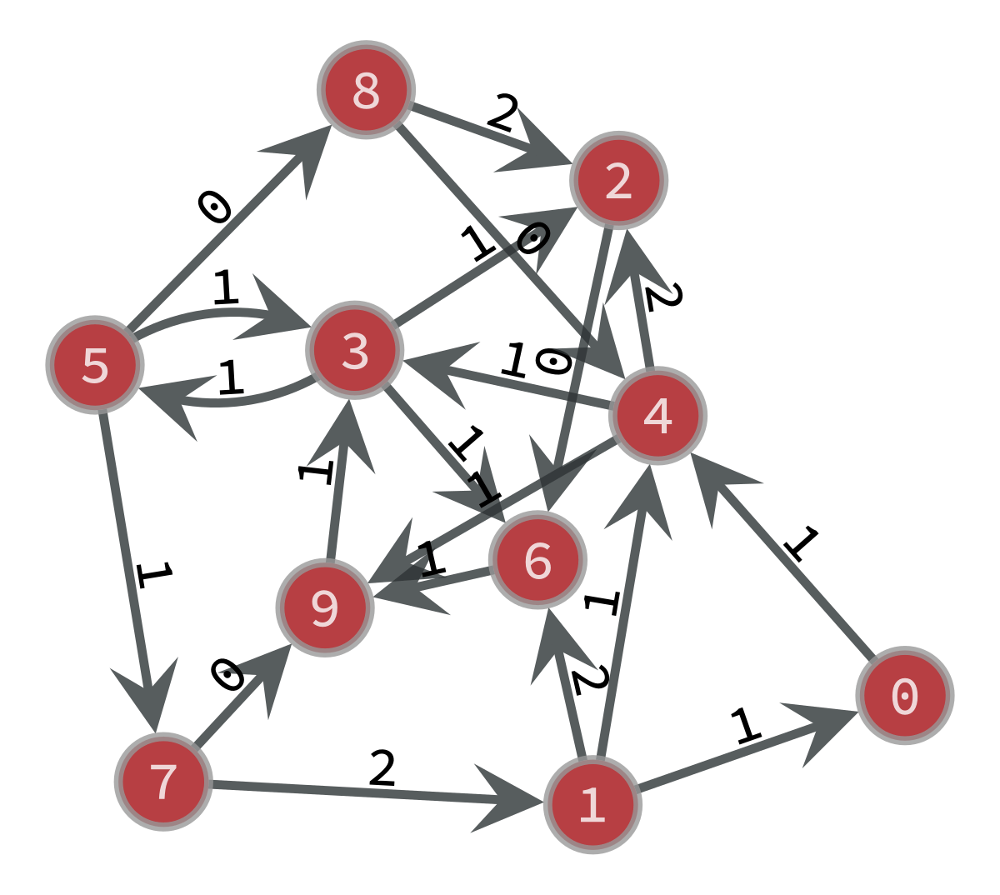

Graph G0 taken from Gr: 


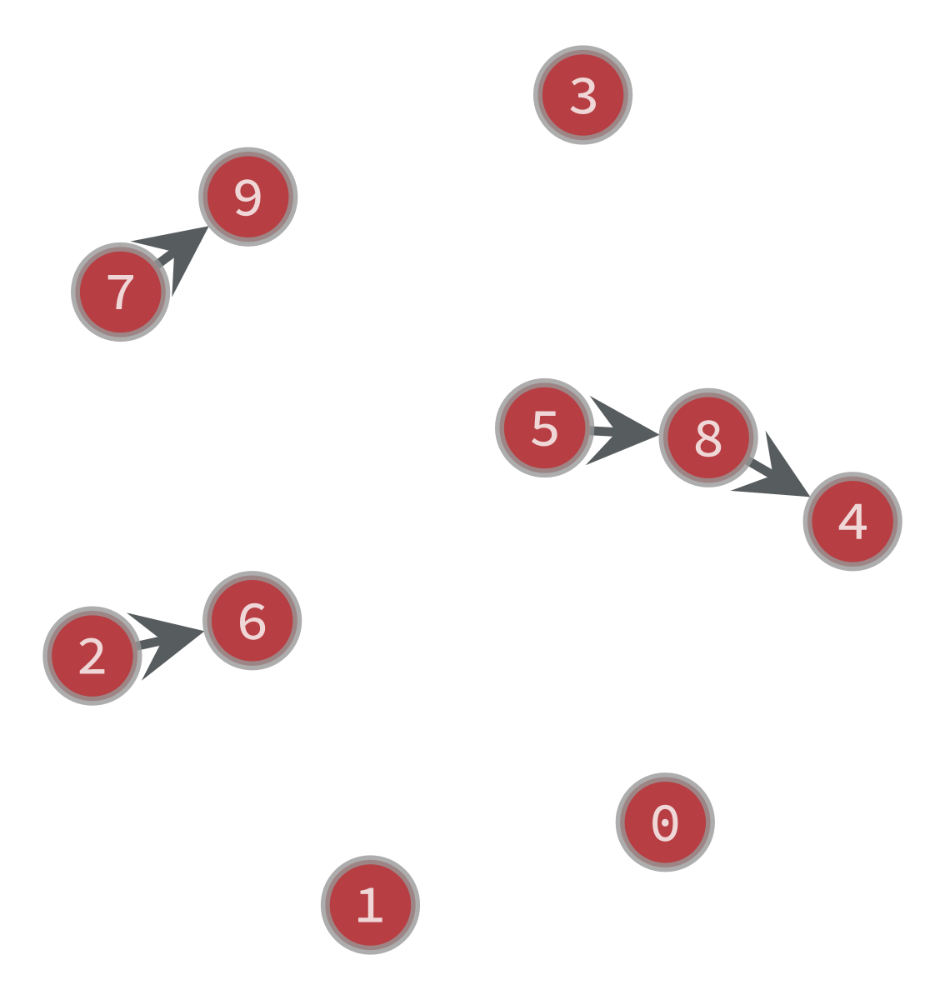

Clock Period of the graph is: 17 with value of c as: 21.0
Test with C: 23.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


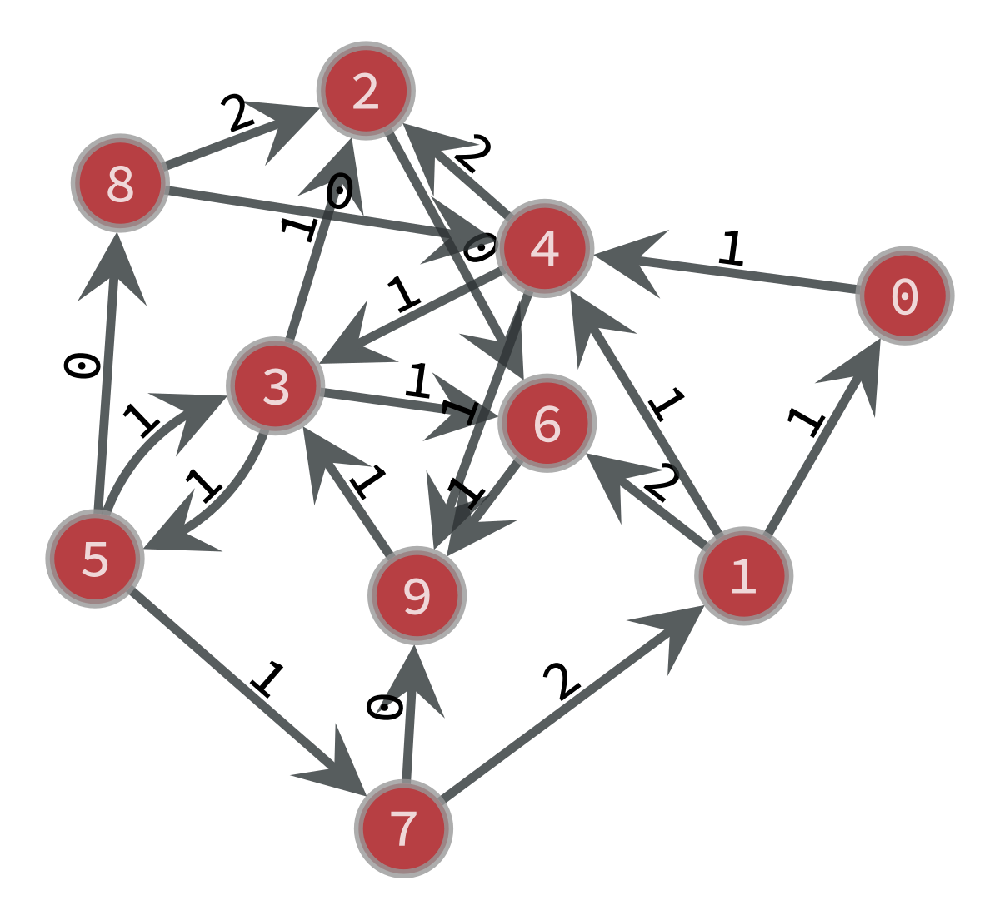

Graph G0 taken from Gr: 


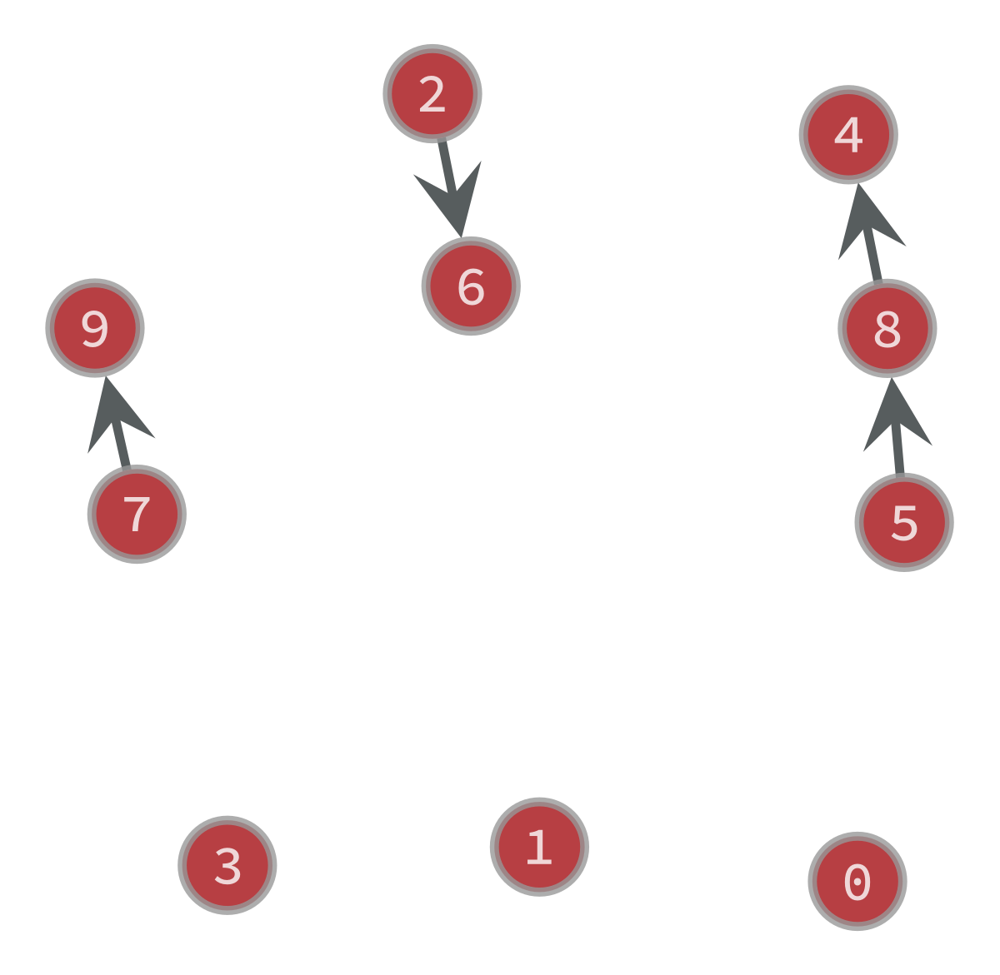

Clock Period of the graph is: 17 with value of c as: 23.0
Test with C: 24.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


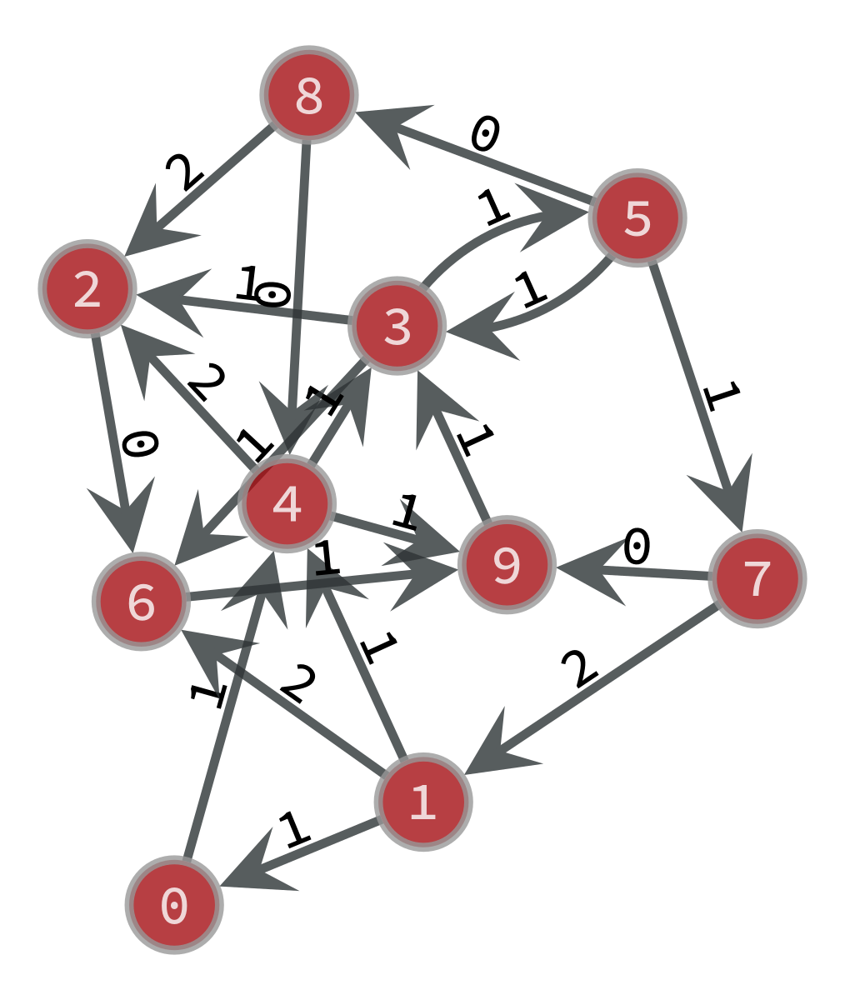

Graph G0 taken from Gr: 


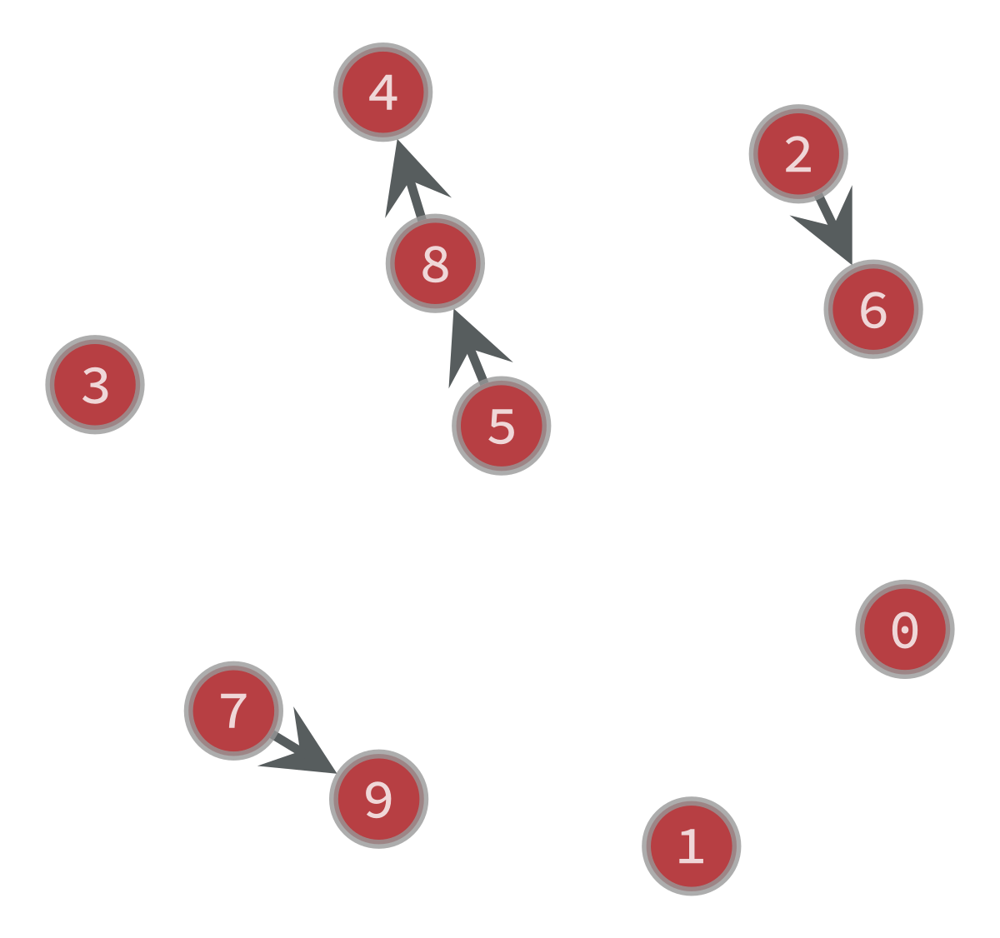

Clock Period of the graph is: 17 with value of c as: 24.0
Test with C: 25.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


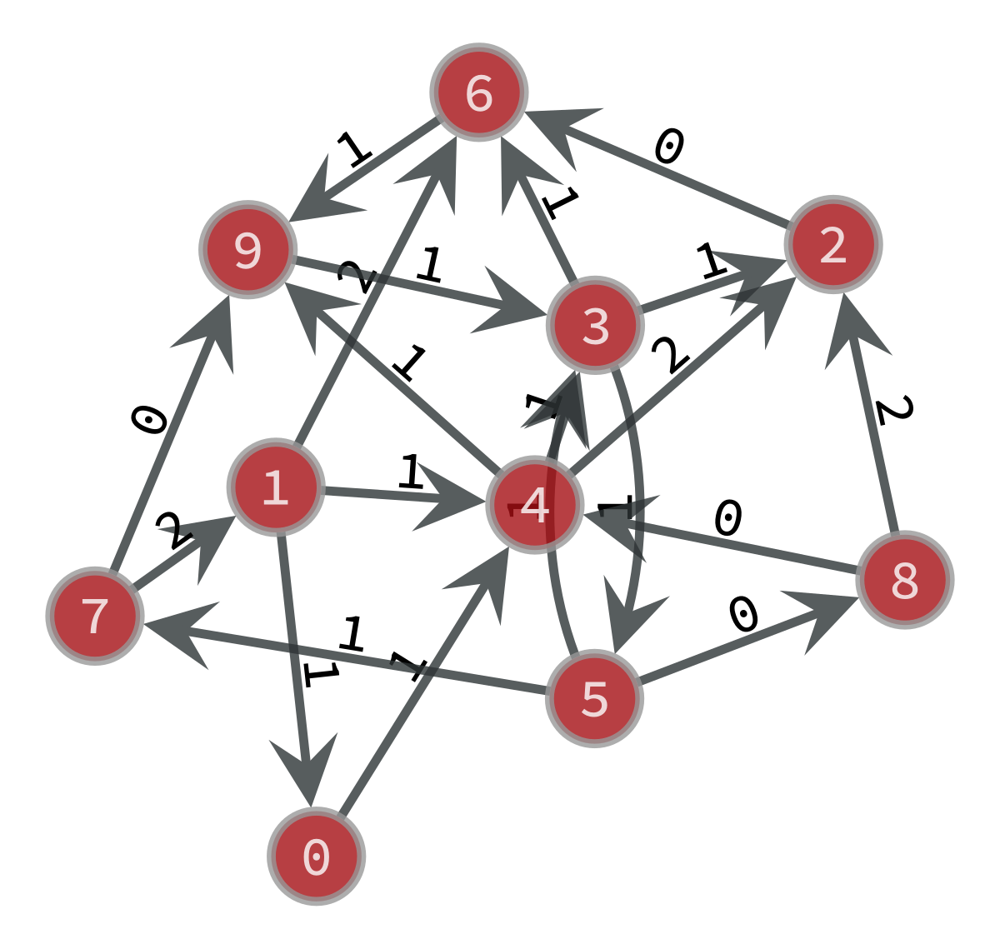

Graph G0 taken from Gr: 


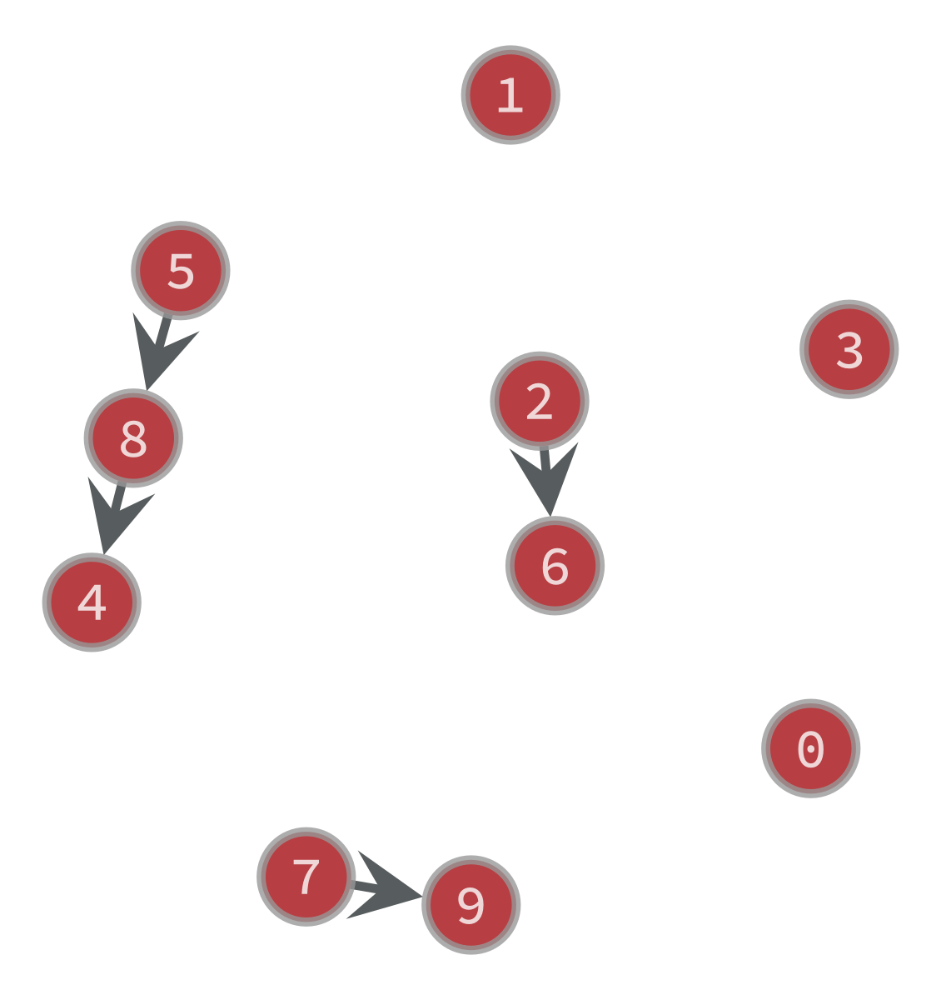

Clock Period of the graph is: 17 with value of c as: 25.0
Test with C: 27.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


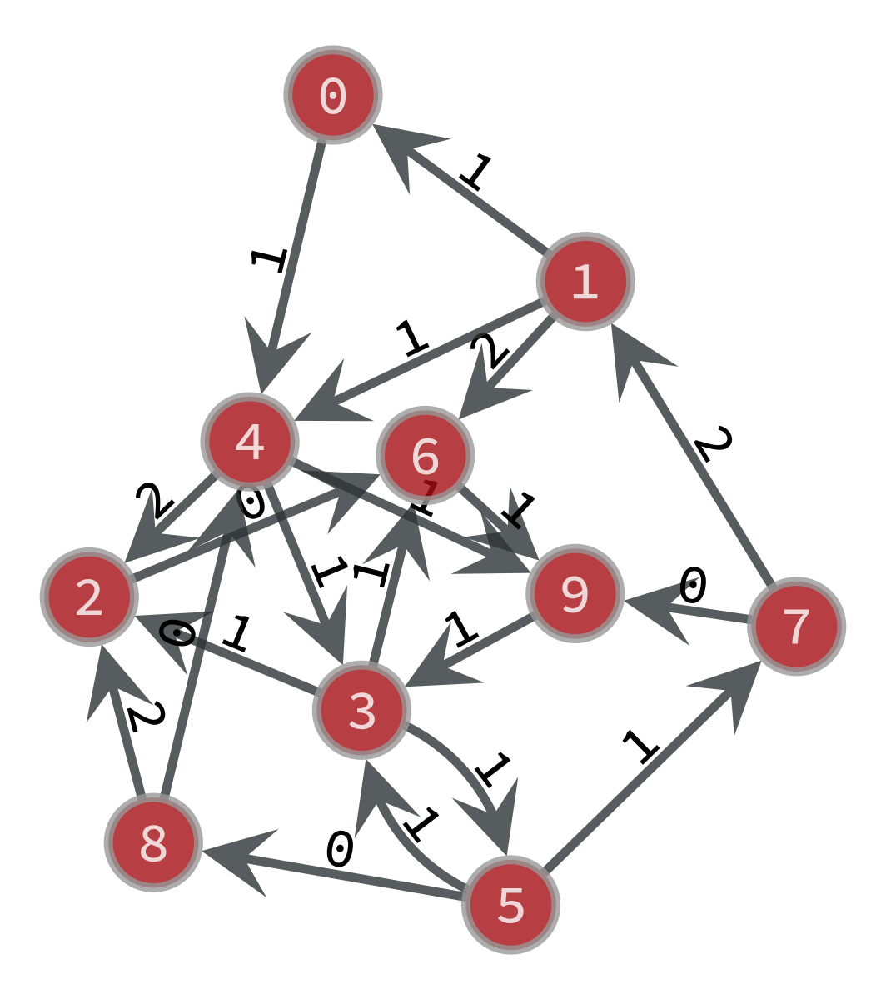

Graph G0 taken from Gr: 


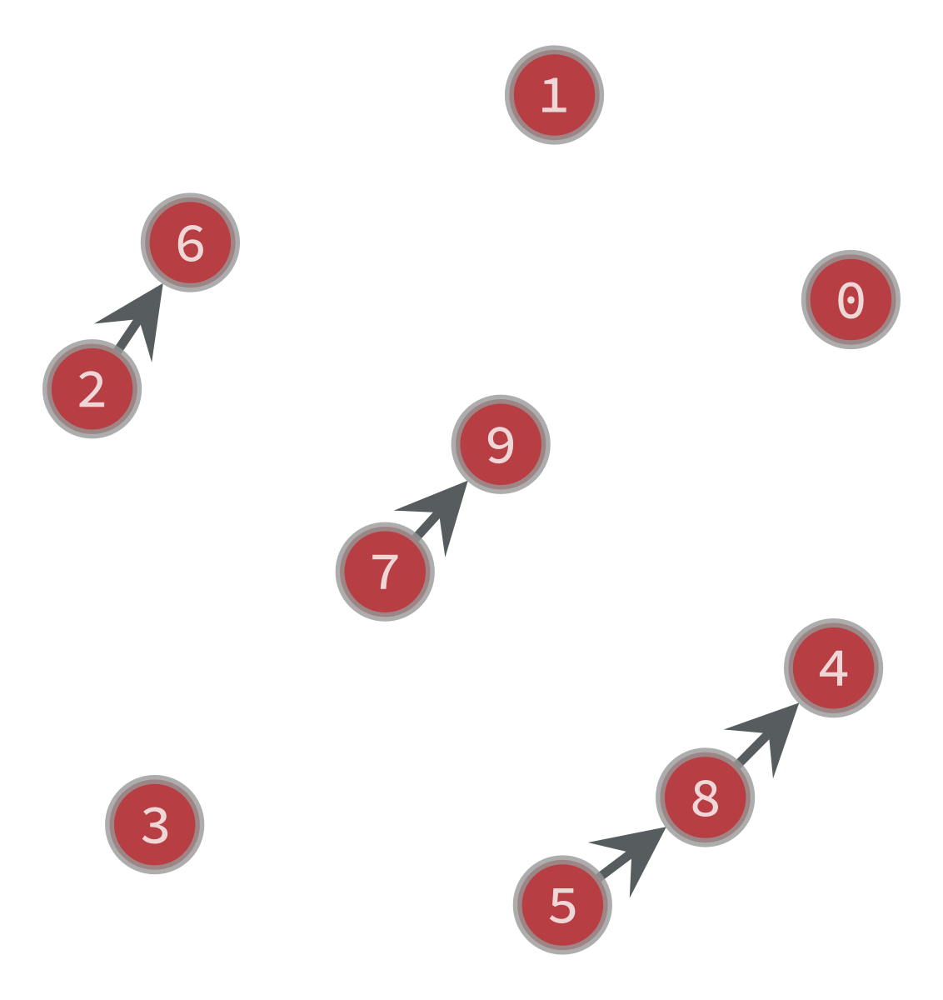

Clock Period of the graph is: 17 with value of c as: 27.0
Test with C: 28.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


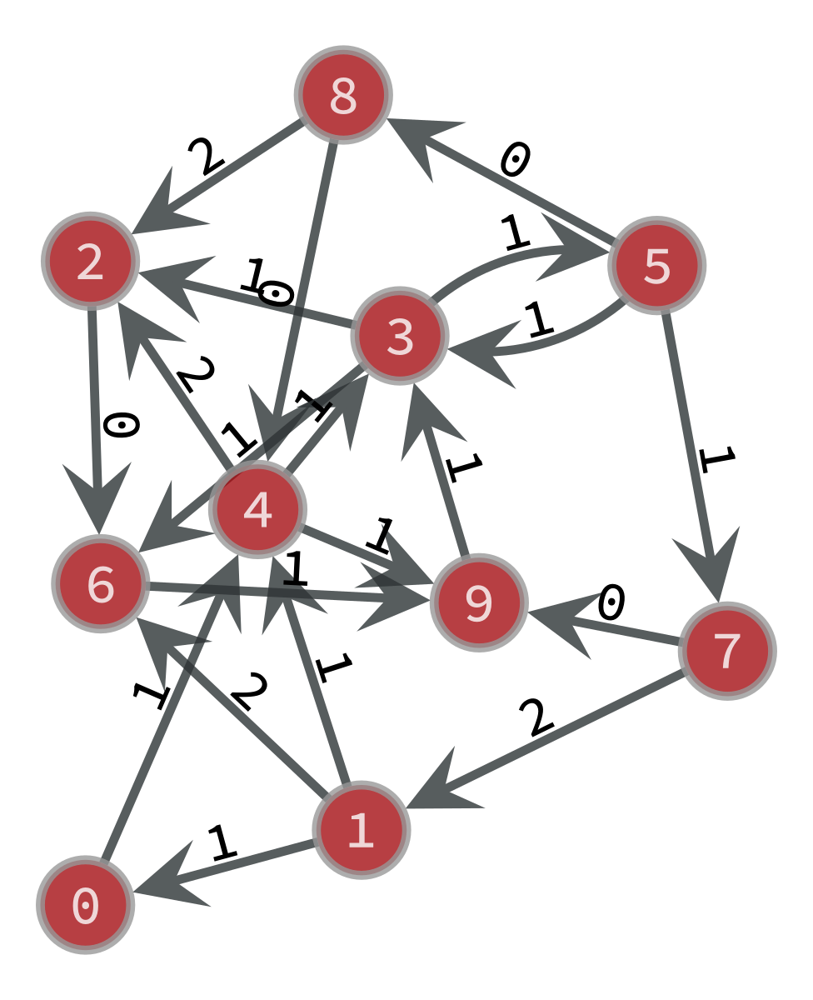

Graph G0 taken from Gr: 


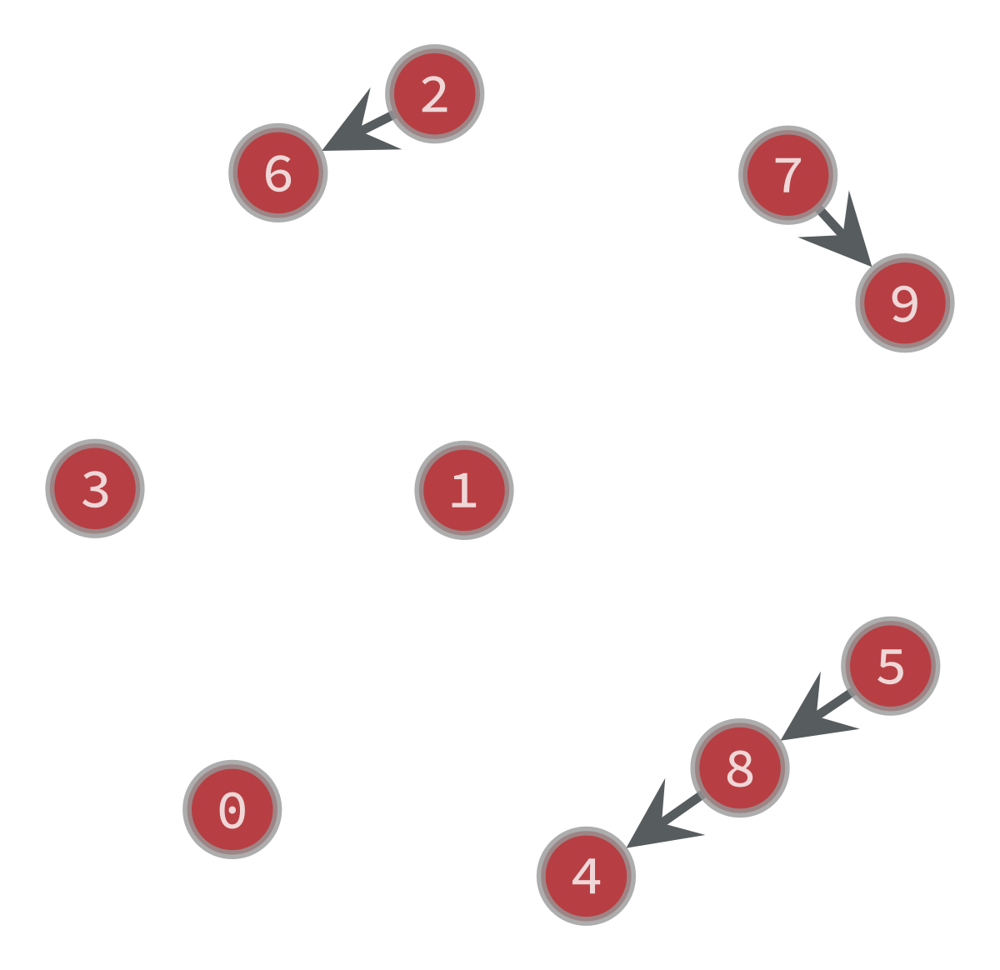

Clock Period of the graph is: 17 with value of c as: 28.0
Test with C: 29.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


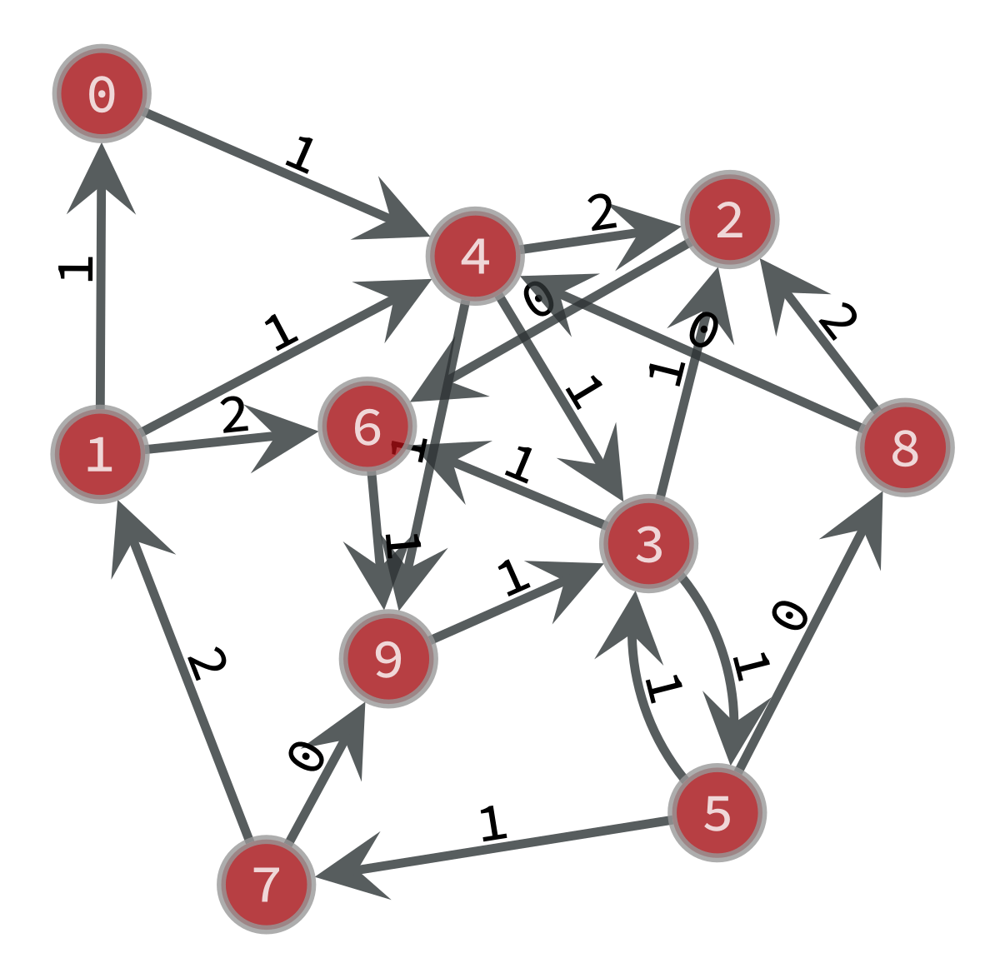

Graph G0 taken from Gr: 


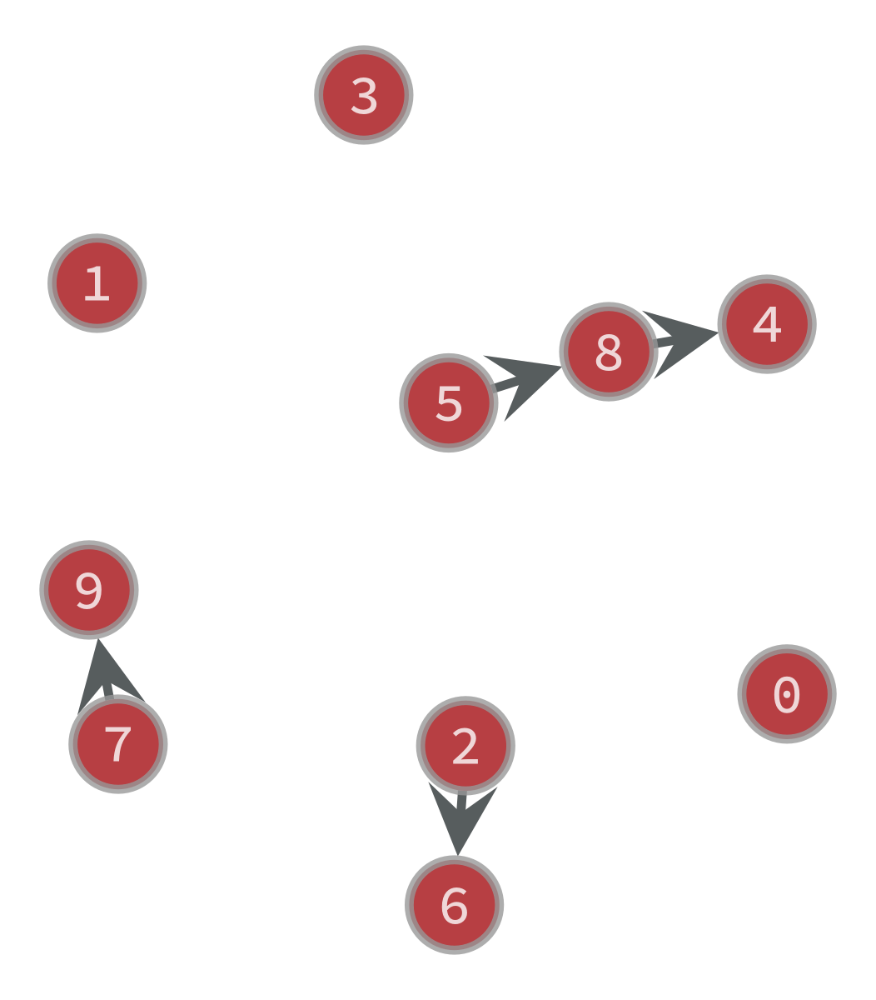

Clock Period of the graph is: 17 with value of c as: 29.0
Test with C: 30.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


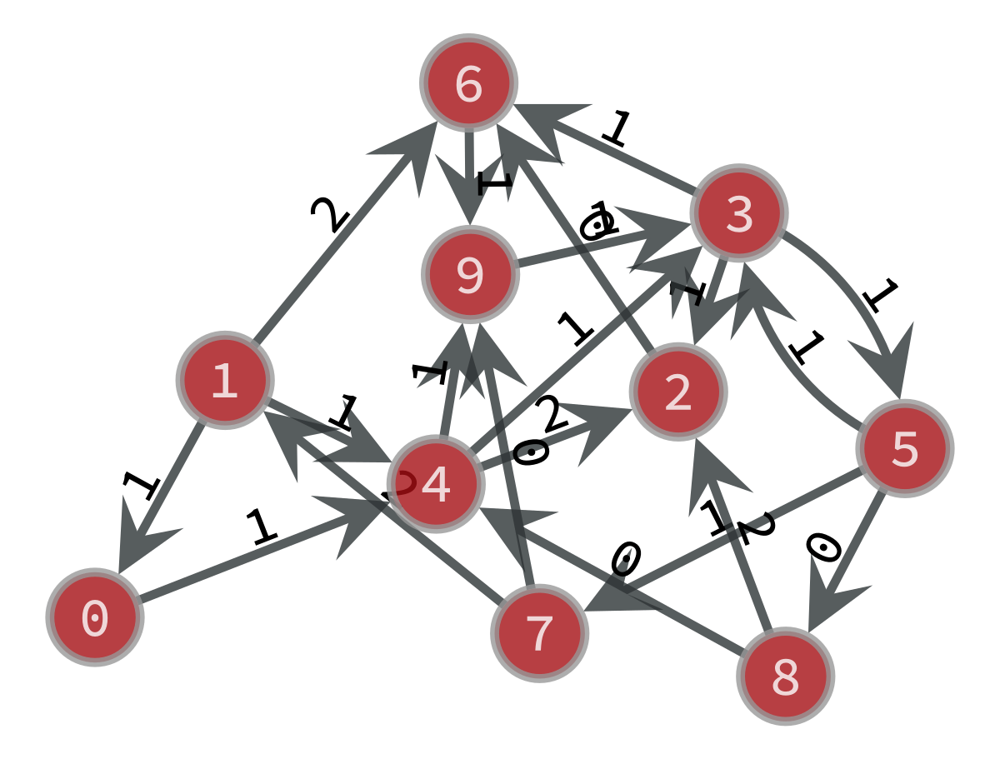

Graph G0 taken from Gr: 


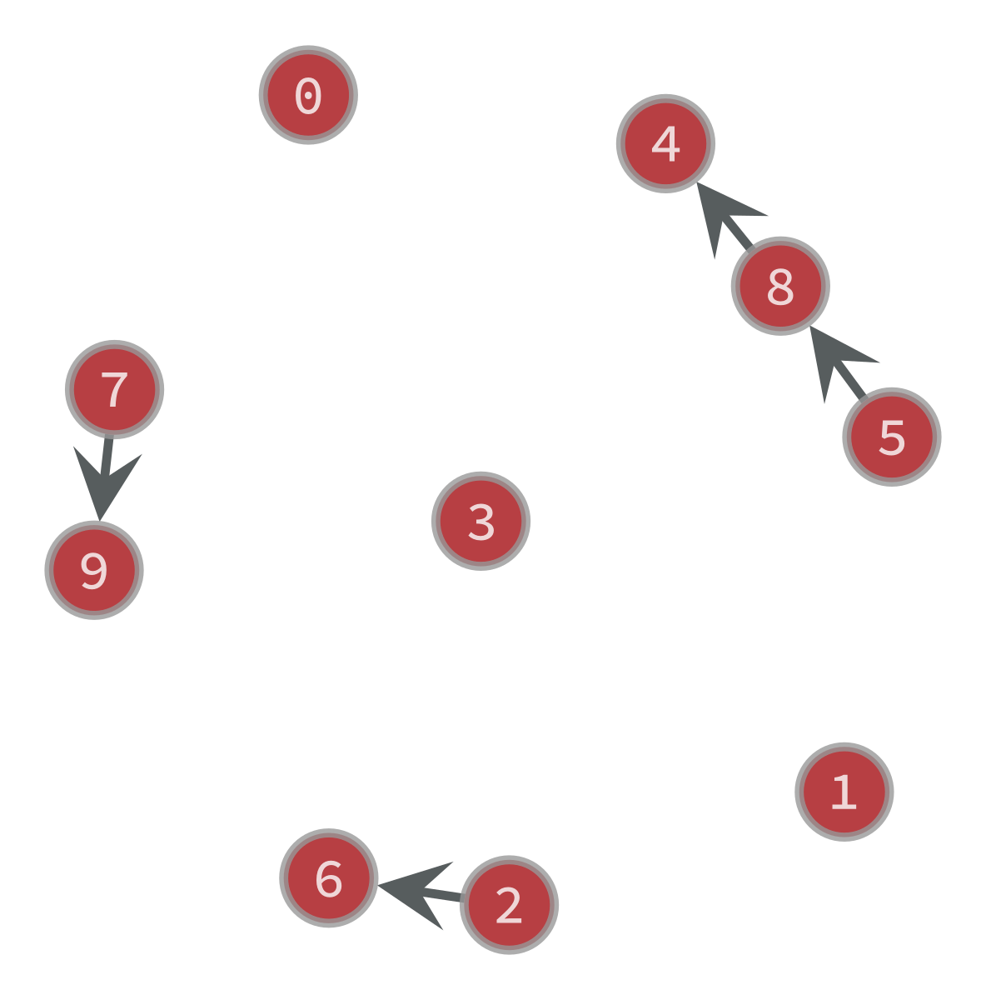

Clock Period of the graph is: 17 with value of c as: 30.0
Test with C: 31.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


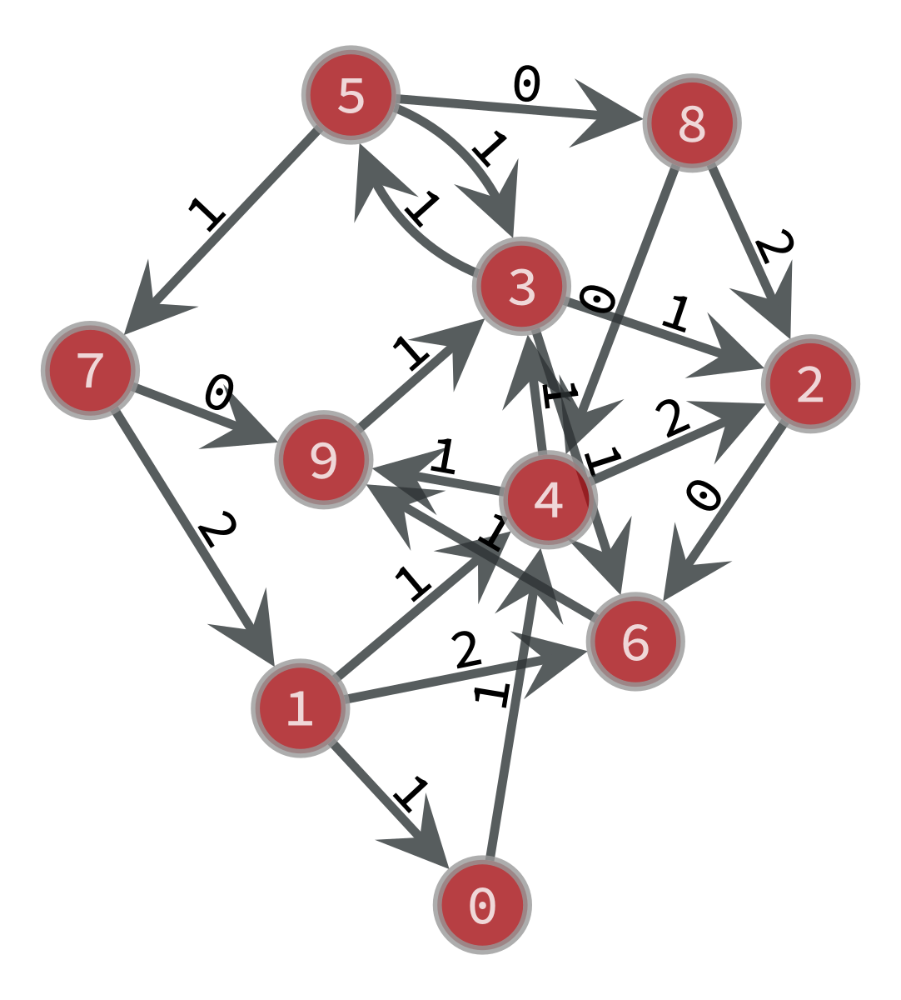

Graph G0 taken from Gr: 


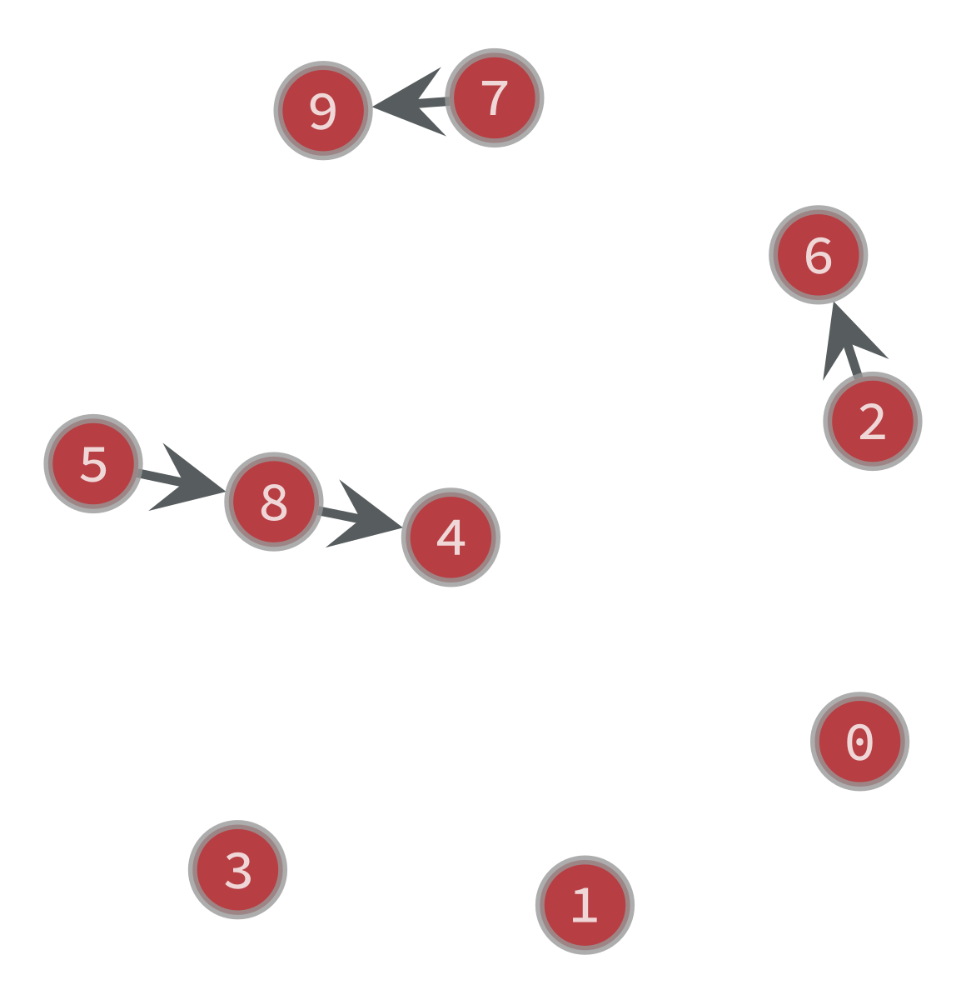

Clock Period of the graph is: 17 with value of c as: 31.0
Test with C: 32.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


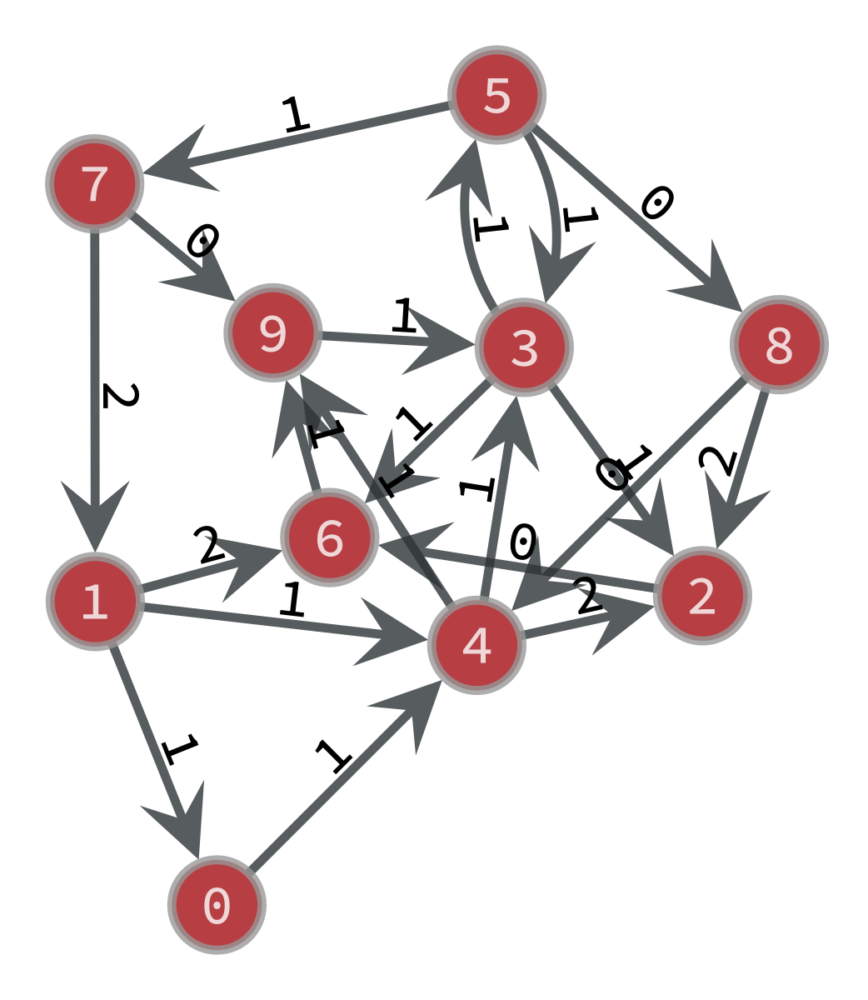

Graph G0 taken from Gr: 


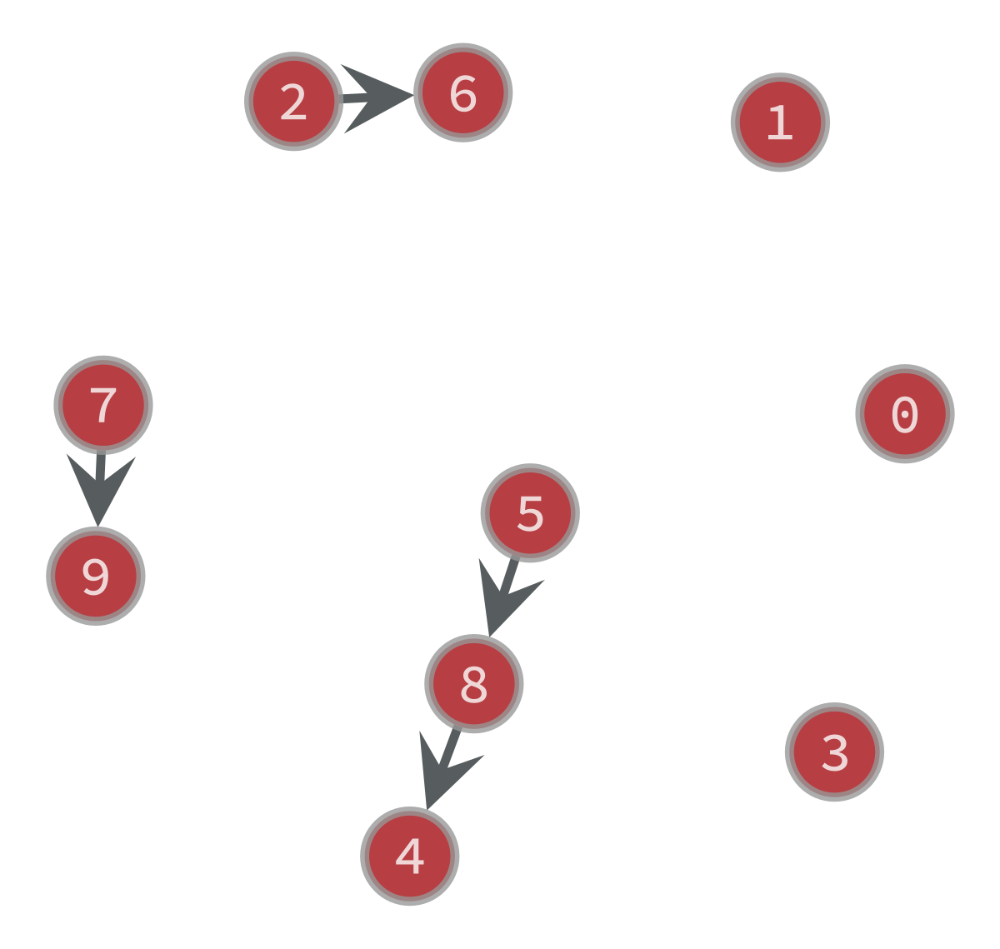

Clock Period of the graph is: 17 with value of c as: 32.0
Test with C: 33.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


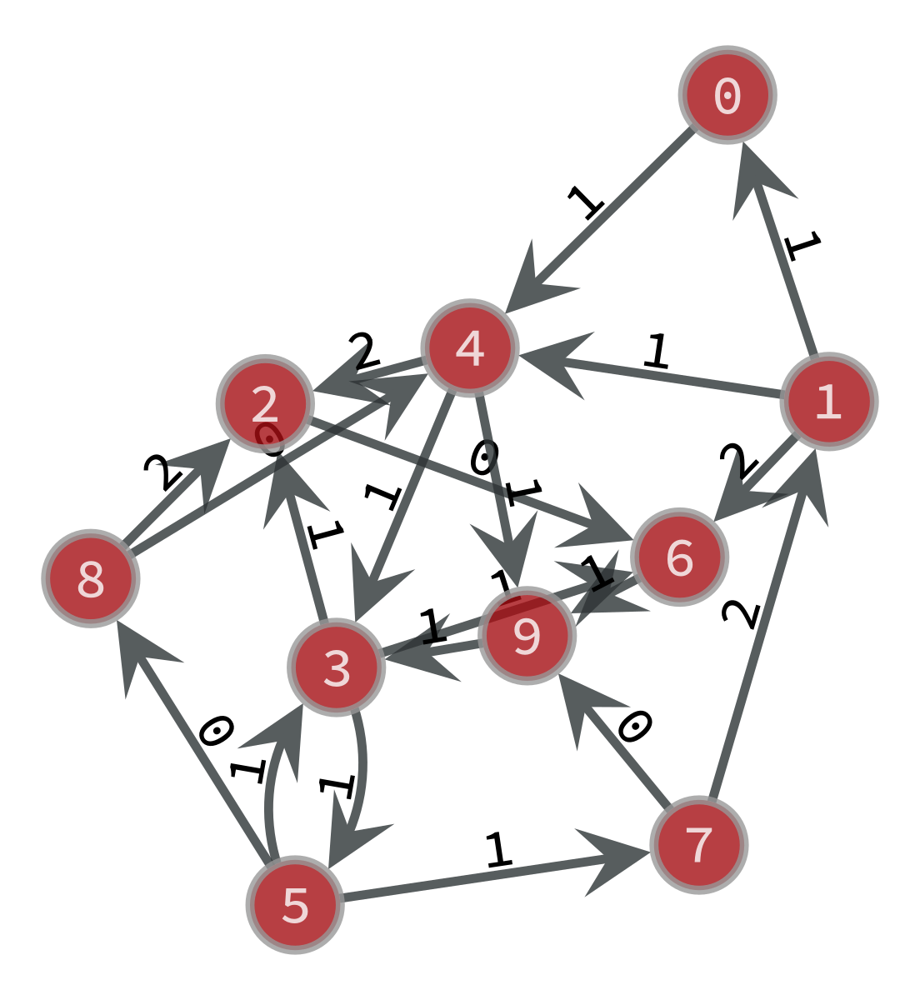

Graph G0 taken from Gr: 


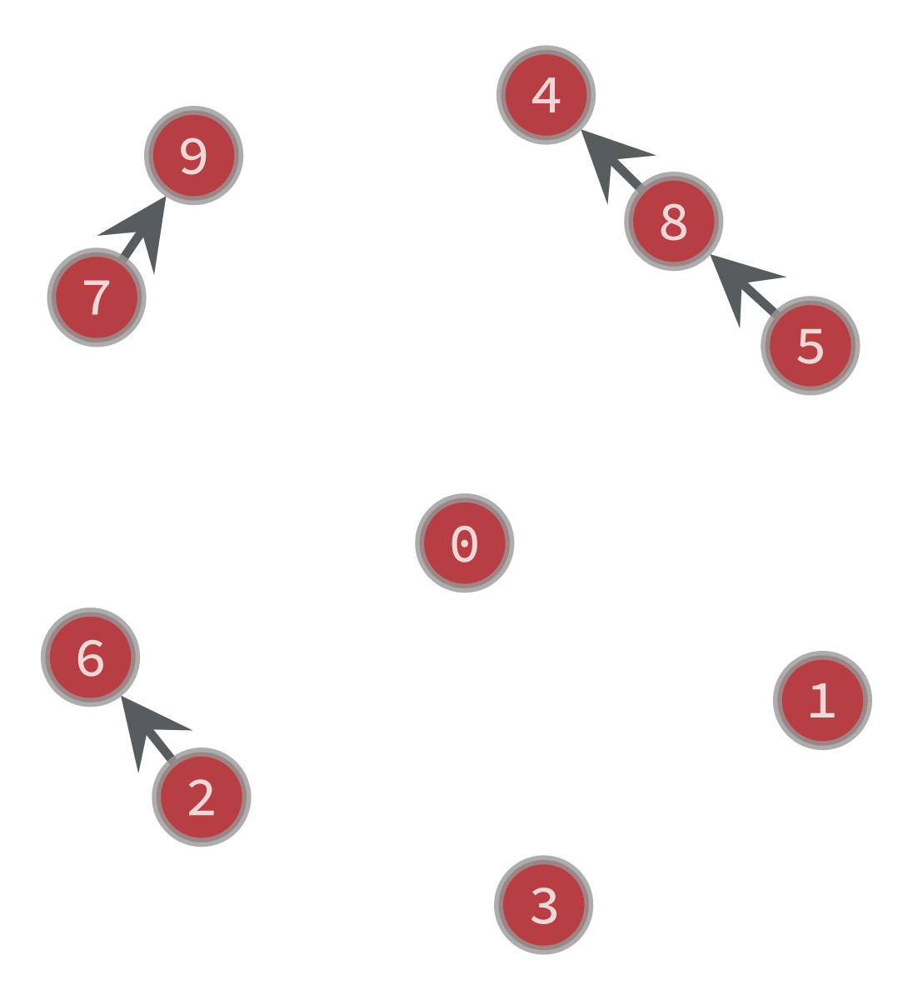

Clock Period of the graph is: 17 with value of c as: 33.0
Test with C: 35.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


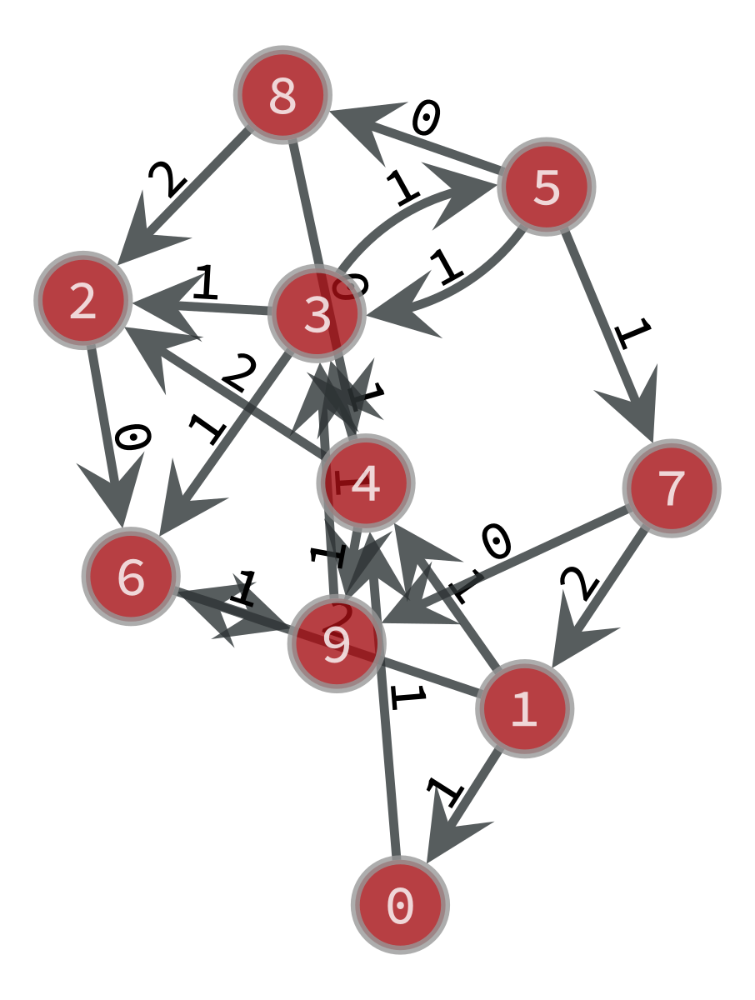

Graph G0 taken from Gr: 


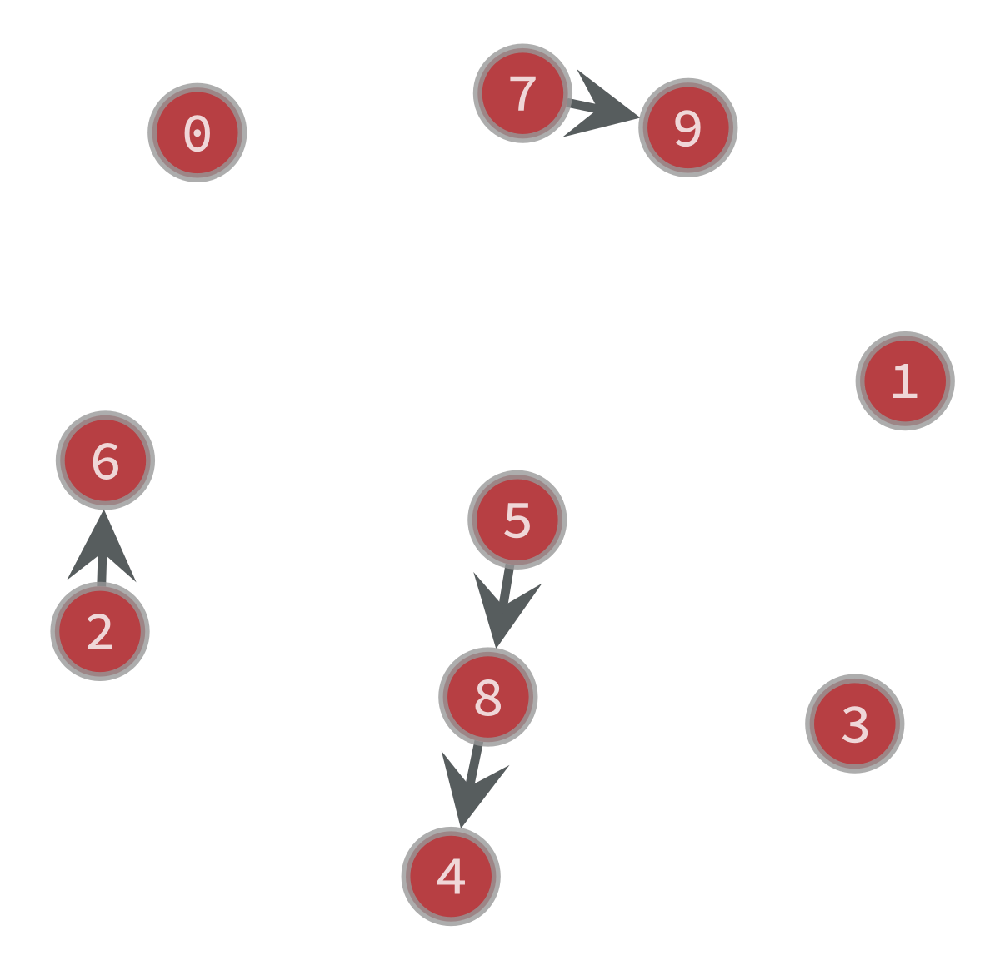

Clock Period of the graph is: 17 with value of c as: 35.0
Test with C: 37.0
Variable: 0 , value: 0.0 
Variable: 1 , value: 0.0 
Variable: 2 , value: 0.0 
Variable: 3 , value: 0.0 
Variable: 4 , value: 0.0 
Variable: 5 , value: 0.0 
Variable: 6 , value: 0.0 
Variable: 7 , value: 0.0 
Variable: 8 , value: 0.0 
Variable: 9 , value: 0.0 
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
New Graph Gr: 


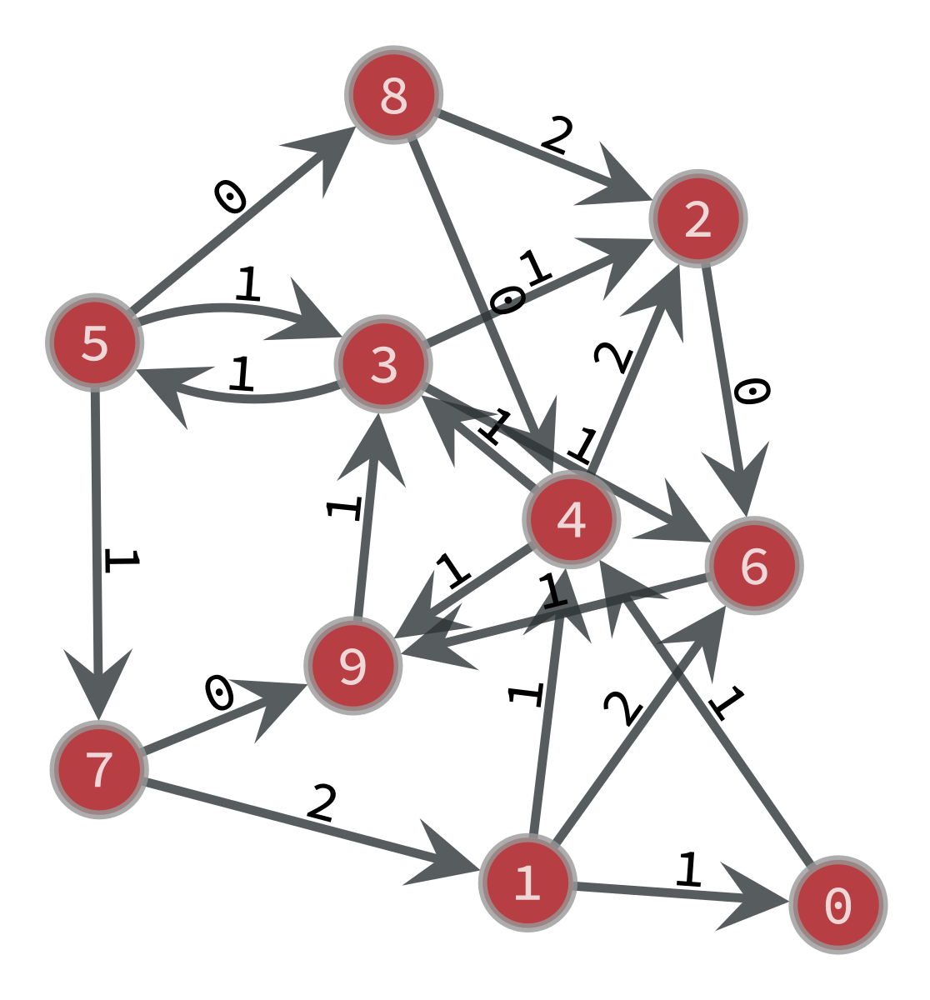

Graph G0 taken from Gr: 


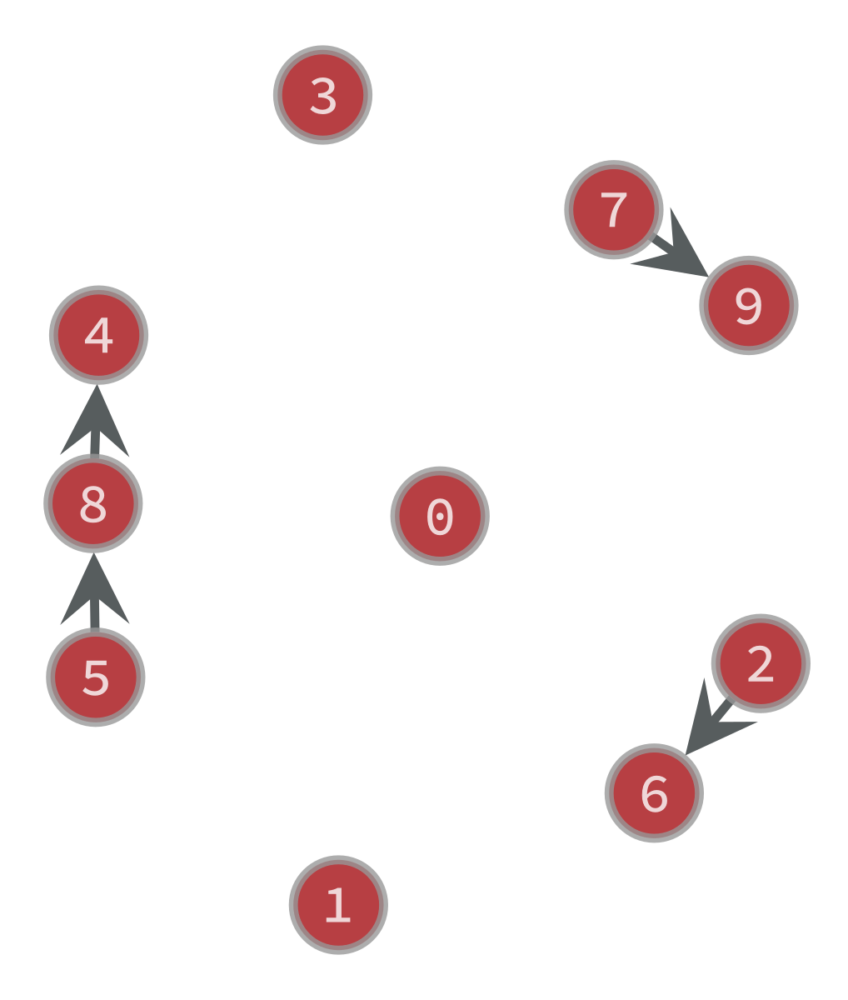

Clock Period of the graph is: 17 with value of c as: 37.0
Minimum Clock Period is: 12 with c: 12.0
[0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 0.0, 0.0, -1.0, -1.0]


In [153]:
print(OPT1(gtest))

W Matrix: 
[[0. 6. 3. 2. 1. 3. 3. 4. 3. 2.]
 [1. 0. 3. 2. 1. 3. 2. 4. 3. 3.]
 [7. 6. 0. 2. 3. 3. 0. 4. 3. 1.]
 [5. 4. 1. 0. 1. 1. 1. 2. 1. 2.]
 [6. 5. 2. 1. 0. 2. 2. 3. 2. 1.]
 [4. 3. 2. 1. 0. 0. 2. 1. 0. 1.]
 [7. 6. 3. 2. 3. 3. 0. 4. 3. 1.]
 [3. 2. 2. 1. 3. 2. 4. 0. 2. 0.]
 [6. 5. 2. 1. 0. 2. 2. 3. 0. 1.]
 [6. 5. 2. 1. 2. 2. 2. 3. 2. 0.]]
D Matrix: 
[[ 0. 20.  6.  7.  4. 12. 12. 19. 20. 13.]
 [ 1.  1.  7.  8.  5. 13.  7. 20. 21. 16.]
 [33. 33.  2. 20. 37. 25.  8. 32. 33. 17.]
 [16. 16.  5.  3. 20.  8.  9. 15. 16. 18.]
 [20. 20.  6.  7.  4. 12. 12. 19. 20. 13.]
 [13. 13. 10.  8. 17.  5. 14. 12. 13. 21.]
 [31. 31. 20. 18. 35. 23.  6. 30. 31. 15.]
 [ 8.  8. 21. 19. 12. 24. 14.  7. 32. 16.]
 [28. 28. 10. 15. 12. 20. 16. 27.  8. 21.]
 [25. 25. 14. 12. 29. 17. 18. 24. 25.  9.]]
Test with C: 0.0
Final graph created with FEAS: 


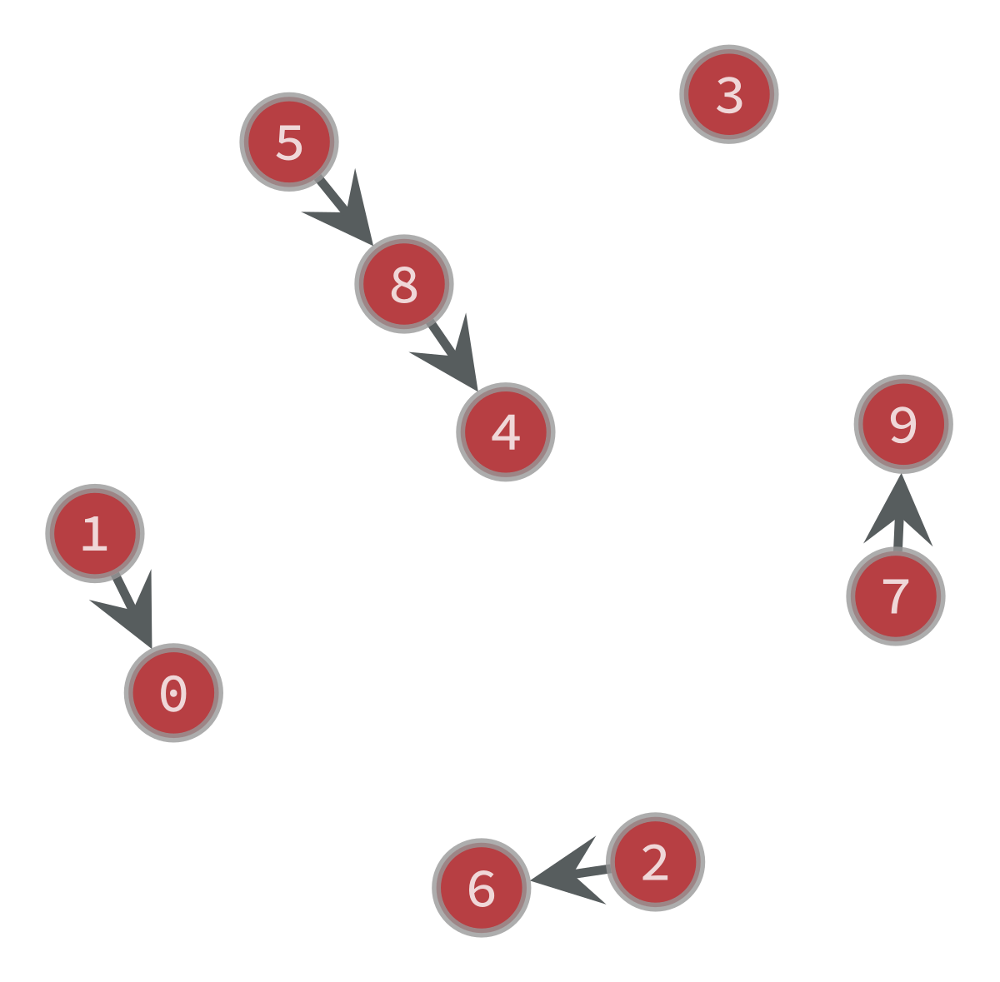

FEAS Algorithm finished with c: 0.0
Clock Period of the graph is: 17
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 17
No feasible retiming exists.
Test with C: 1.0
Final graph created with FEAS: 


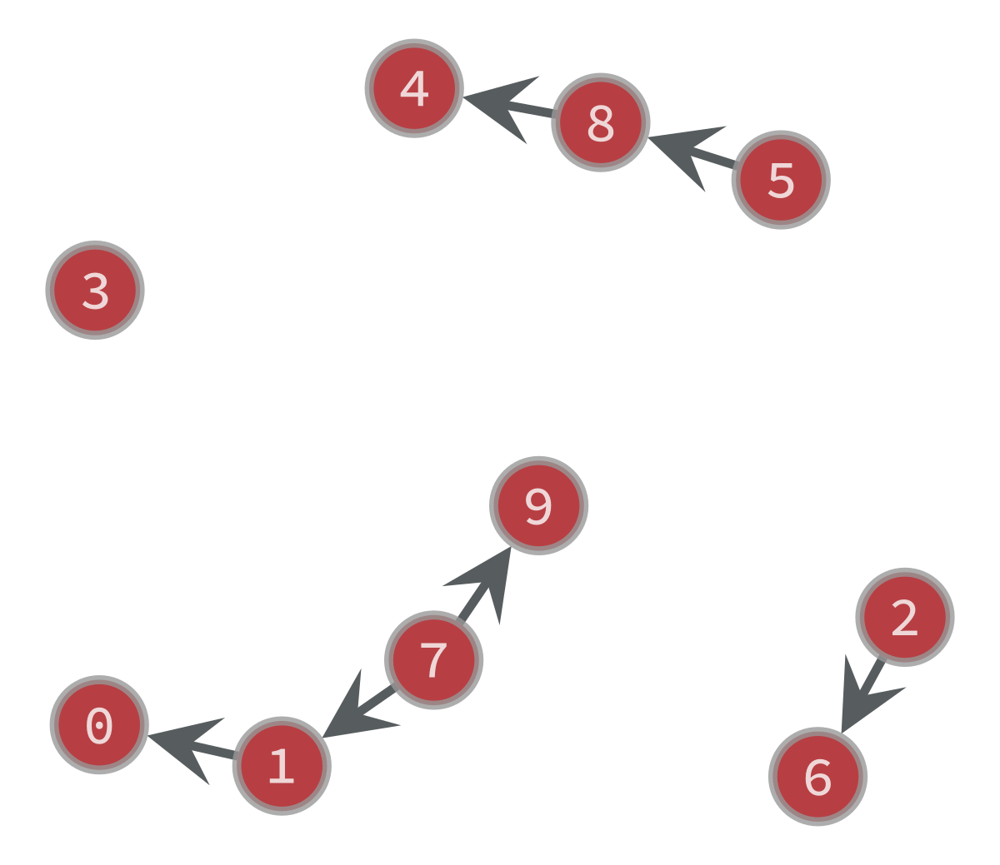

FEAS Algorithm finished with c: 1.0
Clock Period of the graph is: 17
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 17
No feasible retiming exists.
Test with C: 2.0
Final graph created with FEAS: 


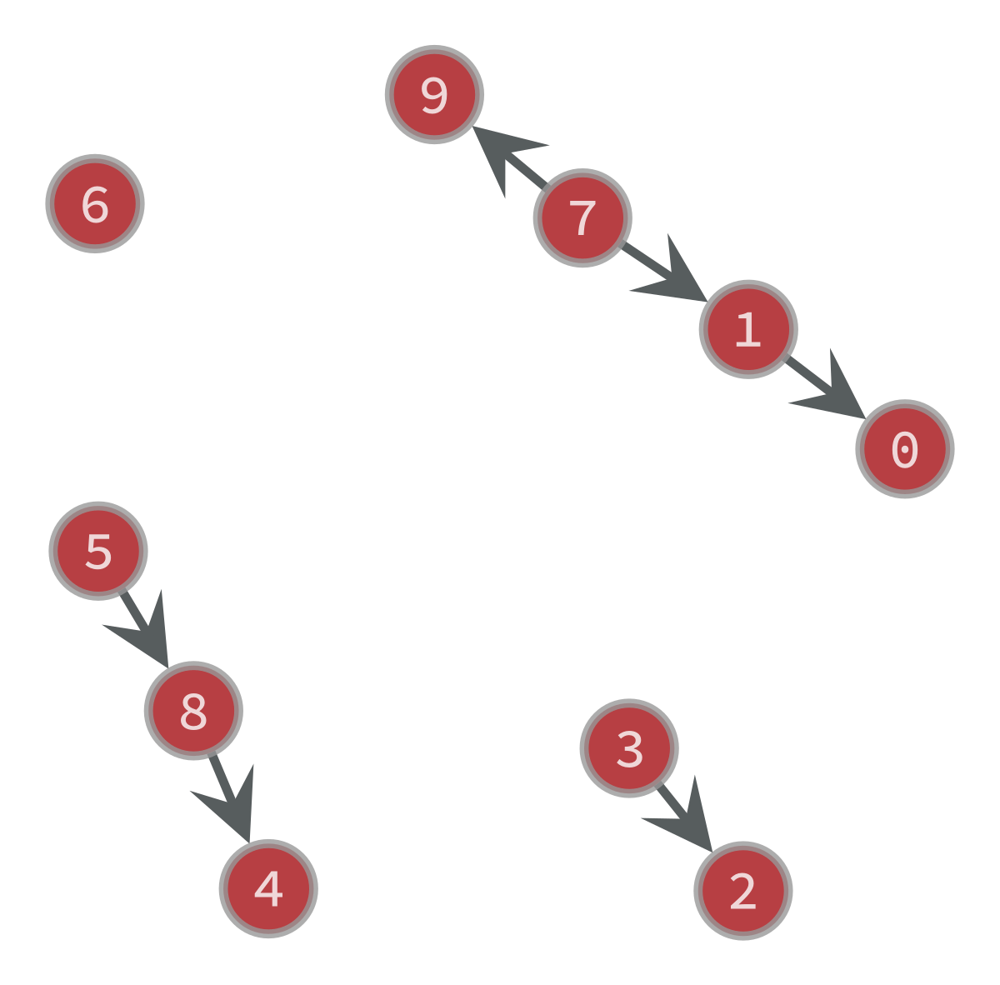

FEAS Algorithm finished with c: 2.0
Clock Period of the graph is: 17
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 17
No feasible retiming exists.
Test with C: 3.0
Final graph created with FEAS: 


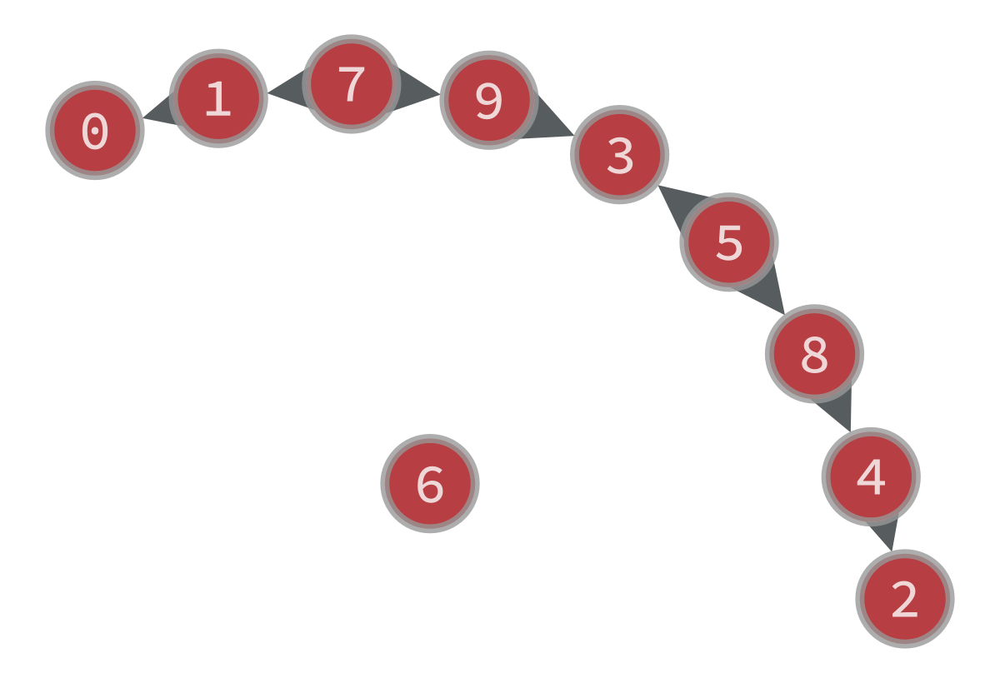

FEAS Algorithm finished with c: 3.0
Clock Period of the graph is: 19
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 19
No feasible retiming exists.
Test with C: 4.0
Final graph created with FEAS: 


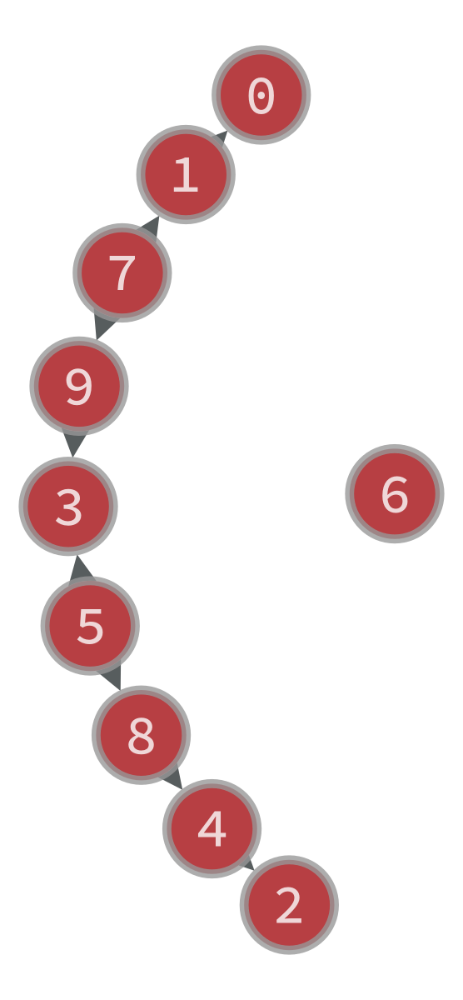

FEAS Algorithm finished with c: 4.0
Clock Period of the graph is: 19
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 19
No feasible retiming exists.
Test with C: 5.0
Final graph created with FEAS: 


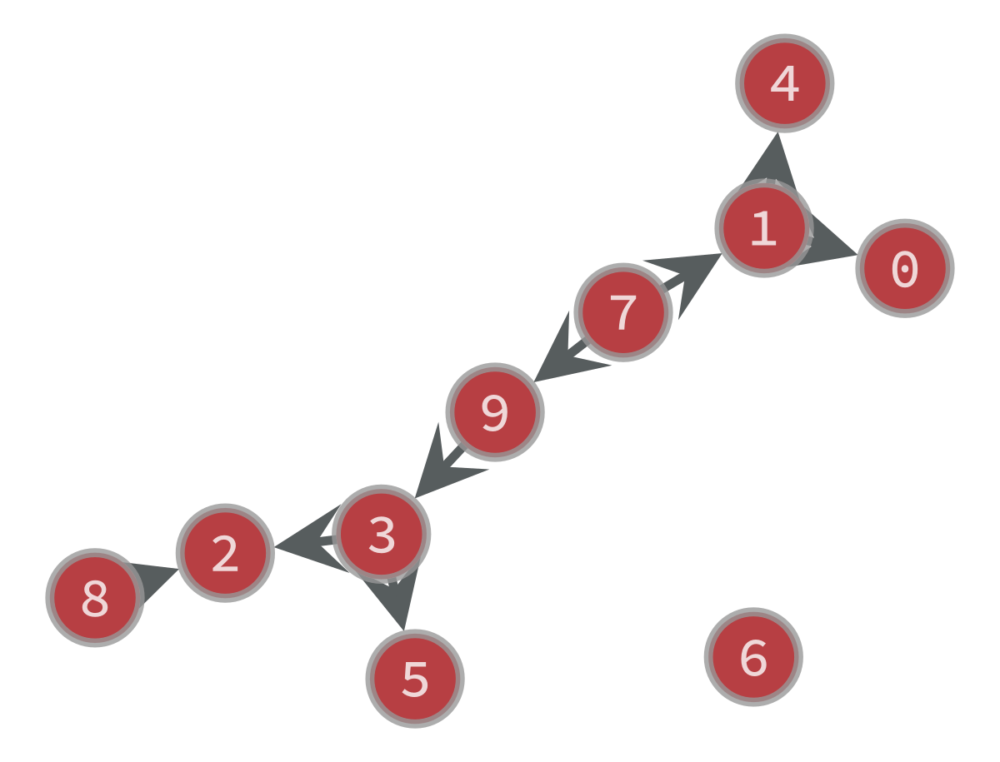

FEAS Algorithm finished with c: 5.0
Clock Period of the graph is: 24
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 24
No feasible retiming exists.
Test with C: 6.0
Final graph created with FEAS: 


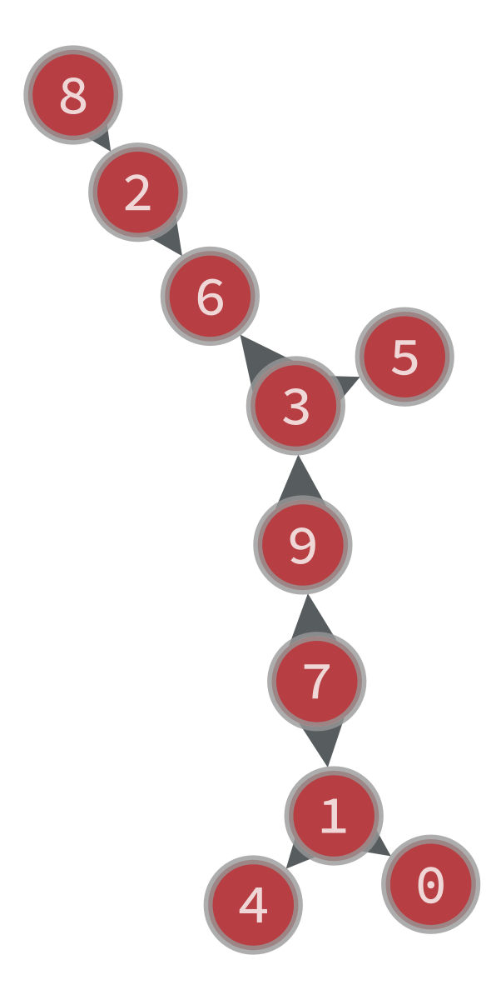

FEAS Algorithm finished with c: 6.0
Clock Period of the graph is: 25
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 25
No feasible retiming exists.
Test with C: 7.0
Final graph created with FEAS: 


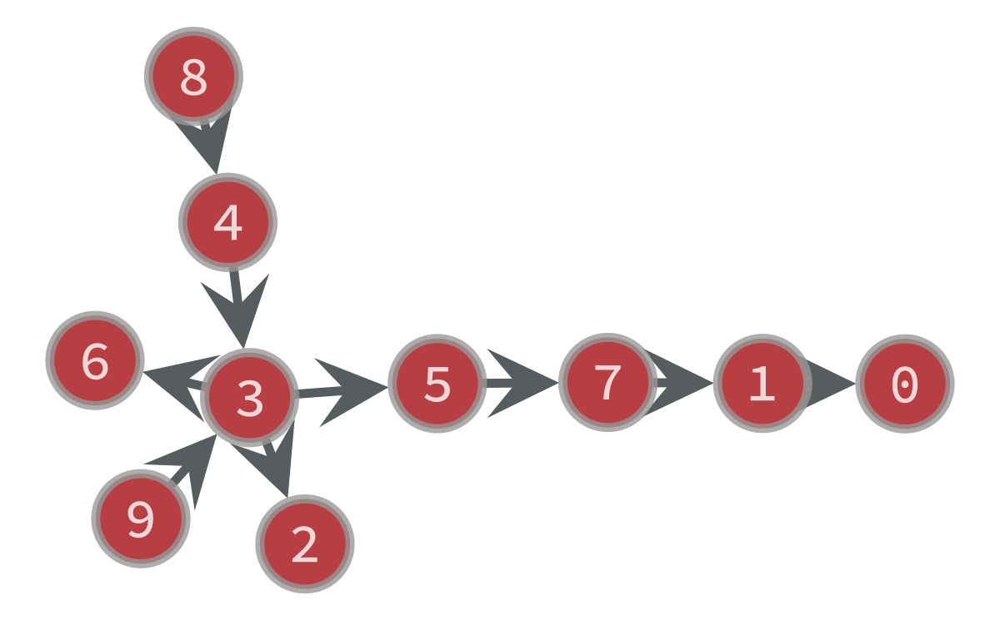

FEAS Algorithm finished with c: 7.0
Clock Period of the graph is: 28
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 28
No feasible retiming exists.
Test with C: 8.0
Final graph created with FEAS: 


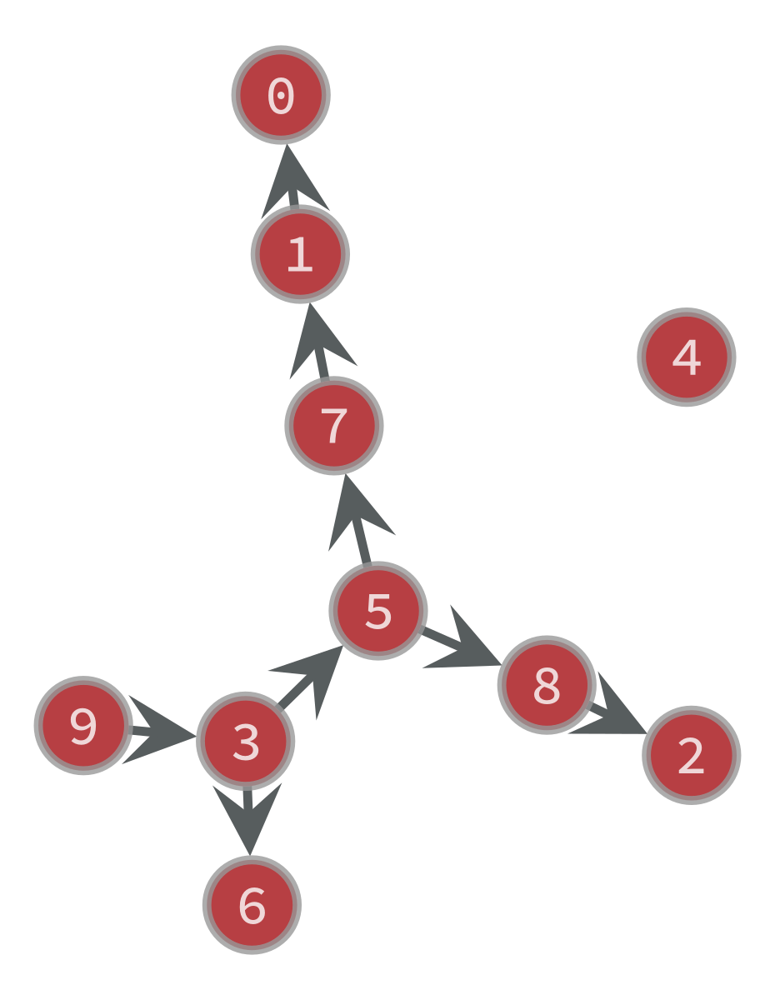

FEAS Algorithm finished with c: 8.0
Clock Period of the graph is: 27
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 27
No feasible retiming exists.
Test with C: 9.0
Final graph created with FEAS: 


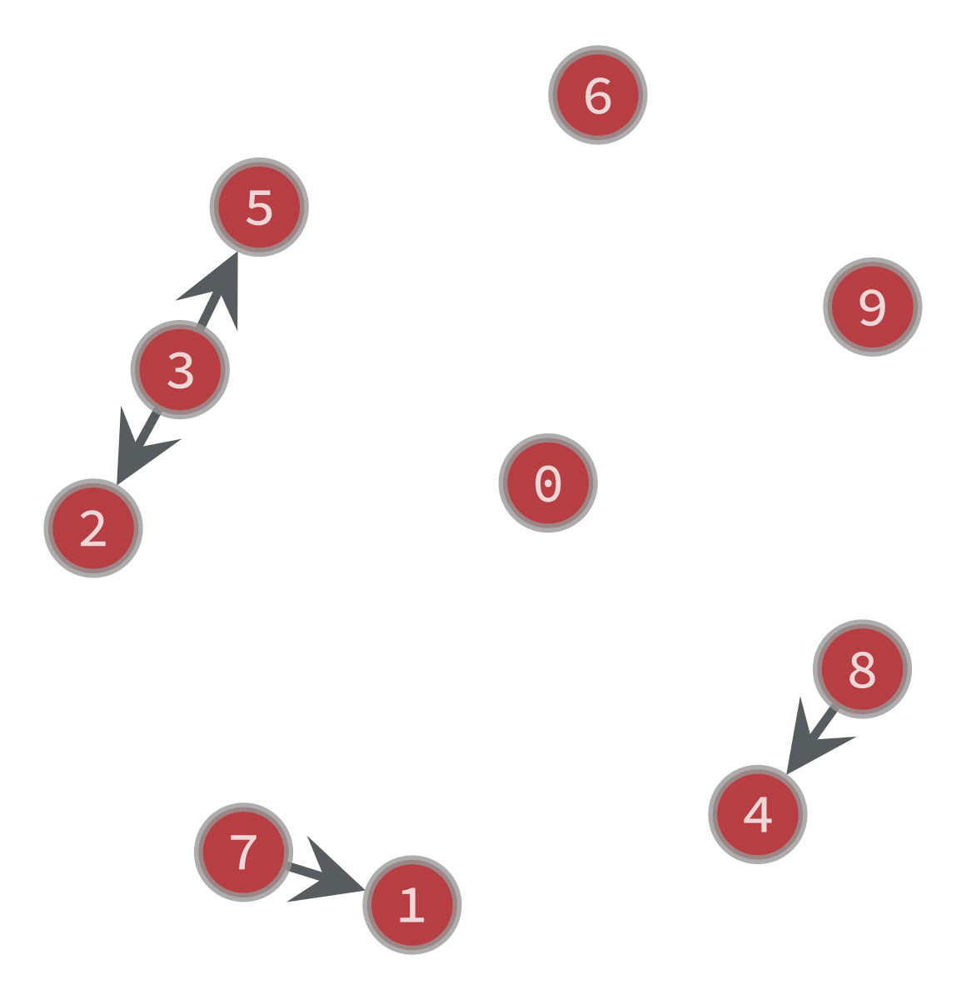

FEAS Algorithm finished with c: 9.0
Clock Period of the graph is: 12
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 12
No feasible retiming exists.
Test with C: 10.0
Final graph created with FEAS: 


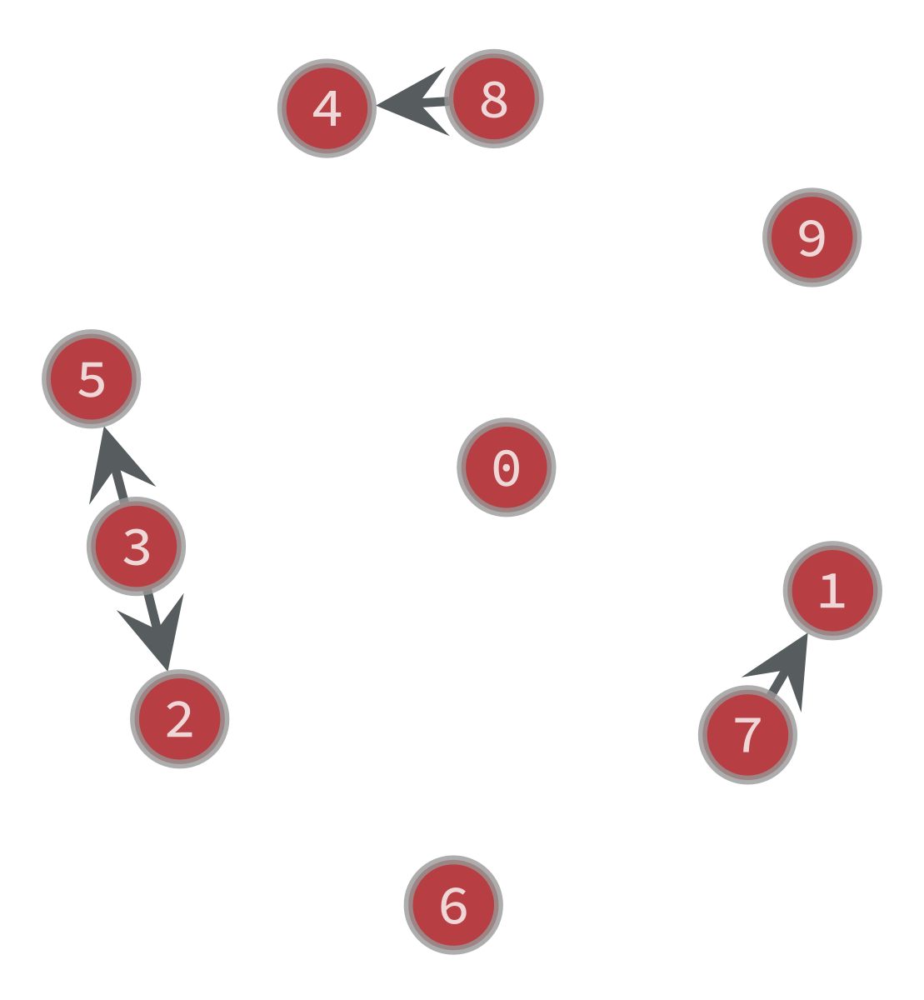

FEAS Algorithm finished with c: 10.0
Clock Period of the graph is: 12
No feasible retiming exists.
Clock Period of the graph (OPT2) is: 12
No feasible retiming exists.
Test with C: 12.0
Final graph created with FEAS: 


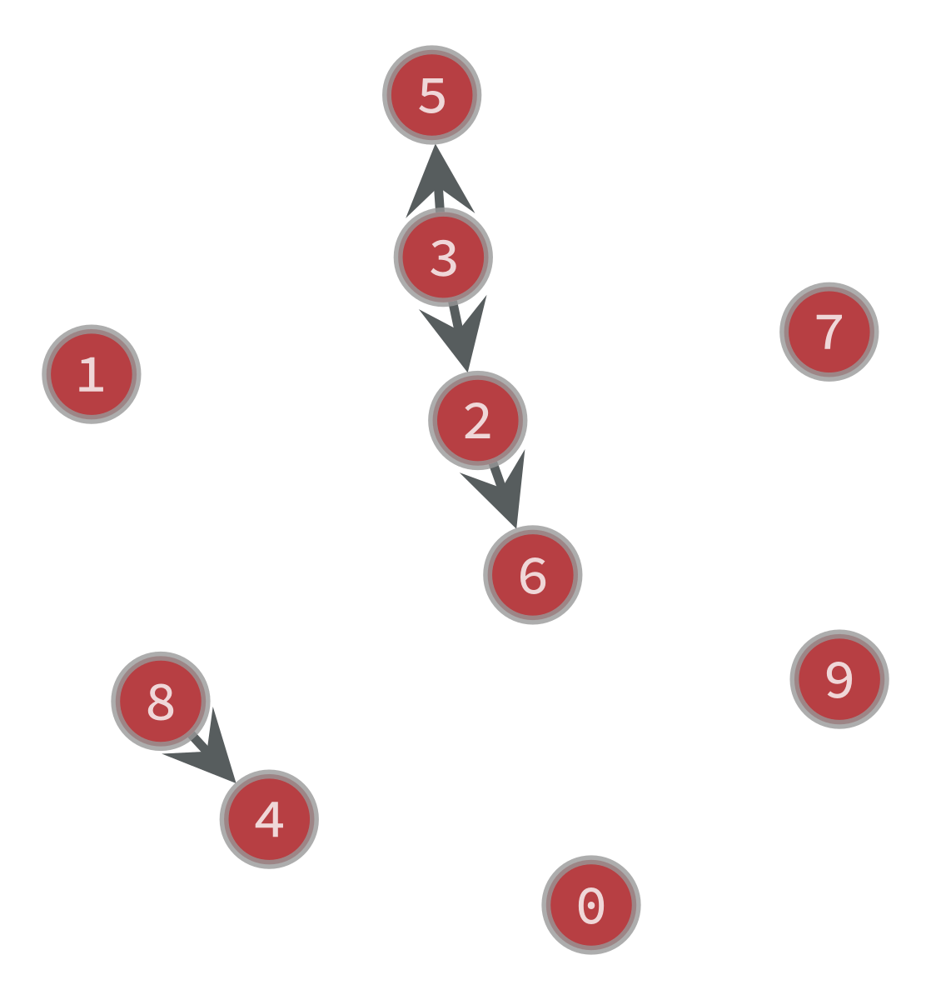

FEAS Algorithm finished with c: 12.0
Clock Period of the graph is: 12
Retiming: [0, 0, 0, 1, 1, 0, 0, 0, 1, 1] is the desired retiming.
Clock Period of the graph (OPT2) is: 12
Retiming: [0, 0, 0, 1, 1, 0, 0, 0, 1, 1] is the desired retiming.
Test with C: 13.0
Final graph created with FEAS: 


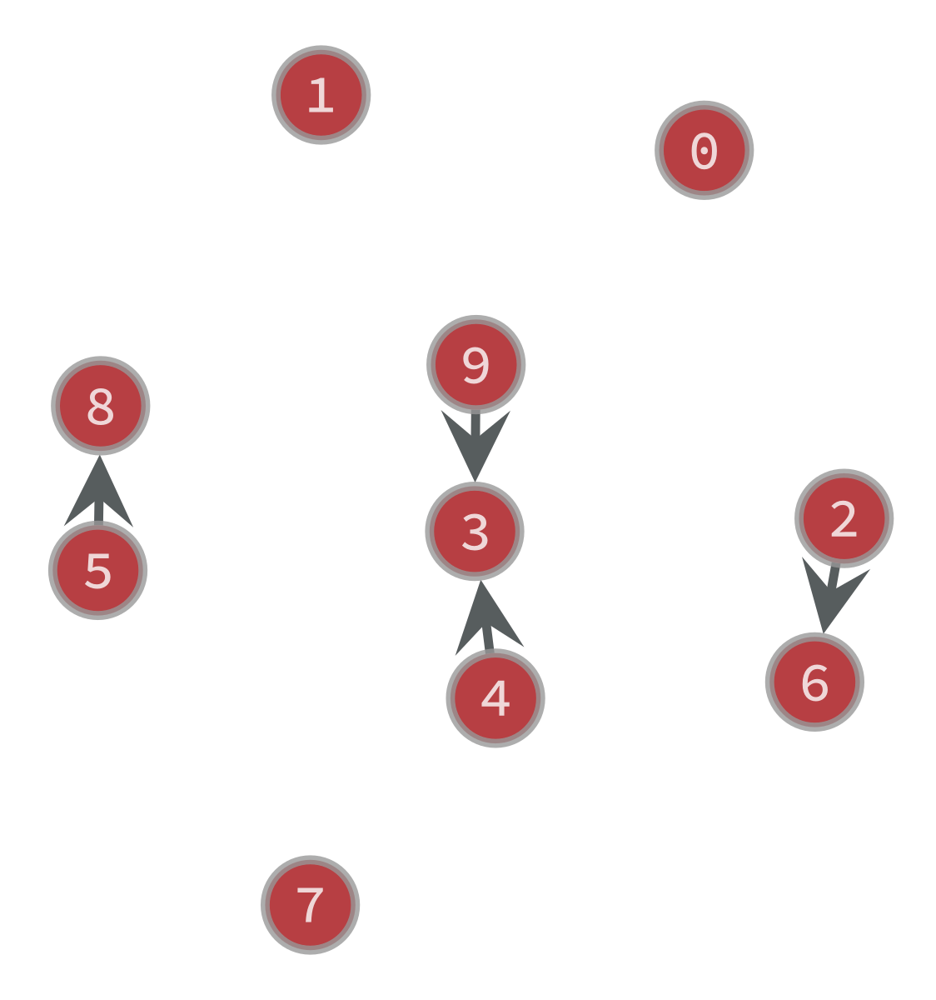

FEAS Algorithm finished with c: 13.0
Clock Period of the graph is: 13
Retiming: [0, 0, 0, 0, 1, 0, 0, 0, 0, 1] is the desired retiming.
Clock Period of the graph (OPT2) is: 13
It doesn't improve the retiming.
Test with C: 14.0
Final graph created with FEAS: 


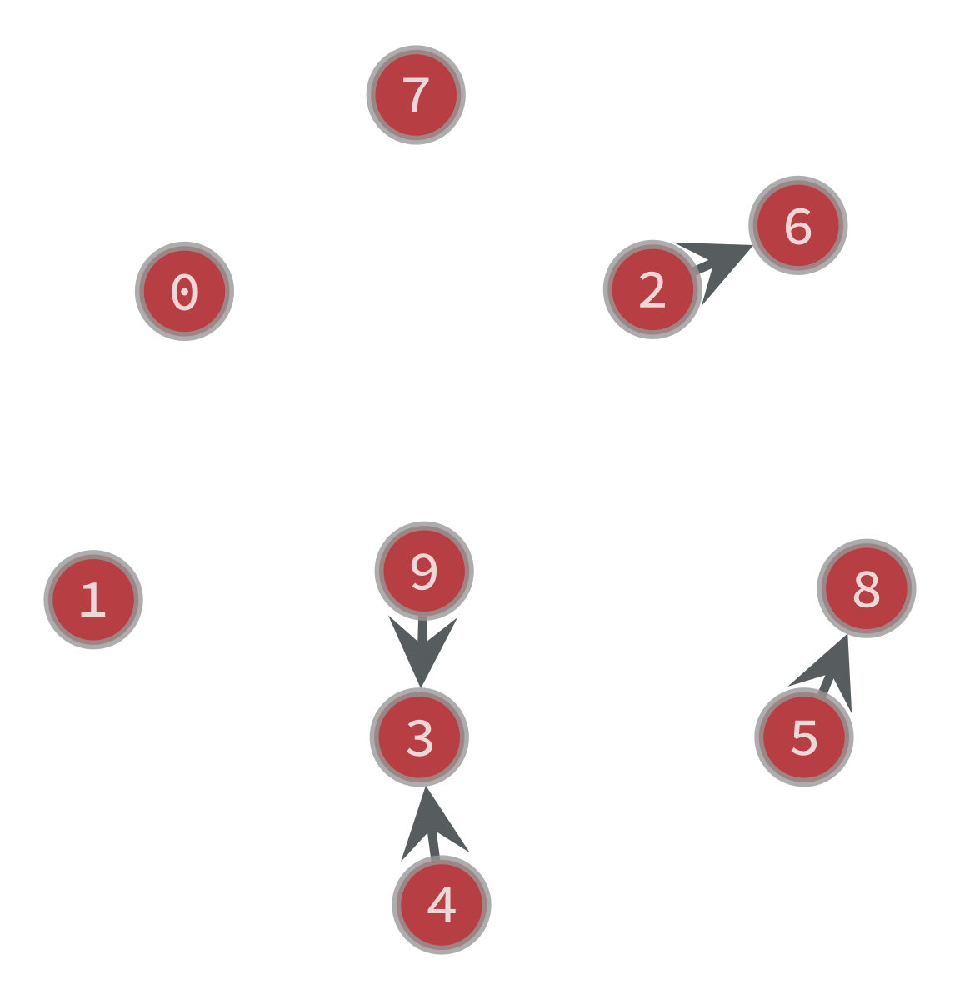

FEAS Algorithm finished with c: 14.0
Clock Period of the graph is: 13
Retiming: [0, 0, 0, 0, 1, 0, 0, 0, 0, 1] is the desired retiming.
Clock Period of the graph (OPT2) is: 13
It doesn't improve the retiming.
Test with C: 15.0
Final graph created with FEAS: 


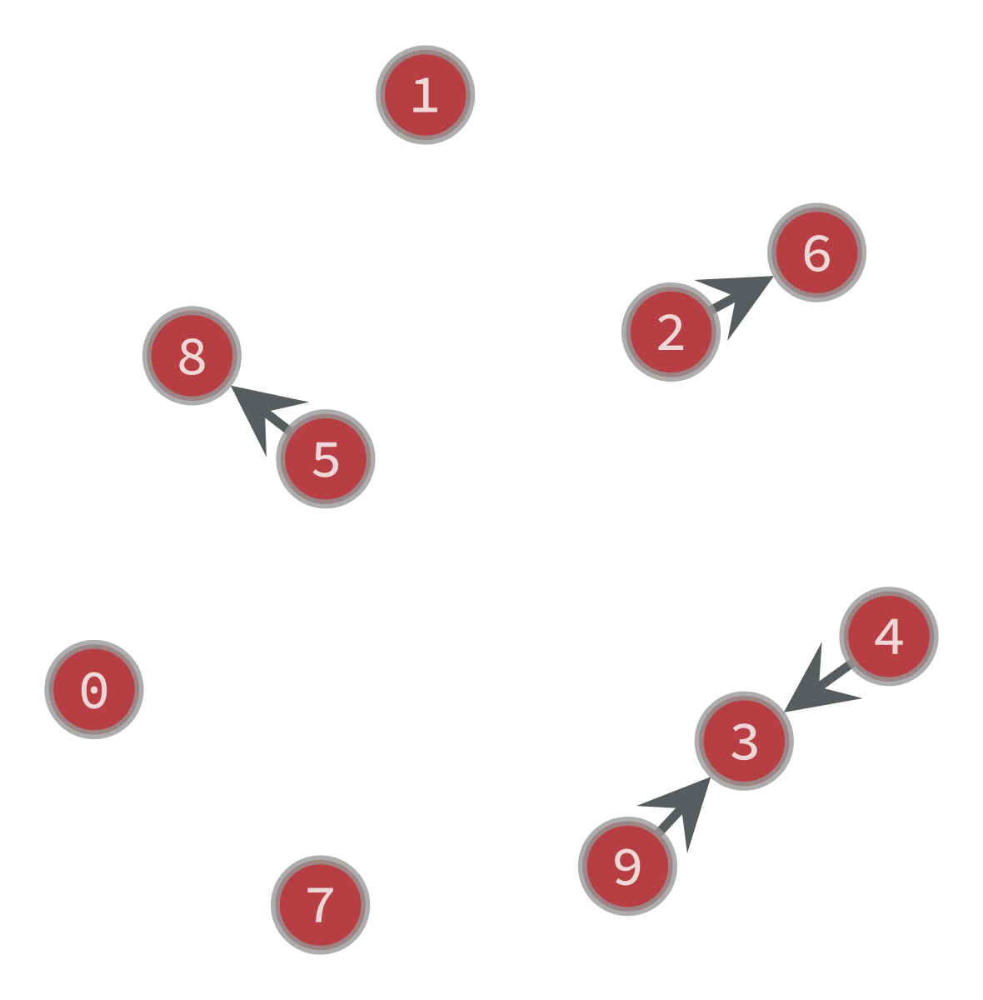

FEAS Algorithm finished with c: 15.0
Clock Period of the graph is: 13
Retiming: [0, 0, 0, 0, 1, 0, 0, 0, 0, 1] is the desired retiming.
Clock Period of the graph (OPT2) is: 13
It doesn't improve the retiming.
Test with C: 16.0
Final graph created with FEAS: 


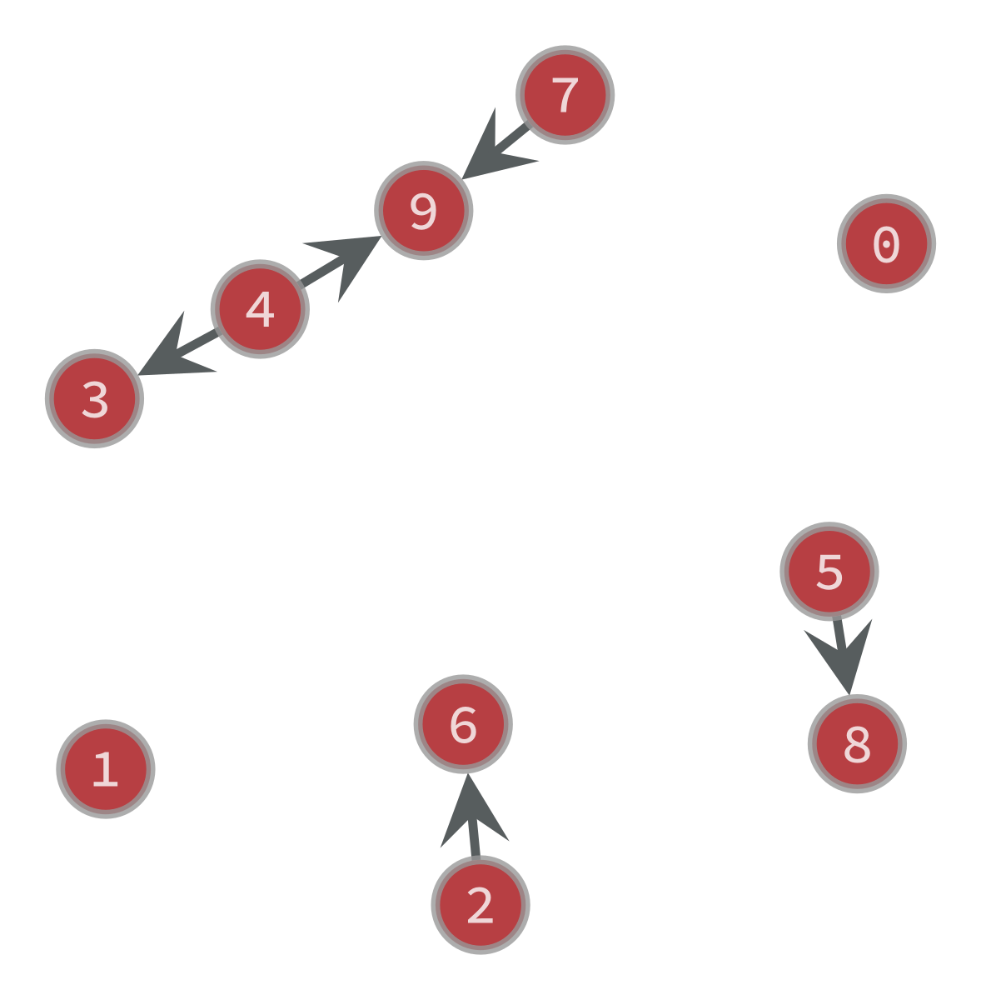

FEAS Algorithm finished with c: 16.0
Clock Period of the graph is: 16
Retiming: [0, 0, 0, 0, 1, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 16
It doesn't improve the retiming.
Test with C: 17.0
Final graph created with FEAS: 


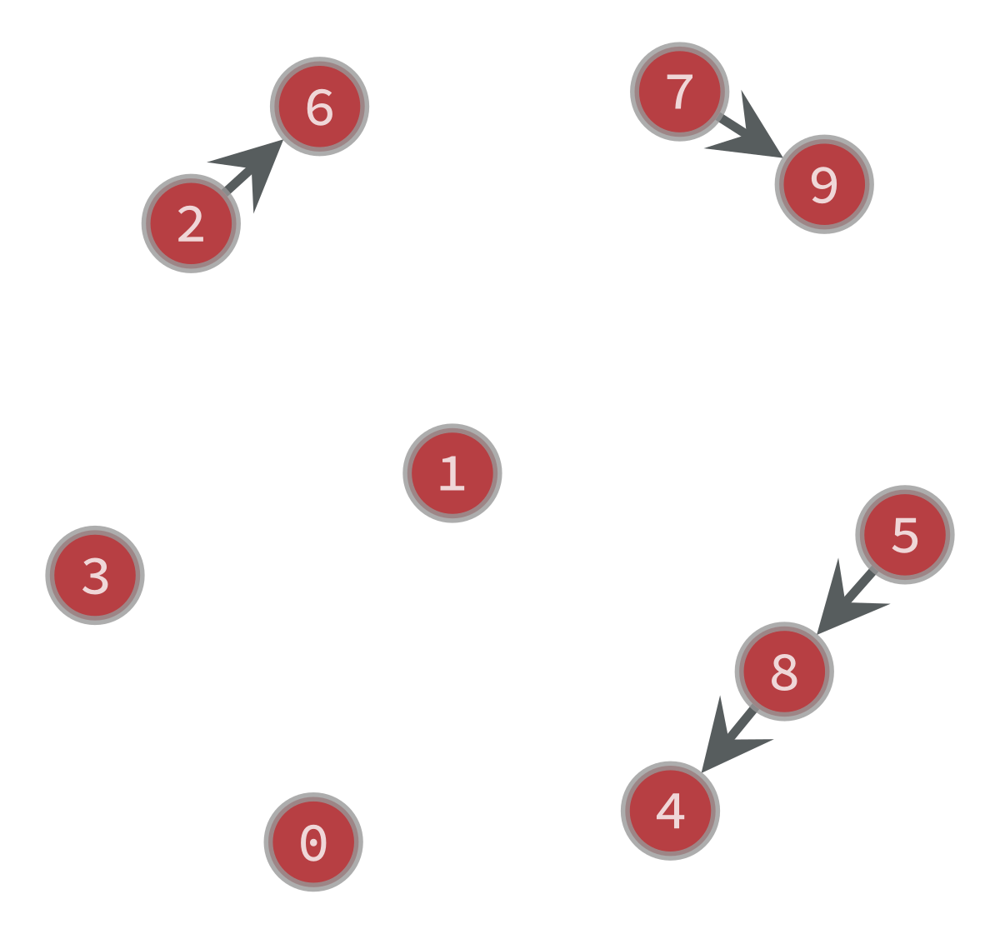

FEAS Algorithm finished with c: 17.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Test with C: 18.0
Final graph created with FEAS: 


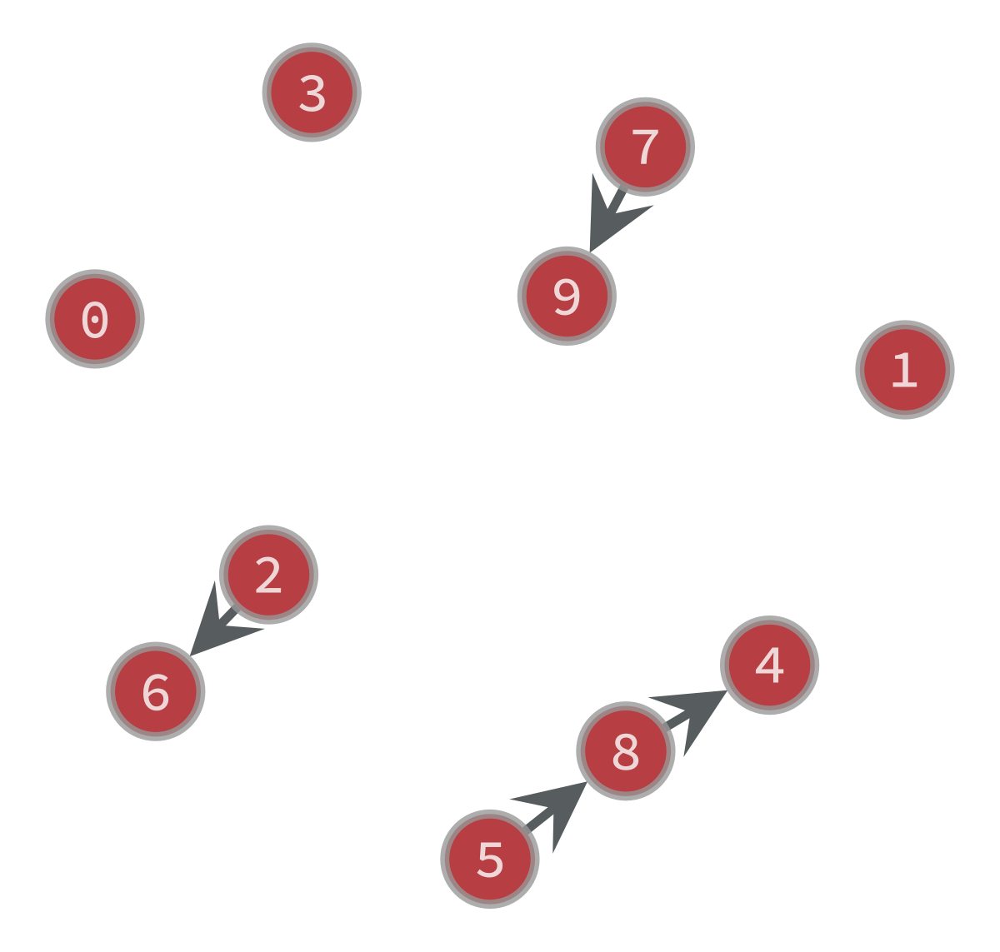

FEAS Algorithm finished with c: 18.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Test with C: 19.0
Final graph created with FEAS: 


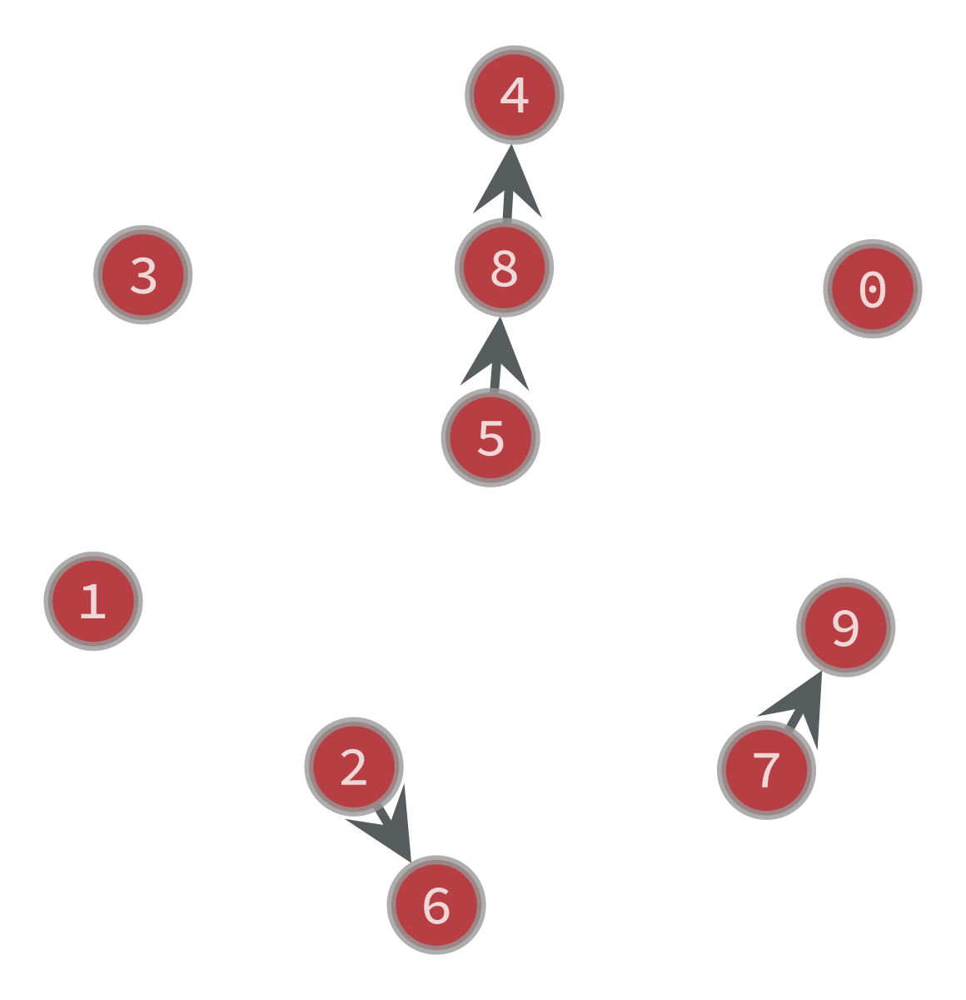

FEAS Algorithm finished with c: 19.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Test with C: 20.0
Final graph created with FEAS: 


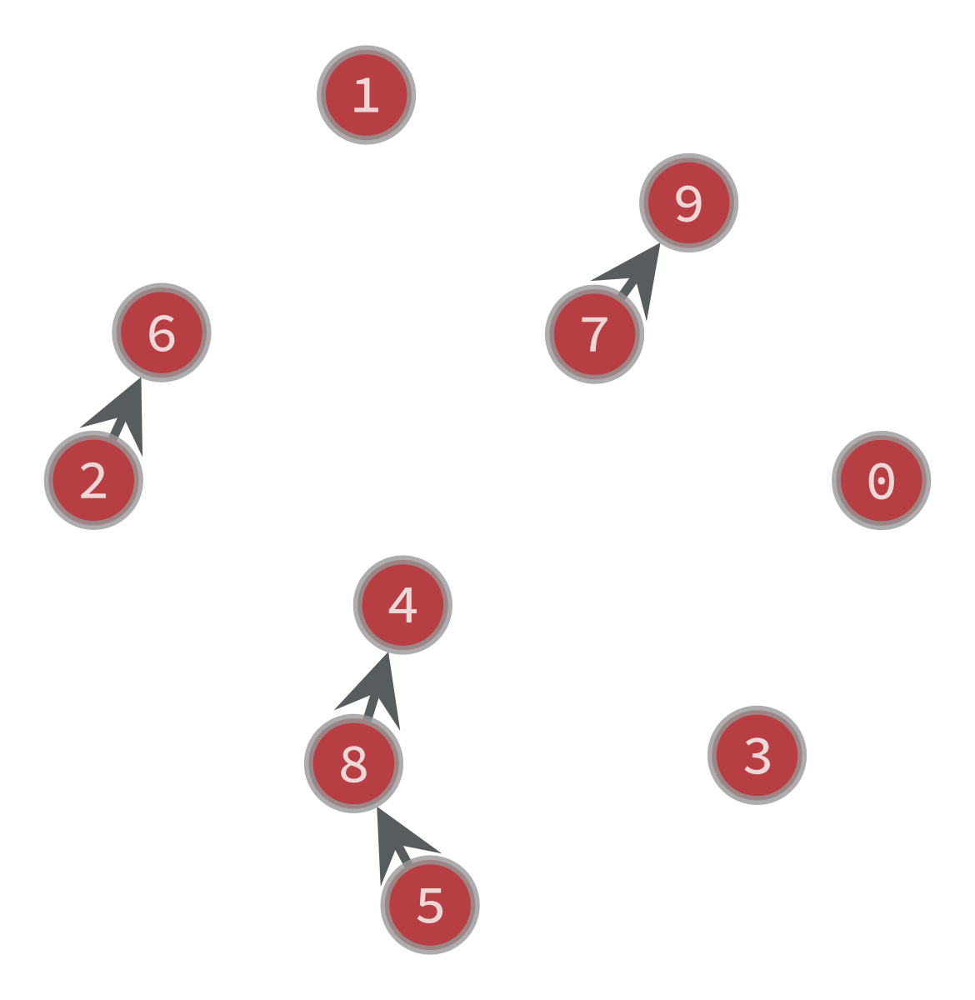

FEAS Algorithm finished with c: 20.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Test with C: 21.0
Final graph created with FEAS: 


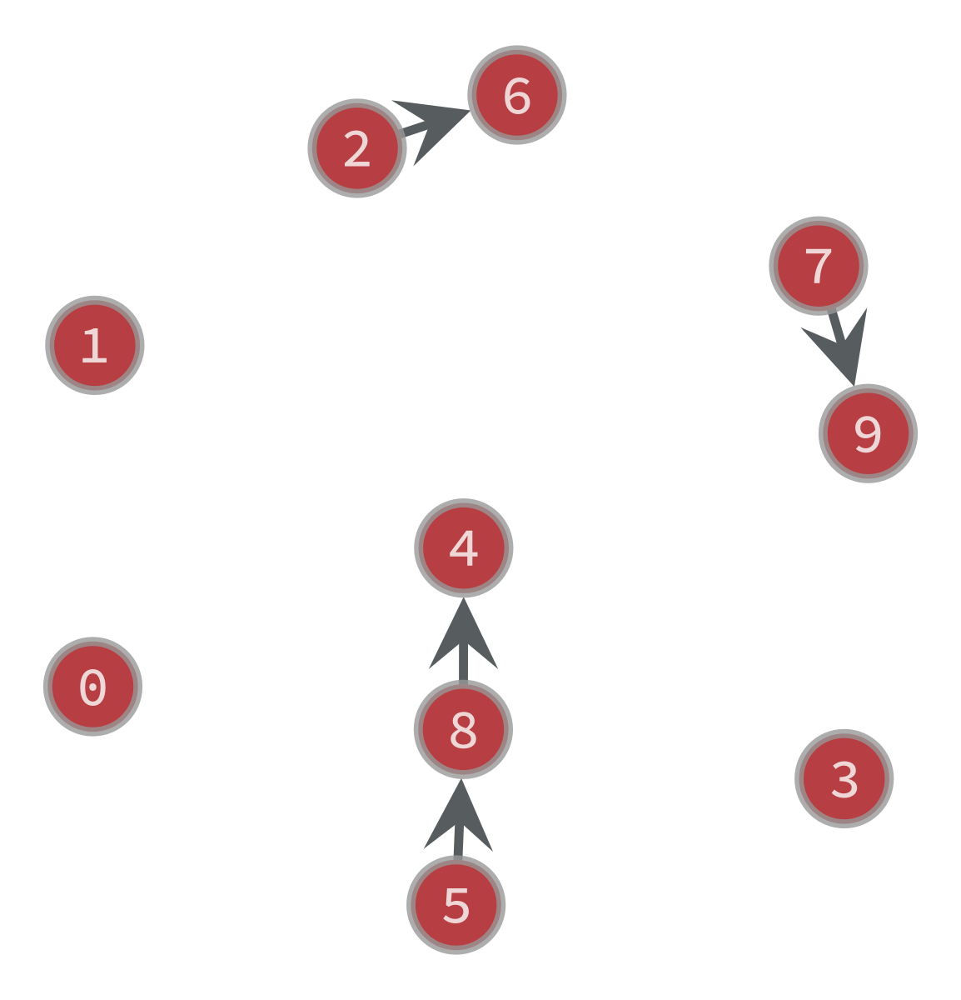

FEAS Algorithm finished with c: 21.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Test with C: 23.0
Final graph created with FEAS: 


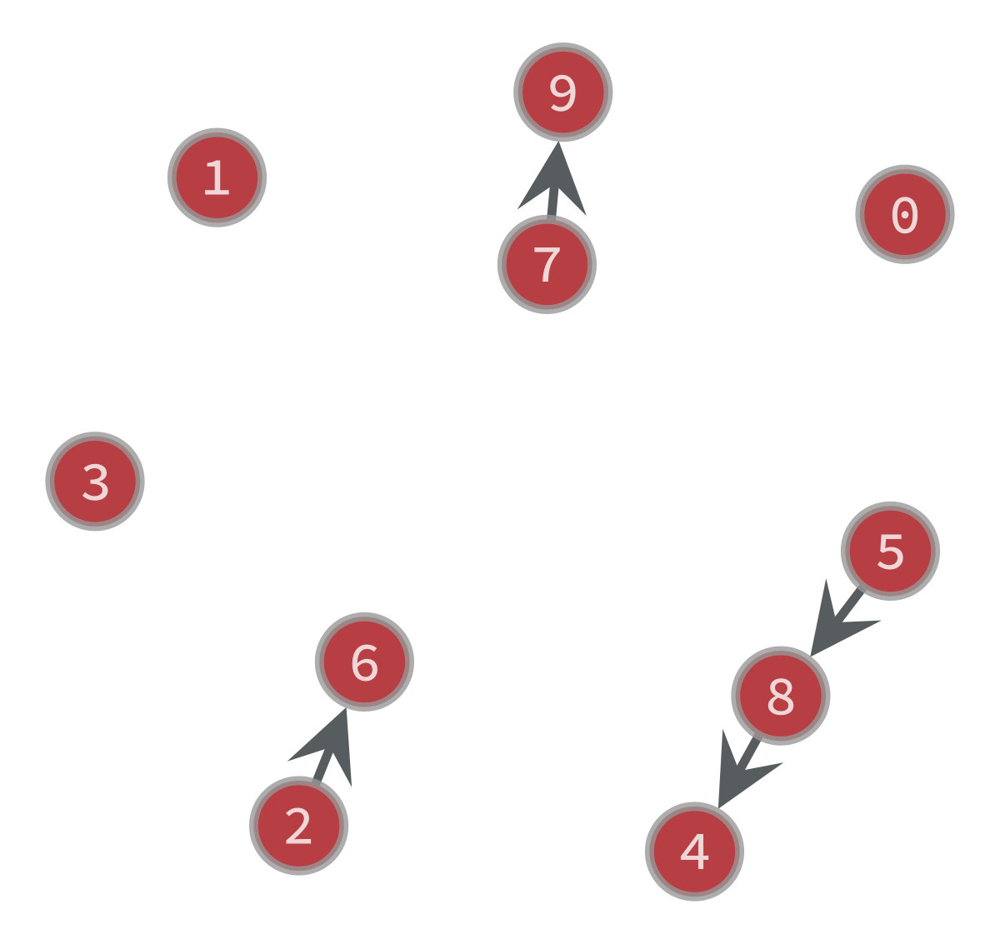

FEAS Algorithm finished with c: 23.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Test with C: 24.0
Final graph created with FEAS: 


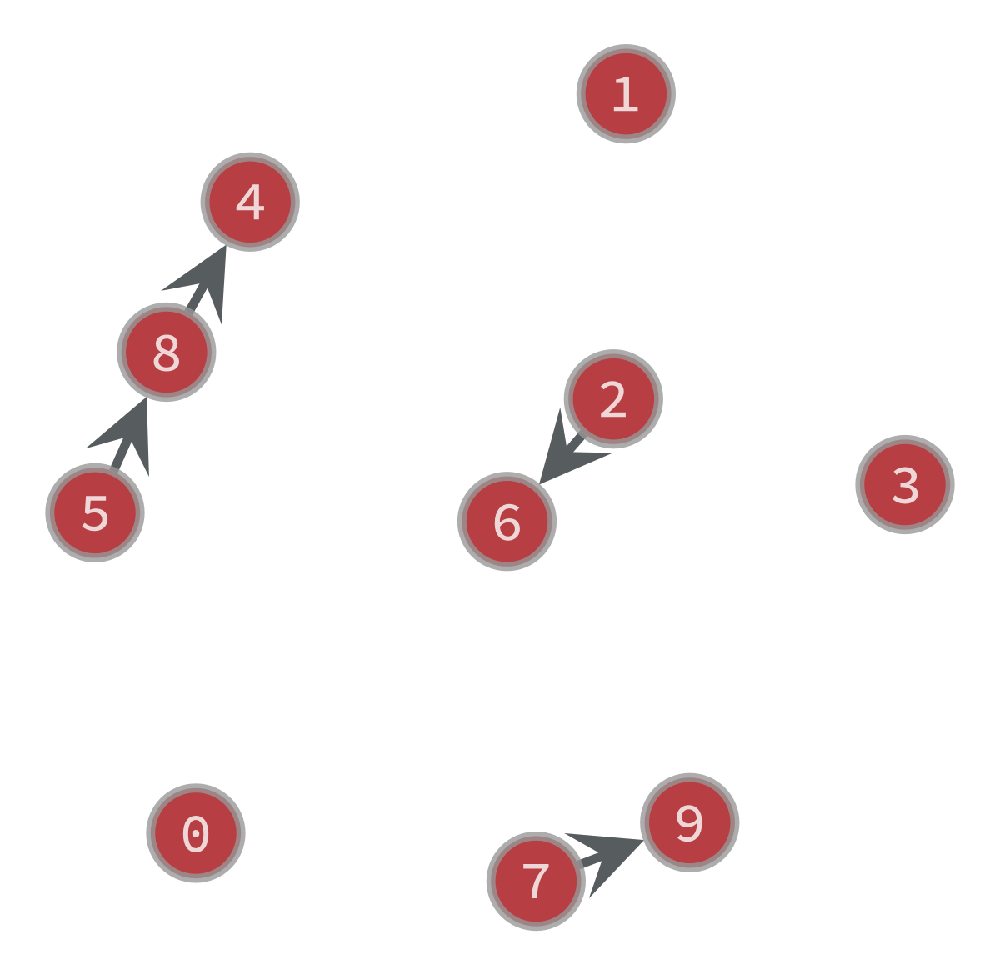

FEAS Algorithm finished with c: 24.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Test with C: 25.0
Final graph created with FEAS: 


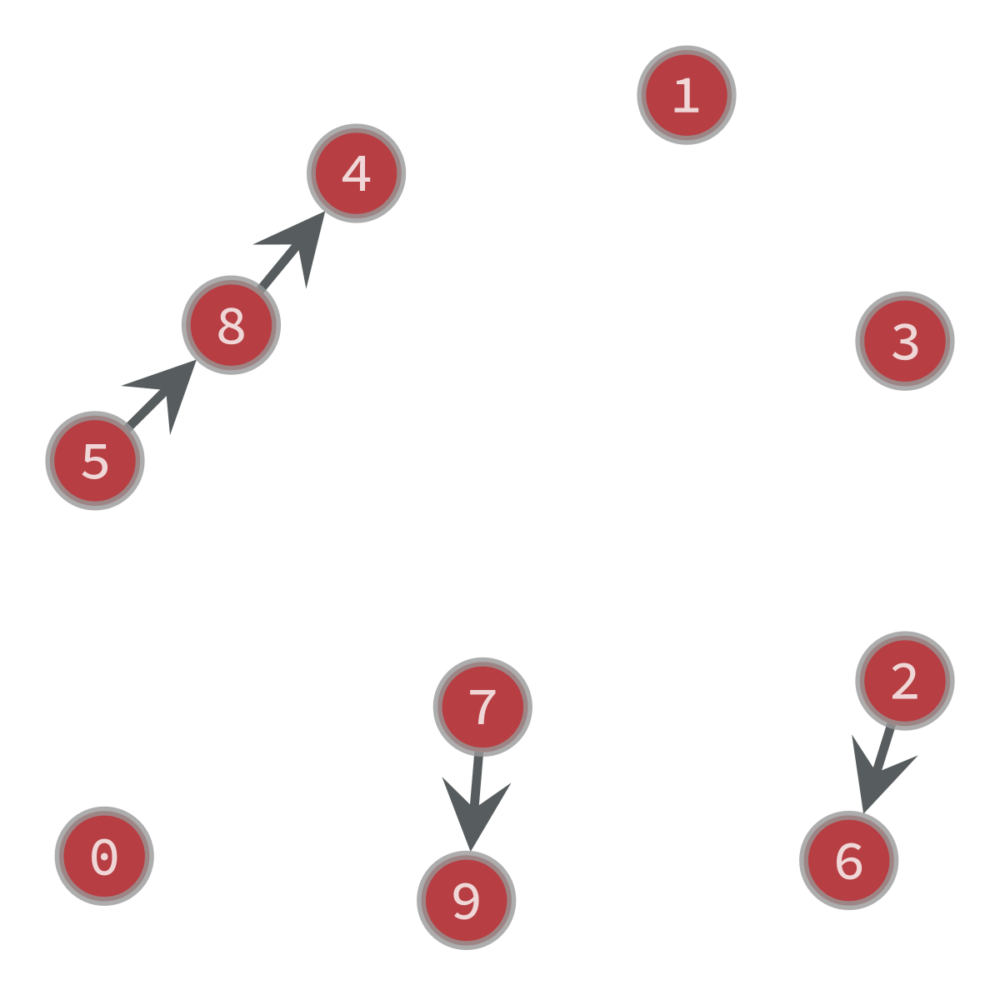

FEAS Algorithm finished with c: 25.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Test with C: 27.0
Final graph created with FEAS: 


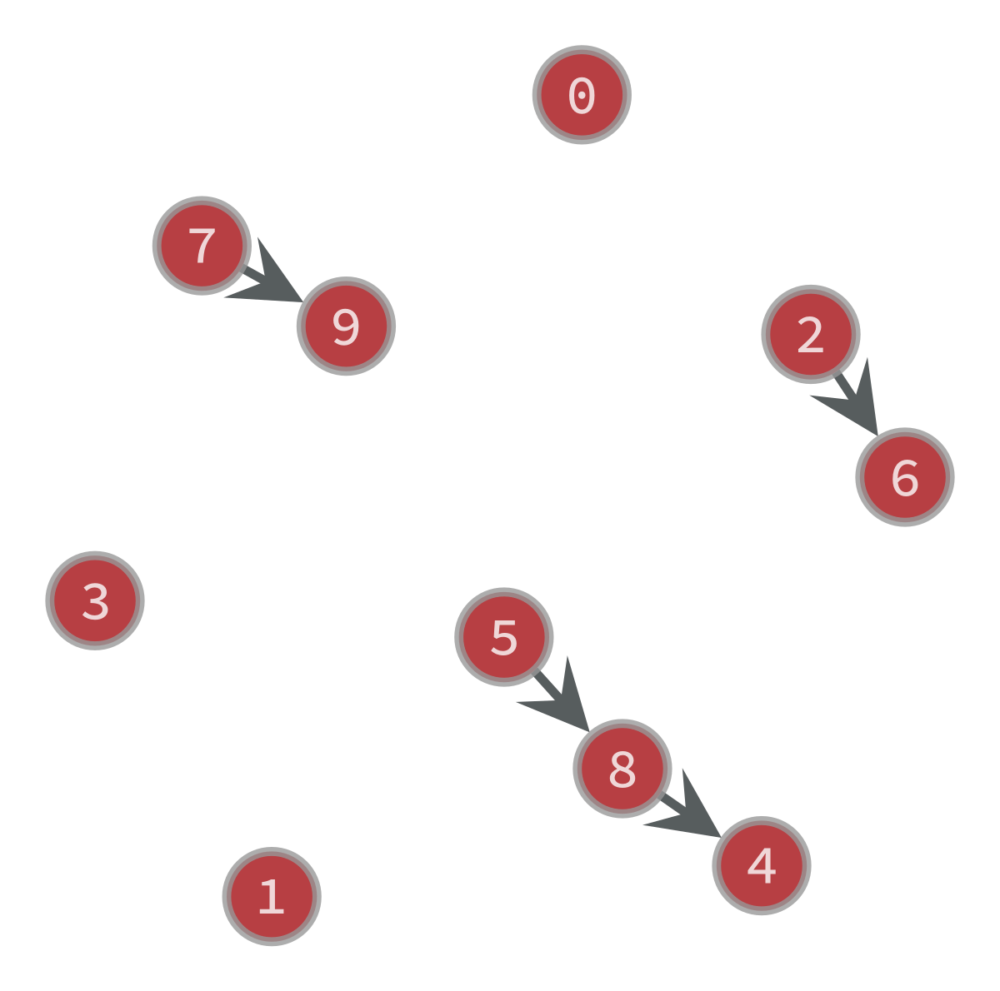

FEAS Algorithm finished with c: 27.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Test with C: 28.0
Final graph created with FEAS: 


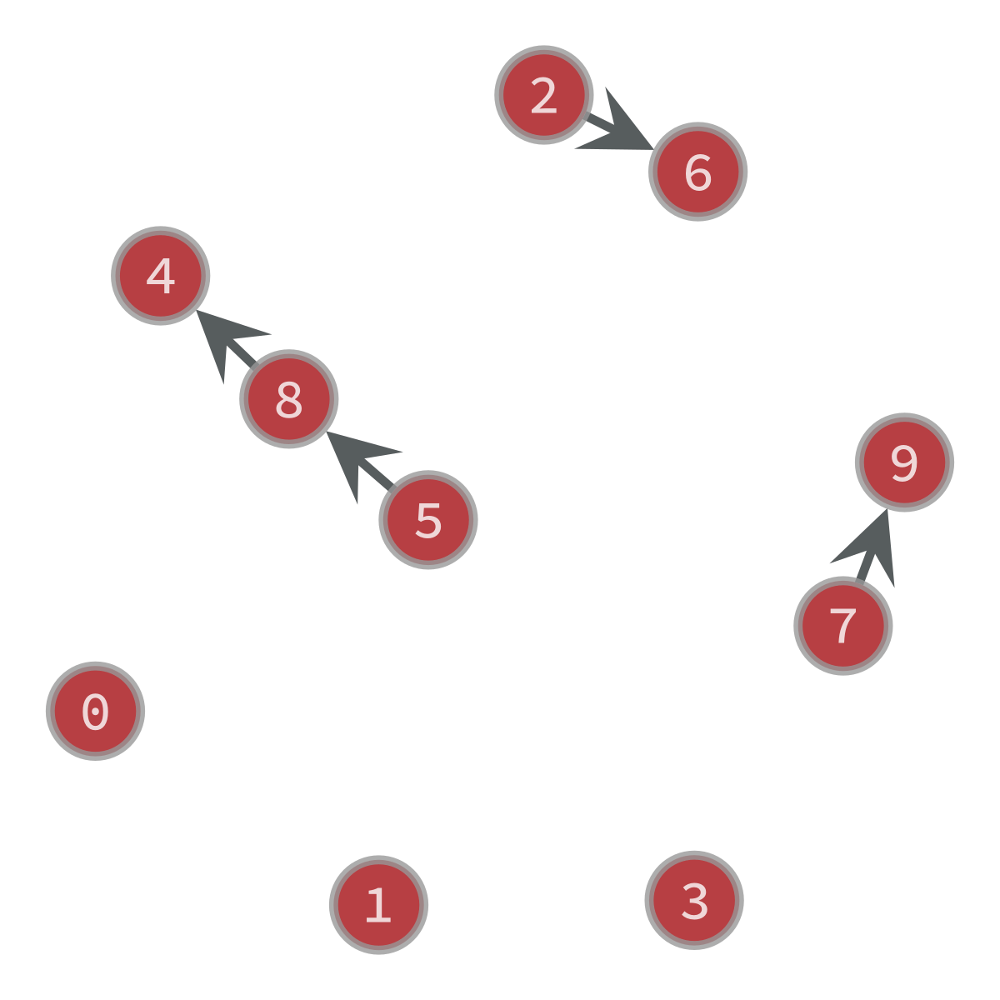

FEAS Algorithm finished with c: 28.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Test with C: 29.0
Final graph created with FEAS: 


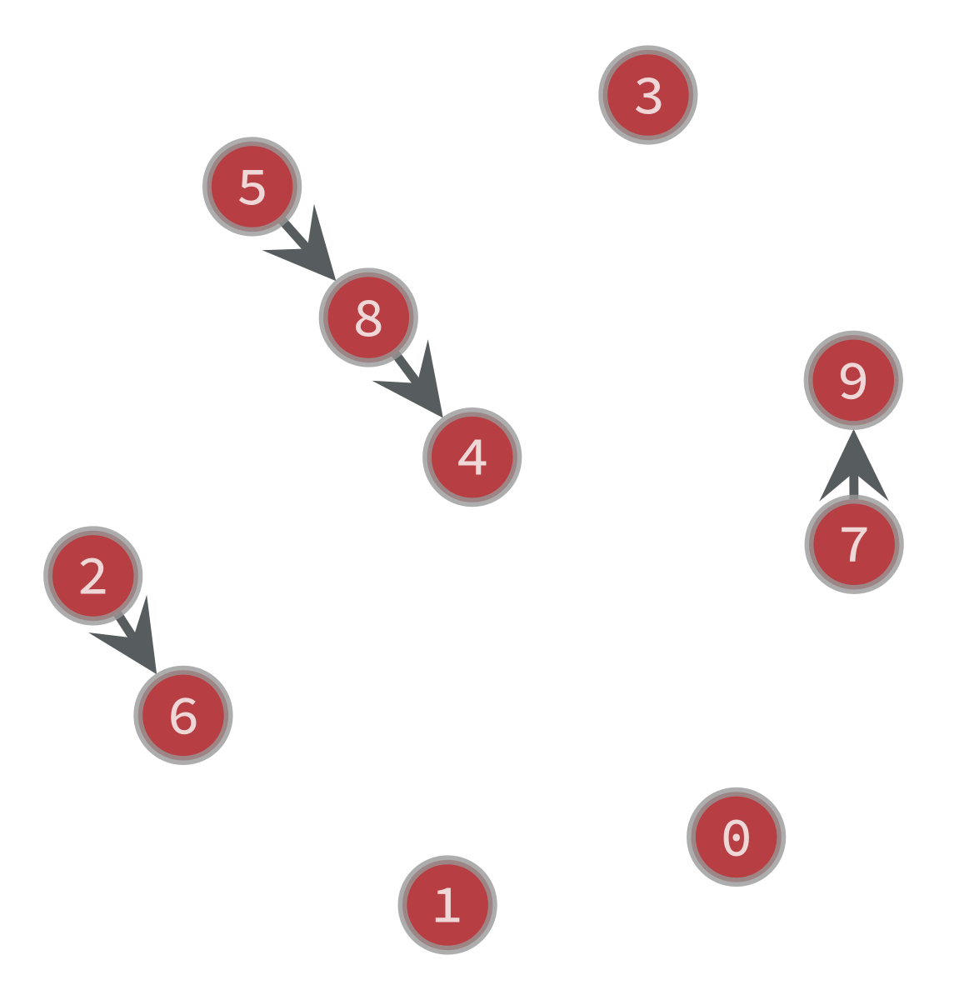

FEAS Algorithm finished with c: 29.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Test with C: 30.0
Final graph created with FEAS: 


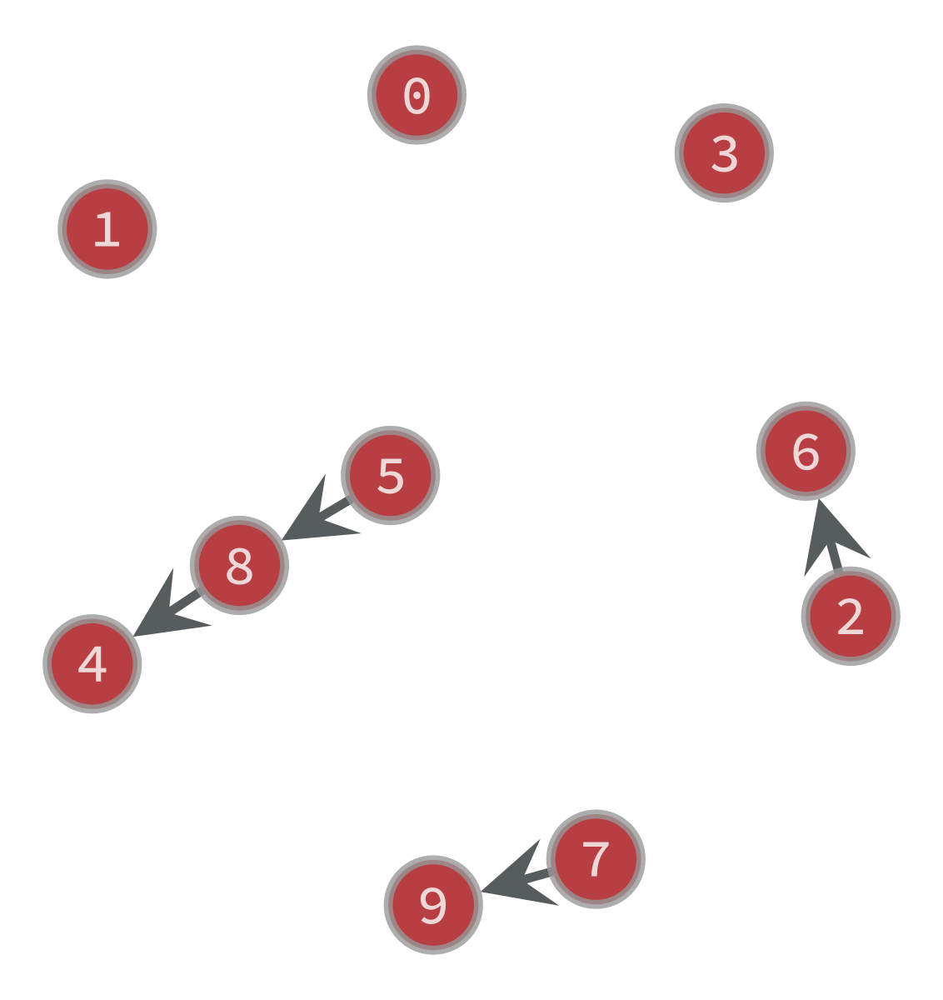

FEAS Algorithm finished with c: 30.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Test with C: 31.0
Final graph created with FEAS: 


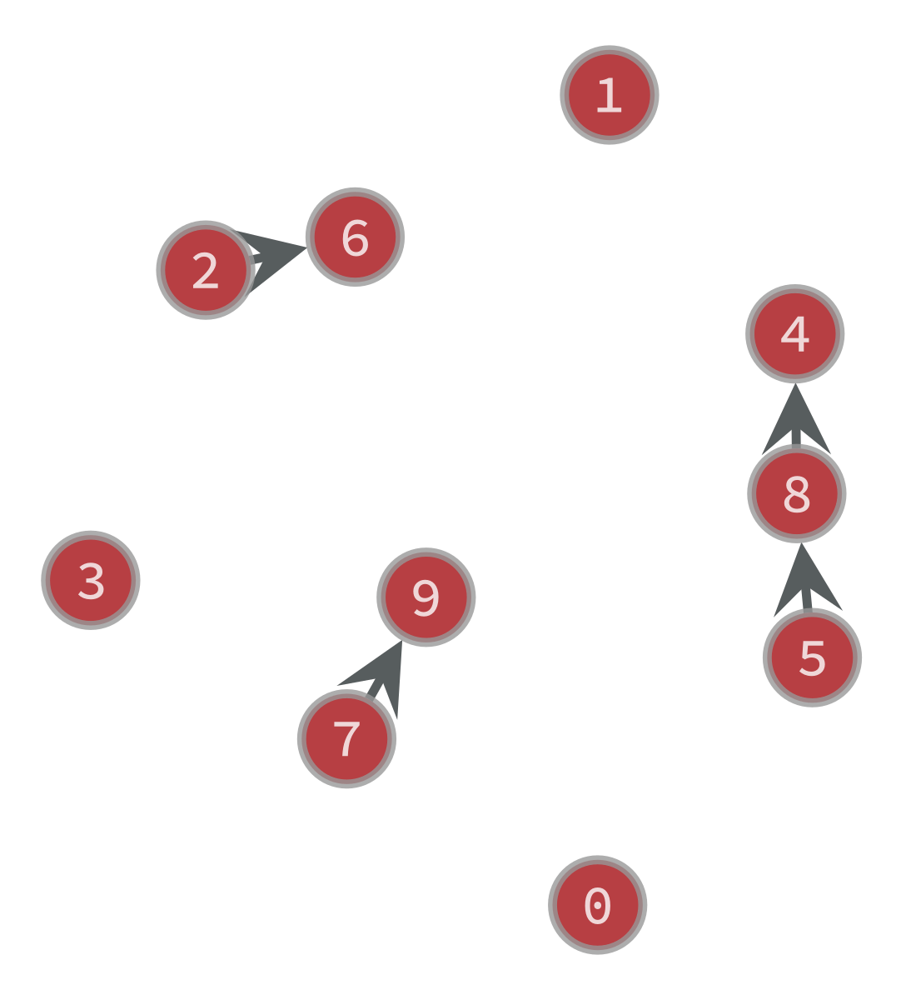

FEAS Algorithm finished with c: 31.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Test with C: 32.0
Final graph created with FEAS: 


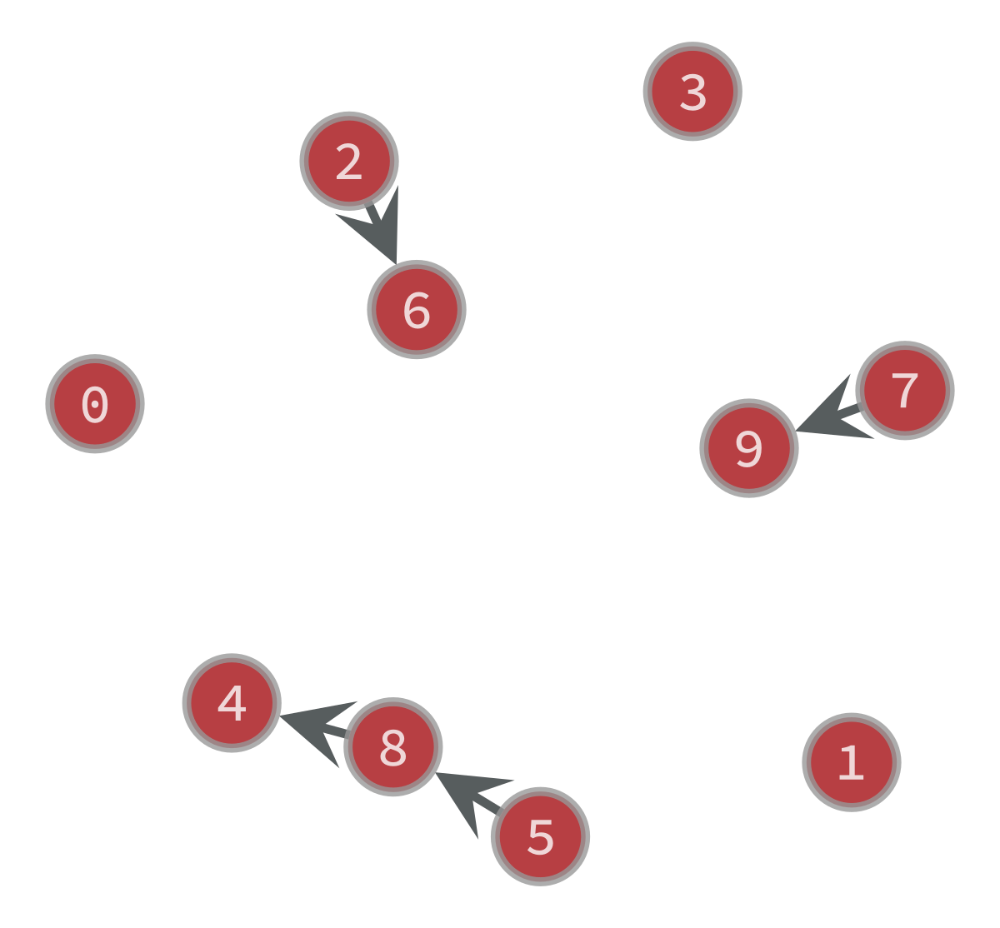

FEAS Algorithm finished with c: 32.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Test with C: 33.0
Final graph created with FEAS: 


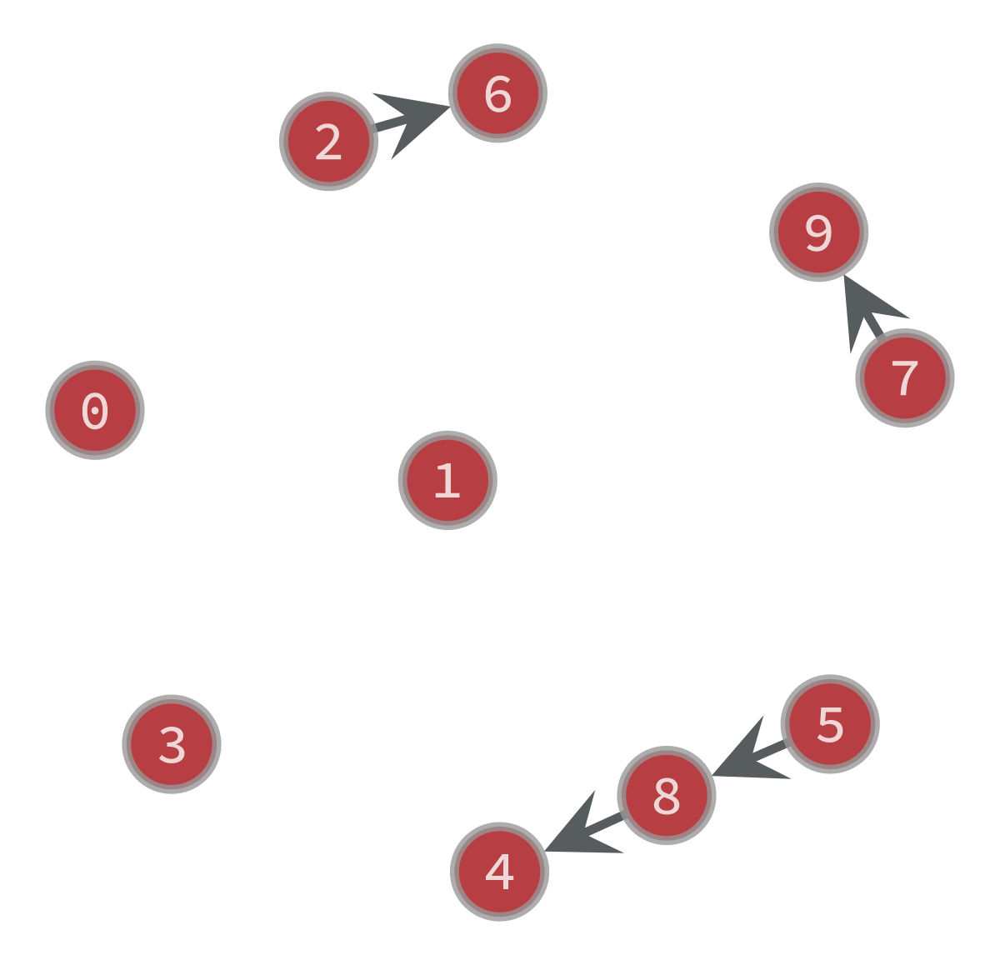

FEAS Algorithm finished with c: 33.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Test with C: 35.0
Final graph created with FEAS: 


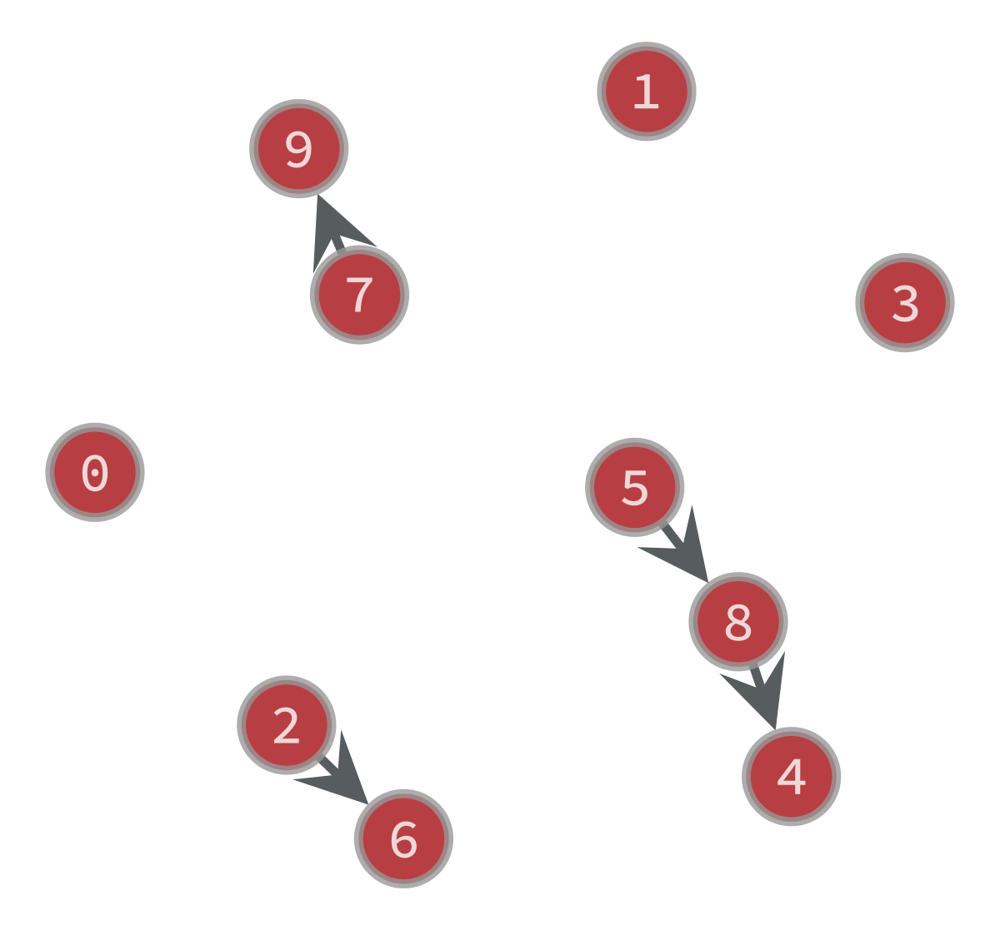

FEAS Algorithm finished with c: 35.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Test with C: 37.0
Final graph created with FEAS: 


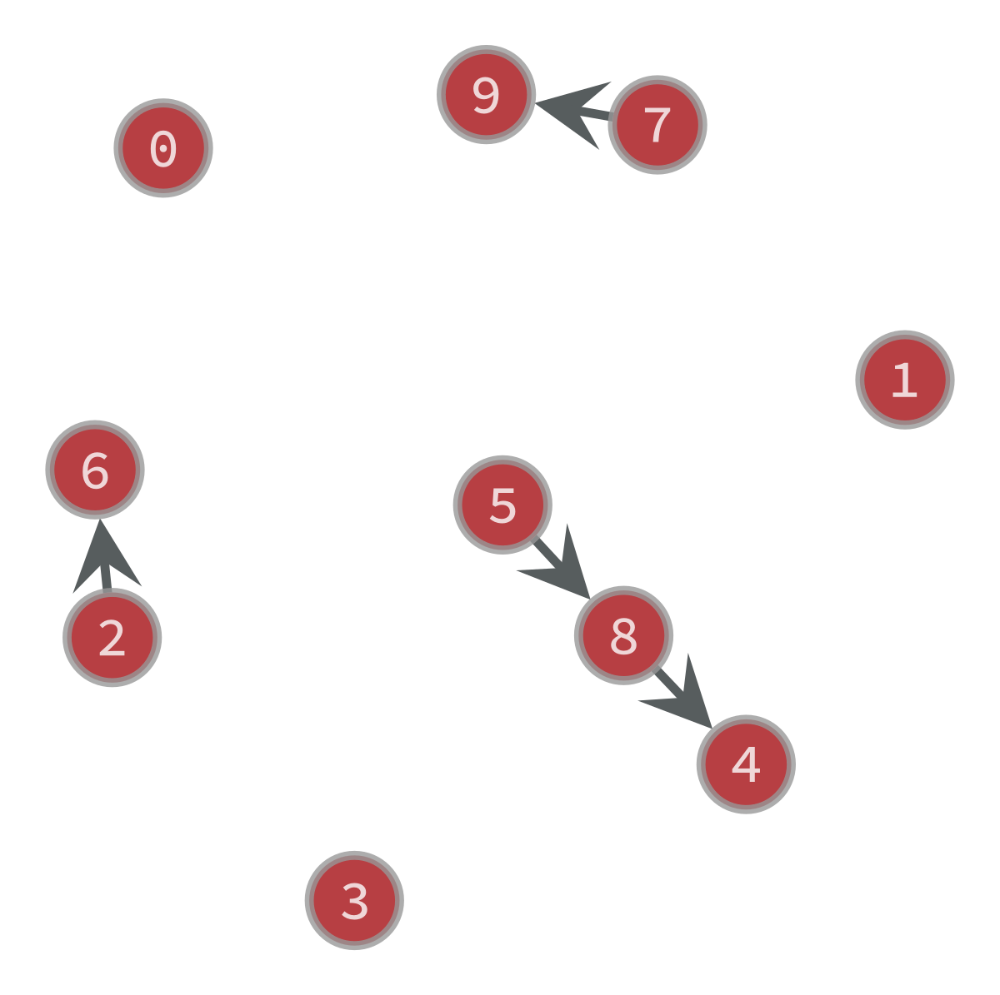

FEAS Algorithm finished with c: 37.0
Clock Period of the graph is: 17
Retiming: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0] is the desired retiming.
Clock Period of the graph (OPT2) is: 17
It doesn't improve the retiming.
Minimum Achievable Clock Period is: 12 with retiming: [0, 0, 0, 1, 1, 0, 0, 0, 1, 1]
(12, [0, 0, 0, 1, 1, 0, 0, 0, 1, 1])


In [154]:
print(OPT2(gtest))